## Import Necessary Libraries

In [1]:
import matplotlib.pyplot as plt 
from datetime import datetime
import pandas as pd
import numpy as np
import pygad
import numpy
import glob
import wntr
import os

In [2]:
plt.rcParams['figure.figsize'] = (12,8)

In [3]:
import warnings
import shutil
warnings.filterwarnings('ignore')

In [4]:
# wipe all solutions in the directory

try:
    shutil.rmtree('each-node-optimization-results-csvs/')
    shutil.rmtree('each-node-optimization-plots/')
    shutil.rmtree('merged_results/')
except FileNotFoundError:
    print('files not existing')

# recreate deleted folders
os.makedirs('each-node-optimization-results-csvs')
os.makedirs('each-node-optimization-plots')
os.makedirs('merged_results')


# Uncomment and run the above code if you want to re-optimze this project otherwise, go ahead.
# Recommendation: Uncomment and run the code if you want re-optimize.

## Read Inp File

In [5]:
class Config:
    num_generations =100 #Number of generations.
    num_parents_mating = 1 # Number of solutions to be selected as parents in the mating pool.
    sol_per_pop = 20 # Number of solutions in the population.
    num_genes = 1 #len(function_inputs) --> this can be an array
    init_range_low = 0
    init_range_high = 1
    parent_selection_type = "sss" # Type of parent selection.
    keep_parents = -1 # Number of parents to keep in the next population. -1 means keep all parents and 0 means keep nothing.
    crossover_type = "single_point" # Type of the crossover operator. 
    mutation_type = "random" # Type of the mutation operator.
    mutation_num_genes=1 # Type of the mutation operator.
    last_fitness = 0
    
    inp_file_path = r"../data/Real_Synthetic_Net.inp" 
    function_inputs = None
    desired_output = None

In [6]:
class WaterLeakModel(Config):
    
    def __init__(self, node:str):
        ''' 
            node: node/junction ID in the network
        '''
        
        # Check if node is junction_name 
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        assert wn.junction_name_list.count(node) == 1, "Node not found in the network"
        self.node_index = wn.junction_name_list.index(node)
        
        self.node = node
        
        #Setup all neccessary folders we need to work with, i.e. create them if they don't exist
        if not os.path.exists('each-node-optimization-results-csvs/solutions_for_'+self.node):
            os.mkdir('each-node-optimization-results-csvs/solutions_for_'+self.node)
            
        if not os.path.exists('each-node-optimization-plots/plots_for_'+self.node):
            os.mkdir('each-node-optimization-plots/plots_for_'+self.node)


        if not os.path.exists('merged_results/results_for_'+self.node):
            os.mkdir('merged_results/results_for_'+self.node)
            
        self.temp_dir = 'each-node-optimization-results-csvs/solutions_for_'+self.node
        self.plots_dir = 'each-node-optimization-plots/plots_for_'+self.node
        self.merged_result = 'merged_results/results_for_'+self.node

    def simulate(self, wn, plot_graph=True):
        """
        If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        # Plot pressure after add leak to node
            
        sim = wntr.sim.WNTRSimulator(wn)
        results = sim.run_sim()
        pressure = results.node['pressure']
        pressure_at_N6 = pressure.loc[:,wn.junction_name_list[self.node_index]]
        if plot_graph:
            wntr.graphics.plot_network(wn, node_attribute=pressure.any(), node_size=150, title='Pressure at 0 hours')
        
        return results
    
    def change_discharge_coefficient(self, wn, emitter_value):
        """
        This function changes the emitter coefficient for selected node in the network, and create a 
        structured representation of our data, a csv.
        
        parameters
        ----------
        wn: wntr network object
        emitter_value: the emitter coefficient value
        """
        
        # Change emitter coefficient
        node = wn.get_node(str(self.node))
        node.add_leak(wn, area=0.00015, start_time=0, end_time=1, discharge_coeff=emitter_value)
        return self.simulate(wn, plot_graph=False)
    
    def export_results(self, solutions:list, name:str, export_type='by_solution', path=None):
        """
        Concatenates all solutions generated and exports as a single csv file
        
        parameters
        ----------
        solution: a list of all paths to the solutions csv files
        path: path where concatenated solution will be exported to
        name: name to be assigned to exported file
        """
        if not path: path=self.merged_result
        
        if not os.path.exists(path):
            os.mkdir(path)
        
        temp = pd.DataFrame()
        for i in solutions:
            if export_type == 'by_solution':
                extracted_node = i.split('/')[1].split('_')[2]
            else:
                extracted_node = i.split('/')[1].split('_')[1]
                
            data = pd.read_csv(i)
            data['NODE'] = extracted_node
            if i == 0:
                temp = data
            else:
                temp = pd.concat([temp, data])
        name+=".csv"
        try:
            temp.to_csv(os.path.join(path,name),index=False)
            print(f'File Exported Successfully to path: {os.path.join(path, name)}')
        except Exception as e:
            print(e)
            
    def run(self, leak_area=0.00015, start_time=0, end_time=1, discharge_coeff=.5, function_inputs=0.5, plot_graph=True):
        """
        Adds a leak to node passed to WaterLeakModel() object and simulates
        
        parameters
        ----------
        leak_area: area of the leak
        start_time: time in seconds to start the leak
        end_time: time in seconds to end the leak
        discharge_coeff: Leak discharge coefficient; Takes on values between 0 and 1.
        function_inputs = inputs for optimization, can be array of numbers
        plot_graph: If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        
        # Add leak and simulate
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        node = wn.get_node(self.node)
        node.add_leak(wn, area=leak_area, start_time=start_time, end_time=end_time, discharge_coeff=.5)
        self.simulate(wn, plot_graph=plot_graph)

        self.function_inputs = function_inputs
        self.desired_output = node.head - node.elevation
            

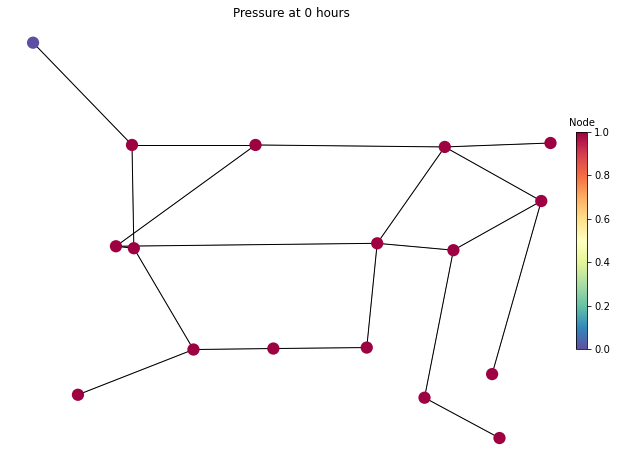

In [7]:
# Instantiate the pygad optimization class
water_model = WaterLeakModel(node='N6')
water_model.run()

In [8]:
# wipe all solutions in the directory
all_solutions = glob.glob(f'{water_model.temp_dir}/FITNESS_SOLUTION_*')
all_generations = glob.glob(f'{water_model.temp_dir}/GENERATION_*')
# for i in all_solutions:
#     os.remove(i)
# for j in all_generations:
#     os.remove(j)


# Uncomment and run the above code if you want to re-optimze this project otherwise, go ahead.
# Recommendation: Uncomment and run the code if you want re-optimize.

In [9]:
def fitness_function(solution, solution_idx):
    global current_node
    
    wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
    results = water_model.change_discharge_coefficient(wn, emitter_value=abs(solution[0])) #change emitter coefficient

    pressure = results.node['pressure']
    pressure_output = pressure.loc[:,water_model.node]

    demands=results.node['demand']
    demand_output = demands.loc[:,water_model.node]
    
    fitness = 1.0 / (np.abs(pressure_output - water_model.desired_output) + 0.000001)

    # Structure and export the output of the fitness
    data = pd.DataFrame(columns=['EMITTER_COEFFICIENT_SOLUTION','PRESSURE_OUTPUT','OUTPUT_DEMAND','FITNESS'])
    
    emitter_coeff=abs(solution[0]) 
    if emitter_coeff>1:
        emitter_coeff=emitter_coeff%1

    data = data.append({'EMITTER_COEFFICIENT_SOLUTION':abs(emitter_coeff),'PRESSURE_OUTPUT':list(pressure_output)[0],'FITNESS':list(fitness)[0],'OUTPUT_DEMAND':(list(demand_output) [0]*1000)},ignore_index=True)
    data.to_csv(f"{water_model.temp_dir}/FITNESS_SOLUTION_{current_node}_{str(abs(solution[0]))}.csv",index=False) 

    print('=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========')
    print ('======|', abs(round(solution[0],3)),'|===========|',list(round(pressure_output,3))[0],'|==================|',list(round(fitness, 3))[0],'|==========')
    print('================================='*2)

    return list(fitness)[0]

In [10]:
#################### Create a Callback Function ########################
last_fitness = 0
def callback_generation(ga_instance): # This function prints algorithm progress
    global last_fitness
    print("Generation = {generation}".format(generation=ga_instance.generations_completed)) 
    print("Fitness = {fitness}".format(fitness=ga_instance.best_solution()[1]))
    print("Change = {change}".format(change=ga_instance.best_solution()[1] - last_fitness)) 

    data =pd.DataFrame(columns=['GENERATION','FITNESS'])
    data =data.append({'GENERATION':ga_instance.generations_completed,'FITNESS': ga_instance.best_solution ()[1]},ignore_index=True)
    data.to_csv(f"{water_model.temp_dir}/GENERATION_{current_node}_{str(ga_instance.generations_completed)}.csv",index=False) 
    last_fitness = ga_instance.best_solution()[1]

In [11]:
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
model_nodes = wn.junction_name_list

In [12]:
model_nodes

['N1',
 'N5',
 'N10',
 'N7',
 'N2',
 'N6',
 'N3',
 'N8',
 'N13',
 'N9',
 'N14',
 'N4',
 'N11',
 'N12',
 'N15',
 'N16']

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 9.358 |==================| 359.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 9.347 |==================| 132.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.36 |==================| 214.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 9.356 |==================| 726.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 9.367 |==================| 80.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 9.355 |==================| 3275.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 9.355 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 9.366 |==================| 87.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 9.359 |==================| 247.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 9.367 |==================| 83.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 9.35 |==================| 222.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 9.325 |==================| 33.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 9.336 |==================| 52.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 9.354 |==================| 9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 9.35 |==================| 222.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 9.325 |==================| 33.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 9.336 |==================| 52.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 9.354 |==================| 995.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 13377.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 9.365 |==================| 97.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 9.369 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 9.354 |==================| 961.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.362 |==================| 137.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.365 |==================| 103.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 9.366 |==================| 89.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 9.34 |==================| 65.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 9.33 |==================| 39.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 9.328 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.362 |==================| 137.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.365 |==================| 103.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 9.366 |==================| 89.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 9.34 |==================| 65.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 9.33 |==================| 39.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 9.328 |==================| 37.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 9.326 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.365 |==================| 103.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 9.366 |==================| 89.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 9.34 |==================| 65.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 9.33 |==================| 39.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 9.328 |==================| 37.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 9.326 |==================| 33.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 9.369 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 9.368 |==================| 76.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 9.346 |==================| 113.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 9.358 |==================| 300.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 9.361 |==================| 169.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 9.339 |==================| 64.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 9.329 |==================| 38.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 9.323 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 9.358 |==================| 300.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 9.361 |==================| 169.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 9.339 |==================| 64.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 9.329 |==================| 38.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 9.323 |==================| 31.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 9.356 |==================| 749.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 9.355 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 9.351 |==================| 273.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 9.353 |==================| 662.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 9.359 |==================| 241.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 9.37 |==================| 68.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 9.325 |==================| 32.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 9.36 |==================| 196.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 9.349 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 9.359 |==================| 241.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 9.37 |==================| 68.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 9.325 |==================| 32.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 9.36 |==================| 196.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 9.349 |==================| 169.249 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 9.364 |==================| 112.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 9.37 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 9.325 |==================| 32.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 9.36 |==================| 196.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 9.349 |==================| 169.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 9.327 |==================| 35.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 9.37 |==================| 67.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 9.33 |==================| 40.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.365 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 9.362 |==================| 148.06 |==========
Fitness = 13377.38167126371
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 9.327 |==================| 35.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 9.37 |==================| 67.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 9.33 |==================| 40.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.365 |==================| 95.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 9.328 |==================| 36.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 9.37 |==================| 67.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 9.33 |==================| 40.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.365 |==================| 95.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 9.328 |==================| 36.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 9.357 |==================| 612.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 9.366 |==================| 91.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 9.367 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 9.368 |==================| 74.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 9.345 |==================| 100.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 9.358 |==================| 361.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 9.368 |==================| 75.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 9.359 |==================| 251.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 9.36 |==================| 191.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.364 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 9.345 |==================| 100.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 9.358 |==================| 361.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 9.368 |==================| 75.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 9.359 |==================| 251.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 9.36 |==================| 191.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.364 |==================| 112.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 9.33 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 9.367 |==================| 85.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 9.326 |==================| 35.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 9.369 |==================| 69.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 9.361 |==================| 160.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 9.364 |==================| 106.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 9.368 |==================| 74.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 9.342 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 9.369 |==================| 69.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 9.361 |==================| 160.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 9.364 |==================| 106.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 9.368 |==================| 74.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 9.342 |==================| 76.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 9.329 |==================| 38.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 9.364 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 9.364 |==================| 106.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 9.368 |==================| 74.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 9.342 |==================| 76.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 9.329 |==================| 38.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 9.364 |==================| 105.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.341 |==================| 70.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 9.357 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 9.364 |==================| 107.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 9.347 |==================| 118.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 9.359 |==================| 262.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==================| 143.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 9.324 |==================| 32.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 9.356 |==================| 1329.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 9.357 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 9.347 |==================| 118.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 9.359 |==================| 262.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==================| 143.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 9.324 |==================| 32.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 9.356 |==================| 1329.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 9.357 |==================| 551.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 9.358 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 9.354 |==================| 1677.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 9.329 |==================| 38.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 9.362 |==================| 145.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 9.328 |==================| 37.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 9.363 |==================| 122.701 |==========
Generation = 9
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.348 |==================| 152.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.361 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 9.362 |==================| 145.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 9.328 |==================| 37.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 9.363 |==================| 122.701 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.348 |==================| 152.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.361 |==================| 156.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 9.37 |==================| 67.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 9.334 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 9.328 |==================| 37.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 9.363 |==================| 122.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 9.336 |==================| 52.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 9.362 |==================| 146.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 9.366 |==================| 91.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 9.333 |==================| 44.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 9.336 |==================| 52.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 9.362 |==================| 146.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 9.366 |==================| 91.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 9.333 |==================| 44.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |==================| 744.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 9.333 |==================| 45.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 9.337 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 9.333 |==================| 44.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |==================| 744.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 9.333 |==================| 45.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 9.337 |==================| 55.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |==================| 117.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 9.357 |==================| 414.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 9.362 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.356 |==================| 864.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 9.365 |==================| 96.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 9.333 |==================| 46.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 9.325 |==================| 33.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 9.345 |==================| 105.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 9.357 |==================| 644.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.369 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 9.365 |==================| 96.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 9.333 |==================| 46.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 9.325 |==================| 33.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 9.345 |==================| 105.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 9.357 |==================| 644.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.369 |==================| 72.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 9.348 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 9.37 |==================| 66.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 9.338 |==================| 60.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 9.356 |==================| 879.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 9.37 |==================| 65.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 9.367 |==================| 84.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 9.364 |==================| 107.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 9.36 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 9.37 |==================| 65.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 9.367 |==================| 84.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 9.364 |==================| 107.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 9.36 |==================| 211.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 9.336 |==================| 53.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 9.324 |==================| 32.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.36 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 9.364 |==================| 107.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 9.36 |==================| 211.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 9.336 |==================| 53.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 9.324 |==================| 32.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.36 |==================| 181.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 9.349 |==================| 159.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 9.366 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 9.349 |==================| 170.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================| 81.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 9.33 |==================| 39.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.369 |==================| 72.489 |==========
Fitness = 13377.38167126371
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 9.37 |==================| 66.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 9.357 |==================| 573.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 9.33 |==================| 39.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.369 |==================| 72.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 9.37 |==================| 66.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 9.357 |==================| 573.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 9.324 |==================| 32.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 9.326 |==================| 34.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 9.352 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 9.356 |==================| 1854.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 9.366 |==================| 94.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 9.363 |==================| 118.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 9.36 |==================| 182.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 9.368 |==================| 75.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 9.356 |==================| 697.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 9.366 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 9.363 |==================| 118.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 9.36 |==================| 182.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 9.368 |==================| 75.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 9.356 |==================| 697.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 9.366 |==================| 94.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==================| 143.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 9.359 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 9.337 |==================| 56.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 9.324 |==================| 31.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 9.325 |==================| 32.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 9.357 |==================| 419.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 9.359 |==================| 265.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 9.337 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 9.325 |==================| 32.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 9.357 |==================| 419.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 9.359 |==================| 265.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 9.337 |==================| 56.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 9.369 |==================| 72.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 9.339 |==================| 61.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.344 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 9.357 |==================| 419.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 9.359 |==================| 265.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 9.337 |==================| 56.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 9.369 |==================| 72.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 9.339 |==================| 61.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.344 |==================| 89.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 9.353 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 9.363 |==================| 132.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 9.351 |==================| 232.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 9.341 |==================| 73.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 9.326 |==================| 34.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 9.338 |==================| 57.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 9.334 |==================| 48.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 9.329 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 9.351 |==================| 232.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 9.341 |==================| 73.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 9.326 |==================| 34.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 9.338 |==================| 57.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 9.334 |==================| 48.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 9.329 |==================| 38.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 9.324 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 9.333 |==================| 44.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 9.369 |==================| 73.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 9.346 |==================| 116.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 9.335 |==================| 50.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.361 |==================| 180.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 9.333 |==================| 46.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 9.351 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 9.369 |==================| 73.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 9.346 |==================| 116.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 9.335 |==================| 50.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.361 |==================| 180.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 9.333 |==================| 46.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 9.351 |==================| 238.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 9.326 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 9.346 |==================| 116.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 9.335 |==================| 50.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.361 |==================| 180.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 9.333 |==================| 46.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 9.351 |==================| 238.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 9.326 |==================| 34.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 9.326 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 9.333 |==================| 46.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 9.336 |==================| 53.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 249.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 9.37 |==================| 66.575 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 9.326 |==================| 34.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 9.357 |==================| 410.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 249.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 9.37 |==================| 66.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 9.326 |==================| 34.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 9.357 |==================| 410.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 9.336 |==================| 52.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 9.342 |==================| 77.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 9.342 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 9.355 |==================| 2269.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 9.363 |==================| 124.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 9.37 |==================| 67.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 9.357 |==================| 457.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 9.327 |==================| 35.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 9.35 |==================| 204.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 9.369 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 9.357 |==================| 457.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 9.327 |==================| 35.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 9.35 |==================| 204.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 9.369 |==================| 69.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 9.37 |==================| 66.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 9.35 |==================| 219.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 9.357 |==================| 6

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 9.346 |==================| 111.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 9.325 |==================| 33.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 9.368 |==================| 77.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 9.361 |==================| 169.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 9.343 |==================| 82.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 9.324 |==================| 32.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 9.356 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 9.361 |==================| 169.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 9.343 |==================| 82.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 9.324 |==================| 32.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 9.356 |==================| 1075.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.341 |==================| 72.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 9.338 |==================| 58.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 9.368 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 9.324 |==================| 32.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 9.356 |==================| 1075.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.341 |==================| 72.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 9.338 |==================| 58.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 9.368 |==================| 77.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 9.359 |==================| 250.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 9.359 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 9.363 |==================| 129.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 9.336 |==================| 53.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 9.355 |==================| 3475.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 9.324 |==================| 31.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 9.358 |==================| 343.678 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 9.357 |==================| 451.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 9.336 |==================| 53.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 9.355 |==================| 3475.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 9.324 |==================| 31.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 9.358 |==================| 343.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 9.357 |==================| 451.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 9.339 |==================| 63.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 9.349 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 9.324 |==================| 31.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 9.339 |==================| 61.091 |==========
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 9.356 |==================| 971.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 9.368 |==================| 75.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 9.363 |==================| 128.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 9.37 |==================| 66.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 9.329 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 9.356 |==================| 971.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 9.368 |==================| 75.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 9.363 |==================| 128.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 9.37 |==================| 66.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 9.329 |==================| 38.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 9.356 |==================| 1377.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 9.331 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 9.349 |==================| 173.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.36 |==================| 215.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 9.357 |==================| 469.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.365 |==================| 95.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 9.324 |==================| 32.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 9.329 |==================| 38.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 9.357 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.36 |==================| 215.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 9.357 |==================| 469.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.365 |==================| 95.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 9.324 |==================| 32.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 9.329 |==================| 38.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 9.357 |==================| 602.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 9.358 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 9.357 |==================| 469.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.365 |==================| 95.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 9.324 |==================| 32.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 9.329 |==================| 38.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 9.357 |==================| 602.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 9.358 |==================| 367.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 9.338 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 9.361 |==================| 169.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 9.354 |==================| 850.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 9.349 |==================| 156.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 9.324 |==================| 31.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 9.366 |==================| 89.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 9.362 |==================| 150.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 9.346 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 9.354 |==================| 850.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 9.349 |==================| 156.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 9.324 |==================| 31.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 9.366 |==================| 89.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 9.362 |==================| 150.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 9.346 |==================| 116.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 9.361 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 9.351 |==================| 236.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 9.344 |==================| 88.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 9.363 |==================| 122.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 9.366 |==================| 94.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 9.369 |==================| 73.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 9.361 |==================| 159.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.355 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 9.344 |==================| 88.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 9.363 |==================| 122.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 9.366 |==================| 94.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 9.369 |==================| 73.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 9.361 |==================| 159.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.355 |==================| 4071.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 9.368 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 9.363 |==================| 122.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 9.366 |==================| 94.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 9.369 |==================| 73.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 9.361 |==================| 159.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.355 |==================| 4071.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 9.368 |==================| 78.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 9.325 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 9.369 |==================| 70.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 9.343 |==================| 84.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 9.366 |==================| 87.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 9.356 |==================| 1669.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 9.367 |==================| 82.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 9.331 |==================| 40.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 9.353 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 9.366 |==================| 87.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 9.356 |==================| 1669.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 9.367 |==================| 82.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 9.331 |==================| 40.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 9.353 |==================| 608.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 9.337 |==================| 56.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 9.333 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 9.332 |==================| 43.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 9.366 |==================| 88.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 9.359 |==================| 240.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 9.347 |==================| 133.047 |==========
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 9.36 |==================| 192.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 9.366 |==================| 91.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 9.365 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 9.366 |==================| 88.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 9.359 |==================| 240.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 9.347 |==================| 133.047 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 9.36 |==================| 192.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 9.366 |==================| 91.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 9.365 |==================| 100.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 9.356 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 9.359 |==================| 240.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 9.347 |==================| 133.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 9.348 |==================| 143.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 9.362 |==================| 142.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 9.358 |==================| 334.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 9.324 |==================| 32.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 9.358 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 9.368 |==================| 76.679 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 9.348 |==================| 143.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 9.362 |==================| 142.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 9.358 |==================| 334.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 9.324 |==================| 32.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 9.358 |==================| 299.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 9.348 |==================| 143.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 9.362 |==================| 142.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 9.358 |==================| 334.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 9.324 |==================| 32.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 9.358 |==================| 299.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 9.357 |==================| 444.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 9.344 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 9.357 |==================| 494.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 9.366 |==================| 91.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 9.341 |==================| 72.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 9.325 |==================| 33.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 9.332 |==================| 44.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 9.369 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 9.325 |==================| 33.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 9.332 |==================| 44.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 9.369 |==================| 71.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 9.328 |==================| 36.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 9.345 |==================| 101.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 9.342 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 9.363 |==================| 132.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 9.346 |==================| 109.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 9.359 |==================| 227.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 9.369 |==================| 68.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 9.335 |==================| 51.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 9.366 |==================| 89.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.358 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 9.346 |==================| 109.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 9.359 |==================| 227.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 9.369 |==================| 68.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 9.335 |==================| 51.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 9.366 |==================| 89.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.358 |==================| 316.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 9.339 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 9.369 |==================| 68.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 9.335 |==================| 51.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 9.366 |==================| 89.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.358 |==================| 316.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 9.339 |==================| 63.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 9.362 |==================| 133.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 9.336 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 9.362 |==================| 148.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 9.368 |==================| 74.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 9.353 |==================| 461.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 9.332 |==================| 42.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 9.356 |==================| 925.21 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 9.329 |==================| 38.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 9.353 |==================| 461.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 9.332 |==================| 42.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 9.356 |==================| 925.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 9.329 |==================| 38.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 9.36 |==================| 216.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 9.352 |==================| 308.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 9.344 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 9.347 |==================| 120.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.359 |==================| 236.989 |==========
Generation = 32
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 9.33 |==================| 40.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 9.361 |==================| 157.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 9.362 |==================| 146.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 9.364 |==================| 110.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 9.35

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 9.33 |==================| 40.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 9.361 |==================| 157.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 9.362 |==================| 146.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 9.364 |==================| 110.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 9.359 |==================| 251.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 9.362 |==================| 138.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 9.355 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 9.325 |==================| 33.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 9.357 |==================| 641.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 9.349 |==================| 167.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 9.345 |==================| 101.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 9.362 |==================| 147.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 9.363 |==================| 120.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 9.366 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 9.357 |==================| 641.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 9.349 |==================| 167.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 9.345 |==================| 101.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 9.362 |==================| 147.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 9.363 |==================| 120.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 9.366 |==================| 88.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 9.344 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 9.345 |==================| 101.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 9.362 |==================| 147.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 9.363 |==================| 120.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 9.366 |==================| 88.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 9.344 |==================| 89.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 9.362 |==================| 151.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 9.358 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 9.331 |==================| 42.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 9.346 |==================| 117.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 9.366 |==================| 87.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 9.325 |==================| 33.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 9.339 |==================| 62.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 9.325 |==================| 33.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 9.342 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 9.366 |==================| 87.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 9.325 |==================| 33.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 9.339 |==================| 62.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 9.325 |==================| 33.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 9.342 |==================| 76.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 9.341 |==================| 73.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 9.364 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 9.326 |==================| 34.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 9.35 |==================| 190.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 9.325 |==================| 33.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 9.346 |==================| 110.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.361 |==================| 156.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 9.354 |==================| 1117.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 9.356 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 9.346 |==================| 110.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.361 |==================| 156.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 9.354 |==================| 1117.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 9.356 |==================| 1730.067 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 9.35 |==================| 215.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 9.36 |==================| 195.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 9.329 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.361 |==================| 156.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 9.354 |==================| 1117.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 9.356 |==================| 1730.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 9.337 |==================| 54.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 9.352 |==================| 288.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 9.326 |==================| 35.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 9.328 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 9.361 |==================| 154.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 9.34 |==================| 66.228 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 9.337 |==================| 54.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 9.352 |==================| 288.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 9.326 |==================| 35.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 9.328 |==================| 36.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 9.34 |==================| 66.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 9.337 |==================| 54.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 9.352 |==================| 288.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 9.326 |==================| 35.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 9.328 |==================| 36.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 9.346 |==================| 107.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 9.345 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 9.367 |==================| 83.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 9.326 |==================| 34.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.365 |==================| 96.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 9.342 |==================| 75.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.358 |==================| 288.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 9.363 |==================| 123.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 9.347 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 9.342 |==================| 75.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.358 |==================| 288.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 9.363 |==================| 123.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 9.347 |==================| 130.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 9.359 |==================| 245.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 9.358 |==================| 391.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 9.342 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 9.369 |==================| 72.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 9.356 |==================| 781.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.36 |==================| 187.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 9.368 |==================| 74.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 9.336 |==================| 53.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 9.355 |==================| 2010.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 9.348 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.36 |==================| 187.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 9.368 |==================| 74.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 9.336 |==================| 53.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 9.355 |==================| 2010.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 9.348 |==================| 142.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 9.333 |==================| 45.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 9.344 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 9.336 |==================| 53.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 9.355 |==================| 2010.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 9.348 |==================| 142.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 9.333 |==================| 45.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 9.344 |==================| 88.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 9.325 |==================| 32.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 9.351 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 9.349 |==================| 171.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 9.347 |==================| 128.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 9.348 |==================| 134.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 9.333 |==================| 44.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 9.332 |==================| 43.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 9.359 |==================| 234.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 9.338 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 9.348 |==================| 134.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 9.333 |==================| 44.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 9.332 |==================| 43.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 9.359 |==================| 234.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 9.338 |==================| 57.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 9.36 |==================| 199.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 9.362 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 9.361 |==================| 157.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 9.356 |==================| 1007.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 9.356 |==================| 1575.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 9.367 |==================| 84.032 |==========
Generation = 40
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 9.359 |==================| 224.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 9.353 |==================| 426.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 9.345

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 9.367 |==================| 84.032 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 9.359 |==================| 224.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 9.353 |==================| 426.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 9.345 |==================| 101.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 9.339 |==================| 62.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 9.339 |==================| 61.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 9.348 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 9.358 |==================| 306.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 9.342 |==================| 76.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 9.368 |==================| 74.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 9.34 |==================| 68.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 9.37 |==================| 65.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.36 |==================| 215.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 9.359 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 9.34 |==================| 68.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 9.37 |==================| 65.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.36 |==================| 215.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 9.359 |==================| 267.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 9.365 |==================| 101.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 9.349 |==================| 182.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 9.324 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 9.359 |==================| 267.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 9.365 |==================| 101.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 9.349 |==================| 182.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 9.324 |==================| 32.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 9.323 |==================| 31.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 9.341 |==================| 72.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 9.362 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.369 |==================| 72.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 9.335 |==================| 49.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 9.332 |==================| 43.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 9.337 |==================| 54.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 9.338 |==================| 59.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 9.37 |==================| 65.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 9.331 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 9.337 |==================| 54.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 9.338 |==================| 59.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 9.37 |==================| 65.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 9.331 |==================| 41.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 9.352 |==================| 310.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 9.329 |==================| 38.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 9.352 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.365 |==================| 99.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 9.367 |==================| 85.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 9.354 |==================| 835.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.358 |==================| 316.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 9.341 |==================| 73.428 |==========
Generation = 43
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 9.338 |==================| 57.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 9.329 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.358 |==================| 316.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 9.341 |==================| 73.428 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 9.338 |==================| 57.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 9.329 |==================| 38.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 9.364 |==================| 106.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 9.358 |==================| 301.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 9.335 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 9.341 |==================| 73.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 9.352 |==================| 401.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 9.362 |==================| 152.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 9.336 |==================| 51.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 9.337 |==================| 54.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 9.328 |==================| 37.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 9.334 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 9.352 |==================| 401.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 9.362 |==================| 152.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 9.336 |==================| 51.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 9.337 |==================| 54.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 9.328 |==================| 37.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 9.334 |==================| 47.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 9.329 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 9.362 |==================| 152.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 9.336 |==================| 51.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 9.337 |==================| 54.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 9.328 |==================| 37.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 9.334 |==================| 47.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 9.329 |==================| 38.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 9.365 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 9.324 |==================| 32.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 9.324 |==================| 32.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 9.341 |==================| 69.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 9.331 |==================| 41.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 9.356 |==================| 1807.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 9.344 |==================| 94.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 9.333 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 9.324 |==================| 32.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 9.341 |==================| 69.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 9.331 |==================| 41.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 9.356 |==================| 1807.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 9.344 |==================| 94.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 9.333 |==================| 44.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 9.365 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 9.363 |==================| 126.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 226.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 9.331 |==================| 41.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 9.356 |==================| 1524.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 9.35 |==================| 190.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |==================| 537.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 9.366 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 9.356 |==================| 1524.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 9.35 |==================| 190.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |==================| 537.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 9.366 |==================| 88.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 9.364 |==================| 109.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 9.324 |==================| 32.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 9.346 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 9.35 |==================| 190.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |==================| 537.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 9.366 |==================| 88.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 9.364 |==================| 109.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 9.324 |==================| 32.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 9.346 |==================| 106.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 9.335 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 9.325 |==================| 32.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 9.348 |==================| 143.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 9.341 |==================| 71.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 9.351 |==================| 253.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 9.343 |==================| 86.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 9.346 |==================| 117.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 9.351 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 9.348 |==================| 143.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 9.341 |==================| 71.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 9.351 |==================| 253.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 9.343 |==================| 86.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 9.346 |==================| 117.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 9.351 |==================| 224.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.358 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 9.365 |==================| 104.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 9.324 |==================| 32.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 248.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 9.363 |==================| 125.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 9.342 |==================| 75.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.348 |==================| 152.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.354 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 248.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 9.363 |==================| 125.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 9.342 |==================| 75.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.348 |==================| 152.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.354 |==================| 1200.793 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 9.335 |==================| 50.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 9.364 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 9.342 |==================| 75.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.348 |==================| 152.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.354 |==================| 1200.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.362 |==================| 138.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 19819.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 9.325 |==================| 33.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 9.36 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 9.33 |==================| 40.584 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.362 |==================| 138.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 19819.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 9.325 |==================| 33.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 9.36 |==================| 210.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 9.336 |==================| 51.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 9.325 |==================| 33.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 9.36 |==================| 210.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 9.336 |==================| 51.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 9.356 |==================| 1376.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 9.345 |==================| 98.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 9.359 |==================| 242.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 9.34 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 9.336 |==================| 51.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 9.332 |==================| 43.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 9.335 |==================| 49.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 9.351 |==================| 233.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 9.35 |==================| 222.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 9.361 |==================| 154.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 9.329 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 9.351 |==================| 233.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 9.35 |==================| 222.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 9.361 |==================| 154.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 9.329 |==================| 37.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |==================| 739.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 9.363 |==================| 125.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 9.339 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 9.358 |==================| 317.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.364 |==================| 111.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 9.335 |==================| 51.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 9.367 |==================| 85.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 9.348 |==================| 142.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 9.369 |==================| 72.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 9.349 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.364 |==================| 111.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 9.335 |==================| 51.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 9.367 |==================| 85.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 9.348 |==================| 142.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 9.369 |==================| 72.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 9.349 |==================| 156.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 9.362 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 9.335 |==================| 51.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 9.367 |==================| 85.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 9.348 |==================| 142.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 9.369 |==================| 72.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 9.349 |==================| 156.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 9.362 |==================| 148.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 9.362 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 9.367 |==================| 80.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.344 |==================| 89.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 9.36 |==================| 189.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 9.333 |==================| 44.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 9.361 |==================| 178.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.347 |==================| 118.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 9.357 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.344 |==================| 89.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 9.36 |==================| 189.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 9.333 |==================| 44.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 9.361 |==================| 178.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.347 |==================| 118.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 9.357 |==================| 646.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 9.355 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 9.354 |==================| 722.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.369 |==================| 72.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 130.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 9.357 |==================| 528.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 9.342 |==================| 74.396 |==========
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 9.37 |==================| 65.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 9.353 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.369 |==================| 72.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 130.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 9.357 |==================| 528.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 9.342 |==================| 74.396 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 9.37 |==================| 65.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 9.353 |==================| 563.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 9.341 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 130.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 9.357 |==================| 528.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 9.342 |==================| 74.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 9.354 |==================| 1435.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 9.367 |==================| 86.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 9.334 |==================| 48.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 9.326 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 9.334 |==================| 48.272 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 9.354 |==================| 1435.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 9.367 |==================| 86.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 9.334 |==================| 48.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 9.326 |==================| 33.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 9.353 |==================| 543.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 9.334 |==================| 48.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 9.326 |==================| 33.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 9.353 |==================| 543.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 9.351 |==================| 264.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 9.366 |==================| 91.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 9.37 |==================| 66.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.365 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.356 |==================| 859.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 9.331 |==================| 41.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 9.358 |==================| 374.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 9.326 |==================| 34.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 9.356 |==================| 1102.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 9.365 |==================| 104.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 9.354 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 9.326 |==================| 34.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 9.356 |==================| 1102.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 9.365 |==================| 104.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 9.354 |==================| 891.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 9.355 |==================| 3302.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 9.337 |==================| 54.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 9.328 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 9.325 |==================| 33.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 9.371 |==================| 64.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 9.362 |==================| 133.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 9.354 |==================| 981.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 9.341 |==================| 73.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 9.33 |==================| 40.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.356 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 9.371 |==================| 64.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 9.362 |==================| 133.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 9.354 |==================| 981.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 9.341 |==================| 73.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 9.33 |==================| 40.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.356 |==================| 846.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.365 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 9.362 |==================| 133.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 9.354 |==================| 981.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 9.341 |==================| 73.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 9.33 |==================| 40.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.356 |==================| 846.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.365 |==================| 99.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 9.33 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 9.339 |==================| 60.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 9.365 |==================| 97.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 9.333 |==================| 45.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 9.35 |==================| 201.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 9.349 |==================| 168.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 9.368 |==================| 79.108 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 9.333 |==================| 45.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 9.35 |==================| 201.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 9.349 |==================| 168.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 9.368 |==================| 79.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 9.361 |==================| 179.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.372 |===========| 9.327 |==================| 36.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 9.34 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 9.332 |==================| 43.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 9.364 |==================| 110.136 |==========
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 9.334 |==================| 47.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 9.348 |==================| 141.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 9.325 |==================| 32.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 9.359 |==================| 244.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 9.357 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 9.364 |==================| 110.136 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 9.334 |==================| 47.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 9.348 |==================| 141.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 9.325 |==================| 32.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 9.359 |==================| 244.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 9.357 |==================| 399.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 9.36 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.356 |==================| 1184.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 9.333 |==================| 45.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 9.361 |==================| 176.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 9.363 |==================| 124.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 9.348 |==================| 150.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 9.363 |==================| 129.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 9.326 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 9.361 |==================| 176.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 9.363 |==================| 124.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 9.348 |==================| 150.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 9.363 |==================| 129.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 9.326 |==================| 34.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.344 |==================| 91.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 9.343 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 9.363 |==================| 129.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 9.326 |==================| 34.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.344 |==================| 91.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 9.343 |==================| 86.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 9.354 |==================| 936.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 9.36 |==================| 198.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 9.327 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 9.36 |==================| 208.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 9.329 |==================| 38.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 9.357 |==================| 531.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 9.349 |==================| 160.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.358 |==================| 315.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 9.36 |==================| 202.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 9.329 |==================| 38.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 9.357 |==================| 531.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 9.349 |==================| 160.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.358 |==================| 315.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 9.36 |==================| 202.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 249.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 9.343 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 9.342 |==================| 77.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 9.345 |==================| 104.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 9.329 |==================| 37.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 9.332 |==================| 43.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 9.345 |==================| 98.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 9.327 |==================| 35.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 9.34 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 9.329 |==================| 37.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 9.332 |==================| 43.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 9.345 |==================| 98.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 9.327 |==================| 35.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 9.34 |==================| 68.775 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 9.324 |==================| 32.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 9.36 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 9.332 |==================| 43.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 9.345 |==================| 98.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 9.327 |==================| 35.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 9.34 |==================| 68.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 9.369 |==================| 69.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 9.354 |==================| 977.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 9.362 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 9.348 |==================| 145.72 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 9.369 |==================| 69.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 9.354 |==================| 977.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 9.362 |==================| 145.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 9.35 |==================| 223.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 9.33 |==================| 39.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 9.354 |==================| 977.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 9.362 |==================| 145.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 9.35 |==================| 223.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 9.33 |==================| 39.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 9.364 |==================| 109.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 9.331 |==================| 42.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 9.352 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 9.335 |==================| 50.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 9.338 |==================| 59.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 9.335 |==================| 49.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 9.324 |==================| 32.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 9.334 |==================| 46.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 9.337 |==================| 55.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 9.343 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 9.335 |==================| 49.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 9.324 |==================| 32.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 9.334 |==================| 46.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 9.337 |==================| 55.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 9.343 |==================| 81.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 9.362 |==================| 147.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 9.35 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 9.332 |==================| 43.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 9.356 |==================| 674.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 9.346 |==================| 117.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 9.334 |==================| 47.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.359 |==================| 238.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 9.347 |==================| 124.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 9.359 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 9.334 |==================| 47.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.359 |==================| 238.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 9.347 |==================| 124.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 9.359 |==================| 240.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 9.36 |==================| 190.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 9.367 |==================| 86.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 9.361 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.359 |==================| 238.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 9.347 |==================| 124.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 9.359 |==================| 240.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 9.36 |==================| 190.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 9.367 |==================| 86.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 9.361 |==================| 169.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 9.357 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 9.366 |==================| 91.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 9.345 |==================| 97.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 9.348 |==================| 153.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.365 |==================| 96.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.365 |==================| 99.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 9.361 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 9.345 |==================| 97.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 9.348 |==================| 153.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.365 |==================| 96.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.365 |==================| 99.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 9.361 |==================| 174.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 9.336 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 9.36 |==================| 206.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 9.36 |==================| 199.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 9.358 |==================| 381.049 |==========
Generation = 66
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 9.348 |==================| 149.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 9.328 |==================| 36.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 9.335 |==================| 49.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 9.331 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 9.36 |==================| 199.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 9.358 |==================| 381.049 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 9.348 |==================| 149.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 9.328 |==================| 36.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 9.335 |==================| 49.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 9.331 |==================| 41.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 9.368 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 9.357 |==================| 531.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 9.368 |==================| 78.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 9.356 |==================| 964.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 9.367 |==================| 84.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 9.344 |==================| 88.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 9.359 |==================| 253.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.348 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 9.368 |==================| 78.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 9.356 |==================| 964.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 9.367 |==================| 84.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 9.344 |==================| 88.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 9.359 |==================| 253.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.348 |==================| 151.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 9.354 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 9.356 |==================| 964.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 9.367 |==================| 84.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 9.344 |==================| 88.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 9.359 |==================| 253.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.348 |==================| 151.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 9.354 |==================| 944.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 9.357 |===============

======| 0.255 |===========| 9.363 |==================| 130.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 9.363 |==================| 122.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 9.35 |==================| 218.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.357 |==================| 509.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 9.35 |==================| 217.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 9.347 |==================| 133.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 9.364 |==================| 111.569 |==========
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 9.35 |==================| 218.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.357 |==================| 509.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 9.35 |==================| 217.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 9.347 |==================| 133.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 9.364 |==================| 111.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 9.367 |==================| 86.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 9.326 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 9.332 |==================| 43.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 9.347 |==================| 131.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.358 |==================| 388.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 9.341 |==================| 72.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.366 |==================| 88.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 9.36 |==================| 216.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 9.368 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 9.347 |==================| 131.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.358 |==================| 388.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 9.341 |==================| 72.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.366 |==================| 88.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 9.36 |==================| 216.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 9.368 |==================| 78.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 9.354 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.358 |==================| 388.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 9.341 |==================| 72.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.366 |==================| 88.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 9.36 |==================| 216.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 9.368 |==================| 78.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 9.354 |==================| 743.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 9.354 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 9.335 |==================| 49.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.356 |==================| 1190.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 9.363 |==================| 129.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.366 |==================| 89.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 9.352 |==================| 299.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 9.327 |==================| 36.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 9.326 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.356 |==================| 1190.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 9.363 |==================| 129.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.366 |==================| 89.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 9.352 |==================| 299.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 9.327 |==================| 36.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 9.326 |==================| 35.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 9.343 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 9.329 |==================| 38.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 9.365 |==================| 102.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 9.34 |==================| 66.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 9.366 |==================| 93.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.341 |==================| 72.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 9.35 |==================| 187.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 9.343 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 9.366 |==================| 93.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.341 |==================| 72.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 9.35 |==================| 187.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 9.343 |==================| 81.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 9.337 |==================| 54.749 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 9.348 |==================| 146.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 9.351 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 9.35 |==================| 187.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 9.343 |==================| 81.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 9.337 |==================| 54.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 9.368 |==================| 75.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 9.334 |==================| 47.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 9.326 |==================| 34.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.359 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 9.347 |==================| 131.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 9.352 |==================| 351.794 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 9.368 |==================| 75.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 9.334 |==================| 47.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 9.326 |==================| 34.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.359 |==================| 237.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 9.368 |==================| 75.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 9.334 |==================| 47.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 9.326 |==================| 34.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.359 |==================| 237.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 9.363 |==================| 124.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 9.346 |==================| 111.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 9.329 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 9.368 |==================| 79.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 9.368 |==================| 76.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 9.352 |==================| 318.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 9.369 |==================| 71.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 9.349 |==================| 154.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 9.331 |==================| 42.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 9.351 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 9.368 |==================| 76.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 9.352 |==================| 318.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 9.369 |==================| 71.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 9.349 |==================| 154.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 9.331 |==================| 42.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 9.351 |==================| 247.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 9.344 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 9.358 |==================| 307.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 9.368 |==================| 75.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 9.333 |==================| 46.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.365 |==================| 96.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.346 |==================| 105.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 9.368 |==================| 78.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.356 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 9.368 |==================| 75.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 9.333 |==================| 46.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.365 |==================| 96.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.346 |==================| 105.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 9.368 |==================| 78.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.356 |==================| 1197.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 9.354 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 9.333 |==================| 46.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.365 |==================| 96.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.346 |==================| 105.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 9.368 |==================| 78.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.356 |==================| 1197.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 9.354 |==================| 1942.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 9.357 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 9.36 |==================| 214.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 9.339 |==================| 63.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.343 |==================| 81.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 9.363 |==================| 120.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 9.368 |==================| 76.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 9.324 |==================| 32.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 9.365 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 9.339 |==================| 63.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.343 |==================| 81.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 9.363 |==================| 120.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 9.368 |==================| 76.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 9.324 |==================| 32.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 9.365 |==================| 101.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 9.36 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 9.324 |==================| 32.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 9.34 |==================| 68.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.365 |==================| 102.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 9.361 |==================| 160.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 9.356 |==================| 1361.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.356 |==================| 863.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 9.336 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.365 |==================| 102.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 9.361 |==================| 160.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 9.356 |==================| 1361.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.356 |==================| 863.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 9.336 |==================| 51.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 9.369 |==================| 70.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 9.358 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.356 |==================| 863.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 9.336 |==================| 51.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 9.369 |==================| 70.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 9.358 |==================| 384.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.36 |==================| 181.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 9.324 |==================| 32.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 9.333 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.368 |==================| 75.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 9.359 |==================| 256.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 9.366 |==================| 93.302 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.36 |==================| 181.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 9.324 |==================| 32.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 9.333 |==================| 45.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 9.359 |==================| 256.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 9.366 |==================| 93.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.36 |==================| 181.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 9.324 |==================| 32.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 9.333 |==================| 45.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.365 |==================| 103.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 9.326 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 9.368 |==================| 76.309 |==========
Generation = 78
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 9.358 |==================| 287.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 9.333 |==================| 45.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 9.355 |==================| 2029.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 9.346 |==================| 107.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 9.331 |==================| 41.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 9.343

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 9.358 |==================| 287.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 9.333 |==================| 45.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 9.355 |==================| 2029.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 9.346 |==================| 107.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 9.331 |==================| 41.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 9.343 |==================| 80.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 9.368 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 9.362 |==================| 142.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 9.369 |==================| 73.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 9.368 |==================| 77.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 9.327 |==================| 35.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 9.355 |==================| 2118.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 9.37 |==================| 65.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 9.33 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 9.369 |==================| 73.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 9.368 |==================| 77.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 9.327 |==================| 35.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 9.355 |==================| 2118.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 9.37 |==================| 65.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 9.33 |==================| 40.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 9.341 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 9.327 |==================| 35.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 9.355 |==================| 2118.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 9.37 |==================| 65.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 9.33 |==================| 40.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 9.341 |==================| 73.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 9.359 |==================| 249.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 9.357 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 9.359 |==================| 234.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 9.353 |==================| 426.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 9.362 |==================| 144.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 9.36 |==================| 194.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 9.358 |==================| 298.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 9.359 |==================| 259.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 9.338 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 9.362 |==================| 144.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 9.36 |==================| 194.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 9.358 |==================| 298.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 9.359 |==================| 259.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 9.338 |==================| 59.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 9.36 |==================| 198.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 9.355 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 9.342 |==================| 75.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 9.329 |==================| 37.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 9.361 |==================| 157.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 9.336 |==================| 52.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 9.352 |==================| 321.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.369 |==================| 72.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 9.34 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 9.336 |==================| 52.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 9.352 |==================| 321.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.369 |==================| 72.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 9.34 |==================| 66.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.357 |==================| 505.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 9.361 |==================| 175.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.358 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 9.34 |==================| 66.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.357 |==================| 505.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 9.361 |==================| 175.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.358 |==================| 289.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 9.359 |==================| 260.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 9.355 |==================| 2642.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 9.324 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 9.369 |==================| 71.115 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 9.359 |==================| 260.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 9.355 |==================| 2642.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 9.324 |==================| 31.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 9.362 |==================| 145.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 9.364 |==================| 105.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 9.355 |==================| 2642.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 9.324 |==================| 31.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 9.362 |==================| 145.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 9.364 |==================| 105.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 9.36 |==================| 209.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 9.34 |==================| 65.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 9.363 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 9.325 |==================| 33.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 9.323 |==================| 31.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 9.333 |==================| 45.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 9.332 |==================| 42.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 9.347 |==================| 127.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.357 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 9.323 |==================| 31.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 9.333 |==================| 45.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 9.332 |==================| 42.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 9.347 |==================| 127.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.357 |==================| 513.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 9.37 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 9.336 |==================| 51.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 9.334 |==================| 48.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 9.368 |==================| 75.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 9.346 |==================| 110.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 9.362 |==================| 151.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 9.336 |==================| 52.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 9.352 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 9.334 |==================| 48.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 9.368 |==================| 75.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 9.346 |==================| 110.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 9.362 |==================| 151.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 9.336 |==================| 52.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 9.352 |==================| 333.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 9.341 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 9.368 |==================| 75.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 9.346 |==================| 110.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 9.362 |==================| 151.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 9.336 |==================| 52.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 9.352 |==================| 333.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 9.341 |==================| 69.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 9.366 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 9.357 |==================| 606.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 9.328 |==================| 37.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 9.331 |==================| 42.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 9.338 |==================| 59.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 9.352 |==================| 290.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 9.368 |==================| 74.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 9.336 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 9.328 |==================| 37.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 9.331 |==================| 42.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 9.338 |==================| 59.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 9.352 |==================| 290.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 9.368 |==================| 74.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 9.336 |==================| 51.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 9.35 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==================| 143.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 9.362 |==================| 133.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 9.366 |==================| 90.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.355 |==================| 8967.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 9.358 |==================| 311.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 9.33 |==================| 39.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 9.331 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 9.362 |==================| 133.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 9.366 |==================| 90.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.355 |==================| 8967.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 9.358 |==================| 311.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 9.33 |==================| 39.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 9.331 |==================| 41.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.353 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 9.366 |==================| 90.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.355 |==================| 8967.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 9.358 |==================| 311.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 9.33 |==================| 39.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 9.331 |==================| 41.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.353 |==================| 504.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 9.361 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 9.36 |==================| 194.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 9.357 |==================| 401.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 9.369 |==================| 73.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 9.353 |==================| 641.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 9.323 |==================| 31.686 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 9.361 |==================| 170.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 9.357 |==================| 401.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 9.369 |==================| 73.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 9.353 |==================| 641.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 9.323 |==================| 31.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 9.361 |==================| 170.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 9.366 |==================| 88.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 9.357 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 9.348 |==================| 150.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 9.371 |==================| 64.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 14185.427 |==========
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.353 |==================| 503.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 9.363 |==================| 132.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 9.36 |==================| 203.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 9.365

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 9.371 |==================| 64.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 14185.427 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.353 |==================| 503.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 9.363 |==================| 132.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 9.36 |==================| 203.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 9.365 |==================| 101.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 9.332 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 14185.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 9.353 |==================| 447.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.365 |==================| 99.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 9.368 |==================| 79.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.366 |==================| 88.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 9.36 |==================| 195.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 9.364 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 9.353 |==================| 447.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.365 |==================| 99.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 9.368 |==================| 79.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.366 |==================| 88.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 9.36 |==================| 195.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 9.364 |==================| 109.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 9.355 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.366 |==================| 88.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 9.36 |==================| 195.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 9.364 |==================| 109.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 9.355 |==================| 28554.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.36 |==================| 204.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 9.358 |==================| 296.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 9.342 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 9.349 |==================| 155.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 9.337 |==================| 54.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 9.36 |==================| 209.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 9.323 |==================| 31.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 9.334 |==================| 47.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 9.331 |==================| 40.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 9.35 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 9.323 |==================| 31.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 9.334 |==================| 47.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 9.331 |==================| 40.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 9.35 |==================| 192.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.367 |==================| 83.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 9.367 |==================| 86.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 9.348 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 9.365 |==================| 103.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 9.325 |==================| 33.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 9.361 |==================| 164.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 9.34 |==================| 66.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 9.35 |==================| 218.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.347 |==================| 122.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 9.344 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 9.325 |==================| 33.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 9.361 |==================| 164.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 9.34 |==================| 66.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 9.35 |==================| 218.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.347 |==================| 122.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 9.344 |==================| 87.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 9.329 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 9.361 |==================| 164.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 9.34 |==================| 66.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 9.35 |==================| 218.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.347 |==================| 122.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 9.344 |==================| 87.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 9.329 |==================| 38.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 9.344 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 9.363 |==================| 123.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 9.324 |==================| 32.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 9.329 |==================| 38.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 9.357 |==================| 435.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 9.358 |==================| 331.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 9.34 |==================| 66.082 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 9.324 |==================| 32.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 9.329 |==================| 38.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 9.357 |==================| 435.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 9.358 |==================| 331.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 9.34 |==================| 66.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 9.341 |==================| 71.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 9.332 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 9.328 |==================| 36.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 9.361 |==================| 159.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 9.37 |==================| 65.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 9.365 |==================| 97.712 |==========
Generation = 93
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 9.365 |==================| 100.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.365 |==================| 99.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 9.33 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 9.361 |==================| 159.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 9.37 |==================| 65.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 9.365 |==================| 97.712 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 9.365 |==================| 100.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.365 |==================| 99.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 9.33 |==================| 40.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 9.345 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 9.37 |==================| 65.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 9.365 |==================| 97.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 9.339 |==================| 63.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 9.353 |==================| 569.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 9.334 |==================| 47.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 131.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 9.362 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 9.326 |==================| 34.769 |==========
Fitness = 369242.5214025388
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 9.339 |==================| 63.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 9.353 |==================| 569.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 9.334 |==================| 47.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 131.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 9.362 |==================| 134.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 9.339 |==================| 63.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 9.353 |==================| 569.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 9.334 |==================| 47.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 131.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 9.362 |==================| 134.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 9.365 |==================| 102.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 9.357 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 9.357 |==================| 451.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 9.335 |==================| 49.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 9.368 |==================| 78.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 9.363 |==================| 126.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 9.324 |==================| 32.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 9.359 |==================| 224.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 9.365 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 9.335 |==================| 49.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 9.368 |==================| 78.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 9.363 |==================| 126.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 9.324 |==================| 32.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 9.359 |==================| 224.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 9.365 |==================| 96.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 9.334 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 9.343 |==================| 81.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 9.35 |==================| 194.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 9.358 |==================| 319.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.357 |==================| 504.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 9.337 |==================| 54.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 9.362 |==================| 143.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 9.333 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 9.358 |==================| 319.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.357 |==================| 504.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 9.337 |==================| 54.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 9.362 |==================| 143.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 9.333 |==================| 45.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 9.363 |==================| 123.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 9.361 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 9.337 |==================| 54.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 9.362 |==================| 143.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 9.333 |==================| 45.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 9.363 |==================| 123.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 9.361 |==================| 161.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 9.353 |==================| 462.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 9.335 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 9.339 |==================| 61.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 9.365 |==================| 97.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 9.334 |==================| 48.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 9.336 |==================| 52.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 9.324 |==================| 32.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |==================| 536.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 9.338 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 9.334 |==================| 48.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 9.336 |==================| 52.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 9.324 |==================| 32.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |==================| 536.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 9.338 |==================| 58.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 9.357 |==================| 617.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 9.344 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 9.362 |==================| 139.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 9.361 |==================| 165.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 9.349 |==================| 167.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 9.324 |==================| 32.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.345 |==================| 105.424 |==========
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 9.367 |==================| 85.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 9.364

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 9.324 |==================| 32.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.345 |==================| 105.424 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 9.367 |==================| 85.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 9.364 |==================| 116.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 9.351 |==================| 233.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.364 |==================| 112.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 9.343 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 9.331 |==================| 41.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 9.34 |==================| 65.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 9.335 |==================| 50.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 9.344 |==================| 90.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 9.325 |==================| 33.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.356 |==================| 842.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.36 |==================| 18

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 9.335 |==================| 50.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 9.344 |==================| 90.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 9.325 |==================| 33.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.356 |==================| 842.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.36 |==================| 187.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 9.363 |==================| 132.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 9.355 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 9.325 |==================| 33.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.356 |==================| 842.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.36 |==================| 187.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 9.363 |==================| 132.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 9.355 |==================| 1983.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 9.36 |==================| 192.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 9.369 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 9.335 |==================| 50.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 9.334 |==================| 46.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 9.37 |==================| 68.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 9.363 |==================| 124.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.367 |==================| 83.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 9.355 |==================| 2920.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 9.355 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 9.37 |==================| 68.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 9.363 |==================| 124.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.367 |==================| 83.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 9.355 |==================| 2920.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 9.355 |==================| 84565.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 9.324 |==================| 31.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 9.369 |==============

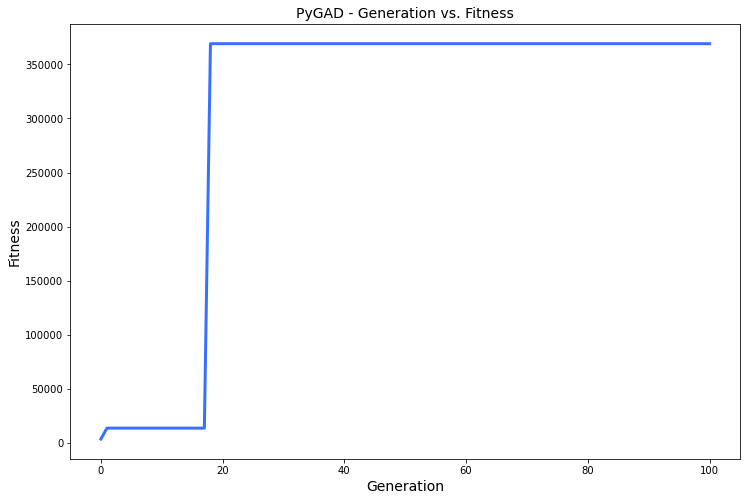

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 9.357 |==================| 596.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 9.363 |==================| 124.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 9.363 |==================| 124.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 9.359 |==================| 253.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 9.369 |==================| 71.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 9.335 |==================| 50.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 9.334 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.93 |==================| 23.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 23.971 |==================| 583.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.962 |==================| 93.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 23.934 |==================| 26.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.993 |==================| 48.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.977 |==================| 199.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 23.971 |==================| 583.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.962 |==================| 93.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 23.934 |==================| 26.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.993 |==================| 48.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.977 |==================| 199.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 23.979 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.993 |==================| 48.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.977 |==================| 199.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 23.979 |==================| 155.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.013 |==================| 24.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.91 |==================| 15.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.021 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 23.946 |==================| 37.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 23.996 |==================| 41.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.942 |==================| 32.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 23.894 |==================| 12.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.012 |==================| 25.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 23.891 |==================| 12.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 23.867 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.942 |==================| 32.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 23.894 |==================| 12.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.012 |==================| 25.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 23.891 |==================| 12.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 23.867 |==================| 9.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 23.942 |==================| 33.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 23.87 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 23.984 |==================| 84.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 23.998 |==================| 39.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 23.998 |==================| 39.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.013 |==================| 24.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.955 |==================| 56.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.008 |==================| 28.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 23.988 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 23.998 |==================| 39.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 23.998 |==================| 39.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.013 |==================| 24.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.955 |==================| 56.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.008 |==================| 28.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 23.988 |==================| 63.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 23.916 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 23.998 |==================| 39.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.013 |==================| 24.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.955 |==================| 56.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.008 |==================| 28.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 23.988 |==================| 63.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 23.916 |==================| 17.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 23.89 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.946 |==================| 38.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.933 |==================| 25.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.925 |==================| 20.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 23.919 |==================| 18.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 23.872 |==================| 9.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.009 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.933 |==================| 25.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.925 |==================| 20.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 23.919 |==================| 18.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 23.872 |==================| 9.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.009 |==================| 27.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 23.87 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.976 |==================| 276.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.005 |==================| 30.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 23.873 |==================| 10.085 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.009 |==================| 27.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.014 |==================| 23.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 23.873 |==================| 10.085 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.009 |==================| 27.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.014 |==================| 23.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.982 |==================| 105.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.981 |==================| 116.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 23.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 23.98 |==================| 136.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 23.992 |==================| 50.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.956 |==================| 62.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.02 |==================| 20.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 23.996 |==================| 41.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.98 |==================| 137.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 23.892 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 23.992 |==================| 50.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.956 |==================| 62.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.02 |==================| 20.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 23.996 |==================| 41.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.98 |==================| 137.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 23.892 |==================| 12.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.016 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.956 |==================| 62.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.02 |==================| 20.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 23.996 |==================| 41.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.98 |==================| 137.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 23.892 |==================| 12.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.016 |==================| 22.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 23.975 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 23.966 |==================| 152.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.017 |==================| 22.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 23.992 |==================| 51.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 23.872 |==================| 9.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.003 |==================| 32.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.011 |==================| 25.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.95 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.017 |==================| 22.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 23.992 |==================| 51.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 23.872 |==================| 9.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.003 |==================| 32.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.011 |==================| 25.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.95 |==================| 45.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 23.979 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 23.984 |==================| 86.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.981 |==================| 121.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 23.872 |==================| 9.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.929 |==================| 23.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.939 |==================| 30.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 23.999 |==================| 38.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 23.98 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.981 |==================| 121.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 23.872 |==================| 9.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.929 |==================| 23.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.939 |==================| 30.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 23.999 |==================| 38.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 23.98 |==================| 134.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 23.898 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 23.872 |==================| 9.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.929 |==================| 23.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.939 |==================| 30.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 23.999 |==================| 38.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 23.98 |==================| 134.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 23.898 |==================| 13.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 23.892 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.938 |==================| 29.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.925 |==================| 21.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.955 |==================| 57.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 23.982 |==================| 107.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 19.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |==================| 10.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.925 |==================| 21.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.955 |==================| 57.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 23.982 |==================| 107.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 19.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |==================| 10.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |==================| 59.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.99 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.022 |==================| 19.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.012 |==================| 24.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 23.875 |==================| 10.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.002 |==================| 33.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 23.986 |==================| 70.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 23.955 |==================| 56.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 23.885 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.012 |==================| 24.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 23.875 |==================| 10.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.002 |==================| 33.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 23.986 |==================| 70.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 23.955 |==================| 56.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 23.885 |==================| 11.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 23.897 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 23.986 |==================| 70.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 23.955 |==================| 56.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 23.885 |==================| 11.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 23.897 |==================| 13.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 23.994 |==================| 45.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.018 |==================| 21.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.923 |==================| 20.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.018 |==================| 21.923 |==========
Fitness = 1867.0910848193196
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.018 |==================| 21.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 109.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 23.982 |==================| 107.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 23.889 |==================| 11.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 109.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 23.982 |==================| 107.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 23.889 |==================| 11.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.022 |==================| 19.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 23.978 |==================| 174.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 23.997 |==================| 41.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.988 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.926 |==================| 21.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 23.874 |==================| 10.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |==================| 32.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.987 |==================| 67.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.926 |==================| 21.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.921 |==================| 19.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 23.962 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 23.874 |==================| 10.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |==================| 32.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.987 |==================| 67.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.926 |==================| 21.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.921 |==================| 19.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 23.962 |==================| 99.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 23.957 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.001 |==================| 35.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 23.945 |==================| 37.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 23.908 |==================| 15.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 23.995 |==================| 43.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.021 |==================| 20.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.022 |==================| 20.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.97 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 23.995 |==================| 43.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.021 |==================| 20.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.022 |==================| 20.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.97 |==================| 381.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.979 |==================| 150.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 23.95 |==================| 43.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 23.965 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.97 |==================| 381.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.979 |==================| 150.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 23.95 |==================| 43.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 23.965 |==================| 131.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 23.986 |==================| 75.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.005 |==================| 30.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 23.874 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.987 |==================| 69.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 23.89 |==================| 12.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 23.996 |==================| 42.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.961 |==================| 86.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.003 |==================| 32.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.006 |==================| 29.579 |==========
Fitness = 1867.0910848193196
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 23.89 |==================| 12.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 23.996 |==================| 42.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.961 |==================| 86.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.003 |==================| 32.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.006 |==================| 29.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 23.882 |==================| 11.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.022 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.011 |==================| 26.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 23.986 |==================| 74.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 23.96 |==================| 79.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 23.957 |==================| 67.232 |==========
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.97 |==================| 381.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.021 |==================| 20.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 23.984

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 23.986 |==================| 74.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 23.96 |==================| 79.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 23.957 |==================| 67.232 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.97 |==================| 381.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.021 |==================| 20.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 23.984 |==================| 87.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 23.993 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 23.96 |==================| 79.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 23.957 |==================| 67.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.938 |==================| 29.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 23.892 |==================| 12.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 23.903 |==================| 14.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 23.993 |==================| 49.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.023 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.934 |==================| 25.984 |==========
Fitness = 2053.0790609659625
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.938 |==================| 29.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 23.892 |==================| 12.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 23.903 |==================| 14.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 23.993 |==================| 49.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.023 |==================| 19.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.938 |==================| 29.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 23.892 |==================| 12.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 23.903 |==================| 14.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 23.993 |==================| 49.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.023 |==================| 19.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 23.979 |==================| 153.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 23.948 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 23.932 |==================| 24.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 23.935 |==================| 26.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 23.918 |==================| 18.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.958 |==================| 71.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 23.87 |==================| 9.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.976 |==================| 272.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.014 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 23.935 |==================| 26.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 23.918 |==================| 18.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.958 |==================| 71.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 23.87 |==================| 9.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.976 |==================| 272.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.014 |==================| 24.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 23.99 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 23.94 |==================| 31.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 23.902 |==================| 14.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.949 |==================| 42.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.948 |==================| 41.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 23.887 |==================| 11.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.974 |==================| 606.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.917 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 23.902 |==================| 14.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.949 |==================| 42.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.948 |==================| 41.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 23.887 |==================| 11.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.974 |==================| 606.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.917 |==================| 18.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.019 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.949 |==================| 42.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.948 |==================| 41.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 23.887 |==================| 11.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.974 |==================| 606.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.917 |==================| 18.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.019 |==================| 21.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 23.872 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 23.982 |==================| 104.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 23.991 |==================| 54.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.974 |==================| 532.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.922 |==================| 19.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 23.885 |==================| 11.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 23.968 |==================| 231.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.017 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 23.991 |==================| 54.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.974 |==================| 532.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.922 |==================| 19.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 23.885 |==================| 11.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 23.968 |==================| 231.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.017 |==================| 22.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.961 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 23.95 |==================| 44.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.919 |==================| 18.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.96 |==================| 79.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.988 |==================| 64.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 23.892 |==================| 12.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.953 |==================| 52.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 23.872 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.919 |==================| 18.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.96 |==================| 79.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.988 |==================| 64.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 23.892 |==================| 12.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.953 |==================| 52.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 23.872 |==================| 9.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 23.87 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.96 |==================| 79.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.988 |==================| 64.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 23.892 |==================| 12.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.953 |==================| 52.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 23.872 |==================| 9.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 23.87 |==================| 9.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 23.952 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 23.982 |==================| 107.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 23.92 |==================| 19.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 23.904 |==================| 14.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.919 |==================| 18.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.976 |==================| 285.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.011 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 23.92 |==================| 19.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 23.904 |==================| 14.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.919 |==================| 18.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.976 |==================| 285.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.011 |==================| 26.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 23.937 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 23.942 |==================| 32.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 23.972 |==================| 1577.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.991 |==================| 52.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 23.961 |==================| 91.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 23.868 |==================| 9.553 |==========
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 23.883 |==================| 11.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 23

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 23.961 |==================| 91.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 23.868 |==================| 9.553 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 23.883 |==================| 11.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 23.966 |==================| 153.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.924 |==================| 20.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.953 |==================| 53.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 23.873

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 23.868 |==================| 9.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.013 |==================| 24.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.014 |==================| 23.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 23.986 |==================| 73.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 23.915 |==================| 17.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 23.882 |==================| 11.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.988 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.013 |==================| 24.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.014 |==================| 23.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 23.986 |==================| 73.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 23.915 |==================| 17.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 23.882 |==================| 11.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.988 |==================| 62.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.01 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.014 |==================| 23.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 23.986 |==================| 73.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 23.915 |==================| 17.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 23.882 |==================| 11.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.988 |==================| 62.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.01 |==================| 26.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.005 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.918 |==================| 18.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 23.98 |==================| 125.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 23.997 |==================| 40.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 23.965 |==================| 138.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.907 |==================| 15.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 23.923 |==================| 20.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.979 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 23.98 |==================| 125.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 23.997 |==================| 40.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 23.965 |==================| 138.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.907 |==================| 15.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 23.923 |==================| 20.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.979 |==================| 149.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 23.969 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 109.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.927 |==================| 22.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 23.995 |==================| 44.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.004 |==================| 32.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 23.984 |==================| 87.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.951 |==================| 46.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.953 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.927 |==================| 22.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 23.995 |==================| 44.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.004 |==================| 32.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 23.984 |==================| 87.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.951 |==================| 46.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.953 |==================| 52.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.014 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 23.995 |==================| 44.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.004 |==================| 32.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 23.984 |==================| 87.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.951 |==================| 46.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.953 |==================| 52.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.014 |==================| 24.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.973 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 23.984 |==================| 85.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.018 |==================| 21.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 23.909 |==================| 15.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.974 |==================| 487.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.013 |==================| 24.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.92 |==================| 19.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 23.899 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.018 |==================| 21.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 23.909 |==================| 15.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.974 |==================| 487.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.013 |==================| 24.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.92 |==================| 19.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 23.899 |==================| 13.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.933 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.922 |==================| 19.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 23.9 |==================| 13.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.001 |==================| 34.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.003 |==================| 33.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 23.988 |==================| 64.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.006 |==================| 29.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 23.995 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 23.9 |==================| 13.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.001 |==================| 34.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.003 |==================| 33.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 23.988 |==================| 64.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.006 |==================| 29.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 23.995 |==================| 43.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.973 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.001 |==================| 34.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.003 |==================| 33.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 23.988 |==================| 64.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.006 |==================| 29.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 23.995 |==================| 43.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.973 |==================| 1087.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 23.879 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.988 |==================| 62.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.939 |==================| 30.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.0 |==================| 35.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.007 |==================| 29.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 23.944 |==================| 35.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 23.896 |==================| 13.185 |==========
Fitness = 2053.0790609659625
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.007 |==================| 29.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 23.944 |==================| 35.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 23.896 |==================| 13.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 23.917 |==================| 18.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 23.881 |==================| 10.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 23.898 |==================| 13.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 23.905 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 23.893 |==================| 12.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 23.901 |==================| 14.062 |==========
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 23.972 |==================| 8194.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 23.927 |==================| 22.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.986 |==================| 71.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.02 |==================| 20.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 23.901 |==================| 14.062 |==========
Change = 6141.694025400947
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 23.972 |==================| 8194.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 23.927 |==================| 22.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.986 |==================| 71.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.02 |==================| 20.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.935 |==================| 26.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 23.978 |==================| 174.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.961 |==================| 89.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 23.996 |==================| 41.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.02 |==================| 20.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.013 |==================| 24.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.948 |==================| 40.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.976 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.961 |==================| 89.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 23.996 |==================| 41.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.02 |==================| 20.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.013 |==================| 24.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.948 |==================| 40.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.976 |==================| 241.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 23.9 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 23.996 |==================| 41.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.02 |==================| 20.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.013 |==================| 24.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.948 |==================| 40.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.976 |==================| 241.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 23.9 |==================| 13.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.002 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 23.869 |==================| 9.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 23.87 |==================| 9.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 23.901 |==================| 14.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 23.989 |==================| 60.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.973 |==================| 1256.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 23.896 |==================| 13.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 23.962 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 23.87 |==================| 9.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 23.901 |==================| 14.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 23.989 |==================| 60.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.973 |==================| 1256.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 23.896 |==================| 13.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 23.962 |==================| 97.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 23.918 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 23.911 |==================| 16.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 23.929 |==================| 22.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 23.882 |==================| 11.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 23.992 |==================| 51.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.022 |==================| 20.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 23.893 |==================| 12.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.005 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 23.929 |==================| 22.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 23.882 |==================| 11.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 23.992 |==================| 51.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.022 |==================| 20.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 23.893 |==================| 12.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.005 |==================| 30.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.0 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 23.882 |==================| 11.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 23.992 |==================| 51.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.022 |==================| 20.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 23.893 |==================| 12.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.005 |==================| 30.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.0 |==================| 36.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.012 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.013 |==================| 24.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 23.984 |==================| 83.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 23.884 |==================| 11.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 23.997 |==================| 40.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 23.986 |==================| 74.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 23.991 |==================| 53.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.93 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 23.884 |==================| 11.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 23.997 |==================| 40.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 23.986 |==================| 74.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 23.991 |==================| 53.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.93 |==================| 23.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 23.925 |==================| 21.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 23.963 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.005 |==================| 30.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.934 |==================| 26.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 23.945 |==================| 37.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.987 |==================| 67.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.017 |==================| 22.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.977 |==================| 218.429 |==========
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 23.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.934 |==================| 26.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 23.945 |==================| 37.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.987 |==================| 67.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.017 |==================| 22.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.977 |==================| 218.429 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 23.993 |==================| 49.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 23.989

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.987 |==================| 67.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.017 |==================| 22.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.977 |==================| 218.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.948 |==================| 40.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 23.913 |==================| 16.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.011 |==================| 25.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.948 |==================| 40.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 23.913 |==================| 16.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.011 |==================| 25.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 23.905 |==================| 14.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 23.883 |==================| 11.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.022 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 23.913 |==================| 16.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.011 |==================| 25.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 23.905 |==================| 14.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 23.883 |==================| 11.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.022 |==================| 19.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 23.887 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.993 |==================| 48.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.008 |==================| 27.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 23.92 |==================| 19.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.97 |==================| 371.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 23.926 |==================| 21.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 23.894 |==================| 12.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.0 |==================| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.008 |==================| 27.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 23.92 |==================| 19.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.97 |==================| 371.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 23.926 |==================| 21.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 23.894 |==================| 12.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.0 |==================| 36.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.008 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 23.944 |==================| 35.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.966 |==================| 150.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 23.912 |==================| 16.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.001 |==================| 35.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 23.888 |==================| 11.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 23.94 |==================| 30.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.02 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.966 |==================| 150.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 23.912 |==================| 16.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.001 |==================| 35.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 23.888 |==================| 11.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 23.94 |==================| 30.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.02 |==================| 21.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 23.972 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 23.912 |==================| 16.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.001 |==================| 35.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 23.888 |==================| 11.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 23.94 |==================| 30.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.02 |==================| 21.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 23.972 |==================| 2211.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.018 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 23.883 |==================| 11.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.005 |==================| 30.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.023 |==================| 19.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 23.918 |==================| 18.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 23.983 |==================| 90.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 23.891 |==================| 12.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.974 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.023 |==================| 19.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 23.918 |==================| 18.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 23.983 |==================| 90.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 23.891 |==================| 12.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.974 |==================| 550.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 23.948 |==================| 41.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.008 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.91 |==================| 15.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 23.998 |==================| 38.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.003 |==================| 32.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.016 |==================| 22.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 23.898 |==================| 13.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 23.994 |==================| 45.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.003 |==================| 32.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.016 |==================| 22.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 23.898 |==================| 13.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 23.994 |==================| 45.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.75 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.974 |==================| 805.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 23.87 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 23.994 |==================| 45.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.98 |==================| 122.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.923 |==================| 20.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 23.981 |==================| 109.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.956 |==================| 61.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 23.941 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 23.867 |==================| 9.476 |==========
Fitness = 39148.53996062507
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.98 |==================| 122.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.923 |==================| 20.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 23.981 |==================| 109.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.956 |==================| 61.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 23.941 |==================| 32.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.98 |==================| 122.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.923 |==================| 20.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 23.981 |==================| 109.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.956 |==================| 61.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 23.941 |==================| 32.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 23.888 |==================| 11.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 23.912 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.01 |==================| 26.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |==================| 28.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.005 |==================| 30.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.005 |==================| 30.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.972 |==================| 26580.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 23.88 |==================| 10.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.97 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |==================| 28.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.005 |==================| 30.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.005 |==================| 30.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.972 |==================| 26580.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 23.88 |==================| 10.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.97 |==================| 385.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 23.918 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 23.889 |==================| 12.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.019 |==================| 21.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 23.87 |==================| 9.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 23.888 |==================| 11.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.023 |==================| 19.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.02 |==================| 21.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.978 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.019 |==================| 21.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 23.87 |==================| 9.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 23.888 |==================| 11.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.023 |==================| 19.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.02 |==================| 21.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.978 |==================| 190.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 23.877 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 23.87 |==================| 9.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 23.888 |==================| 11.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.023 |==================| 19.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.02 |==================| 21.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.978 |==================| 190.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 23.877 |==================| 10.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 23.994 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 23.988 |==================| 65.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.019 |==================| 21.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.023 |==================| 19.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 23.999 |==================| 37.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 23.978 |==================| 184.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.012 |==================| 24.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.007 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.019 |==================| 21.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.023 |==================| 19.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 23.999 |==================| 37.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 23.978 |==================| 184.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.012 |==================| 24.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.007 |==================| 29.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.006 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 23.981 |==================| 115.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 23.942 |==================| 33.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.021 |==================| 20.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.014 |==================| 24.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 23.936 |==================| 27.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 23.906 |==================| 15.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 23.87 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 23.942 |==================| 33.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.021 |==================| 20.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.014 |==================| 24.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 23.936 |==================| 27.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 23.906 |==================| 15.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 23.87 |==================| 9.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.973 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.021 |==================| 20.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.014 |==================| 24.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 23.936 |==================| 27.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 23.906 |==================| 15.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 23.87 |==================| 9.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.973 |==================| 3334.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.966 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 23.993 |==================| 49.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 23.889 |==================| 12.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 23.872 |==================| 9.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.971 |==================| 646.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.981 |==================| 116.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 23.969 |==================| 309.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.922 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.971 |==================| 646.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.981 |==================| 116.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 23.969 |==================| 309.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.922 |==================| 19.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 23.914 |==================| 17.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 23.869 |==================| 9.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.02 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.004 |==================| 31.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.012 |==================| 25.335 |==========
Generation = 46
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 23.931 |==================| 24.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.013 |==================| 24.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 23.868 |==================| 9.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 23.996 |==================| 42.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 23.9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.013 |==================| 24.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 23.868 |==================| 9.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 23.996 |==================| 42.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 23.901 |==================| 14.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.019 |==================| 21.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 23.973 |==================| 1344.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 23.954 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.021 |==================| 20.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 23.916 |==================| 17.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.936 |==================| 27.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.007 |==================| 28.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.98 |==================| 122.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 23.906 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 23.916 |==================| 17.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.936 |==================| 27.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.007 |==================| 28.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.98 |==================| 122.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 23.906 |==================| 14.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.014 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.936 |==================| 27.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.007 |==================| 28.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.98 |==================| 122.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 23.906 |==================| 14.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.014 |==================| 23.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.886 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.974 |==================| 462.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 23.942 |==================| 33.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 23.968 |==================| 244.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.977 |==================| 212.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 23.879 |==================| 10.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 23.952 |==================| 50.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.017 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 23.942 |==================| 33.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 23.968 |==================| 244.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.977 |==================| 212.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 23.879 |==================| 10.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 23.952 |==================| 50.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.017 |==================| 22.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 23.985 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.005 |==================| 30.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.0 |==================| 35.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 23.996 |==================| 42.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 23.979 |==================| 152.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.954 |==================| 53.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 23.867 |==================| 9.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.979 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.0 |==================| 35.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 23.996 |==================| 42.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 23.979 |==================| 152.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.954 |==================| 53.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 23.867 |==================| 9.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.979 |==================| 140.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 23.994 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 23.996 |==================| 42.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 23.979 |==================| 152.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.954 |==================| 53.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 23.867 |==================| 9.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.979 |==================| 140.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 23.994 |==================| 46.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 23.939 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.923 |==================| 20.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.006 |==================| 29.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 23.89 |==================| 12.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 23.995 |==================| 43.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.008 |==================| 27.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.987 |==================| 70.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.95 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.006 |==================| 29.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 23.89 |==================| 12.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 23.995 |==================| 43.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.008 |==================| 27.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.987 |==================| 70.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.95 |==================| 44.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.011 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 23.98 |==================| 129.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 23.998 |==================| 38.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.001 |==================| 34.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 23.898 |==================| 13.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 23.879 |==================| 10.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.004 |==================| 31.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 23.906 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 23.998 |==================| 38.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.001 |==================| 34.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 23.898 |==================| 13.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 23.879 |==================| 10.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.004 |==================| 31.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 23.906 |==================| 15.057 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 23.90

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.001 |==================| 34.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 23.898 |==================| 13.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 23.879 |==================| 10.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.004 |==================| 31.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 23.906 |==================| 15.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.974 |==================| 626.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 23.914 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 23.885 |==================| 11.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 23.982 |==================| 100.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.02 |==================| 21.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 23.874 |==================| 10.159 |==========
Fitness = 39148.53996062507
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.974 |==================| 626.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 23.914 |==================| 17.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 23.874 |==================| 10.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.974 |==================| 626.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 23.914 |==================| 17.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 109.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 23.871 |==================| 9.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.988 |==================| 64.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.988 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 23.988 |==================| 61.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.015 |==================| 23.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 23.985 |==================| 81.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 23.991 |==================| 52.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.954 |==================| 55.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.988 |==================| 61.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.019 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 23.991 |==================| 52.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.954 |==================| 55.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.988 |==================| 61.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.019 |==================| 21.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 23.978 |==================| 163.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 23.982 |==================| 98.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 23.999 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 23.996 |==================| 42.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 23.999 |==================| 37.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 23.891 |==================| 12.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 23.958 |==================| 70.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 23.982 |==================| 99.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 23.867 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 23.999 |==================| 37.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 23.891 |==================| 12.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 23.958 |==================| 70.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 23.982 |==================| 99.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 23.867 |==================| 9.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.957 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 23.891 |==================| 12.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 23.958 |==================| 70.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 23.982 |==================| 99.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 23.867 |==================| 9.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.957 |==================| 64.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 23.991 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 23.876 |==================| 10.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 23.946 |==================| 37.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.021 |==================| 20.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.92 |==================| 19.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.926 |==================| 21.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 23.905 |==================| 14.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.006 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 23.946 |==================| 37.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.021 |==================| 20.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.92 |==================| 19.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.926 |==================| 21.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 23.905 |==================| 14.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.006 |==================| 29.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.993 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.957 |==================| 65.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.956 |==================| 60.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 23.877 |==================| 10.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 23.999 |==================| 36.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.934 |==================| 26.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 23.932 |==================| 24.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 23.989 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.956 |==================| 60.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 23.877 |==================| 10.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 23.999 |==================| 36.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.934 |==================| 26.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 23.932 |==================| 24.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 23.989 |==================| 59.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 23.877 |==================| 10.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 23.999 |==================| 36.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.934 |==================| 26.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 23.932 |==================| 24.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 23.989 |==================| 59.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==================| 21.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.019 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.982 |==================| 104.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.942 |==================| 32.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.954 |==================| 54.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.009 |==================| 27.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 23.935 |==================| 27.071 |==========
Fitness = 39148.53996062507
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.019 |==================| 21.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.954 |==================| 54.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.009 |==================| 27.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 23.935 |==================| 27.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.019 |==================| 21.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.0 |==================| 36.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 23.898 |==================| 13.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.015 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.963 |==================| 107.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.943 |==================| 34.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 23.874 |==================| 10.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 23.887 |==================| 11.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.993 |==================| 48.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |==================| 28.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 23.966 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.943 |==================| 34.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 23.874 |==================| 10.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 23.887 |==================| 11.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.993 |==================| 48.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |==================| 28.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 23.966 |==================| 152.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 23.989 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.956 |==================| 61.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.011 |==================| 25.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.986 |==================| 70.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.017 |==================| 22.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 23.994 |==================| 47.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.921 |==================| 19.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 23.891 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.011 |==================| 25.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.986 |==================| 70.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.017 |==================| 22.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 23.994 |==================| 47.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.921 |==================| 19.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 23.891 |==================| 12.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 23.873 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.986 |==================| 70.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.017 |==================| 22.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 23.994 |==================| 47.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.921 |==================| 19.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 23.891 |==================| 12.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 23.873 |==================| 10.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 23.909 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 23.996 |==================| 41.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.017 |==================| 22.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 23.883 |==================| 11.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 23.949 |==================| 42.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 23.909 |==================| 15.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 23.994 |==================| 45.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.98 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.017 |==================| 22.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 23.883 |==================| 11.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 23.949 |==================| 42.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 23.909 |==================| 15.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 23.994 |==================| 45.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.98 |==================| 122.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 23.931 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.907 |==================| 15.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.0 |==================| 36.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.015 |==================| 23.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.0 |==================| 36.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 23.998 |==================| 39.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 23.985 |==================| 80.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 23.92 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.0 |==================| 36.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.015 |==================| 23.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.0 |==================| 36.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 23.998 |==================| 39.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 23.985 |==================| 80.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 23.92 |==================| 19.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 23.999 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.015 |==================| 23.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.0 |==================| 36.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 23.998 |==================| 39.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 23.985 |==================| 80.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 23.92 |==================| 19.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 23.999 |==================| 37.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.007 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 23.871 |==================| 9.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.989 |==================| 61.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.927 |==================| 21.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.976 |==================| 276.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 23.876 |==================| 10.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 23.998 |==================| 38.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 23.989 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.989 |==================| 61.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.927 |==================| 21.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.976 |==================| 276.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 23.876 |==================| 10.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 23.998 |==================| 38.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 23.989 |==================| 59.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 23.995 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 23.908 |==================| 15.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 23.888 |==================| 11.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 23.996 |==================| 42.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 23.899 |==================| 13.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 23.968 |==================| 227.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.02 |==================| 20.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.009 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 23.888 |==================| 11.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 23.996 |==================| 42.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 23.899 |==================| 13.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 23.968 |==================| 227.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.02 |==================| 20.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.009 |==================| 26.984 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 23.928

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 23.899 |==================| 13.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 23.968 |==================| 227.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.02 |==================| 20.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.009 |==================| 26.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.012 |==================| 24.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 23.896 |==================| 13.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 23.916 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.019 |==================| 21.452 |==========
Fitness = 39148.53996062507
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.012 |==================| 24.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 23.896 |==================| 13.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 23.916 |==================| 17.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 23.979 |==================| 142.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 23.903 |==================| 14.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.012 |==================| 24.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 23.896 |==================| 13.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 23.916 |==================| 17.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 23.979 |==================| 142.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 23.903 |==================| 14.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.955 |==================| 58.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 23.999 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 23.976 |==================| 263.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 23.925 |==================| 21.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 23.877 |==================| 10.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 23.897 |==================| 13.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 23.949 |==================| 43.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.021 |==================| 20.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 23.958 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 23.925 |==================| 21.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 23.877 |==================| 10.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 23.897 |==================| 13.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 23.949 |==================| 43.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.021 |==================| 20.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 23.958 |==================| 70.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.971 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.932 |==================| 25.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.019 |==================| 21.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.008 |==================| 27.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 23.991 |==================| 53.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.004 |==================| 31.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 23.918 |==================| 18.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 23.995 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.019 |==================| 21.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.008 |==================| 27.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 23.991 |==================| 53.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.004 |==================| 31.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 23.918 |==================| 18.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 23.995 |==================| 44.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.003 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.008 |==================| 27.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 23.991 |==================| 53.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.004 |==================| 31.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 23.918 |==================| 18.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 23.995 |==================| 44.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.003 |==================| 32.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 23.996 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 23.955 |==================| 59.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 23.919 |==================| 18.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 23.867 |==================| 9.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.982 |==================| 104.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 23.988 |==================| 62.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 23.916 |==================| 17.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.971 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.982 |==================| 104.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 23.988 |==================| 62.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 23.916 |==================| 17.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.971 |==================| 1062.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.943 |==================| 34.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.0 |==================| 35.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.945 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 23.98 |==================| 126.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.008 |==================| 28.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 23.93 |==================| 23.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.941 |==================| 31.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.976 |==================| 264.704 |==========
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 23.997 |==================| 41.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.02

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.008 |==================| 28.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 23.93 |==================| 23.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.941 |==================| 31.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.976 |==================| 264.704 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 23.997 |==================| 41.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.02 |==================| 21.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 23.992 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 23.93 |==================| 23.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.941 |==================| 31.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.976 |==================| 264.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.938 |==================| 29.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.988 |==================| 63.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.921 |==================| 19.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 23.919 |==================| 18.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 23.996 |==================| 41.698 |==========
Fitness = 39148.53996062507
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.938 |==================| 29.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.988 |==================| 63.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.921 |==================| 19.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |==================| 10.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 23.996 |==================| 41.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.938 |==================| 29.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.988 |==================| 63.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.921 |==================| 19.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |==================| 10.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 23.896 |==================| 13.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.016 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 23.989 |==================| 58.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 23.878 |==================| 10.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.973 |==================| 1041.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.972 |==================| 4617.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 23.866 |==================| 9.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 23.989 |==================| 58.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.001 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.973 |==================| 1041.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.972 |==================| 4617.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 23.866 |==================| 9.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 23.989 |==================| 58.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.001 |==================| 35.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.004 |==================| 31.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.953 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.002 |==================| 34.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.018 |==================| 21.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 23.949 |==================| 43.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.93 |==================| 23.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.004 |==================| 31.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 23.872 |==================| 9.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 23.97 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.018 |==================| 21.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 23.949 |==================| 43.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.93 |==================| 23.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.004 |==================| 31.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 23.872 |==================| 9.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 23.97 |==================| 497.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.0 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 23.949 |==================| 43.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.93 |==================| 23.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.004 |==================| 31.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 23.872 |==================| 9.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 23.97 |==================| 497.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.0 |==================| 35.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.021 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.003 |==================| 33.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.966 |==================| 148.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.007 |==================| 28.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 23.933 |==================| 25.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 23.931 |==================| 24.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 23.891 |==================| 12.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.949 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.966 |==================| 148.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.007 |==================| 28.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 23.933 |==================| 25.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 23.931 |==================| 24.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 23.891 |==================| 12.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.949 |==================| 42.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.008 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 23.931 |==================| 24.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 23.985 |==================| 78.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.93 |==================| 23.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 23.914 |==================| 17.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 23.99 |==================| 55.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 23.873 |==================| 10.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.94 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 23.914 |==================| 17.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 23.99 |==================| 55.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 23.873 |==================| 10.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.94 |==================| 30.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.014 |==================| 23.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 23.991 |==================| 54.692 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 23.944 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.94 |==================| 30.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.014 |==================| 23.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 23.991 |==================| 54.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.003 |==================| 33.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 23.923 |==================| 20.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 23.889 |==================| 11.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 23.999 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.003 |==================| 33.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 23.923 |==================| 20.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 23.889 |==================| 11.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 23.999 |==================| 37.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 23.903 |==================| 14.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.01 |==================| 26.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 23.887 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 23.923 |==================| 20.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 23.889 |==================| 11.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 23.999 |==================| 37.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 23.903 |==================| 14.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.01 |==================| 26.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 23.887 |==================| 11.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.017 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.009 |==================| 27.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 23.998 |==================| 38.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 23.968 |==================| 243.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 23.881 |==================| 10.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 23.93 |==================| 23.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.977 |==================| 206.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 23.884 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 23.998 |==================| 38.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 23.968 |==================| 243.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 23.881 |==================| 10.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 23.93 |==================| 23.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.977 |==================| 206.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 23.884 |==================| 11.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 23.922 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 23.913 |==================| 16.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 23.913 |==================| 16.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 23.913 |==================| 16.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 23.974 |==================| 698.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 23.959 |==================| 73.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.012 |==================| 25.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 23.883 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 23.974 |==================| 698.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 23.959 |==================| 73.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.012 |==================| 25.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 23.883 |==================| 11.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.986 |==================| 71.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 23.942 |==================| 33.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.012 |==================| 25.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 23.883 |==================| 11.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.986 |==================| 71.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 23.942 |==================| 33.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |==================| 28.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.94 |==================| 31.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 23.982 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 23.891 |==================| 12.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.923 |==================| 20.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.99 |==================| 57.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 23.999 |==================| 37.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 23.937 |==================| 28.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 23.937 |==================| 28.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 23.886 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 23.999 |==================| 37.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 23.937 |==================| 28.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 23.937 |==================| 28.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 23.886 |==================| 11.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 23.99 |==================| 56.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.955 |==================| 58.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 23.973 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.922 |==================| 19.844 |==========
Generation = 78
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.936 |==================| 27.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 23.986 |==================| 72.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.018 |==================| 22.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.012 |==================| 25.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 23.92 |==================| 19.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.936 |==================| 27.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 23.986 |==================| 72.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.018 |==================| 22.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.012 |==================| 25.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 23.92 |==================| 19.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.01 |==================| 26.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 23.891 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.927 |==================| 22.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.953 |==================| 52.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 23.997 |==================| 39.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.922 |==================| 19.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.021 |==================| 20.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.006 |==================| 30.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.011 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.953 |==================| 52.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 23.997 |==================| 39.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.922 |==================| 19.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.021 |==================| 20.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.006 |==================| 30.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.011 |==================| 25.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 23.884 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 23.997 |==================| 39.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.922 |==================| 19.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.021 |==================| 20.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.006 |==================| 30.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.011 |==================| 25.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 23.884 |==================| 11.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.959 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 23.9 |==================| 13.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.023 |==================| 19.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.018 |==================| 21.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 23.869 |==================| 9.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.955 |==================| 58.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 23.976 |==================| 259.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.988 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.018 |==================| 21.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 23.869 |==================| 9.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.955 |==================| 58.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 23.976 |==================| 259.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.988 |==================| 64.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 23.902 |==================| 14.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 23.911 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.017 |==================| 22.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.957 |==================| 65.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.023 |==================| 19.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 23.939 |==================| 30.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 23.984 |==================| 84.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 23.927 |==================| 22.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.976 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.957 |==================| 65.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.023 |==================| 19.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 23.939 |==================| 30.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 23.984 |==================| 84.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 23.927 |==================| 22.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.976 |==================| 267.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 23.984 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.023 |==================| 19.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 23.939 |==================| 30.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 23.984 |==================| 84.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 23.927 |==================| 22.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.976 |==================| 267.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 23.984 |==================| 87.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 23.905 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.941 |==================| 31.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.015 |==================| 23.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 23.917 |==================| 18.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 23.996 |==================| 42.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.953 |==================| 52.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 23.911 |==================| 16.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 23.887 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.015 |==================| 23.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 23.917 |==================| 18.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 23.996 |==================| 42.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.953 |==================| 52.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 23.911 |==================| 16.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 23.887 |==================| 11.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 23.978 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 23.891 |==================| 12.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.986 |==================| 71.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.992 |==================| 50.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 23.995 |==================| 43.595 |==========
Generation = 83
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.927 |==================| 22.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 23.893 |==================| 12.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 23

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 23.995 |==================| 43.595 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.927 |==================| 22.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 23.893 |==================| 12.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 23.987 |==================| 68.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.019 |==================| 21.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 23.987 |==================| 67.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 23.88

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 23.997 |==================| 39.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 23.993 |==================| 47.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 23.968 |==================| 233.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.002 |==================| 33.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 23.897 |==================| 13.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.886 |==================| 11.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.018 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 23.993 |==================| 47.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 23.968 |==================| 233.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.002 |==================| 33.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 23.897 |==================| 13.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.886 |==================| 11.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.018 |==================| 21.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.015 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 23.968 |==================| 233.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.002 |==================| 33.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 23.897 |==================| 13.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.886 |==================| 11.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.018 |==================| 21.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.015 |==================| 23.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.979 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.003 |==================| 32.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.321 |===========| 23.886 |==================| 11.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.986 |==================| 71.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 23.91 |==================| 16.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 23.996 |==================| 41.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.992 |==================| 50.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 23.908 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.321 |===========| 23.886 |==================| 11.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.986 |==================| 71.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 23.91 |==================| 16.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 23.996 |==================| 41.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.992 |==================| 50.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 23.908 |==================| 15.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 23.919 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.98 |==================| 128.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.0 |==================| 36.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.008 |==================| 28.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.953 |==================| 52.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 23.982 |==================| 98.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 23.907 |==================| 15.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.944 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.0 |==================| 36.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.008 |==================| 28.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.953 |==================| 52.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 23.982 |==================| 98.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 23.907 |==================| 15.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.944 |==================| 35.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.002 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.953 |==================| 52.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 23.982 |==================| 98.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 23.907 |==================| 15.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.944 |==================| 35.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.002 |==================| 33.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.989 |==================| 58.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 23.891 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.017 |==================| 22.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.973 |==================| 1103.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 23.996 |==================| 42.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 23.994 |==================| 46.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 23.971 |==================| 582.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.009 |==================| 27.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 23.91 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 23.994 |==================| 46.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 23.971 |==================| 582.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.009 |==================| 27.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 23.91 |==================| 16.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 23.96 |==================| 79.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 23.87 |==================| 9.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.009 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 23.97 |==================| 555.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 23.886 |==================| 11.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 23.919 |==================| 18.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 23.894 |==================| 12.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.008 |==================| 27.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.002 |==================| 33.541 |==========
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 23.9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 23.886 |==================| 11.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 23.919 |==================| 18.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 23.894 |==================| 12.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.008 |==================| 27.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.002 |==================| 33.541 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 23.928 |==================| 22.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 23.873 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 23.919 |==================| 18.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 23.894 |==================| 12.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.008 |==================| 27.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.002 |==================| 33.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 23.907 |==================| 15.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 23.995 |==================| 43.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.004 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.979 |==================| 150.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 23.94 |==================| 30.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 23.888 |==================| 11.896 |==========
Fitness = 39148.53996062507
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 23.907 |==================| 15.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 23.995 |==================| 43.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.004 |==================| 31.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 23.94 |==================| 30.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 23.888 |==================| 11.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 23.907 |==================| 15.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 23.995 |==================| 43.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.004 |==================| 31.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.001 |==================| 34.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.002 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 23.891 |==================| 12.252 |==========
Generation = 90
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 23.867 |==================| 9.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.014 |==================| 23.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 23.867 |==================| 9.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 23.979 |==================| 152.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 23.997 |==================| 40.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 23.9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 23.867 |==================| 9.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.014 |==================| 23.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 23.867 |==================| 9.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 23.979 |==================| 152.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 23.997 |==================| 40.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 23.968 |==================| 262.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.015 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.016 |==================| 22.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 23.893 |==================| 12.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.019 |==================| 21.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 23.885 |==================| 11.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.956 |==================| 62.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.973 |==================| 843.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 23.895 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 23.893 |==================| 12.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.019 |==================| 21.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 23.885 |==================| 11.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.956 |==================| 62.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.973 |==================| 843.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 23.895 |==================| 12.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 23.89 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.019 |==================| 21.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 23.885 |==================| 11.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.956 |==================| 62.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.973 |==================| 843.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 23.895 |==================| 12.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 23.89 |==================| 12.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 23.996 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 23.915 |==================| 17.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 23.948 |==================| 40.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.015 |==================| 23.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.947 |==================| 39.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 23.942 |==================| 32.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 23.966 |==================| 154.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 23.928 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 23.948 |==================| 40.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.015 |==================| 23.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.947 |==================| 39.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 23.942 |==================| 32.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 23.966 |==================| 154.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 23.928 |==================| 22.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 23.876 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.0 |==================| 35.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 23.917 |==================| 18.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 23.996 |==================| 41.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 23.913 |==================| 16.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 23.998 |==================| 38.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |==================| 60.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 23.979 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 23.917 |==================| 18.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 23.996 |==================| 41.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 23.913 |==================| 16.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 23.998 |==================| 38.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |==================| 60.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 23.979 |==================| 142.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.001 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 23.996 |==================| 41.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 23.913 |==================| 16.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 23.998 |==================| 38.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |==================| 60.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 23.979 |==================| 142.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.001 |==================| 34.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 23.874 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 23.931 |==================| 23.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.979 |==================| 151.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.954 |==================| 53.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 23.975 |==================| 371.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.01 |==================| 26.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.018 |==================| 22.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.987 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.979 |==================| 151.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.954 |==================| 53.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 23.975 |==================| 371.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.01 |==================| 26.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.018 |==================| 22.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.987 |==================| 69.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.989 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.013 |==================| 24.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 23.889 |==================| 11.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.956 |==================| 61.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.004 |==================| 31.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.022 |==================| 20.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 23.886 |==================| 11.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 23.945 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 23.889 |==================| 11.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.956 |==================| 61.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.004 |==================| 31.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.022 |==================| 20.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 23.886 |==================| 11.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 23.945 |==================| 36.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.956 |==================| 61.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.004 |==================| 31.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.022 |==================| 20.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 23.886 |==================| 11.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 23.945 |==================| 36.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.003 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 23.985 |==================| 81.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 23.903 |==================| 14.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.933 |==================| 25.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.003 |==================| 32.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.018 |==================| 22.013 |==========
Fitness = 39148.53996062507
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.003 |==================| 32.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 23.903 |==================| 14.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.933 |==================| 25.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.003 |==================| 32.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.018 |==================| 22.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.003 |==================| 32.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.008 |==================| 27.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 23.97 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.016 |==================| 22.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 23.995 |==================| 43.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 23.883 |==================| 11.146 |==========
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.0 |==================| 36.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 23.983 |==================| 89.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.956 |==================| 61.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.974

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 23.883 |==================| 11.146 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.0 |==================| 36.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 23.983 |==================| 89.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.956 |==================| 61.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.974 |==================| 474.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.934 |==================| 26.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 23.983 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.976 |==================| 242.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 23.879 |==================| 10.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |==================| 32.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.873 |==================| 10.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 23.881 |==================| 10.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 23.996 |==================| 42.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 23.99 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 23.879 |==================| 10.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |==================| 32.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.873 |==================| 10.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 23.881 |==================| 10.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 23.996 |==================| 42.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 23.99 |==================| 55.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 23.906 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |==================| 32.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.873 |==================| 10.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 23.881 |==================| 10.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 23.996 |==================| 42.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 23.99 |==================| 55.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 23.906 |==================| 15.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 23.998 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.022 |==================| 20.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 19.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.975 |==================| 328.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.005 |==================| 30.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.948 |==================| 41.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 23.902 |==================| 14.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.956 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 19.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.975 |==================| 328.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.005 |==================| 30.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.948 |==================| 41.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 23.902 |==================| 14.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.956 |==================| 59.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.927 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.957 |==================| 66.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.016 |==================| 23.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 23.884 |==================| 11.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 23.985 |==================| 76.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.021 |==================| 20.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 23.962 |==================| 98.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.972 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.016 |==================| 23.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 23.884 |==================| 11.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 23.985 |==================| 76.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.021 |==================| 20.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 23.962 |==================| 98.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.972 |==================| 12721.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 23.99 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 23.884 |==================| 11.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 23.985 |==================| 76.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.021 |==================| 20.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 23.962 |==================| 98.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.972 |==================| 12721.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 23.99 |==================| 57.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |=========

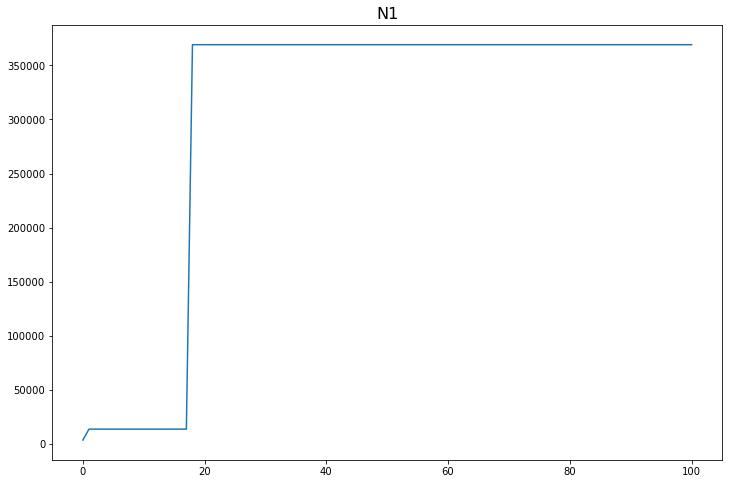

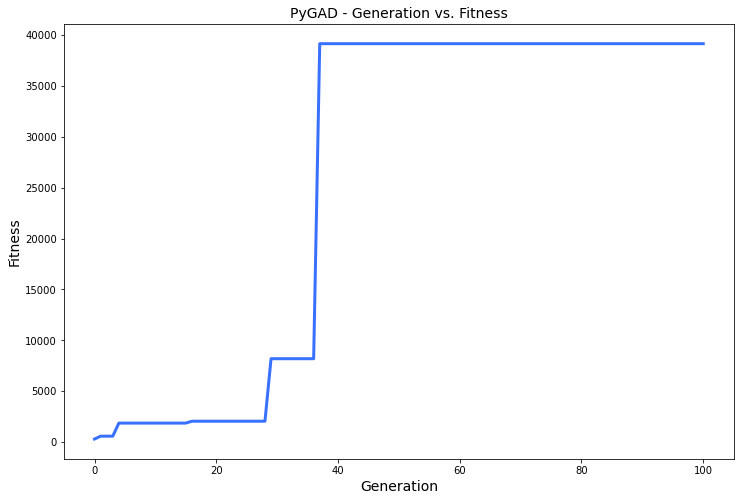

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.993 |==================| 48.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 23.994 |==================| 45.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.017 |==================| 22.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 23.876 |==================| 10.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 23.988 |==================| 61.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 23.983 |==================| 92.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 23.903 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 28.693 |==================| 6.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 28.657 |==================| 5.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.964 |==================| 9.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.945 |==================| 11.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.901 |==================| 21.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.516 |===========| 28.557 |==================| 3.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 28.712 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.945 |==================| 11.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.901 |==================| 21.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.516 |===========| 28.557 |==================| 3.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 28.712 |==================| 7.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.753 |==================| 9.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.798 |==================| 17.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 28.953 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.901 |==================| 21.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.516 |===========| 28.557 |==================| 3.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 28.712 |==================| 7.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.753 |==================| 9.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.798 |==================| 17.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 28.953 |==================| 10.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 28.923 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 28.931 |==================| 12.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 28.871 |==================| 59.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.835 |==================| 51.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.819 |==================| 28.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.736 |==================| 8.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.881 |==================| 37.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 28.605 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.819 |==================| 28.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.736 |==================| 8.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.881 |==================| 37.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 28.605 |==================| 4.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.517 |===========| 28.557 |==================| 3.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 28.573 |==================| 3.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.823 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.934 |==================| 12.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.904 |==================| 20.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 28.761 |==================| 10.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.938 |==================| 11.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 28.938 |==================| 11.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 28.639 |==================| 4.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 28.612 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.904 |==================| 20.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 28.761 |==================| 10.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.938 |==================| 11.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 28.938 |==================| 11.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 28.639 |==================| 4.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 28.612 |==================| 4.129 |==========
Change = 69.05036404746973
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.938 |==================| 11.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 28.938 |==================| 11.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 28.639 |==================| 4.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 28.612 |==================| 4.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.754 |==================| 10.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |==================| 37.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.891 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.958 |==================| 9.669 |==========
Fitness = 259.60436362582317
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.754 |==================| 10.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |==================| 37.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.891 |==================| 26.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.799 |==================| 17.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.968 |==================| 8.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.754 |==================| 10.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |==================| 37.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.891 |==================| 26.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.799 |==================| 17.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.968 |==================| 8.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.774 |==================| 12.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.953 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.785 |==================| 14.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.811 |==================| 23.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.928 |==================| 13.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.866 |==================| 82.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.952 |==================| 10.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 28.711 |==================| 6.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 28.664 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.811 |==================| 23.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.928 |==================| 13.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.866 |==================| 82.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.952 |==================| 10.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 28.711 |==================| 6.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 28.664 |==================| 5.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 28.591 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 28.945 |==================| 11.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 28.671 |==================| 5.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.94 |==================| 11.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.788 |==================| 15.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.84 |==================| 71.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 28.696 |==================| 6.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 28.794 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 28.671 |==================| 5.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.94 |==================| 11.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.788 |==================| 15.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.84 |==================| 71.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 28.696 |==================| 6.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 28.794 |==================| 16.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 28.687 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.94 |==================| 11.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.788 |==================| 15.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.84 |==================| 71.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 28.696 |==================| 6.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 28.794 |==================| 16.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 28.687 |==================| 5.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 28.619 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 28.967 |==================| 8.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 28.748 |==================| 9.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 28.703 |==================| 6.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 28.946 |==================| 10.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 28.817 |==================| 26.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 28.777 |==================| 12.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.817 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 28.748 |==================| 9.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 28.703 |==================| 6.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 28.946 |==================| 10.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 28.817 |==================| 26.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 28.777 |==================| 12.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.817 |==================| 27.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.893 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 28.742 |==================| 8.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 28.812 |==================| 23.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.869 |==================| 68.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 28.648 |==================| 4.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.663 |==================| 5.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 28.659 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 28.61 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 28.812 |==================| 23.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.869 |==================| 68.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 28.648 |==================| 4.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.663 |==================| 5.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 28.659 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 28.61 |==================| 4.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.925 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.869 |==================| 68.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 28.648 |==================| 4.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.663 |==================| 5.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 28.659 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 28.61 |==================| 4.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.925 |==================| 14.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.952 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.893 |==================| 25.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.882 |==================| 36.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 28.861 |==================| 146.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.74 |==================| 8.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.59 |==================| 3.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.954 |==================| 10.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.89 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.882 |==================| 36.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 28.861 |==================| 146.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.74 |==================| 8.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.59 |==================| 3.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.954 |==================| 10.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.89 |==================| 28.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 28.612 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.912 |==================| 17.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 28.73 |==================| 8.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 28.704 |==================| 6.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 28.634 |==================| 4.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.809 |==================| 22.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 28.711 |==================| 6.976 |==========
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.765 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 28.73 |==================| 8.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 28.704 |==================| 6.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 28.634 |==================| 4.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.809 |==================| 22.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 28.711 |==================| 6.976 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.765 |==================| 11.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.891 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 28.704 |==================| 6.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 28.634 |==================| 4.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.809 |==================| 22.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 28.711 |==================| 6.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |==================| 16.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.89 |==================| 28.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 28.91 |==================| 17.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 28.751 |==================| 9.654 |==========
Fitness = 1884.209809535589
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |==================| 16.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.89 |==================| 28.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==================| 11.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 28.801 |==================| 18.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.89 |==================| 28.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==================| 11.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 28.801 |==================| 18.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 28.631 |==================| 4.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.683 |==================| 5.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.926 |==================| 13.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 28.92 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.589 |==================| 3.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 28.772 |==================| 12.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.726 |==================| 7.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.911 |==================| 17.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.801 |==================| 18.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.917 |==================| 16.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 28.762 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 28.772 |==================| 12.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.726 |==================| 7.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.911 |==================| 17.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.801 |==================| 18.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.917 |==================| 16.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 28.762 |==================| 10.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 28.66 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.865 |==================| 95.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 28.888 |==================| 29.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 28.654 |==================| 4.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.69 |==================| 6.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.908 |==================| 18.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.97 |==================| 8.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 28.585 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 28.888 |==================| 29.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 28.654 |==================| 4.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.69 |==================| 6.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.908 |==================| 18.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.97 |==================| 8.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 28.585 |==================| 3.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.93 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 28.654 |==================| 4.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.69 |==================| 6.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.908 |==================| 18.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.97 |==================| 8.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 28.585 |==================| 3.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.93 |==================| 13.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 28.9 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 28.64 |==================| 4.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.95 |==================| 10.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.929 |==================| 13.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.936 |==================| 12.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.889 |==================| 28.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.929 |==================| 13.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 28.626 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.95 |==================| 10.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.929 |==================| 13.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.936 |==================| 12.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.889 |==================| 28.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.929 |==================| 13.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 28.626 |==================| 4.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.833 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.879 |==================| 40.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.922 |==================| 14.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.911 |==================| 17.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.903 |==================| 20.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.898 |==================| 22.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 28.597 |==================| 3.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 28.692 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.922 |==================| 14.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.911 |==================| 17.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.903 |==================| 20.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.898 |==================| 22.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 28.597 |==================| 3.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 28.692 |==================| 6.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.911 |==================| 17.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.903 |==================| 20.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.898 |==================| 22.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 28.597 |==================| 3.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 28.692 |==================| 6.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 28.853 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.765 |==================| 11.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.894 |==================| 25.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.73 |==================| 8.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.868 |==================| 74.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 28.565 |==================| 3.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.805 |==================| 20.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.809 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.894 |==================| 25.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.73 |==================| 8.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.868 |==================| 74.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 28.565 |==================| 3.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.805 |==================| 20.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.809 |==================| 22.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 28.626 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 28.633 |==================| 4.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.867 |==================| 75.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.857 |==================| 402.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.866 |==================| 86.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.719 |==================| 7.371 |==========
Generation = 17
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 28.694 |==================| 6.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.93

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.867 |==================| 75.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.857 |==================| 402.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.866 |==================| 86.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.719 |==================| 7.371 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 28.694 |==================| 6.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.93 |==================| 13.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 28.618 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.857 |==================| 402.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.866 |==================| 86.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.719 |==================| 7.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.883 |==================| 34.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |==================| 20.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.747 |==================| 9.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.801 |==================| 18.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 28.588 |==================| 3.752 |==========
Fitness = 1884.209809535589
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.883 |==================| 34.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |==================| 20.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.747 |==================| 9.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |==================| 20.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 28.588 |==================| 3.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.883 |==================| 34.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |==================| 20.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.747 |==================| 9.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |==================| 20.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |==================| 9.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.968 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.801 |==================| 18.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 28.619 |==================| 4.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.767 |==================| 11.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 28.633 |==================| 4.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 28.568 |==================| 3.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.963 |==================| 9.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.87 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 28.619 |==================| 4.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.767 |==================| 11.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 28.633 |==================| 4.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 28.568 |==================| 3.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.963 |==================| 9.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.87 |==================| 62.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 28.731 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 28.717 |==================| 7.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 28.577 |==================| 3.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.966 |==================| 8.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 28.816 |==================| 25.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.752 |==================| 9.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.962 |==================| 9.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.837 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 28.577 |==================| 3.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.966 |==================| 8.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 28.816 |==================| 25.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.752 |==================| 9.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.962 |==================| 9.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.837 |==================| 58.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.832 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.966 |==================| 8.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 28.816 |==================| 25.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.752 |==================| 9.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.962 |==================| 9.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.837 |==================| 58.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.832 |==================| 44.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 28.572 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.931 |==================| 13.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 28.585 |==================| 3.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.589 |==================| 3.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 28.692 |==================| 6.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.829 |==================| 39.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.791 |==================| 15.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 28.86 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.589 |==================| 3.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 28.692 |==================| 6.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.829 |==================| 39.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.791 |==================| 15.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 28.86 |==================| 181.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.93 |==================| 13.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.911 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.814 |==================| 24.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.884 |==================| 33.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.95 |==================| 10.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.96 |==================| 9.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 28.851 |==================| 305.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.725 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.884 |==================| 33.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.95 |==================| 10.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.96 |==================| 9.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 28.851 |==================| 305.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.725 |==================| 7.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.879 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.95 |==================| 10.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.96 |==================| 9.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 28.851 |==================| 305.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.725 |==================| 7.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.879 |==================| 41.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 28.59 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.878 |==================| 41.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.928 |==================| 13.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 28.621 |==================| 4.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.96 |==================| 9.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.929 |==================| 13.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 28.812 |==================| 23.765 |==========
Fitness = 1884.209809535589
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.928 |==================| 13.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 28.621 |==================| 4.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.96 |==================| 9.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.929 |==================| 13.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 28.812 |==================| 23.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.88 |==================| 39.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.911 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 28.842 |==================| 80.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.959 |==================| 9.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.948 |==================| 10.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 47.015 |==========
Generation = 24
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.93 |==================| 13.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.936 |==================| 12.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.926

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.959 |==================| 9.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.948 |==================| 10.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 47.015 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.93 |==================| 13.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.936 |==================| 12.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.926 |==================| 13.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 28.589 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.948 |==================| 10.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 47.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 28.571 |==================| 3.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 28.629 |==================| 4.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.908 |==================| 18.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 28.587 |==================| 3.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.806 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 28.629 |==================| 4.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.908 |==================| 18.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 28.587 |==================| 3.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.806 |==================| 20.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 28.61 |==================| 4.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 28.735 |==================| 8.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.948 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 28.587 |==================| 3.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.806 |==================| 20.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 28.61 |==================| 4.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 28.735 |==================| 8.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.948 |==================| 10.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 28.906 |==================| 19.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 28.671 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 28.716 |==================| 7.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.742 |==================| 8.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.913 |==================| 17.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.935 |==================| 12.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 28.748 |==================| 9.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 28.965 |==================| 9.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 28.623 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.935 |==================| 12.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 28.748 |==================| 9.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 28.965 |==================| 9.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 28.623 |==================| 4.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.867 |==================| 75.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.97 |==================| 8.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 28.598 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 28.586 |==================| 3.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 28.631 |==================| 4.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.69 |==================| 6.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.905 |==================| 19.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.88 |==================| 39.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 28.67 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 28.631 |==================| 4.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.69 |==================| 6.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.905 |==================| 19.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.88 |==================| 39.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 28.67 |==================| 5.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.861 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.69 |==================| 6.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.905 |==================| 19.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.88 |==================| 39.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 28.67 |==================| 5.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.861 |==================| 139.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 28.853 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 28.586 |==================| 3.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 28.731 |==================| 8.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.783 |==================| 14.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.941 |==================| 11.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 28.672 |==================| 5.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.787 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 28.731 |==================| 8.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.783 |==================| 14.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.941 |==================| 11.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 28.672 |==================| 5.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.787 |==================| 14.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.941 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 28.801 |==================| 18.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.788 |==================| 15.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 28.638 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.944 |==================| 11.126 |==========
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.864 |==================| 102.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 28.654 |==================| 4.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.93

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 28.638 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.944 |==================| 11.126 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.864 |==================| 102.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 28.654 |==================| 4.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.938 |==================| 11.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.876 |==================| 46.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 28.943 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 28.705 |==================| 6.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.923 |==================| 14.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 28.648 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.883 |==================| 34.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.739 |==================| 8.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.864 |==================| 97.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 28.659 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.923 |==================| 14.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 28.648 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.883 |==================| 34.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.739 |==================| 8.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.864 |==================| 97.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 28.659 |==================| 5.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 28.951 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 28.648 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.883 |==================| 34.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.739 |==================| 8.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.864 |==================| 97.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 28.659 |==================| 5.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 28.951 |==================| 10.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 28.605 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.765 |==================| 11.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.952 |==================| 10.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.805 |==================| 20.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.948 |==================| 10.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 28.637 |==================| 4.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.788 |==================| 15.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.751 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.952 |==================| 10.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.805 |==================| 20.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.948 |==================| 10.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 28.637 |==================| 4.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.788 |==================| 15.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.751 |==================| 9.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.905 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 28.673 |==================| 5.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.845 |==================| 114.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.806 |==================| 20.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 28.627 |==================| 4.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |==================| 48.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 28.628 |==================| 4.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.871 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.806 |==================| 20.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 28.627 |==================| 4.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |==================| 48.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 28.628 |==================| 4.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.871 |==================| 58.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.909 |==================| 18.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.811 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 28.628 |==================| 4.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.871 |==================| 58.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.909 |==================| 18.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.811 |==================| 22.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.953 |==================| 10.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.902 |==================| 20.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 28.635 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 28.663 |==================| 5.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.962 |==================| 9.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.731 |==================| 8.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.873 |==================| 53.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 28.838 |==================| 62.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.917 |==================| 16.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 28.588 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.873 |==================| 53.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 28.838 |==================| 62.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.917 |==================| 16.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 28.588 |==================| 3.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.886 |==================| 31.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.807 |==================| 21.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.936 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.857 |==================| 384.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.732 |==================| 8.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.797 |==================| 17.579 |==========
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.777 |==================| 12.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.893 |==================| 25.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.905 |==================| 19.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.863

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.732 |==================| 8.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.797 |==================| 17.579 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.777 |==================| 12.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.893 |==================| 25.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.905 |==================| 19.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.863 |==================| 115.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.962 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.797 |==================| 17.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.682 |==================| 5.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 28.589 |==================| 3.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.913 |==================| 16.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.79 |==================| 15.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |==================| 20.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 28.642 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.682 |==================| 5.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 28.589 |==================| 3.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.913 |==================| 16.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.79 |==================| 15.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |==================| 20.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 28.642 |==================| 4.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.952 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 28.589 |==================| 3.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.913 |==================| 16.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.79 |==================| 15.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |==================| 20.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 28.642 |==================| 4.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.952 |==================| 10.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==================| 11.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.806 |==================| 20.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 28.648 |==================| 4.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.957 |==================| 9.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.864 |==================| 97.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.958 |==================| 9.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.786 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.806 |==================| 20.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 28.648 |==================| 4.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.957 |==================| 9.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.864 |==================| 97.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.958 |==================| 9.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.786 |==================| 14.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.897 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.754 |==================| 10.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.843 |==================| 87.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.804 |==================| 19.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.84 |==================| 68.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 28.659 |==================| 5.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.883 |==================| 35.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 28.965 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.843 |==================| 87.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.804 |==================| 19.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.84 |==================| 68.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 28.659 |==================| 5.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.883 |==================| 35.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 28.965 |==================| 9.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.959 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.804 |==================| 19.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.84 |==================| 68.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 28.659 |==================| 5.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.883 |==================| 35.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 28.965 |==================| 9.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.959 |==================| 9.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 28.563 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 28.715 |==================| 7.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.955 |==================| 9.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 28.86 |==================| 181.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 28.658 |==================| 5.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 28.562 |==================| 3.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 28.655 |==================| 5.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.752 |==================| 9.74

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.955 |==================| 9.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 28.86 |==================| 181.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 28.658 |==================| 5.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 28.562 |==================| 3.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 28.655 |==================| 5.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.752 |==================| 9.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 28.588 |==================| 3.76

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.832 |==================| 44.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.69 |==================| 6.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.931 |==================| 12.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.886 |==================| 31.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.636 |==================| 4.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |==================| 20.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 28.741 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.886 |==================| 31.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.636 |==================| 4.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |==================| 20.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 28.741 |==================| 8.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.936 |==================| 12.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.967 |==================| 8.876 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.866 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.636 |==================| 4.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |==================| 20.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 28.741 |==================| 8.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.936 |==================| 12.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.967 |==================| 8.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 28.814 |==================| 25.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 28.646 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 28.715 |==================| 7.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 28.64 |==================| 4.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.848 |==================| 150.935 |==========
Fitness = 1884.209809535589
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 28.814 |==================| 25.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 28.646 |==================| 4.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 28.64 |==================| 4.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.848 |==================| 150.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 28.814 |==================| 25.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 28.646 |==================| 4.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.936 |==================| 12.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.965 |==================| 8.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.865 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.808 |==================| 21.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.818 |==================| 28.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.91 |==================| 17.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 28.669 |==================| 5.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 28.968 |==================| 8.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 28.602 |==================| 3.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 28.581 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.818 |==================| 28.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.91 |==================| 17.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 28.669 |==================| 5.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 28.968 |==================| 8.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 28.602 |==================| 3.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 28.581 |==================| 3.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.918 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 28.685 |==================| 5.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 28.922 |==================| 14.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.914 |==================| 16.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.59 |==================| 3.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.742 |==================| 8.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 28.66 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.966 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 28.922 |==================| 14.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.914 |==================| 16.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.59 |==================| 3.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.742 |==================| 8.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 28.66 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.966 |==================| 8.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.926 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.914 |==================| 16.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.59 |==================| 3.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.742 |==================| 8.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 28.66 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.966 |==================| 8.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.926 |==================| 13.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 28.664 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 28.71 |==================| 6.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.866 |==================| 84.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.921 |==================| 15.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.807 |==================| 21.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 28.849 |==================| 185.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.934 |==================| 12.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 28.71 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.866 |==================| 84.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.921 |==================| 15.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.807 |==================| 21.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 28.849 |==================| 185.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.934 |==================| 12.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 28.71 |==================| 6.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.9 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 28.795 |==================| 17.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 28.654 |==================| 4.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 28.607 |==================| 4.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.9 |==================| 21.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.916 |==================| 16.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 28.645 |==================| 4.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.866 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 28.654 |==================| 4.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 28.607 |==================| 4.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.9 |==================| 21.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.916 |==================| 16.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 28.645 |==================| 4.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.866 |==================| 86.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 28.648 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.916 |==================| 16.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 28.645 |==================| 4.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.866 |==================| 86.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 28.648 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 28.597 |==================| 3.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 28.63 |==================| 4.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 28.588 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 28.757 |==================| 10.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 28.842 |==================| 81.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 28.642 |==================| 4.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.833 |==================| 47.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.856 |==================| 494.696 |==========
Fitness = 1884.209809535589
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.902 |==================| 20.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 28.842 |==================| 81.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 28.642 |==================| 4.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.833 |==================| 47.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.856 |==================| 494.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.902 |==================| 20.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 47.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.967 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.852 |==================| 386.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 28.943 |==================| 11.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 28.619 |==================| 4.26 |==========
Generation = 46
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.921 |==================| 14.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.925 |==================| 14.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.927 |==================| 13.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.895

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.921 |==================| 14.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.925 |==================| 14.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.927 |==================| 13.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.895 |==================| 24.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.713 |==================| 7.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.824 |==================| 33.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.819 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 28.592 |==================| 3.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.939 |==================| 11.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 28.608 |==================| 4.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.968 |==================| 8.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.896 |==================| 23.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.739 |==================| 8.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 28.627 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.939 |==================| 11.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 28.608 |==================| 4.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.968 |==================| 8.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.896 |==================| 23.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.739 |==================| 8.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 28.627 |==================| 4.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 28.689 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 28.608 |==================| 4.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.968 |==================| 8.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.896 |==================| 23.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.739 |==================| 8.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 28.627 |==================| 4.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 28.689 |==================| 6.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.909 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.81 |==================| 22.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.963 |==================| 9.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 28.947 |==================| 10.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.947 |==================| 10.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 28.75 |==================| 9.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.76 |==================| 10.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.74 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.963 |==================| 9.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 28.947 |==================| 10.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.947 |==================| 10.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 28.75 |==================| 9.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.76 |==================| 10.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.74 |==================| 8.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 28.756 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.872 |==================| 57.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.867 |==================| 80.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 28.591 |==================| 3.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 28.673 |==================| 5.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.935 |==================| 12.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 28.753 |==================| 9.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.618 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.867 |==================| 80.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 28.591 |==================| 3.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 28.673 |==================| 5.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.935 |==================| 12.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 28.753 |==================| 9.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.618 |==================| 4.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.851 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 28.591 |==================| 3.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 28.673 |==================| 5.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.935 |==================| 12.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 28.753 |==================| 9.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.618 |==================| 4.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.851 |==================| 322.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 28.608 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 28.765 |==================| 11.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.84 |==================| 70.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.752 |==================| 9.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.954 |==================| 10.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.886 |==================| 31.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 28.701 |==================| 6.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.75 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.84 |==================| 70.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.752 |==================| 9.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.954 |==================| 10.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.886 |==================| 31.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 28.701 |==================| 6.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.75 |==================| 9.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.914 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.911 |==================| 17.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 28.641 |==================| 4.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.936 |==================| 12.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.631 |==================| 4.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.962 |==================| 9.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 28.761 |==================| 10.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.93 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 28.641 |==================| 4.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.936 |==================| 12.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.631 |==================| 4.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.962 |==================| 9.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 28.761 |==================| 10.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.93 |==================| 13.203 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 28.662 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.936 |==================| 12.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.631 |==================| 4.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.962 |==================| 9.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 28.761 |==================| 10.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.93 |==================| 13.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.78 |==================| 13.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.936 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.898 |==================| 23.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.884 |==================| 33.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 28.617 |==================| 4.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.83 |==================| 41.314 |==========
Fitness = 1884.209809535589
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.78 |==================| 13.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.936 |==================| 12.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.884 |==================| 33.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 28.617 |==================| 4.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.83 |==================| 41.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.78 |==================| 13.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.936 |==================| 12.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.897 |==================| 23.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 28.637 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 28.62 |==================| 4.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 28.69 |==================| 6.088 |==========
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 28.672 |==================| 5.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 28.645 |==================| 4.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.939 |==================| 11.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 28.688 |==================| 6.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 28.947 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 28.69 |==================| 6.088 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 28.672 |==================| 5.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 28.645 |==================| 4.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.939 |==================| 11.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 28.688 |==================| 6.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 28.947 |==================| 10.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 28.73 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.858 |==================| 277.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.635 |==================| 4.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 28.69 |==================| 6.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.897 |==================| 23.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 28.816 |==================| 26.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 28.722 |==================| 7.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.924 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.635 |==================| 4.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 28.69 |==================| 6.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.897 |==================| 23.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 28.816 |==================| 26.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 28.722 |==================| 7.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.924 |==================| 14.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.958 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 28.69 |==================| 6.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.897 |==================| 23.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 28.816 |==================| 26.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 28.722 |==================| 7.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.924 |==================| 14.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.958 |==================| 9.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.801 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.933 |==================| 12.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.728 |==================| 7.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.946 |==================| 10.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 28.767 |==================| 11.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.955 |==================| 9.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.85 |==================| 238.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 28.623 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.728 |==================| 7.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.946 |==================| 10.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 28.767 |==================| 11.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.955 |==================| 9.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.85 |==================| 238.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 28.623 |==================| 4.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.908 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 28.659 |==================| 5.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.939 |==================| 11.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.889 |==================| 28.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.833 |==================| 47.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.926 |==================| 13.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.891 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.939 |==================| 11.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.889 |==================| 28.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.833 |==================| 47.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.926 |==================| 13.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.891 |==================| 26.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.887 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.889 |==================| 28.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.833 |==================| 47.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.926 |==================| 13.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.891 |==================| 26.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.887 |==================| 30.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.891 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.879 |==================| 39.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 28.637 |==================| 4.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 28.696 |==================| 6.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 28.691 |==================| 6.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 28.778 |==================| 13.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 28.682 |==================| 5.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.807 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 28.637 |==================| 4.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 28.696 |==================| 6.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 28.691 |==================| 6.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 28.778 |==================| 13.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 28.682 |==================| 5.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.807 |==================| 21.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 28.85 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 28.726 |==================| 7.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 28.67 |==================| 5.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.92 |==================| 15.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 28.689 |==================| 6.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 28.646 |==================| 4.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 28.846 |==================| 117.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 28.651 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 28.67 |==================| 5.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.92 |==================| 15.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 28.689 |==================| 6.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 28.646 |==================| 4.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 28.846 |==================| 117.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 28.651 |==================| 4.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.582 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 28.689 |==================| 6.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 28.646 |==================| 4.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 28.846 |==================| 117.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 28.651 |==================| 4.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.582 |==================| 3.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |==================| 48.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.828 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 28.738 |==================| 8.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 28.662 |==================| 5.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.683 |==================| 5.851 |==========
Fitness = 1884.209809535589
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.828 |==================| 38.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.779 |==================| 13.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.935 |==================| 12.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 28.662 |==================| 5.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.683 |==================| 5.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.828 |==================| 38.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.779 |==================| 13.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.935 |==================| 12.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 28.786 |==================| 14.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.859 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.885 |==================| 32.855 |==========
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 28.769 |==================| 11.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.72 |==================| 7.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.895 |==================| 24.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.954 |==================| 10.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.733 |==================| 8.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.883

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 28.769 |==================| 11.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.72 |==================| 7.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.895 |==================| 24.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.954 |==================| 10.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.733 |==================| 8.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.883 |==================| 35.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 28.6 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.943 |==================| 11.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.797 |==================| 17.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.955 |==================| 9.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 28.874 |==================| 50.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.927 |==================| 13.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.774 |==================| 12.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.663 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 28.874 |==================| 50.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.927 |==================| 13.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.774 |==================| 12.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.663 |==================| 5.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.938 |==================| 11.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.852 |==================| 455.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.793 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.927 |==================| 13.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.774 |==================| 12.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.663 |==================| 5.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.938 |==================| 11.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.852 |==================| 455.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.793 |==================| 16.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.902 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 28.662 |==================| 5.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 28.684 |==================| 5.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 28.838 |==================| 63.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.967 |==================| 8.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 28.673 |==================| 5.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.8 |==================| 18.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.875 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 28.684 |==================| 5.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 28.838 |==================| 63.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.967 |==================| 8.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 28.673 |==================| 5.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.8 |==================| 18.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.875 |==================| 49.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.887 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 28.906 |==================| 19.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 28.655 |==================| 5.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |==================| 20.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.94 |==================| 11.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.883 |==================| 34.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.958 |==================| 9.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.878 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 28.655 |==================| 5.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |==================| 20.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.94 |==================| 11.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.883 |==================| 34.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.958 |==================| 9.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.878 |==================| 42.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 28.9 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |==================| 20.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.94 |==================| 11.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.883 |==================| 34.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.958 |==================| 9.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.878 |==================| 42.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 28.9 |==================| 22.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 28.675 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 28.877 |==================| 43.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 28.606 |==================| 4.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.791 |==================| 15.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 28.876 |==================| 45.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.846 |==================| 126.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 28.892 |==================| 26.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 28.796 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 28.606 |==================| 4.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.791 |==================| 15.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 28.876 |==================| 45.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.846 |==================| 126.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 28.892 |==================| 26.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 28.796 |==================| 17.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 28.748 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.904 |==================| 20.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.787 |==================| 14.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 28.744 |==================| 9.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |==================| 16.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 28.592 |==================| 3.817 |==========
Generation = 65
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.757 |==================| 10.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.85

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.787 |==================| 14.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 28.744 |==================| 9.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |==================| 16.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 28.592 |==================| 3.817 |==========
Change = 305.8732262579256
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.757 |==================| 10.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.854 |==================| 2190.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 28.744 |==================| 9.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |==================| 16.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 28.592 |==================| 3.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.708 |==================| 6.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.9 |==================| 21.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.885 |==================| 32.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.857 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.708 |==================| 6.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.9 |==================| 21.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.885 |==================| 32.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.857 |==================| 310.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.884 |==================| 33.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.582 |==================| 3.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.925 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.885 |==================| 32.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.857 |==================| 310.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.884 |==================| 33.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.582 |==================| 3.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.925 |==================| 14.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.856 |==================| 486.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.708 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 28.596 |==================| 3.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 28.624 |==================| 4.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |==================| 9.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |==================| 16.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 28.796 |==================| 17.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.735 |==================| 8.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.701 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 28.624 |==================| 4.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |==================| 9.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |==================| 16.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 28.796 |==================| 17.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.735 |==================| 8.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.701 |==================| 6.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.708 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |==================| 48.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 28.674 |==================| 5.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.963 |==================| 9.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.909 |==================| 18.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 28.607 |==================| 4.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.793 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.909 |==================| 18.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 28.607 |==================| 4.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.793 |==================| 16.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.887 |==================| 30.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.861 |==================| 156.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 28.74 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 28.607 |==================| 4.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.793 |==================| 16.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.887 |==================| 30.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.861 |==================| 156.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 28.74 |==================| 8.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 28.721 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 28.718 |==================| 7.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 28.586 |==================| 3.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 28.745 |==================| 9.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |==================| 48.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 28.908 |==================| 18.592 |==========
Fitness = 2190.0830357935147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 28.838 |==================| 63.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 28.586 |==================| 3.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 28.745 |==================| 9.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |==================| 48.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 28.908 |==================| 18.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 28.838 |==================| 63.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.969 |==================| 8.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.752 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.811 |==================| 22.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.81 |==================| 22.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.747 |==================| 9.35 |==========
Generation = 70
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 28.673 |==================| 5.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.931 |==================| 12.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.925 |==================| 14.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.897 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.81 |==================| 22.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.747 |==================| 9.35 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 28.673 |==================| 5.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.931 |==================| 12.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.925 |==================| 14.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.897 |==================| 23.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 28.88 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.747 |==================| 9.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 28.825 |==================| 33.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.798 |==================| 17.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.774 |==================| 12.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.767 |==================| 11.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.856 |==================| 759.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 28.673 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 28.825 |==================| 33.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.798 |==================| 17.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.774 |==================| 12.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.767 |==================| 11.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.856 |==================| 759.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 28.673 |==================| 5.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 28.671 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.798 |==================| 17.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.774 |==================| 12.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.767 |==================| 11.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.856 |==================| 759.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 28.673 |==================| 5.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 28.671 |==================| 5.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.879 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 28.652 |==================| 4.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.954 |==================| 9.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.918 |==================| 15.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.921 |==================| 14.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.901 |==================| 21.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.663 |==================| 5.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.926 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.954 |==================| 9.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.918 |==================| 15.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.921 |==================| 14.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.901 |==================| 21.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.663 |==================| 5.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.926 |==================| 13.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 28.739 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.76 |==================| 10.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 28.678 |==================| 5.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.864 |==================| 103.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.735 |==================| 8.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.914 |==================| 16.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.964 |==================| 9.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 28.707 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.864 |==================| 103.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.735 |==================| 8.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.914 |==================| 16.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.964 |==================| 9.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 28.707 |==================| 6.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.893 |==================| 25.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.932 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.735 |==================| 8.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.914 |==================| 16.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.964 |==================| 9.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 28.707 |==================| 6.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.893 |==================| 25.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.932 |==================| 12.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.929 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 28.714 |==================| 7.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.732 |==================| 8.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.908 |==================| 18.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.933 |==================| 12.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.885 |==================| 32.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.964 |==================| 9.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.868 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.732 |==================| 8.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.908 |==================| 18.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.933 |==================| 12.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.885 |==================| 32.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.964 |==================| 9.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.868 |==================| 71.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 28.728 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 28.794 |==================| 16.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.949 |==================| 10.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.769 |==================| 11.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.918 |==================| 15.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 28.683 |==================| 5.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.937 |==================| 12.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.855 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.949 |==================| 10.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.769 |==================| 11.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.918 |==================| 15.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 28.683 |==================| 5.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.937 |==================| 12.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.855 |==================| 795.095 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.908

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.769 |==================| 11.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.918 |==================| 15.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 28.683 |==================| 5.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.937 |==================| 12.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.855 |==================| 795.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.919 |==================| 15.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.773 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 28.6 |==================| 3.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.904 |==================| 20.085 |==========
Fitness = 2190.0830357935147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.919 |==================| 15.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.773 |==================| 12.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.771 |==================| 11.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 28.675 |==================| 5.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.773 |==================| 12.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.771 |==================| 11.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 28.675 |==================| 5.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.962 |==================| 9.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 28.755 |==================| 10.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 28.63 |==================| 4.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 28.567 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.893 |==================| 25.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 28.963 |==================| 9.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.775 |==================| 12.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 28.871 |==================| 60.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.886 |==================| 31.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.889 |==================| 28.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.937 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 28.963 |==================| 9.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.775 |==================| 12.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 28.871 |==================| 60.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.886 |==================| 31.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.889 |==================| 28.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.937 |==================| 12.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.884 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.782 |==================| 13.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.951 |==================| 10.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.896 |==================| 23.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 28.671 |==================| 5.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 28.572 |==================| 3.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 28.778 |==================| 13.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.866 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.951 |==================| 10.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.896 |==================| 23.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 28.671 |==================| 5.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 28.572 |==================| 3.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 28.778 |==================| 13.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.866 |==================| 84.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.784 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.896 |==================| 23.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 28.671 |==================| 5.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 28.572 |==================| 3.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 28.778 |==================| 13.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.866 |==================| 84.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.784 |==================| 14.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 28.69 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.891 |==================| 26.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 28.628 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.8 |==================| 18.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.94 |==================| 11.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.94 |==================| 11.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.9 |==================| 21.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.864 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 28.628 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.8 |==================| 18.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.94 |==================| 11.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.94 |==================| 11.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.9 |==================| 21.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.864 |==================| 101.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.873 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.909 |==================| 18.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.911 |==================| 17.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 28.802 |==================| 19.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 28.83 |==================| 41.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.855 |==================| 817.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.78 |==================| 13.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.808 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.911 |==================| 17.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 28.802 |==================| 19.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 28.83 |==================| 41.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.855 |==================| 817.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.78 |==================| 13.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.808 |==================| 21.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.779 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 28.802 |==================| 19.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 28.83 |==================| 41.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.855 |==================| 817.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.78 |==================| 13.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.808 |==================| 21.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.779 |==================| 13.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.955 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.883 |==================| 34.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 28.714 |==================| 7.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.924 |==================| 14.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.756 |==================| 10.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 28.949 |==================| 10.513 |==========
Fitness = 2190.0830357935147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.955 |==================| 9.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 28.714 |==================| 7.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.924 |==================| 14.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.756 |==================| 10.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 28.949 |==================| 10.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.955 |==================| 9.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 28.566 |==================| 3.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.811 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.917 |==================| 15.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 28.612 |==================| 4.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 28.828 |==================| 37.651 |==========
Generation = 82
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 28.602 |==================| 3.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.879 |==================| 40.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 28.598 |==================| 3.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.752 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 28.828 |==================| 37.651 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 28.602 |==================| 3.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.879 |==================| 40.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 28.598 |==================| 3.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.752 |==================| 9.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 28.664 |==================| 5.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 28.789 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 28.818 |==================| 27.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.922 |==================| 14.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 28.611 |==================| 4.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 28.563 |==================| 3.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.875 |==================| 47.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.947 |==================| 10.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.755 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 28.563 |==================| 3.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.875 |==================| 47.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.947 |==================| 10.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.755 |==================| 10.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 28.715 |==================| 7.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 28.69 |==================| 6.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 28.694 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.755 |==================| 10.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 28.715 |==================| 7.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 28.69 |==================| 6.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 28.694 |==================| 6.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 28.617 |==================| 4.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.803 |==================| 19.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.941 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.939 |==================| 11.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.885 |==================| 32.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 28.661 |==================| 5.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.882 |==================| 36.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.886 |==================| 31.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.916 |==================| 16.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 28.695 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.885 |==================| 32.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 28.661 |==================| 5.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.882 |==================| 36.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.886 |==================| 31.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.916 |==================| 16.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 28.695 |==================| 6.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.862 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 28.815 |==================| 25.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 28.715 |==================| 7.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.922 |==================| 14.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.929 |==================| 13.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.738 |==================| 8.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.885 |==================| 32.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 28.68 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 28.715 |==================| 7.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.922 |==================| 14.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.929 |==================| 13.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.738 |==================| 8.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.885 |==================| 32.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 28.68 |==================| 5.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.881 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.922 |==================| 14.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.929 |==================| 13.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.738 |==================| 8.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.885 |==================| 32.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 28.68 |==================| 5.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.881 |==================| 37.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.873 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 28.579 |==================| 3.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.937 |==================| 12.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.803 |==================| 19.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.926 |==================| 13.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 28.808 |==================| 21.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.881 |==================| 37.31 |==========
Fitness = 2190.0830357935147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.937 |==================| 12.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.803 |==================| 19.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.926 |==================| 13.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 28.808 |==================| 21.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.881 |==================| 37.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.928 |==================| 13.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 28.613 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.767 |==================| 11.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 28.917 |==================| 15.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 28.676 |==================| 5.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.961 |==================| 9.398 |==========
Generation = 87
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 28.675 |==================| 5.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.883 |==================| 34.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.87

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 28.917 |==================| 15.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 28.676 |==================| 5.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.961 |==================| 9.398 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 28.675 |==================| 5.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.883 |==================| 34.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.879 |==================| 40.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.865 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 28.676 |==================| 5.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.961 |==================| 9.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.86 |==================| 164.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.87 |==================| 63.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 28.58 |==================| 3.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.926 |==================| 13.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.918 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.912 |==================| 17.18 |==========
Fitness = 2190.0830357935147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.86 |==================| 164.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.87 |==================| 63.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 28.58 |==================| 3.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.926 |==================| 13.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.918 |==================| 15.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.86 |==================| 164.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.87 |==================| 63.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 28.58 |==================| 3.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.926 |==================| 13.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.918 |==================| 15.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 28.572 |==================| 3.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 28.771 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.916 |==================| 16.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.917 |==================| 15.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.582 |==================| 3.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.888 |==================| 29.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 28.691 |==================| 6.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.902 |==================| 20.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.902 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.582 |==================| 3.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.888 |==================| 29.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 28.691 |==================| 6.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.902 |==================| 20.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.902 |==================| 20.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 28.717 |==================| 7.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 28.627 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.943 |==================| 11.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 28.851 |==================| 346.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.876 |==================| 46.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 28.601 |==================| 3.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 46.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 28.956 |==================| 9.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.916 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 28.601 |==================| 3.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 46.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 28.956 |==================| 9.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.916 |==================| 16.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.957 |==================| 9.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 28.759 |==================| 10.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.846 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 28.956 |==================| 9.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.916 |==================| 16.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.957 |==================| 9.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 28.759 |==================| 10.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.846 |==================| 124.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.882 |==================| 36.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 28.607 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.866 |==================| 82.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 28.63 |==================| 4.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.884 |==================| 33.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.88 |==================| 38.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.911 |==================| 17.59 |==========
Fitness = 2190.0830357935147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 28.666 |==================| 5.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.88 |==================| 38.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.911 |==================| 17.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 28.666 |==================| 5.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.914 |==================| 16.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.913 |==================| 17.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.969 |==================| 8.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 28.804 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 28.632 |==================| 4.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |==================| 9.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 28.896 |==================| 23.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 28.615 |==================| 4.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.864 |==================| 101.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.928 |==================| 13.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.886 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |==================| 9.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 28.896 |==================| 23.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 28.615 |==================| 4.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.864 |==================| 101.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.928 |==================| 13.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.886 |==================| 31.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 28.692 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.953 |==================| 10.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.965 |==================| 8.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 28.677 |==================| 5.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 28.639 |==================| 4.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.931 |==================| 13.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 28.745 |==================| 9.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.763 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.965 |==================| 8.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 28.677 |==================| 5.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 28.639 |==================| 4.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.931 |==================| 13.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 28.745 |==================| 9.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.763 |==================| 11.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.918 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 28.639 |==================| 4.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.931 |==================| 13.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 28.745 |==================| 9.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.763 |==================| 11.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.918 |==================| 15.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 28.847 |==================| 130.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.775 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.94 |==================| 11.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 28.603 |==================| 3.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 28.685 |==================| 5.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 28.588 |==================| 3.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.913 |==================| 17.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.923 |==================| 14.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 28.572 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 28.603 |==================| 3.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 28.685 |==================| 5.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 28.588 |==================| 3.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.913 |==================| 17.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.923 |==================| 14.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 28.572 |==================| 3.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.839 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.92 |==================| 15.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 28.685 |==================| 5.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.893 |==================| 26.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.928 |==================| 13.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.969 |==================| 8.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.738 |==================| 8.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 28.685 |==================| 5.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.893 |==================| 26.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.928 |==================| 13.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.969 |==================| 8.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.738 |==================| 8.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |==================| 37.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.858 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.893 |==================| 26.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.928 |==================| 13.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.969 |==================| 8.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.738 |==================| 8.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |==================| 37.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.858 |==================| 272.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.785 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 28.69 |==================| 6.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 28.796 |==================| 17.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.855 |==================| 1564.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.887 |==================| 30.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 28.633 |==================| 4.511 |==========
Fitness = 2190.0830357935147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.785 |==================| 14.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 28.796 |==================| 17.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.855 |==================| 1564.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.887 |==================| 30.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 28.633 |==================| 4.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.785 |==================| 14.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 28.959 |==================| 9.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.859 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 28.682 |==================| 5.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.897 |==================| 23.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.757 |==================| 10.327 |==========
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.885 |==================| 32.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.851 |==================| 333.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.86 |==================| 167.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.58

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.897 |==================| 23.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.757 |==================| 10.327 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.885 |==================| 32.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.851 |==================| 333.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.86 |==================| 167.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.582 |==================| 3.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 28.829 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.757 |==================| 10.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.863 |==================| 109.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 28.574 |==================| 3.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.713 |==================| 7.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.877 |==================| 44.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 28.699 |==================| 6.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.957 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.863 |==================| 109.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 28.574 |==================| 3.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.713 |==================| 7.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.877 |==================| 44.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 28.699 |==================| 6.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.957 |==================| 9.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.945 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 28.574 |==================| 3.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.713 |==================| 7.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.877 |==================| 44.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 28.699 |==================| 6.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.957 |==================| 9.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.945 |==================| 10.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 28.667 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.928 |==================| 13.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.901 |==================| 21.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 134.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 28.717 |==================| 7.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.805 |==================| 20.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |==================| 48.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 28.591 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.901 |==================| 21.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 134.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 28.717 |==================| 7.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.805 |==================| 20.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |==================| 48.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 28.591 |==================| 3.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 28.658 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.922 |==================| 14.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.819 |==================| 28.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 28.566 |==================| 3.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.929 |==================| 13.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.865 |==================| 95.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.87 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.819 |==================| 28.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 28.566 |==================| 3.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.921 |==================| 14.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.929 |==================| 13.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.865 |==================| 95.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.87 |==================| 63.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.776 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.929 |==================| 13.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.865 |==================| 95.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.87 |==================| 63.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.776 |==================| 12.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 28.709 |==================| 6.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 28.594 |==================| 3.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 28.86 |==============

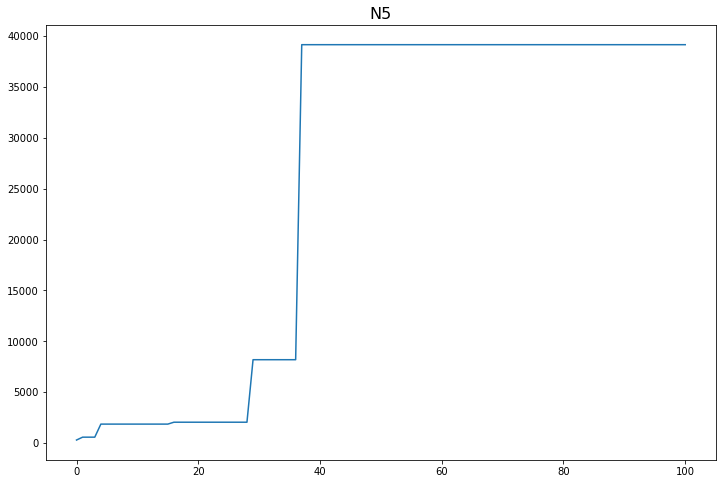

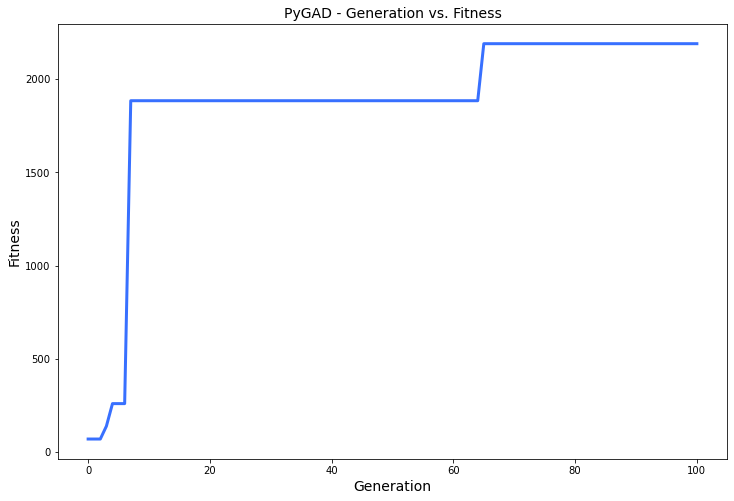

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 28.874 |==================| 50.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.907 |==================| 18.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.876 |==================| 46.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.884 |==================| 33.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.922 |==================| 14.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.819 |==================| 28.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 28.566 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.246 |==================| 4.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 26.566 |==================| 2.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 26.63 |==================| 2.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.169 |==================| 6.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.167 |==================| 6.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.966 |==================| 20.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.134 |==================| 8.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.169 |==================| 6.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.167 |==================| 6.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.966 |==================| 20.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.134 |==================| 8.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.211 |==================| 5.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.802 |==================| 4.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.595 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.134 |==================| 8.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.211 |==================| 5.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.802 |==================| 4.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.595 |==================| 2.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.77 |==================| 4.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.018 |==================| 374.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.161 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.019 |==================| 222.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.229 |==================| 4.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.919 |==================| 10.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.138 |==================| 8.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 27.01 |==================| 214.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.058 |==================| 23.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.146 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.229 |==================| 4.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.919 |==================| 10.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.138 |==================| 8.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 27.01 |==================| 214.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.058 |==================| 23.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.146 |==================| 7.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.164 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.148 |==================| 7.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 26.831 |==================| 5.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.247 |==================| 4.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.251 |==================| 4.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.702 |==================| 3.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.138 |==================| 8.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.986 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 26.831 |==================| 5.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.247 |==================| 4.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.251 |==================| 4.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.702 |==================| 3.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.138 |==================| 8.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.986 |==================| 34.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.804 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.702 |==================| 3.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.138 |==================| 8.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.986 |==================| 34.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.804 |==================| 4.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.92 |==================| 10.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 27.009 |==================| 177.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.254 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.038 |==================| 43.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 26.689 |==================| 3.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 26.917 |==================| 10.184 |==========
Fitness = 390.31347010641207
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.254 |==================| 4.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.018 |==================| 390.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.232 |==================| 4.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.254 |==================| 4.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.018 |==================| 390.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.232 |==================| 4.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.181 |==================| 6.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.914 |==================| 9.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.932 |==================| 11.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.527 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.592 |==================| 2.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 26.638 |==================| 2.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.988 |==================| 37.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |==================| 7.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.076 |==================| 16.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.216 |==================| 4.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.584 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 26.638 |==================| 2.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.988 |==================| 37.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |==================| 7.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.076 |==================| 16.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.216 |==================| 4.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.584 |==================| 2.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.057 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.756 |==================| 3.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.063 |==================| 20.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.102 |==================| 11.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.945 |==================| 14.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.721 |==================| 3.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.893 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.102 |==================| 11.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.945 |==================| 14.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.721 |==================| 3.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.893 |==================| 8.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 26.993 |==================| 46.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.91 |==================| 9.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 26.877 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.721 |==================| 3.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.893 |==================| 8.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 26.993 |==================| 46.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.91 |==================| 9.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 26.877 |==================| 7.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.104 |==================| 11.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.05 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.529 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 26.954 |==================| 16.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.081 |==================| 15.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.87 |==================| 6.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.21 |==================| 5.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.069 |==================| 18.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 26.847 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.081 |==================| 15.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.87 |==================| 6.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.21 |==================| 5.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.069 |==================| 18.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 26.847 |==================| 5.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.646 |==================| 2.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 26.573 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 26.787 |==================| 4.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.15 |==================| 7.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 26.719 |==================| 3.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.585 |==================| 2.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.798 |==================| 4.6 |==========
Generation = 8
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.887 |==================| 7.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.221 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.15 |==================| 7.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 26.719 |==================| 3.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.585 |==================| 2.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.798 |==================| 4.6 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.887 |==================| 7.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.221 |==================| 4.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.201 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 26.719 |==================| 3.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.585 |==================| 2.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.798 |==================| 4.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.034 |==================| 52.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.951 |==================| 15.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.246 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.516 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 26.603 |==================| 2.429 |==========
Fitness = 390.31347010641207
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.034 |==================| 52.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.951 |==================| 15.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.246 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.516 |==================| 2.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 26.761 |==================| 3.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.246 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.516 |==================| 2.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 26.761 |==================| 3.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 26.678 |==================| 2.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 26.935 |==================| 12.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.559 |==================| 2.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.772 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.131 |==================| 8.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.94 |==================| 13.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.082 |==================| 15.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 26.995 |==================| 51.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.735 |==================| 3.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.769 |==================| 4.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.136 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.94 |==================| 13.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.082 |==================| 15.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 26.995 |==================| 51.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.735 |==================| 3.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.769 |==================| 4.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.136 |==================| 8.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.77 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 27.107 |==================| 10.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 26.729 |==================| 3.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.255 |==================| 4.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.028 |==================| 79.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.96 |==================| 18.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 26.547 |==================| 2.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.028 |==================| 79.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.96 |==================| 18.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 26.547 |==================| 2.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |==================| 7.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.714 |==================| 3.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.199 |==================| 5.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.101 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.96 |==================| 18.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 26.547 |==================| 2.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |==================| 7.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.714 |==================| 3.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.199 |==================| 5.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.101 |==================| 11.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.321 |===========| 26.604 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.037 |==================| 45.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.081 |==================| 15.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 27.026 |==================| 90.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.854 |==================| 6.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.841 |==================| 5.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.15 |==================| 7.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.208 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.081 |==================| 15.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 27.026 |==================| 90.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.854 |==================| 6.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.841 |==================| 5.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.15 |==================| 7.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.208 |==================| 5.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.178 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.157 |==================| 7.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.891 |==================| 8.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.169 |==================| 6.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.022 |==================| 149.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.163 |==================| 6.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 26.703 |==================| 3.203 |==========
Generation = 13
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.089 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.891 |==================| 8.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.169 |==================| 6.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.022 |==================| 149.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.163 |==================| 6.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 26.703 |==================| 3.203 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.089 |==================| 13.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.133 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.169 |==================| 6.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.022 |==================| 149.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.163 |==================| 6.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 26.703 |==================| 3.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.076 |==================| 16.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.52 |==================| 2.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.048 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.924 |==================| 10.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.207 |==================| 5.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 26.71 |==================| 3.281 |==========
Fitness = 390.31347010641207
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.076 |==================| 16.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.52 |==================| 2.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.048 |==================| 30.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.207 |==================| 5.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 26.71 |==================| 3.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.076 |==================| 16.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.52 |==================| 2.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.048 |==================| 30.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.071 |==================| 17.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.542 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.159 |==================| 6.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 26.837 |==================| 5.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.231 |==================| 4.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.078 |==================| 15.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.177 |==================| 6.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.156 |==================| 7.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.251 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.078 |==================| 15.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.177 |==================| 6.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.156 |==================| 7.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.251 |==================| 4.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.675 |==================| 2.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.07 |==================| 18.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.888 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 27.196 |==================| 5.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.123 |==================| 9.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 26.81 |==================| 4.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.595 |==================| 2.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.79 |==================| 4.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.212 |==================| 5.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 26.533 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.123 |==================| 9.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 26.81 |==================| 4.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.595 |==================| 2.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.79 |==================| 4.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.212 |==================| 5.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 26.533 |==================| 2.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.151 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 26.81 |==================| 4.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.595 |==================| 2.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.79 |==================| 4.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.212 |==================| 5.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 26.533 |==================| 2.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.151 |==================| 7.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.568 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.241 |==================| 4.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.93 |==================| 11.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.819 |==================| 5.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.067 |==================| 19.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 26.969 |==================| 21.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 26.858 |==================| 6.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.014 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.93 |==================| 11.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.819 |==================| 5.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.067 |==================| 19.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 26.969 |==================| 21.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 26.858 |==================| 6.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.014 |==================| 876.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.065 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.234 |==================| 4.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.587 |==================| 2.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.199 |==================| 5.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.105 |==================| 11.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.118 |==================| 9.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.621 |==================| 2.538 |==========
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.191 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.105 |==================| 11.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.118 |==================| 9.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.621 |==================| 2.538 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.191 |==================| 5.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.837 |==================| 5.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.869 |==================| 6.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.143 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.118 |==================| 9.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.621 |==================| 2.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.839 |==================| 5.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.229 |==================| 4.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.173 |==================| 6.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.042 |==================| 36.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.183 |==================| 5.949 |==========
Fitness = 876.2483221547201
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.839 |==================| 5.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.229 |==================| 4.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.173 |==================| 6.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.042 |==================| 36.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.839 |==================| 5.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.229 |==================| 4.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.173 |==================| 6.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.042 |==================| 36.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 26.864 |==================| 6.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.087 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.034 |==================| 51.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.045 |==================| 32.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.181 |==================| 6.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.058 |==================| 23.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.227 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.124 |==================| 9.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 26.983 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.045 |==================| 32.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.181 |==================| 6.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.058 |==================| 23.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.227 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.124 |==================| 9.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 26.983 |==================| 30.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.142 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.117 |==================| 9.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.844 |==================| 5.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.815 |==================| 5.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.646 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.977 |==================| 26.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.037 |==================| 46.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.076 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.844 |==================| 5.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.815 |==================| 5.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.646 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.977 |==================| 26.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.037 |==================| 46.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.076 |==================| 16.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.935 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.815 |==================| 5.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.646 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.977 |==================| 26.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.037 |==================| 46.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.076 |==================| 16.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.935 |==================| 12.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 26.718 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.758 |==================| 3.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 26.533 |==================| 2.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.181 |==================| 6.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.698 |==================| 3.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 27.01 |==================| 196.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 26.585 |==================| 2.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.172 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 26.533 |==================| 2.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.181 |==================| 6.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.698 |==================| 3.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 27.01 |==================| 196.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 26.585 |==================| 2.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.172 |==================| 6.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.195 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.119 |==================| 9.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.68 |==================| 2.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.227 |==================| 4.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.976 |==================| 25.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.876 |==================| 7.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.125 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.227 |==================| 4.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.976 |==================| 25.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.876 |==================| 7.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.125 |==================| 9.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.154 |==================| 7.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.62 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.876 |==================| 7.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.125 |==================| 9.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.154 |==================| 7.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.62 |==================| 2.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.125 |==================| 9.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 26.923 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.238 |==================| 4.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.978 |==================| 27.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.577 |==================| 2.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.255 |==================| 4.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.606 |==================| 2.445 |==========
Fitness = 876.2483221547201
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.06 |==================| 22.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.978 |==================| 27.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.577 |==================| 2.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.255 |==================| 4.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.606 |==================| 2.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.06 |==================| 22.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.823 |==================| 5.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 27.092 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.606 |==================| 2.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.105 |==================| 11.158 |==========
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.517 |==================| 2.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 26.714 |==================| 3.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.107 |==================| 10.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.037 |==================| 45.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.22

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 26.714 |==================| 3.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.107 |==================| 10.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.037 |==================| 45.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.226 |==================| 4.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.246 |==================| 4.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.223 |==================| 4.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 27.214 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.221 |==================| 4.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.08 |==================| 15.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.242 |==================| 4.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.925 |==================| 11.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.85 |==================| 6.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.775 |==================| 4.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.875 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.08 |==================| 15.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.242 |==================| 4.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.925 |==================| 11.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.85 |==================| 6.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.775 |==================| 4.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.875 |==================| 7.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 26.644 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.242 |==================| 4.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.925 |==================| 11.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.85 |==================| 6.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.775 |==================| 4.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.875 |==================| 7.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 26.644 |==================| 2.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.179 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 27.047 |==================| 31.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.857 |==================| 6.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.232 |==================| 4.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.814 |==================| 4.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.795 |==================| 4.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.762 |==================| 3.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.188 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.857 |==================| 6.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.232 |==================| 4.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.814 |==================| 4.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.795 |==================| 4.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.762 |==================| 3.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.188 |==================| 5.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.695 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |==================| 6.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.105 |==================| 11.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.924 |==================| 11.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.199 |==================| 5.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.944 |==================| 14.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.221 |==================| 4.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.559 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.105 |==================| 11.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.924 |==================| 11.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.199 |==================| 5.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.944 |==================| 14.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.221 |==================| 4.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.559 |==================| 2.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 26.851 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.199 |==================| 5.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.944 |==================| 14.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.221 |==================| 4.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.559 |==================| 2.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 26.851 |==================| 6.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 26.622 |==================| 2.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.074 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 26.915 |==================| 9.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.144 |==================| 7.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.138 |==================| 8.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 26.714 |==================| 3.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 26.685 |==================| 3.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 26.645 |==================| 2.7 |==========
Fitness = 876.2483221547201
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 26.714 |==================| 3.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 26.685 |==================| 3.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 26.645 |==================| 2.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.614 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.17 |==================| 6.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.77 |==================| 4.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.215 |==================| 4.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 27.214 |==================| 5.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 26.958 |==================| 17.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.794 |==================| 4.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.819 |==================| 5.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.049 |==================| 29.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.137 |==================| 8.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.107 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.819 |==================| 5.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.049 |==================| 29.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.137 |==================| 8.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.107 |==================| 10.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.144 |==================| 7.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.092 |==================| 13.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 26.98 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.06 |==================| 22.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.242 |==================| 4.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.224 |==================| 4.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.027 |==================| 85.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.097 |==================| 12.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.023 |==================| 121.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.833 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.242 |==================| 4.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.224 |==================| 4.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.027 |==================| 85.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.097 |==================| 12.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.023 |==================| 121.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.833 |==================| 5.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.186 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.224 |==================| 4.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.027 |==================| 85.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.097 |==================| 12.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.023 |==================| 121.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.833 |==================| 5.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.186 |==================| 5.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.165 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.181 |==================| 6.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 26.915 |==================| 9.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.907 |==================| 9.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.153 |==================| 7.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.079 |==================| 15.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.158 |==================| 6.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 26.737 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.907 |==================| 9.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.153 |==================| 7.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.079 |==================| 15.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.158 |==================| 6.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 26.737 |==================| 3.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.557 |==================| 2.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.524 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.182 |==================| 5.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.976 |==================| 25.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.082 |==================| 14.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.092 |==================| 13.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.789 |==================| 4.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.197 |==================| 5.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.164 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.976 |==================| 25.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.082 |==================| 14.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.092 |==================| 13.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.789 |==================| 4.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.197 |==================| 5.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.164 |==================| 6.688 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.646 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.082 |==================| 14.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.092 |==================| 13.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.789 |==================| 4.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.197 |==================| 5.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.164 |==================| 6.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 26.702 |==================| 3.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.24 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.172 |==================| 6.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.646 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.148 |==================| 7.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.156 |==================| 7.079 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 26.702 |==================| 3.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.24 |==================| 4.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.646 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.148 |==================| 7.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.156 |==================| 7.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 26.702 |==================| 3.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.24 |==================| 4.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.129 |==================| 8.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.075 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.085 |==================| 14.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.183 |==================| 5.934 |==========
Generation = 35
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.096 |==================| 12.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.116 |==================| 9.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.252 |==================| 4.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.219 |==================| 4.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.05 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.096 |==================| 12.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.116 |==================| 9.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.252 |==================| 4.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.219 |==================| 4.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.05 |==================| 28.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.177 |==================| 6.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.141 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |==================| 7.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.099 |==================| 11.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.655 |==================| 2.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 26.643 |==================| 2.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 26.923 |==================| 10.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.252 |==================| 4.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 26.52 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.099 |==================| 11.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.655 |==================| 2.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 26.643 |==================| 2.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 26.923 |==================| 10.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.252 |==================| 4.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 26.52 |==================| 2.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.044 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.655 |==================| 2.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 26.643 |==================| 2.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 26.923 |==================| 10.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.252 |==================| 4.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 26.52 |==================| 2.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.044 |==================| 34.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 26.929 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 26.883 |==================| 7.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.872 |==================| 6.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================| 347.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.24 |==================| 4.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.116 |==================| 9.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.867 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.872 |==================| 6.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================| 347.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.24 |==================| 4.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.116 |==================| 9.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.867 |==================| 6.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.164 |==================| 6.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.869 |==================| 6.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.133 |==================| 8.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 26.973 |==================| 23.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 26.838 |==================| 5.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.935 |==================| 12.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.106 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.869 |==================| 6.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.133 |==================| 8.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 26.973 |==================| 23.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 26.838 |==================| 5.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.935 |==================| 12.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.106 |==================| 10.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.198 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.133 |==================| 8.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 26.973 |==================| 23.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 26.838 |==================| 5.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.935 |==================| 12.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.106 |==================| 10.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.198 |==================| 5.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 26.533 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.249 |==================| 4.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.204 |==================| 5.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 26.657 |==================| 2.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.671 |==================| 2.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.144 |==================| 7.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.069 |==================| 18.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.707 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.671 |==================| 2.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.144 |==================| 7.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.069 |==================| 18.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.707 |==================| 3.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.127 |==================| 8.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 26.949 |==================| 15.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.035 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.671 |==================| 2.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.578 |==================| 2.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.362 |==========
Generation = 40
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.936 |==================| 12.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |==================| 6.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.714 |==================| 3.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.171 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.578 |==================| 2.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.362 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.936 |==================| 12.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |==================| 6.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.714 |==================| 3.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.171 |==================| 6.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.117 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.074 |==================| 17.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.528 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.952 |==================| 15.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.167 |==================| 6.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 26.966 |==================| 20.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.209 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.952 |==================| 15.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.167 |==================| 6.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 26.966 |==================| 20.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.209 |==================| 5.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.542 |==================| 2.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.241 |==================| 4.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.034 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 26.966 |==================| 20.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.209 |==================| 5.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.542 |==================| 2.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.241 |==================| 4.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.034 |==================| 53.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.138 |==================| 8.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.059 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.093 |==================| 12.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.123 |==================| 9.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.937 |==================| 12.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.124 |==================| 9.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.194 |==================| 5.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.702 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.763 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.124 |==================| 9.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.194 |==================| 5.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.702 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.763 |==================| 3.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.945 |==================| 14.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.202 |==================| 5.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.592 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.236 |==================| 4.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.701 |==================| 3.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 26.917 |==================| 10.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 26.552 |==================| 2.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.121 |==================| 9.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 26.622 |==================| 2.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.204 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 26.552 |==================| 2.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.121 |==================| 9.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 26.622 |==================| 2.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.204 |==================| 5.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.205 |==================| 5.256 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.727 |==================| 3.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.071 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.121 |==================| 9.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 26.622 |==================| 2.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.204 |==================| 5.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.205 |==================| 5.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.081 |==================| 15.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.028 |==================| 74.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 27.126 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 26.689 |==================| 3.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.087 |==================| 13.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.762 |==================| 3.954 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.081 |==================| 15.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.028 |==================| 74.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 27.126 |==================| 9.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.087 |==================| 13.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.762 |==================| 3.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.081 |==================| 15.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.028 |==================| 74.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 27.126 |==================| 9.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.067 |==================| 19.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 26.75 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.73 |==========
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.845 |==================| 5.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.885 |==================| 7.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.141 |==================| 7.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.017 |==================| 440.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.183 |==================| 5.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.88 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.845 |==================| 5.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.885 |==================| 7.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.141 |==================| 7.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.017 |==================| 440.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.183 |==================| 5.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.88 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.154 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 26.815 |==================| 4.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.665 |==================| 2.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.145 |==================| 7.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.145 |==================| 7.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.73 |==================| 3.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 26.552 |==================| 2.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 27.076 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.665 |==================| 2.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.145 |==================| 7.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.145 |==================| 7.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.73 |==================| 3.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 26.552 |==================| 2.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 27.076 |==================| 16.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.243 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.145 |==================| 7.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.145 |==================| 7.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.73 |==================| 3.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 26.552 |==================| 2.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 27.076 |==================| 16.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.243 |==================| 4.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.792 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.788 |==================| 4.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.078 |==================| 15.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.038 |==================| 42.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.093 |==================| 12.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.963 |==================| 19.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 26.943 |==================| 13.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.138 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.078 |==================| 15.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.038 |==================| 42.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.093 |==================| 12.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.963 |==================| 19.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 26.943 |==================| 13.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.138 |==================| 8.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 26.805 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 27.01 |==================| 200.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 26.855 |==================| 6.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.936 |==================| 12.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.836 |==================| 5.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.77 |==================| 4.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.798 |==================| 4.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.201 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 26.855 |==================| 6.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.936 |==================| 12.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.836 |==================| 5.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.77 |==================| 4.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.798 |==================| 4.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.201 |==================| 5.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.106 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.936 |==================| 12.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.836 |==================| 5.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.77 |==================| 4.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.798 |==================| 4.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.201 |==================| 5.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.106 |==================| 10.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.231 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 26.605 |==================| 2.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 26.53 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 26.682 |==================| 3.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.075 |==================| 16.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.243 |==================| 4.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 26.716 |==================| 3.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.082 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 26.53 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 26.682 |==================| 3.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.075 |==================| 16.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.243 |==================| 4.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 26.716 |==================| 3.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.082 |==================| 14.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 27.062 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.141 |==================| 7.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.166 |==================| 6.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 27.008 |==================| 154.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.053 |==================| 26.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.779 |==================| 4.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.809 |==================| 4.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.764 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.166 |==================| 6.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 27.008 |==================| 154.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.053 |==================| 26.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.779 |==================| 4.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.809 |==================| 4.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.764 |==================| 3.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 26.603 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.053 |==================| 26.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.779 |==================| 4.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.809 |==================| 4.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.764 |==================| 3.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 26.603 |==================| 2.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.862 |==================| 6.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.17 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 26.662 |==================| 2.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.199 |==================| 5.43 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.862 |==================| 6.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.17 |==================| 6.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.244 |==================| 4.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.118 |==================| 9.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.199 |==================| 5.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.862 |==================| 6.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.17 |==================| 6.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.244 |==================| 4.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.118 |==================| 9.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.946 |==================| 14.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.194 |==================| 5

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.83 |==================| 5.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.248 |==================| 4.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.169 |==================| 6.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.042 |==================| 36.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.771 |==================| 4.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.134 |==================| 8.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.069 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.248 |==================| 4.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.169 |==================| 6.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.042 |==================| 36.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.771 |==================| 4.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.134 |==================| 8.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.069 |==================| 18.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.141 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 26.622 |==================| 2.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.055 |==================| 24.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.214 |==================| 5.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 26.915 |==================| 10.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.926 |==================| 11.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.151 |==================| 7.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.568 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.214 |==================| 5.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 26.915 |==================| 10.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.926 |==================| 11.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.151 |==================| 7.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.568 |==================| 2.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.133 |==================| 8.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.177 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.151 |==================| 7.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.568 |==================| 2.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.133 |==================| 8.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.177 |==================| 6.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.578 |==================| 2.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.707 |==================| 3.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.227 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 26.746 |==================| 3.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.932 |==================| 12.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.568 |==================| 2.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.064 |==================| 20.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 27.026 |==================| 87.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.988 |==================| 37.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 27.076 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.932 |==================| 12.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.568 |==================| 2.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.064 |==================| 20.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 27.026 |==================| 87.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.988 |==================| 37.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 27.076 |==================| 16.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.751 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.252 |==================| 4.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.151 |==================| 7.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.117 |==================| 9.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.728 |==================| 3.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.231 |==================| 4.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.054 |==================| 25.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.102 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.151 |==================| 7.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.117 |==================| 9.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.728 |==================| 3.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.231 |==================| 4.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.054 |==================| 25.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.102 |==================| 11.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.066 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.117 |==================| 9.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.728 |==================| 3.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.231 |==================| 4.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.054 |==================| 25.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.102 |==================| 11.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.066 |==================| 19.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.763 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 26.604 |==================| 2.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.557 |==================| 2.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.874 |==================| 7.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.761 |==================| 3.945 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 26.977 |==================| 26.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.828 |==================| 5.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.761 |==================| 3.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 26.977 |==================| 26.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.828 |==================| 5.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.652 |==================| 2.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.236 |==================| 4.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 26.993 |==================| 46.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.557 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.195 |==================| 5.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.098 |==================| 11.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 26.845 |==================| 5.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.063 |==================| 20.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.0 |==================| 66.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 26.612 |==================| 2.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.083 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.098 |==================| 11.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 26.845 |==================| 5.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.063 |==================| 20.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.0 |==================| 66.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 26.612 |==================| 2.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.083 |==================| 14.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.084 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.182 |==================| 5.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 26.644 |==================| 2.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.252 |==================| 4.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.605 |==================| 2.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.099 |==================| 11.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.616 |==================| 2.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 26.59 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.252 |==================| 4.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.605 |==================| 2.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.099 |==================| 11.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.616 |==================| 2.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 26.59 |==================| 2.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.592 |==================| 2.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 26.879 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.605 |==================| 2.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.099 |==================| 11.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.616 |==================| 2.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 26.59 |==================| 2.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.592 |==================| 2.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 26.879 |==================| 7.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 26.941 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 26.685 |==================| 3.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.203 |==================| 5.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.678 |==================| 2.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |==================| 7.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.765 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.203 |==================| 5.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.678 |==================| 2.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |==================| 7.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.765 |==================| 4.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 26.871 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.079 |==================| 15.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.206 |==================| 5.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.047 |==================| 31.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.05 |==================| 28.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |==================| 5.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.108 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.047 |==================| 31.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.05 |==================| 28.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |==================| 5.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.108 |==================| 10.697 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.614 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.052 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.108 |==================| 10.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.802 |==================| 4.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.075 |==================| 16.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.099 |==================| 11.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.039 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.588 |==================| 2.345 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.802 |==================| 4.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.075 |==================| 16.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.099 |==================| 11.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.039 |==================| 42.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.802 |==================| 4.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.075 |==================| 16.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.099 |==================| 11.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.039 |==================| 42.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.875 |==================| 7.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 26.608 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.919 |==================| 10.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.801 |==================| 4.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.64 |==================| 2.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.089 |==================| 13.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.675 |==================| 2.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.935 |==================| 12.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.158 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.801 |==================| 4.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.64 |==================| 2.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.089 |==================| 13.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.675 |==================| 2.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.935 |==================| 12.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.158 |==================| 6.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.12 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.075 |==================| 16.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 26.745 |==================| 3.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.09 |==================| 13.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.034 |==================| 52.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.123 |==================| 9.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.769 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 26.745 |==================| 3.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.09 |==================| 13.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.034 |==================| 52.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.123 |==================| 9.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.769 |==================| 4.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.118 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.034 |==================| 52.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.123 |==================| 9.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.769 |==================| 4.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.118 |==================| 9.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 26.686 |==================| 3.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 27.066 |==================| 19.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.707 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.906 |==================| 9.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.085 |==================| 14.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.653 |==================| 2.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.04 |==================| 40.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.581 |==================| 2.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.187 |==================| 5.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.202 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.04 |==================| 40.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.581 |==================| 2.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.187 |==================| 5.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.202 |==================| 5.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.536 |==================| 2.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.743 |==================| 3.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 26.731 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.039 |==================| 41.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.159 |==================| 6.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.835 |==================| 5.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.197 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.74 |==========
Generation = 65
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.778 |==================| 4.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.041 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.159 |==================| 6.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.835 |==================| 5.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.197 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.74 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.778 |==================| 4.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.041 |==================| 39.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.625 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.835 |==================| 5.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.197 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.151 |==================| 7.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.179 |==================| 6.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.221 |==================| 4.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.151 |==================| 7.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.179 |==================| 6.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.221 |==================| 4.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |==================| 7.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.647 |==================| 2.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 26.946 |==================| 14.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 26.524 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.221 |==================| 4.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |==================| 7.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.647 |==================| 2.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 26.946 |==================| 14.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 26.524 |==================| 2.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 26.711 |==================| 3.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.968 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 26.764 |==================| 3.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.119 |==================| 9.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.159 |==================| 6.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 27.021 |==================| 166.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.887 |==================| 7.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.603 |==================| 2.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.228 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.119 |==================| 9.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.159 |==================| 6.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 27.021 |==================| 166.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.887 |==================| 7.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.603 |==================| 2.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.228 |==================| 4.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 26.6 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.222 |==================| 4.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |==================| 7.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.889 |==================| 7.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 27.047 |==================| 30.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 26.692 |==================| 3.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.18 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |==================| 7.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.889 |==================| 7.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 27.047 |==================| 30.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 26.692 |==================| 3.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.18 |==================| 6.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.585 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.889 |==================| 7.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 27.047 |==================| 30.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 26.692 |==================| 3.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.18 |==================| 6.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.585 |==================| 2.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.177 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.252 |==================| 4.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.218 |==================| 4.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.074 |==================| 16.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.078 |==================| 15.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.539 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.18 |==================| 6.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 26.877 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.218 |==================| 4.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.074 |==================| 16.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.078 |==================| 15.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.539 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.18 |==================| 6.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 26.877 |==================| 7.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.887 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.919 |==================| 10.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.646 |==================| 2.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 26.647 |==================| 2.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.721 |==================| 3.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.762 |==================| 3.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.194 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.646 |==================| 2.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 26.647 |==================| 2.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.721 |==================| 3.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.762 |==================| 3.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.194 |==================| 5.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.93 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.721 |==================| 3.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.762 |==================| 3.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.194 |==================| 5.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.93 |==================| 11.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.017 |==================| 553.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.738 |==================| 3.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.051 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.048 |==================| 30.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.237 |==================| 4.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.635 |==================| 2.63 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.738 |==================| 3.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.051 |==================| 27.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.077 |==================| 16.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.237 |==================| 4.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.635 |==================| 2.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.738 |==================| 3.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.051 |==================| 27.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.077 |==================| 16.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.201 |==================| 5.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.042 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.12 |==================| 9.52 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 26.748 |==================| 3.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.201 |==================| 5.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.706 |==================| 3.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.049 |==================| 29.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 26.927 |==================| 11.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.706 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 26.748 |==================| 3.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.201 |==================| 5.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.706 |==================| 3.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.049 |==================| 29.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 26.927 |==================| 11.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.706 |==================| 3.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 26.905 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.22 |==================| 4.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.15 |==================| 7.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.765 |==================| 3.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.21 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.249 |==================| 4.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.903 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.15 |==================| 7.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.765 |==================| 3.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.21 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.249 |==================| 4.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.903 |==================| 8.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.683 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.15 |==================| 7.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.765 |==================| 3.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.21 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.249 |==================| 4.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.903 |==================| 8.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.683 |==================| 3.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.052 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.128 |==================| 8.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.522 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 26.597 |==================| 2.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.885 |==================| 7.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.175 |==================| 6.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 26.571 |==================| 2.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.702 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.522 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 26.597 |==================| 2.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.885 |==================| 7.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.175 |==================| 6.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 26.571 |==================| 2.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.702 |==================| 3.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.161 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.624 |==================| 2.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.064 |==================| 20.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.878 |==================| 7.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 27.037 |==================| 44.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.627 |==================| 2.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.249 |==================| 4.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.031 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.064 |==================| 20.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.878 |==================| 7.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 27.037 |==================| 44.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.627 |==================| 2.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.249 |==================| 4.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.031 |==================| 61.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.143 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.878 |==================| 7.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 27.037 |==================| 44.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.627 |==================| 2.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.249 |==================| 4.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.031 |==================| 61.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.143 |==================| 7.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 26.799 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 26.955 |==================| 16.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 26.515 |==================| 2.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 26.856 |==================| 6.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.032 |==================| 58.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 27.149 |==================| 7.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.249 |==================| 4.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.887 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 26.515 |==================| 2.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 26.856 |==================| 6.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.032 |==================| 58.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 27.149 |==================| 7.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.249 |==================| 4.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.887 |==================| 7.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 27.108 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 26.716 |==================| 3.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.951 |==================| 15.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.127 |==================| 8.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 26.558 |==================| 2.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.046 |==================| 32.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.951 |==================| 15.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.127 |==================| 8.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 26.558 |==================| 2.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.046 |==================| 32.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |==================| 5.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.237 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.127 |==================| 8.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 26.558 |==================| 2.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.046 |==================| 32.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |==================| 5.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.237 |==================| 4.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.878 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.819 |==================| 5.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 26.566 |==================| 2.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.837 |==================| 5.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.104 |==================| 11.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 26.708 |==================| 3.263 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.878 |==================| 7.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 26.566 |==================| 2.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.837 |==================| 5.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.104 |==================| 11.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 26.708 |==================| 3.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.878 |==================| 7.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.837 |==================| 5.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.246 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.077 |==================| 16.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 26.911 |==================| 9.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.844 |==================| 5.852 |==========
Generation = 79
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.19 |==================| 5.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.842 |==================| 5.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.727 |==================| 3.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 26.615 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 26.911 |==================| 9.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.844 |==================| 5.852 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.19 |==================| 5.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.842 |==================| 5.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.727 |==================| 3.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 26.615 |==================| 2.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.101 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.844 |==================| 5.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 26.871 |==================| 6.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.784 |==================| 4.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.69 |==================| 3.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.883 |==================| 7.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 26.626 |==================| 2.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.13 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 26.871 |==================| 6.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.784 |==================| 4.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.69 |==================| 3.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.883 |==================| 7.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 26.626 |==================| 2.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.13 |==================| 8.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.94 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.784 |==================| 4.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.69 |==================| 3.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.883 |==================| 7.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 26.626 |==================| 2.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.13 |==================| 8.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.94 |==================| 13.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.599 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.039 |==================| 41.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.683 |==================| 3.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.999 |==================| 62.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.232 |==================| 4.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.569 |==================| 2.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 26.805 |==================| 4.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.036 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.683 |==================| 3.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.999 |==================| 62.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.232 |==================| 4.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.569 |==================| 2.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 26.805 |==================| 4.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.036 |==================| 46.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 26.608 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 26.822 |==================| 5.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.078 |==================| 15.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 26.899 |==================| 8.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.031 |==================| 63.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.526 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 26.818 |==================| 5.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.964 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 26.899 |==================| 8.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.031 |==================| 63.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.526 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 26.818 |==================| 5.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.964 |==================| 19.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 26.912 |==================| 9.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.629 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.031 |==================| 63.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.526 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 26.818 |==================| 5.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.964 |==================| 19.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 26.912 |==================| 9.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.629 |==================| 2.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.086 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 27.054 |==================| 25.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |==================| 7.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 26.538 |==================| 2.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.814 |==================| 4.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.842 |==================| 5.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.224 |==================| 4.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 26.955 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |==================| 7.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 26.538 |==================| 2.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.814 |==================| 4.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.842 |==================| 5.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.224 |==================| 4.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 26.955 |==================| 16.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.874 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 26.917 |==================| 10.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.824 |==================| 5.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.218 |==================| 4.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.03 |==================| 65.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.09 |==================| 13.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.091 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.824 |==================| 5.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.218 |==================| 4.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.03 |==================| 65.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.09 |==================| 13.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.091 |==================| 13.224 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.924 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.824 |==================| 5.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.218 |==================| 4.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.03 |==================| 65.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.09 |==================| 13.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.091 |==================| 13.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.759 |==================| 3.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.143 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.224 |==================| 4.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.228 |==================| 4.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.114 |==================| 10.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.124 |==================| 9.159 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.759 |==================| 3.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.143 |==================| 7.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.114 |==================| 10.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.124 |==================| 9.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.759 |==================| 3.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.143 |==================| 7.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 26.943 |==================| 13.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.095 |==================| 12.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.891 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.117 |==================| 9.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.764 |==================| 3.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.532 |==================| 2.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 26.648 |==================| 2.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.659 |==================| 2.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.171 |==================| 6.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.07 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.764 |==================| 3.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.532 |==================| 2.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 26.648 |==================| 2.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.659 |==================| 2.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.171 |==================| 6.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.07 |==================| 18.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 26.796 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.077 |==================| 16.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 27.236 |==================| 4.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239 |==================| 4.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.14 |==================| 8.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.852 |==================| 6.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 26.975 |==================| 24.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.24 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 27.236 |==================| 4.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239 |==================| 4.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.14 |==================| 8.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.852 |==================| 6.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 26.975 |==================| 24.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.24 |==================| 4.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.185 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239 |==================| 4.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.14 |==================| 8.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.852 |==================| 6.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 26.975 |==================| 24.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.24 |==================| 4.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.185 |==================| 5.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.106 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 26.828 |==================| 5.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.247 |==================| 4.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 26.614 |==================| 2.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.201 |==================| 5.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 27.149 |==================| 7.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.809 |==================| 4.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.157 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.247 |==================| 4.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 26.614 |==================| 2.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.201 |==================| 5.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 27.149 |==================| 7.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.809 |==================| 4.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.157 |==================| 7.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 26.71 |==================| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.044 |==================| 33.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.099 |==================| 11.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.661 |==================| 2.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 26.856 |==================| 6.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.136 |==================| 8.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 26.738 |==================| 3.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.095 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.099 |==================| 11.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.661 |==================| 2.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 26.856 |==================| 6.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.136 |==================| 8.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 26.738 |==================| 3.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.095 |==================| 12.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 26.72 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.661 |==================| 2.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 26.856 |==================| 6.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.136 |==================| 8.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 26.738 |==================| 3.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.095 |==================| 12.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 26.72 |==================| 3.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 26.73 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 26.63 |==================| 2.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.587 |==================| 2.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.079 |==================| 15.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.943 |==================| 13.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 26.61 |==================| 2.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 26.974 |==================| 24.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.173 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.587 |==================| 2.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.079 |==================| 15.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.943 |==================| 13.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 26.61 |==================| 2.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 26.974 |==================| 24.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.173 |==================| 6.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.856 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 26.89 |==================| 8.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.023 |==================| 118.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.779 |==================| 4.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.932 |==================| 12.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.252 |==================| 4.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.095 |==================| 12.497 |==========
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.773

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.023 |==================| 118.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.779 |==================| 4.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.932 |==================| 12.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.252 |==================| 4.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.095 |==================| 12.497 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.773 |==================| 4.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.133 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.779 |==================| 4.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.932 |==================| 12.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.252 |==================| 4.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.095 |==================| 12.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.829 |==================| 5.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.861 |==================| 6.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.763 |==================| 3.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.757 |==================| 3.881 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.829 |==================| 5.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |==================| 6.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.763 |==================| 3.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.757 |==================| 3.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.829 |==================| 5.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |==================| 6.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.64 |==================| 2.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.94 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 26.829 |==================| 5.386 |==========
Generation = 93
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.196 |==================| 5.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 26.776 |==================| 4.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.764 |==================| 3.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |==================| 7.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.205 |==================| 5.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.848 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.196 |==================| 5.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 26.776 |==================| 4.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.764 |==================| 3.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |==================| 7.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.205 |==================| 5.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.848 |==================| 5.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 26.679 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.868 |==================| 6.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.122 |==================| 9.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.128 |==================| 8.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.797 |==================| 4.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.23 |==================| 4.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 27.053 |==================| 26.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.65 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.122 |==================| 9.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.128 |==================| 8.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.797 |==================| 4.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.23 |==================| 4.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 27.053 |==================| 26.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.65 |==================| 2.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.184 |==================| 5

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.128 |==================| 8.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.797 |==================| 4.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.23 |==================| 4.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 27.053 |==================| 26.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.65 |==================| 2.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.184 |==================| 5.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.183 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.229 |==================| 4.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.835 |==================| 5.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 27.14 |==================| 8.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 26.732 |==================| 3.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 26.998 |==================| 60.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.172 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.835 |==================| 5.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 27.14 |==================| 8.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 26.732 |==================| 3.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 26.998 |==================| 60.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.172 |==================| 6.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.807 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.179 |==================| 6.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.05 |==================| 28.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.023 |==================| 130.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.218 |==================| 4.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 26.996 |==================| 52.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.987 |==================| 35.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.05 |==================| 28.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.023 |==================| 130.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.218 |==================| 4.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 26.996 |==================| 52.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.987 |==================| 35.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239 |==================| 4.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.189 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.023 |==================| 130.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.218 |==================| 4.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 26.996 |==================| 52.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.987 |==================| 35.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239 |==================| 4.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.189 |==================| 5.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.171 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.034 |==================| 52.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.925 |==================| 11.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.895 |==================| 8.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.699 |==================| 3.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 26.572 |==================| 2.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.925 |==================| 11.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.895 |==================| 8.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.699 |==================| 3.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 26.572 |==================| 2.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==================| 4.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.813 |==================| 4.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.104 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.223 |==================| 4.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.048 |==================| 30.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.05 |==================| 28.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.131 |==================| 8.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 26.875 |==================| 7.167 |==========
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.066 |==================| 19.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.048 |==================| 30.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.05 |==================| 28.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.131 |==================| 8.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 26.875 |==================| 7.167 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.066 |==================| 19.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239 |==================| 4.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.02 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.05 |==================| 28.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.131 |==================| 8.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 26.875 |==================| 7.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.529 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.614 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.879 |==================| 7.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.244 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 26.745 |==================| 3.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.185 |==================| 5.896 |==========
Fitness = 1178.4863662299597
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.529 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.614 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.879 |==================| 7.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.244 |==================| 4.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.185 |==================| 5.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.529 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.614 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.879 |==================| 7.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.244 |==================| 4.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 26.546 |==================| 2.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.937 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.579 |==================| 2.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.147 |==================| 7.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.023 |==================| 118.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.24 |==================| 4.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.228 |==================| 4.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.25 |==================| 4.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 26.632 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.147 |==================| 7.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.023 |==================| 118.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.24 |==================| 4.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.228 |==================| 4.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.25 |==================| 4.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 26.632 |==================| 2.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 26.806 |=================

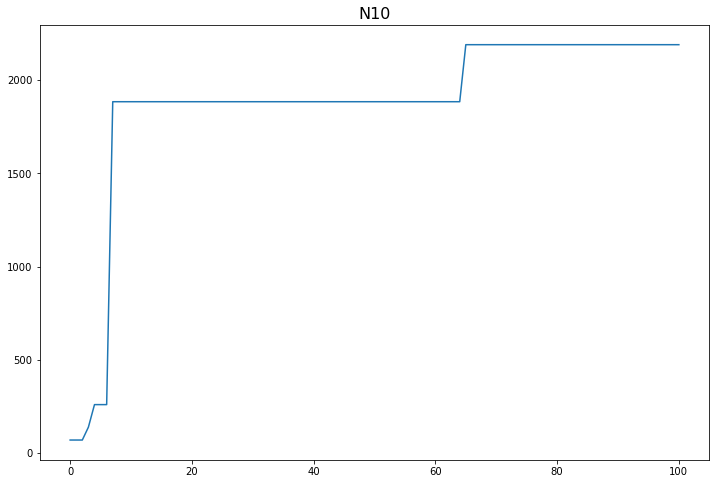

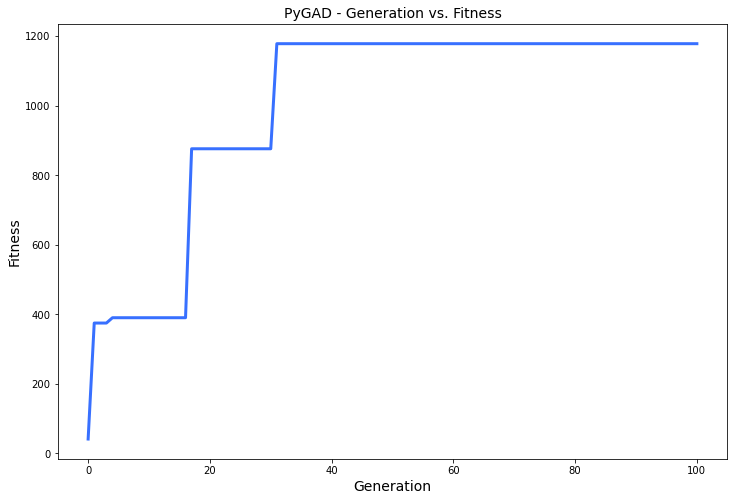

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.579 |==================| 2.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.147 |==================| 7.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.023 |==================| 118.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.24 |==================| 4.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.228 |==================| 4.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.25 |==================| 4.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 26.632 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.828 |==================| 74.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 24.731 |==================| 12.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 24.728 |==================| 11.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.866 |==================| 19.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.856 |==================| 23.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.86 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 24.731 |==================| 12.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 24.728 |==================| 11.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.866 |==================| 19.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.856 |==================| 23.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.86 |==================| 21.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.848 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 24.728 |==================| 11.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.866 |==================| 19.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.856 |==================| 23.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.86 |==================| 21.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.848 |==================| 29.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.826 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.827 |==================| 80.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 24.758 |==================| 17.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.795 |==================| 52.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.834 |==================| 50.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 24.799 |==================| 66.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 24.729 |==================| 11.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 24.791 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 24.758 |==================| 17.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.795 |==================| 52.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.834 |==================| 50.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 24.799 |==================| 66.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 24.729 |==================| 11.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 24.791 |==================| 41.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 24.756 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 24.79 |==================| 41.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 24.76 |==================| 18.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.863 |==================| 20.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.856 |==================| 24.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.808 |==================| 152.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.869 |==================| 18.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 24.74 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 24.76 |==================| 18.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.863 |==================| 20.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.856 |==================| 24.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.808 |==================| 152.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.869 |==================| 18.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 24.74 |==================| 13.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.819 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.863 |==================| 20.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.856 |==================| 24.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.808 |==================| 152.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.869 |==================| 18.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 24.74 |==================| 13.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.819 |==================| 238.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.745 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.816 |==================| 506.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 24.801 |==================| 73.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.856 |==================| 23.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.788 |==================| 38.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.774 |==================| 24.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.856 |==================| 23.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 24.801 |==================| 73.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.856 |==================| 23.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.788 |==================| 38.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.774 |==================| 24.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.856 |==================| 23.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |==================| 232.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.805 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.821 |==================| 153.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.769 |==================| 22.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.849 |==================| 29.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.857 |==================| 23.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.783 |==================| 31.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.817 |==================| 416.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.821 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.857 |==================| 23.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.783 |==================| 31.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.817 |==================| 416.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.821 |==================| 160.349 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 24.714 |==================| 9.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.767 |==================| 20.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 24.7

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.783 |==================| 31.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.817 |==================| 416.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.821 |==================| 160.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.846 |==================| 31.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.775 |==================| 25.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 108.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.857 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.84 |==================| 38.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.813 |==================| 974.948 |==========
Fitness = 974.9482121329094
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.846 |==================| 31.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.775 |==================| 25.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 108.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.857 |==================| 23.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.813 |==================| 974.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.846 |==================| 31.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.775 |==================| 25.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 108.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.857 |==================| 23.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.826 |==================| 84.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 24.722 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 24.716 |==================| 10.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.849 |==================| 28.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 24.755 |==================| 16.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 24.721 |==================| 10.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 24.762 |==================| 19.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.795 |==================| 51.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.841 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 24.755 |==================| 16.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 24.721 |==================| 10.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 24.762 |==================| 19.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.795 |==================| 51.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.841 |==================| 38.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 24.774 |==================| 25.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.841 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.81 |==================| 228.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.83 |==================| 63.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 24.725 |==================| 11.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 24.799 |==================| 64.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.813 |==================| 859.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 24.713 |==================| 9.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.826 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.83 |==================| 63.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 24.725 |==================| 11.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 24.799 |==================| 64.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.813 |==================| 859.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 24.713 |==================| 9.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.826 |==================| 87.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 24.735 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 24.725 |==================| 11.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 24.799 |==================| 64.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.813 |==================| 859.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 24.713 |==================| 9.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.826 |==================| 87.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 24.735 |==================| 12.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.843 |==================| 35.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 24.71 |==================| 9.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 24.743 |==================| 13.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 24.783 |==================| 31.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 24.727 |==================| 11.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.772 |==================| 23.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.816 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 24.71 |==================| 9.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 24.743 |==================| 13.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 24.783 |==================| 31.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 24.727 |==================| 11.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.772 |==================| 23.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.816 |==================| 741.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.866 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 24.801 |==================| 74.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.832 |==================| 57.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.866 |==================| 19.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.856 |==================| 23.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.792 |==================| 44.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 24.811 |==================| 334.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.868 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.832 |==================| 57.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.866 |==================| 19.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.856 |==================| 23.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.792 |==================| 44.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 24.811 |==================| 334.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.868 |==================| 18.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 24.736 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.866 |==================| 19.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.856 |==================| 23.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.792 |==================| 44.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 24.811 |==================| 334.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.868 |==================| 18.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 24.736 |==================| 12.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 24.747 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.84 |==================| 39.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 24.777 |==================| 26.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.823 |==================| 121.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 24.713 |==================| 9.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.822 |==================| 128.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.862 |==================| 21.081 |==========
Fitness = 1702.1570477825358
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 24.777 |==================| 26.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.823 |==================| 121.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 24.713 |==================| 9.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.822 |==================| 128.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.862 |==================| 21.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 24.749 |==================| 15.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.812 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.774 |==================| 24.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 24.719 |==================| 10.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.852 |==================| 26.731 |==========
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.849 |==================| 28.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.865 |==================| 19.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 24.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 24.719 |==================| 10.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.852 |==================| 26.731 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.849 |==================| 28.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.865 |==================| 19.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 24.786 |==================| 35.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 24.735

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 24.719 |==================| 10.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.852 |==================| 26.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.869 |==================| 18.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 24.731 |==================| 12.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.758 |==================| 17.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.855 |==================| 24.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.817 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.848 |==================| 29.681 |==========
Fitness = 1702.1570477825358
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.869 |==================| 18.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 24.731 |==================| 12.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.758 |==================| 17.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.855 |==================| 24.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.817 |==================| 345.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.869 |==================| 18.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 24.731 |==================| 12.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.758 |==================| 17.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.855 |==================| 24.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.817 |==================| 345.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.861 |==================| 21.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.823 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.868 |==================| 18.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.869 |==================| 18.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.779 |==================| 28.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 24.8 |==================| 67.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 24.803 |==================| 85.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.847 |==================| 30.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.824 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.869 |==================| 18.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.779 |==================| 28.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 24.8 |==================| 67.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 24.803 |==================| 85.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.847 |==================| 30.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.824 |==================| 99.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.843 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 24.701 |==================| 8.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 24.756 |==================| 17.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 24.739 |==================| 13.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 24.709 |==================| 9.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 24.816 |==================| 485.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.865 |==================| 19.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.834 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 24.756 |==================| 17.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 24.739 |==================| 13.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 24.709 |==================| 9.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 24.816 |==================| 485.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.865 |==================| 19.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.834 |==================| 52.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 24.799 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 24.739 |==================| 13.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 24.709 |==================| 9.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 24.816 |==================| 485.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.865 |==================| 19.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.834 |==================| 52.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 24.799 |==================| 64.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.77 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 24.719 |==================| 10.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 24.729 |==================| 11.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.832 |==================| 58.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.851 |==================| 27.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 24.718 |==================| 10.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 24.75 |==================| 15.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 24.816 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.851 |==================| 27.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 24.718 |==================| 10.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 24.75 |==================| 15.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 24.816 |==================| 588.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |==================| 87.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.853 |==================| 26.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 24.801 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.828 |==================| 72.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.855 |==================| 24.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 24.743 |==================| 14.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.867 |==================| 19.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.798 |==================| 59.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.822 |==================| 133.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 24.706 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.867 |==================| 19.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.798 |==================| 59.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.822 |==================| 133.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 24.706 |==================| 9.224 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 24.74 |==================| 13.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.733 |==================| 12.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.842 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.798 |==================| 59.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.822 |==================| 133.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 24.706 |==================| 9.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.762 |==================| 18.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.846 |==================| 31.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.851 |==================| 27.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 24.769 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.852 |==================| 26.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 24.733 |==================| 12.277 |==========
Fitness = 1702.1570477825358
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.762 |==================| 18.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.846 |==================| 31.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.851 |==================| 27.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 24.769 |==================| 22.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 24.733 |==================| 12.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.762 |==================| 18.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.846 |==================| 31.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.851 |==================| 27.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 24.769 |==================| 22.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.868 |==================| 18.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 24.722 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 24.7 |==================| 8.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.733 |==================| 12.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.733 |==================| 12.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 24.711 |==================| 9.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.787 |==================| 36.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 24.702 |==================| 8.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.854 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.733 |==================| 12.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.733 |==================| 12.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 24.711 |==================| 9.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.787 |==================| 36.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 24.702 |==================| 8.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.854 |==================| 25.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 24.774 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 24.714 |==================| 9.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.831 |==================| 60.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.77 |==================| 22.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.784 |==================| 33.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.771 |==================| 23.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.742 |==================| 13.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.802 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.831 |==================| 60.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.77 |==================| 22.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.784 |==================| 33.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.771 |==================| 23.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.742 |==================| 13.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.802 |==================| 79.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.826 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.77 |==================| 22.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.784 |==================| 33.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.771 |==================| 23.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.742 |==================| 13.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.802 |==================| 79.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.826 |==================| 84.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.856 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.864 |==================| 20.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |==================| 87.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.844 |==================| 33.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.794 |==================| 48.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.866 |==================| 19.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.842 |==================| 35.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.827 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |==================| 87.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.844 |==================| 33.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.794 |==================| 48.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.866 |==================| 19.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.842 |==================| 35.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.827 |==================| 80.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 24.736 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.859 |==================| 22.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.821 |==================| 162.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.858 |==================| 23.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.855 |==================| 24.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.853 |==================| 25.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 24.718 |==================| 10.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.862 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.858 |==================| 23.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.855 |==================| 24.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.853 |==================| 25.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 24.718 |==================| 10.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.862 |==================| 21.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.816 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 24.718 |==================| 10.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.862 |==================| 21.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.816 |==================| 837.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 24.773 |==================| 24.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 24.773 |==================| 24.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 24.753 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.865 |==================| 19.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 24.762 |==================| 18.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.85 |==================| 27.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 24.792 |==================| 45.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.846 |==================| 31.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.769 |==================| 22.195 |==========
Fitness = 1702.1570477825358
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 24.762 |==================| 18.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.85 |==================| 27.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 24.792 |==================| 45.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.846 |==================| 31.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.769 |==================| 22.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.853 |==================| 26.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 24.766 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.831 |==================| 60.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.849 |==================| 28.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.827 |==================| 82.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 24.77 |==================| 22.522 |==========
Generation = 24
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.851 |==================| 27.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.849 |==================| 28.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 24.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.849 |==================| 28.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.827 |==================| 82.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 24.77 |==================| 22.522 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.851 |==================| 27.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.849 |==================| 28.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 24.753 |==================| 16.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.837

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.827 |==================| 82.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 24.77 |==================| 22.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.855 |==================| 24.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.803 |==================| 86.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.815 |==================| 11261.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.85 |==================| 28.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 24.702 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.862 |==================| 21.022 |==========
Fitness = 11261.59123955538
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.855 |==================| 24.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.803 |==================| 86.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.815 |==================| 11261.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.85 |==================| 28.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 24.702 |==================| 8.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.855 |==================| 24.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.803 |==================| 86.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.815 |==================| 11261.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.85 |==================| 28.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 24.702 |==================| 8.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.823 |==================| 113.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 24.812 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.798 |==================| 60.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.817 |==================| 364.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 24.757 |==================| 17.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.796 |==================| 53.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.846 |==================| 31.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 24.734 |==================| 12.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.816 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.817 |==================| 364.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 24.757 |==================| 17.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.796 |==================| 53.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.846 |==================| 31.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 24.734 |==================| 12.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.816 |==================| 534.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.779 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.827 |==================| 77.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.845 |==================| 32.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.813 |==================| 675.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.861 |==================| 21.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 24.711 |==================| 9.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.81 |==================| 244.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 24.718 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.845 |==================| 32.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.813 |==================| 675.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.861 |==================| 21.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 24.711 |==================| 9.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.81 |==================| 244.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 24.718 |==================| 10.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.835 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.813 |==================| 675.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.861 |==================| 21.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 24.711 |==================| 9.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.81 |==================| 244.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 24.718 |==================| 10.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.835 |==================| 49.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.852 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.846 |==================| 31.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.796 |==================| 54.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 24.817 |==================| 393.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.864 |==================| 20.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 24.725 |==================| 11.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 24.767 |==================| 21.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.833 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.796 |==================| 54.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 24.817 |==================| 393.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.864 |==================| 20.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 24.725 |==================| 11.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 24.767 |==================| 21.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.833 |==================| 54.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.851 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 24.7 |==================| 8.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.842 |==================| 35.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.845 |==================| 32.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 24.749 |==================| 15.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 24.726 |==================| 11.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.831 |==================| 62.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 24.705 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.845 |==================| 32.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 24.749 |==================| 15.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 24.726 |==================| 11.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.831 |==================| 62.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 24.705 |==================| 9.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 24.756 |==================| 17.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.792 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.831 |==================| 62.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 24.705 |==================| 9.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 24.756 |==================| 17.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.792 |==================| 45.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 24.756 |==================| 17.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 24.734 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.799 |==================| 64.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.853 |==================| 26.137 |==========
Fitness = 11261.59123955538
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 24.756 |==================| 17.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 24.734 |==================| 12.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 24.767 |==================| 21.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.8 |==================| 68.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.853 |==================| 26.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 24.756 |==================| 17.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 24.734 |==================| 12.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 24.767 |==================| 21.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.8 |==================| 68.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.831 |==================| 58.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.851 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 24.747 |==================| 14.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.825 |==================| 98.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.799 |==================| 65.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.794 |==================| 49.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 24.775 |==================| 25.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.792 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.825 |==================| 98.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.799 |==================| 65.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.794 |==================| 49.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 24.775 |==================| 25.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.792 |==================| 45.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.818 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.868 |==================| 18.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 24.749 |==================| 15.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.851 |==================| 27.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.791 |==================| 42.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.837 |==================| 43.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.768 |==================| 21.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.842 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 24.749 |==================| 15.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.851 |==================| 27.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.791 |==================| 42.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.837 |==================| 43.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.768 |==================| 21.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.842 |==================| 36.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 24.746 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.851 |==================| 27.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.791 |==================| 42.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.837 |==================| 43.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.768 |==================| 21.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.842 |==================| 36.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 24.746 |==================| 14.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.85 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.771 |==================| 23.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.788 |==================| 38.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.809 |==================| 173.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 24.789 |==================| 39.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 24.736 |==================| 12.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.822 |==================| 125.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.815 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.788 |==================| 38.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.809 |==================| 173.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 24.789 |==================| 39.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 24.736 |==================| 12.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.822 |==================| 125.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.815 |==================| 2013.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.835 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 24.73 |==================| 11.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 24.752 |==================| 15.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.782 |==================| 30.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.815 |==================| 969.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.83 |==================| 65.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.846 |==================| 32.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.849 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 24.752 |==================| 15.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.782 |==================| 30.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.815 |==================| 969.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.83 |==================| 65.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.846 |==================| 32.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.849 |==================| 29.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 24.706 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.782 |==================| 30.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.815 |==================| 969.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.83 |==================| 65.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.846 |==================| 32.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.849 |==================| 29.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 24.706 |==================| 9.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 24.707 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.853 |==================| 25.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 24.805 |==================| 101.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.742 |==================| 13.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 24.712 |==================| 9.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.732 |==================| 12.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.849 |==================| 28.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.814 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 24.805 |==================| 101.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.742 |==================| 13.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 24.712 |==================| 9.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.732 |==================| 12.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.849 |==================| 28.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.814 |==================| 1500.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.829 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.827 |==================| 82.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 24.754 |==================| 16.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 24.803 |==================| 85.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.865 |==================| 19.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.849 |==================| 28.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.82 |==================| 167.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 24.736 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 24.754 |==================| 16.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 24.803 |==================| 85.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.865 |==================| 19.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.849 |==================| 28.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.82 |==================| 167.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 24.736 |==================| 12.78 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.798 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 24.803 |==================| 85.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.865 |==================| 19.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.849 |==================| 28.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.82 |==================| 167.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 24.736 |==================| 12.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.824 |==================| 105.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 24.731 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.859 |==================| 22.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.772 |==================| 23.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.833 |==================| 53.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.845 |==================| 32.195 |==========
Fitness = 11261.59123955538
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.824 |==================| 105.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 24.731 |==================| 11.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.772 |==================| 23.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.833 |==================| 53.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.845 |==================| 32.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.824 |==================| 105.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 24.731 |==================| 11.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 24.724 |==================| 11.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.816 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.849 |==================| 28.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.798 |==================| 60.613 |==========
Generation = 38
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 24.792 |==================| 45.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.87 |==================| 17.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.826 |==================| 85.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.83 |==================| 65.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 24.767 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.798 |==================| 60.613 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 24.792 |==================| 45.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.87 |==================| 17.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.826 |==================| 85.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.83 |==================| 65.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 24.767 |==================| 21.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.85 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |==================| 123.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 24.842 |==================| 36.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 24.719 |==================| 10.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.799 |==================| 65.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 24.77 |==================| 22.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 24.795 |==================| 50.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 24.719 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 24.842 |==================| 36.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 24.719 |==================| 10.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.799 |==================| 65.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 24.77 |==================| 22.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 24.795 |==================| 50.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 24.719 |==================| 10.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.834 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 24.719 |==================| 10.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.799 |==================| 65.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 24.77 |==================| 22.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 24.795 |==================| 50.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 24.719 |==================| 10.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.834 |==================| 51.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.844 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 24.764 |==================| 19.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 24.773 |==================| 23.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.828 |==================| 72.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 24.726 |==================| 11.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.828 |==================| 75.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 24.711 |==================| 9.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.835 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 24.726 |==================| 11.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.828 |==================| 75.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 24.711 |==================| 9.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.835 |==================| 47.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.868 |==================| 18.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.843 |==================| 35.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 24.732 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.832 |==================| 57.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 24.719 |==================| 10.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 24.742 |==================| 13.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 24.712 |==================| 9.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.801 |==================| 72.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 24.767 |==================| 20.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 24.712 |==================| 9.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.801 |==================| 72.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 24.767 |==================| 20.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |==================| 20.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 24.707 |==================| 9.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 24.743 |==================| 13.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.832 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.801 |==================| 72.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 24.767 |==================| 20.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |==================| 20.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 24.707 |==================| 9.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 24.743 |==================| 13.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.832 |==================| 56.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.828 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.844 |==================| 33.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 24.785 |==================| 33.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 24.712 |==================| 9.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.866 |==================| 19.204 |==========
Fitness = 11261.59123955538
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.828 |==================| 75.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 24.785 |==================| 33.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 24.712 |==================| 9.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.866 |==================| 19.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.828 |==================| 75.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 24.742 |==================| 13.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.852 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.84 |==================| 39.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |==================| 20.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.796 |==================| 54.722 |==========
Generation = 43
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.861 |==================| 21.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.857 |==================| 23.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.87 |==================| 18.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.84

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |==================| 20.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.796 |==================| 54.722 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.861 |==================| 21.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.857 |==================| 23.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.87 |==================| 18.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.843 |==================| 35.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.823 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.796 |==================| 54.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 24.764 |==================| 19.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.796 |==================| 54.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 293.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.859 |==================| 22.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 24.747 |==================| 14.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 24.7 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 24.764 |==================| 19.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.796 |==================| 54.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 293.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.859 |==================| 22.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 24.747 |==================| 14.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 24.7 |==================| 8.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.84 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.796 |==================| 54.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 293.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.859 |==================| 22.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 24.747 |==================| 14.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 24.7 |==================| 8.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.84 |==================| 39.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 24.713 |==================| 9.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.818 |==================| 267.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.831 |==================| 59.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.822 |==================| 135.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.856 |==================| 24.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.804 |==================| 96.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 24.833 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.818 |==================| 267.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.831 |==================| 59.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.822 |==================| 135.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.856 |==================| 24.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.804 |==================| 96.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 24.833 |==================| 54.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.803 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.767 |==================| 21.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 24.791 |==================| 42.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 24.716 |==================| 10.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.835 |==================| 49.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.805 |==================| 111.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.867 |==================| 19.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.77 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 24.791 |==================| 42.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 24.716 |==================| 10.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.835 |==================| 49.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.805 |==================| 111.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.867 |==================| 19.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.77 |==================| 22.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 24.737 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 24.716 |==================| 10.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.835 |==================| 49.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.805 |==================| 111.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.867 |==================| 19.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.77 |==================| 22.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 24.737 |==================| 12.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 24.785 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 24.706 |==================| 9.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.703 |==================| 8.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 24.728 |==================| 11.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.822 |==================| 132.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 24.728 |==================| 11.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 24.786 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.703 |==================| 8.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 24.728 |==================| 11.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.822 |==================| 132.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 24.728 |==================| 11.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 24.786 |==================| 34.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.822 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.816 |==================| 734.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.821 |==================| 141.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.733 |==================| 12.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.816 |==================| 794.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.84 |==================| 39.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.853 |==================| 25.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.834 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.821 |==================| 141.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.733 |==================| 12.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.816 |==================| 794.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.84 |==================| 39.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.853 |==================| 25.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.834 |==================| 52.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.808 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.733 |==================| 12.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.816 |==================| 794.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.84 |==================| 39.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.853 |==================| 25.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.834 |==================| 52.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.808 |==================| 163.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.816 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.867 |==================| 18.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.858 |==================| 22.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 24.739 |==================| 13.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 24.771 |==================| 23.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 24.704 |==================| 9.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 24.716 |==================| 10.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.814 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.858 |==================| 22.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 24.739 |==================| 13.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 24.771 |==================| 23.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 24.704 |==================| 9.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 24.716 |==================| 10.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.814 |==================| 5779.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.87 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.865 |==================| 19.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.856 |==================| 24.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.861 |==================| 21.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.854 |==================| 25.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.86 |==================| 21.916 |==========
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.868 |==================| 18.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 24.738

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.856 |==================| 24.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.861 |==================| 21.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.854 |==================| 25.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.86 |==================| 21.916 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.868 |==================| 18.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 24.738 |==================| 13.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.805 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.861 |==================| 21.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.854 |==================| 25.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.86 |==================| 21.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 222.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 24.765 |==================| 20.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 24.762 |==================| 18.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.853 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.859 |==================| 22.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.772 |==================| 23.683 |==========
Fitness = 11261.59123955538
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 222.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 24.765 |==================| 20.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 24.762 |==================| 18.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.853 |==================| 26.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.772 |==================| 23.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 222.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 24.765 |==================| 20.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 24.762 |==================| 18.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.853 |==================| 26.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.849 |==================| 29.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.784 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.825 |==================| 95.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.821 |==================| 150.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.817 |==================| 454.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 24.758 |==================| 17.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 24.715 |==================| 10.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.763 |==================| 19.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 24.76 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 24.758 |==================| 17.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 24.715 |==================| 10.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.763 |==================| 19.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 24.76 |==================| 18.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.759 |==================| 18.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 24.702 |==================| 8.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 24.795 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 24.702 |==================| 8.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.83 |==================| 62.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.837 |==================| 44.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.82 |==================| 171.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 24.709 |==================| 9.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.784 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.83 |==================| 62.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.837 |==================| 44.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.82 |==================| 171.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 24.709 |==================| 9.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.784 |==================| 32.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.85 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 24.709 |==================| 9.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.784 |==================| 32.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.85 |==================| 27.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 24.79 |==================| 41.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.853 |==================| 25.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 24.703 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.852 |==================| 26.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 24.752 |==================| 15.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 24.773 |==================| 24.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.831 |==================| 60.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 24.725 |==================| 11.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 24.74 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 24.773 |==================| 24.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.831 |==================| 60.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 24.725 |==================| 11.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 24.74 |==================| 13.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 24.755 |==================| 16.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 24.754 |==================| 16.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.858 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.82 |==================| 193.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.822 |==================| 129.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.851 |==================| 27.543 |==========
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.77 |==================| 22.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.829 |==================| 66.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.787 |==================| 37.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 24

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.822 |==================| 129.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.851 |==================| 27.543 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.77 |==================| 22.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.829 |==================| 66.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.787 |==================| 37.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 24.803 |==================| 84.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 24.74

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.828 |==================| 71.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 24.737 |==================| 12.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 24.7 |==================| 8.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 24.738 |==================| 13.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 24.701 |==================| 8.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.851 |==================| 27.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.838 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 24.738 |==================| 13.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 24.701 |==================| 8.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.851 |==================| 27.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.838 |==================| 42.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.86 |==================| 21.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.858 |==================| 22.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 24.718 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.838 |==================| 42.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.86 |==================| 21.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.858 |==================| 22.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 24.718 |==================| 10.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==================| 115.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.853 |==================| 25.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.853 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 24.758 |==================| 17.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.849 |==================| 29.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.844 |==================| 34.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.84 |==================| 39.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.836 |==================| 46.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.87 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.849 |==================| 29.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.844 |==================| 34.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.84 |==================| 39.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.836 |==================| 46.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.87 |==================| 17.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.823 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.823 |==================| 120.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 24.701 |==================| 8.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1577.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.831 |==================| 59.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.833 |==================| 55.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.853 |==================| 25.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 24.789 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 24.701 |==================| 8.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1577.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.831 |==================| 59.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.833 |==================| 55.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.853 |==================| 25.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 24.789 |==================| 38.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 24.704 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1577.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.831 |==================| 59.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.833 |==================| 55.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.853 |==================| 25.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 24.789 |==================| 38.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 24.704 |==================| 9.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 24.708 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.828 |==================| 74.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.845 |==================| 33.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.87 |==================| 17.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.828 |==================| 74.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.82 |==================| 188.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.825 |==================| 97.188 |==========
Fitness = 11261.59123955538
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.845 |==================| 33.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.87 |==================| 17.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.828 |==================| 74.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.82 |==================| 188.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.825 |==================| 97.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.868 |==================| 18.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.81 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 24.76 |==================| 18.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.774 |==================| 24.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 24.721 |==================| 10.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 24.749 |==================| 15.291 |==========
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 24.732 |==================| 12.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.838 |==================| 42.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.827

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.774 |==================| 24.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 24.721 |==================| 10.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 24.749 |==================| 15.291 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 24.732 |==================| 12.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.838 |==================| 42.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.827 |==================| 77.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.795 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 24.721 |==================| 10.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 24.749 |==================| 15.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 24.718 |==================| 10.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 24.758 |==================| 17.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.847 |==================| 31.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.809 |==================| 183.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.815 |==================| 967.213 |==========
Fitness = 11261.59123955538
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 24.718 |==================| 10.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 24.758 |==================| 17.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.847 |==================| 31.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.809 |==================| 183.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1374.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 24.718 |==================| 10.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 24.758 |==================| 17.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.847 |==================| 31.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.809 |==================| 183.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1374.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.819 |==================| 227.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.825 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.837 |==================| 43.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.866 |==================| 19.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 222.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.848 |==================| 29.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.814 |==================| 12978.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.85 |==================| 28.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 24.737 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.866 |==================| 19.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 222.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.848 |==================| 29.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.814 |==================| 12978.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.85 |==================| 28.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 24.737 |==================| 12.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.81 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.813 |==================| 890.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 24.803 |==================| 84.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 24.745 |==================| 14.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |==================| 235.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.825 |==================| 95.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.769 |==================| 22.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.859 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 24.803 |==================| 84.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 24.745 |==================| 14.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |==================| 235.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.825 |==================| 95.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.769 |==================| 22.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.859 |==================| 22.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 24.759 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 24.745 |==================| 14.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |==================| 235.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.825 |==================| 95.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.769 |==================| 22.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.859 |==================| 22.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 24.759 |==================| 18.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.793 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.848 |==================| 29.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.826 |==================| 88.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.843 |==================| 34.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.844 |==================| 33.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 24.71 |==================| 9.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 24.75 |==================| 15.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.742 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.826 |==================| 88.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.843 |==================| 34.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.844 |==================| 33.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 24.71 |==================| 9.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 24.75 |==================| 15.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.742 |==================| 13.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.844 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.761 |==================| 18.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 24.769 |==================| 22.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.842 |==================| 36.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.808 |==================| 155.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 24.703 |==================| 8.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.858 |==================| 22.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.829 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 24.769 |==================| 22.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.842 |==================| 36.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.808 |==================| 155.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 24.703 |==================| 8.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.858 |==================| 22.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.829 |==================| 67.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 24.729 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.842 |==================| 36.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.808 |==================| 155.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 24.703 |==================| 8.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.858 |==================| 22.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.829 |==================| 67.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 24.729 |==================| 11.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.87 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.838 |==================| 41.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.867 |==================| 19.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.823 |==================| 121.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.846 |==================| 32.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.841 |==================| 38.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.816 |==================| 895.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 24.734 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.867 |==================| 19.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.823 |==================| 121.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.846 |==================| 32.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.841 |==================| 38.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.816 |==================| 895.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 24.734 |==================| 12.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.793 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.798 |==================| 60.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.832 |==================| 58.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.827 |==================| 76.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.823 |==================| 117.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.818 |==================| 315.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 24.718 |==================| 10.392 |==========
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.832 |==================| 58.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.827 |==================| 76.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.823 |==================| 117.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.818 |==================| 315.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 24.718 |==================| 10.392 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.831 |==================| 60.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.86

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.827 |==================| 76.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.823 |==================| 117.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.818 |==================| 315.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 24.718 |==================| 10.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 24.711 |==================| 9.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.826 |==================| 83.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 24.755 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 24.724 |==================| 11.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 24.701 |==================| 8.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 24.774 |==================| 24.87 |==========
Fitness = 12978.004595449083
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 24.711 |==================| 9.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.826 |==================| 83.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 24.755 |==================| 16.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 24.701 |==================| 8.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 24.774 |==================| 24.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 24.711 |==================| 9.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.826 |==================| 83.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 24.755 |==================| 16.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 24.789 |==================| 38.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.823 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |==================| 122.761 |==========
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.855 |==================| 24.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 24.767 |==================| 21.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.818 |==================| 313.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 24.737 |==================| 12.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.852 |==================| 26.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.855 |==================| 24.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 24.767 |==================| 21.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.818 |==================| 313.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 24.737 |==================| 12.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.852 |==================| 26.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.858 |==================| 22.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.842 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.804 |==================| 93.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.851 |==================| 27.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.779 |==================| 28.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.745 |==================| 14.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.768 |==================| 21.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.86 |==================| 21.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.849 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.851 |==================| 27.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.779 |==================| 28.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.745 |==================| 14.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.768 |==================| 21.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.86 |==================| 21.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.849 |==================| 29.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.842 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.779 |==================| 28.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.745 |==================| 14.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.768 |==================| 21.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.86 |==================| 21.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.849 |==================| 29.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.842 |==================| 35.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.842 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 24.727 |==================| 11.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 24.751 |==================| 15.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.836 |==================| 47.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.846 |==================| 31.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.836 |==================| 46.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.77 |==================| 22.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.862 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 24.751 |==================| 15.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.836 |==================| 47.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.846 |==================| 31.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.836 |==================| 46.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.77 |==================| 22.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.862 |==================| 21.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.804 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.869 |==================| 18.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.84 |==================| 39.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 24.732 |==================| 12.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.854 |==================| 25.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.817 |==================| 426.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 24.721 |==================| 10.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.809 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 24.732 |==================| 12.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.854 |==================| 25.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.817 |==================| 426.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 24.721 |==================| 10.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.809 |==================| 194.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 24.733 |==================| 12.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.837 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 24.721 |==================| 10.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.809 |==================| 194.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 24.733 |==================| 12.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.837 |==================| 43.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.85 |==================| 28.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.819 |==================| 229.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 24.757 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.842 |==================| 36.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.809 |==================| 200.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.836 |==================| 47.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.733 |==================| 12.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.851 |==================| 27.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 24.791 |==================| 43.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 24.723 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.809 |==================| 200.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.836 |==================| 47.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.733 |==================| 12.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.851 |==================| 27.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 24.791 |==================| 43.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 24.723 |==================| 10.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 24.741 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.832 |==================| 55.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 24.761 |==================| 18.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.787 |==================| 36.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.812 |==================| 398.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.776 |==================| 26.014 |==========
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 24.749 |==================| 15.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 24

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 24.761 |==================| 18.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.787 |==================| 36.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.812 |==================| 398.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.776 |==================| 26.014 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 24.749 |==================| 15.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 24.713 |==================| 9.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 24.71

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.787 |==================| 36.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.812 |==================| 398.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.776 |==================| 26.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.788 |==================| 37.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.781 |==================| 30.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.806 |==================| 118.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.793 |==================| 47.253 |==========
Fitness = 12978.004595449083
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.788 |==================| 37.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.781 |==================| 30.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==================| 155.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.793 |==================| 47.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.788 |==================| 37.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.781 |==================| 30.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==================| 155.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 24.756 |==================| 17.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.866 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 24.713 |==================| 9.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.798 |==================| 60.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.802 |==================| 80.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 24.773 |==================| 23.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 24.735 |==================| 12.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.829 |==================| 69.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.74 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.798 |==================| 60.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.802 |==================| 80.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 24.773 |==================| 23.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 24.735 |==================| 12.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.829 |==================| 69.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.74 |==================| 13.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 24.754 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 24.707 |==================| 9.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.857 |==================| 23.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.815 |==================| 952.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 294.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.84 |==================| 38.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 24.806 |==================| 114.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.815 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.857 |==================| 23.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.815 |==================| 952.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 294.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.84 |==================| 38.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 24.806 |==================| 114.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.815 |==================| 1124.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.815 |==================| 952.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 294.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.84 |==================| 38.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 24.806 |==================| 114.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.815 |==================| 1124.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |==================| 87.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.836 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 24.709 |==================| 9.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.802 |==================| 80.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.836 |==================| 46.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.85 |==================| 28.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 24.741 |==================| 13.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.868 |==================| 18.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.808 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.802 |==================| 80.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.836 |==================| 46.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.85 |==================| 28.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 24.741 |==================| 13.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.868 |==================| 18.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.808 |==================| 154.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.817 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 24.751 |==================| 15.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.865 |==================| 19.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.867 |==================| 19.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.867 |==================| 19.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.74 |==================| 13.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.854 |==================| 25.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.781 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.865 |==================| 19.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.867 |==================| 19.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.867 |==================| 19.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.74 |==================| 13.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.854 |==================| 25.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.781 |==================| 30.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 24.739 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.867 |==================| 19.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.867 |==================| 19.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.74 |==================| 13.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.854 |==================| 25.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.781 |==================| 30.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 24.739 |==================| 13.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.86 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.79 |==================| 41.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.773 |==================| 24.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 24.715 |==================| 10.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.834 |==================| 52.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 24.745 |==================| 14.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 24.8 |==================| 67.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.841 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.834 |==================| 52.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 24.745 |==================| 14.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 24.8 |==================| 67.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.841 |==================| 37.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 24.79 |==================| 40.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 24.805 |==================| 101.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.869 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.775 |==================| 25.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.86 |==================| 22.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.848 |==================| 29.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.804 |==================| 99.571 |==========
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.86 |==================| 21.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.863 |==================| 20.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.822 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.86 |==================| 22.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.848 |==================| 29.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.804 |==================| 99.571 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.86 |==================| 21.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.863 |==================| 20.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.822 |==================| 126.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.775 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.848 |==================| 29.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.804 |==================| 99.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 24.71 |==================| 9.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 24.722 |==================| 10.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.824 |==================| 101.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.703 |==================| 8.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.808 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.805 |==================| 109.651 |==========
Fitness = 12978.004595449083
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 24.71 |==================| 9.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 24.722 |==================| 10.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.824 |==================| 101.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.703 |==================| 8.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.808 |==================| 165.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 24.71 |==================| 9.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 24.722 |==================| 10.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.824 |==================| 101.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.703 |==================| 8.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.808 |==================| 165.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.852 |==================| 26.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 24.726 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 24.701 |==================| 8.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.865 |==================| 19.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.851 |==================| 27.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.859 |==================| 22.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.846 |==================| 31.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.865 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.865 |==================| 19.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.851 |==================| 27.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.859 |==================| 22.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.846 |==================| 31.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.865 |==================| 19.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.818 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 24.759 |==================| 18.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==================| 154.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.813 |==================| 697.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 24.8 |==================| 68.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.825 |==================| 92.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.863 |==================| 20.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.807 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==================| 154.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.813 |==================| 697.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 24.8 |==================| 68.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.825 |==================| 92.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.863 |==================| 20.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.807 |==================| 137.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.823 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.813 |==================| 697.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 24.8 |==================| 68.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.825 |==================| 92.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.863 |==================| 20.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.807 |==================| 137.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.823 |==================| 114.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 24.754 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.838 |==================| 41.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.783 |==================| 32.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.826 |==================| 85.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 24.759 |==================| 18.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.863 |==================| 20.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.856 |==================| 24.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.844 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.783 |==================| 32.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.826 |==================| 85.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 24.759 |==================| 18.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.863 |==================| 20.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.856 |==================| 24.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.844 |==================| 33.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 24.768 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.83 |==================| 65.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 24.709 |==================| 9.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 24.808 |==================| 162.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |==================| 87.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 24.799 |==================| 63.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.836 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 24.709 |==================| 9.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 24.808 |==================| 162.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |==================| 87.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 24.799 |==================| 63.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.836 |==================| 46.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.866 |==================| 19.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 24.703 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 24.799 |==================| 63.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.836 |==================| 46.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.866 |==================| 19.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 24.703 |==================| 9.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.856 |==================| 24.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 24.786 |==================| 35.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.842 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.857 |==================| 23.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 24.73 |==================| 11.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 24.748 |==================| 14.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.828 |==================| 71.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.848 |==================| 29.757 |==========
Fitness = 12978.004595449083
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.842 |==================| 36.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 24.73 |==================| 11.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 24.748 |==================| 14.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.828 |==================| 71.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.848 |==================| 29.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.842 |==================| 36.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 24.766 |==================| 20.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.854 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.827 |==================| 78.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.732 |==================| 12.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.797 |==================| 58.623 |==========
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 24.756 |==================| 16.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.867 |==================| 18.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.866 |==================| 19.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.732 |==================| 12.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.797 |==================| 58.623 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 24.756 |==================| 16.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.867 |==================| 18.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.866 |==================| 19.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.834 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.797 |==================| 58.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.839 |==================| 41.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.857 |==================| 23.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 224.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 24.768 |==================| 21.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.82 |==================| 171.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.837 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.839 |==================| 41.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.857 |==================| 23.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 224.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 24.768 |==================| 21.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.82 |==================| 171.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.837 |==================| 43.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.847 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.857 |==================| 23.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 224.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 24.768 |==================| 21.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.82 |==================| 171.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.837 |==================| 43.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.847 |==================| 31.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.867 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.833 |==================| 54.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 24.722 |==================| 10.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.815 |==================| 1336.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.835 |==================| 48.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.859 |==================| 22.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.832 |==================| 58.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 24.73 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 24.722 |==================| 10.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.815 |==================| 1336.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.835 |==================| 48.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.859 |==================| 22.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.832 |==================| 58.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 24.73 |==================| 11.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.848 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.817 |==================| 422.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 24.801 |==================| 77.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 24.708 |==================| 9.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 24.76 |==================| 18.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.778 |==================| 27.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.805 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 24.708 |==================| 9.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 24.76 |==================| 18.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.778 |==================| 27.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.805 |==================| 102.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.789 |==================| 40.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 24.774 |==================| 24.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 24.742 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 24.76 |==================| 18.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.778 |==================| 27.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.805 |==================| 102.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.789 |==================| 40.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 24.774 |==================| 24.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 24.742 |==================| 13.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 24.745 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.861 |==================| 21.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.842 |==================| 36.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 24.713 |==================| 9.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.807 |==================| 134.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 24.702 |==================| 8.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 24.804 |==================| 94.818 |==========
Fitness = 12978.004595449083
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.842 |==================| 36.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 24.713 |==================| 9.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.807 |==================| 134.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 24.702 |==================| 8.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 24.804 |==================| 94.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.77 |==================| 22.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.834 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 24.773 |==================| 24.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==================| 115.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 24.786 |==================| 34.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.835 |==================| 49.55 |==========
Generation = 93
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.828 |==================| 71.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.849 |==================| 28.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 24.7

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==================| 115.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 24.786 |==================| 34.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.835 |==================| 49.55 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.828 |==================| 71.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.849 |==================| 28.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 24.754 |==================| 16.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.81 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.835 |==================| 49.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.864 |==================| 20.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.853 |==================| 25.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 24.714 |==================| 9.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.847 |==================| 30.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.776 |==================| 25.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.854 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 24.714 |==================| 9.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.847 |==================| 30.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.776 |==================| 25.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.854 |==================| 25.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.767 |==================| 21.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 24.706 |==================| 9.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.862 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.847 |==================| 30.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.776 |==================| 25.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.854 |==================| 25.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.767 |==================| 21.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 24.706 |==================| 9.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.862 |==================| 21.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 24.77 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 24.788 |==================| 38.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 24.702 |==================| 8.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.813 |==================| 689.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.85 |==================| 28.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.854 |==================| 25.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 24.78 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 24.702 |==================| 8.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.813 |==================| 689.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.85 |==================| 28.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.854 |==================| 25.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 24.78 |==================| 29.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.826 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 24.726 |==================| 11.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 24.754 |==================| 16.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.87 |==================| 17.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.863 |==================| 20.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 24.781 |==================| 29.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 221.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 24.73 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 24.754 |==================| 16.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.87 |==================| 17.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.863 |==================| 20.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 24.781 |==================| 29.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 221.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 24.73 |==================| 11.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.846 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.87 |==================| 17.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.863 |==================| 20.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 24.781 |==================| 29.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==================| 221.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 24.73 |==================| 11.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.846 |==================| 31.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.814 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.815 |==================| 2542.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.819 |==================| 211.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 24.719 |==================| 10.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.87 |==================| 18.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 24.745 |==================| 14.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 24.812 |==================| 379.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.79 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.819 |==================| 211.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 24.719 |==================| 10.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.87 |==================| 18.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 24.745 |==================| 14.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 24.812 |==================| 379.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.79 |==================| 41.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.791 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 24.787 |==================| 36.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.812 |==================| 444.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.784 |==================| 32.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 24.731 |==================| 11.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.847 |==================| 30.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.831 |==================| 60.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.827 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.812 |==================| 444.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.784 |==================| 32.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 24.731 |==================| 11.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.847 |==================| 30.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.831 |==================| 60.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.827 |==================| 77.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.848 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.784 |==================| 32.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 24.731 |==================| 11.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.847 |==================| 30.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.831 |==================| 60.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.827 |==================| 77.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.848 |==================| 29.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.849 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.793 |==================| 46.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 24.715 |==================| 10.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 24.796 |==================| 53.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 24.726 |==================| 11.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.83 |==================| 63.535 |==========
Fitness = 12978.004595449083
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.849 |==================| 28.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 24.715 |==================| 10.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 24.796 |==================| 53.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 24.726 |==================| 11.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.83 |==================| 63.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.849 |==================| 28.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.838 |==================| 42.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.829 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 24.833 |==================| 54.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 24.762 |==================| 19.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.844 |==================| 34.37 |==========
Generation = 100
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.85 |==================| 27.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 24.767 |==================| 21.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.817 |==================| 443.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 24.762 |==================| 19.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.844 |==================| 34.37 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.85 |==================| 27.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 24.767 |==================| 21.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.817 |==================| 443.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.837 |==================| 44.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.82 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.844 |==================| 34.37 |==========


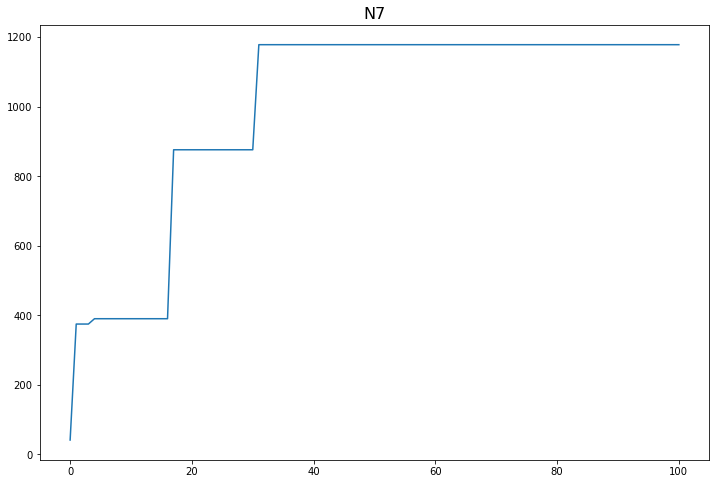

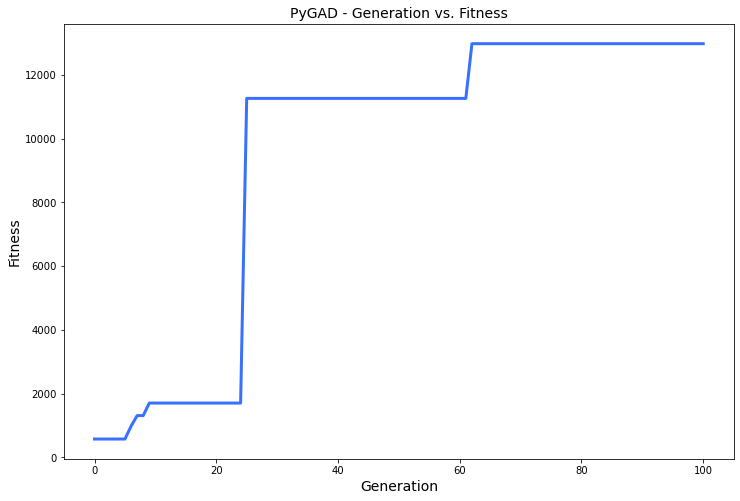

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.85 |==================| 27.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 24.767 |==================| 21.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.817 |==================| 443.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.837 |==================| 44.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.82 |==================| 169.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.846 |==================| 31.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.841 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.552 |==================| 87.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.539 |==================| 666.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.424 |==================| 8.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.431 |==================| 9.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 26.557 |==================| 58.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.512 |==================| 34.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.523 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.431 |==================| 9.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 26.557 |==================| 58.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.512 |==================| 34.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.523 |==================| 57.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 26.613 |==================| 13.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.471 |==================| 14.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 26.566 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.523 |==================| 57.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 26.613 |==================| 13.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.471 |==================| 14.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 26.566 |==================| 38.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.505 |==================| 27.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.457 |==================| 12.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 26.586 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.525 |==================| 63.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 26.548 |==================| 131.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 26.46 |==================| 12.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 26.49 |==================| 20.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 26.474 |==================| 15.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 117.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 26.588 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 26.548 |==================| 131.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 26.46 |==================| 12.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 26.49 |==================| 20.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 26.474 |==================| 15.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 117.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 26.588 |==================| 20.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.419 |==================| 8.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 26.587 |==================| 21.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 26.611 |==================| 14.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.498 |==================| 23.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 26.382 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.419 |==================| 8.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 26.587 |==================| 21.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 26.611 |==================| 14.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.498 |==================| 23.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 26.382 |==================| 6.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.453 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 26.587 |==================| 21.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 26.611 |==================| 14.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.498 |==================| 23.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 26.382 |==================| 6.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.453 |==================| 11.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 26.531 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.486 |==================| 18.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.566 |==================| 39.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.569 |==================| 35.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.424 |==================| 8.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.458 |==================| 12.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 26.429 |==================| 8.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 26.506 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.566 |==================| 39.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.569 |==================| 35.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.424 |==================| 8.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.458 |==================| 12.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 26.429 |==================| 8.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 26.506 |==================| 29.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.554 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.495 |==================| 22.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 26.404 |==================| 7.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.554 |==================| 72.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.514 |==================| 37.692 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.525 |==================| 63.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 26.545 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 26.404 |==================| 7.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.554 |==================| 72.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.514 |==================| 37.692 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.525 |==================| 63.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 26.545 |==================| 215.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.573 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 26.404 |==================| 7.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.554 |==================| 72.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.514 |==================| 37.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 26.585 |==================| 22.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 26.56 |==================| 51.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.508 |==================| 31.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.544 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 26.574 |==================| 29.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.546 |==================| 174.675 |==========
Fitness = 2209.6367717713224
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 26.585 |==================| 22.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 26.56 |==================| 51.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.508 |==================| 31.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.544 |==================| 269.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.546 |==================| 174.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 26.585 |==================| 22.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 26.56 |==================| 51.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.508 |==================| 31.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.544 |==================| 269.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 26.585 |==================| 22.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 26.471 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 26.61 |==================| 14.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.548 |==================| 126.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 26.579 |==================| 25.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 26.39 |==================| 6.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 26.6 |==================| 16.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 26.46 |==================| 12.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.557 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 26.39 |==================| 6.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 26.6 |==================| 16.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 26.46 |==================| 12.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.557 |==================| 61.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.528 |==================| 78.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 26.419 |==================| 8.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.397 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.491 |==================| 20.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 26.426 |==================| 8.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 26.451 |==================| 11.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.473 |==================| 14.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 26.508 |==================| 30.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.404 |==================| 7.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.439 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 26.426 |==================| 8.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 26.451 |==================| 11.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.473 |==================| 14.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 26.508 |==================| 30.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.404 |==================| 7.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.439 |==================| 9.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.397 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 26.451 |==================| 11.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.473 |==================| 14.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 26.508 |==================| 30.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.404 |==================| 7.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.439 |==================| 9.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.397 |==================| 6.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.532 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.539 |==================| 618.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.585 |==================| 22.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.567 |==================| 37.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 26.476 |==================| 15.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 26.558 |==================| 55.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.448 |==================| 10.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 26.608 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.585 |==================| 22.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.567 |==================| 37.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 26.476 |==================| 15.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 26.558 |==================| 55.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.448 |==================| 10.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 26.608 |==================| 14.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 26.598 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 117.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.543 |==================| 461.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 26.439 |==================| 9.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.436 |==================| 9.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.616 |==================| 13.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 26.44 |==================| 9.964 |==========
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.49

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.543 |==================| 461.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 26.439 |==================| 9.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.436 |==================| 9.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.616 |==================| 13.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 26.44 |==================| 9.964 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.493 |==================| 21.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 26.618 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.436 |==================| 9.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.616 |==================| 13.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 26.44 |==================| 9.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.567 |==================| 37.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.546 |==================| 163.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |==================| 100.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 26.574 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.567 |==================| 37.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.546 |==================| 163.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |==================| 100.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 26.574 |==================| 29.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 26.55 |==================| 100.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 26.561 |==================| 47.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.52 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.546 |==================| 163.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |==================| 100.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 26.574 |==================| 29.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 26.55 |==================| 100.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 26.561 |==================| 47.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.52 |==================| 49.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 26.591 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 26.612 |==================| 14.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 26.518 |==================| 45.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 26.593 |==================| 18.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 26.548 |==================| 125.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.598 |==================| 17.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 26.584 |==================| 23.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.395 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 26.518 |==================| 45.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 26.593 |==================| 18.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 26.548 |==================| 125.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.598 |==================| 17.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 26.584 |==================| 23.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.395 |==================| 6.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 26.579 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 26.427 |==================| 8.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.546 |==================| 164.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.426 |==================| 8.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.518 |==================| 44.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.421 |==================| 8.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.546 |==================| 164.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.426 |==================| 8.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.518 |==================| 44.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.421 |==================| 8.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 118.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.547 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.426 |==================| 8.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.518 |==================| 44.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.421 |==================| 8.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 118.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.547 |==================| 149.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 26.549 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 26.599 |==================| 16.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.541 |==================| 1304.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 26.472 |==================| 14.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.543 |==================| 339.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 26.591 |==================| 19.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 26.547 |==================| 150.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 26.427 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.541 |==================| 1304.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 26.472 |==================| 14.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.543 |==================| 339.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 26.591 |==================| 19.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 26.547 |==================| 150.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 26.427 |==================| 8.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 26.515 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 26.612 |==================| 13.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 26.589 |==================| 20.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 26.55 |==================| 100.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.581 |==================| 24.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 26.481 |==================| 16.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.468 |==================| 13.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 26.571 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 26.589 |==================| 20.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 26.55 |==================| 100.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.581 |==================| 24.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 26.481 |==================| 16.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.468 |==================| 13.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 26.571 |==================| 32.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 26.603 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 26.55 |==================| 100.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.581 |==================| 24.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 26.481 |==================| 16.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.468 |==================| 13.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 26.571 |==================| 32.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 26.603 |==================| 15.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 26.616 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 26.411 |==================| 7.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.483 |==================| 17.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.531 |==================| 110.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.616 |==================| 13.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 26.527 |==================| 77.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 26.615 |==================| 13.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.483 |==================| 17.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.531 |==================| 110.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.616 |==================| 13.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 26.527 |==================| 77.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 26.615 |==================| 13.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |==================| 27.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.554 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 26.394 |==================| 6.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.563 |==================| 44.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 26.607 |==================| 14.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.399 |==================| 7.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.463 |==================| 12.91 |==========
Generation = 17
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 26.457 |==================| 11.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.44 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.563 |==================| 44.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 26.607 |==================| 14.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.399 |==================| 7.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.463 |==================| 12.91 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 26.457 |==================| 11.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.44 |==================| 9.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 26.615 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.399 |==================| 7.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.463 |==================| 12.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 26.609 |==================| 14.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.52 |==================| 50.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 26.594 |==================| 18.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.399 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.52 |==================| 50.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 26.594 |==================| 18.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.399 |==================| 7.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.435 |==================| 9.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 26.391 |==================| 6.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.481 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 26.594 |==================| 18.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.399 |==================| 7.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.435 |==================| 9.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 26.391 |==================| 6.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.481 |==================| 16.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 26.525 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 26.51 |==================| 33.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 26.488 |==================| 18.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 26.461 |==================| 12.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.418 |==================| 8.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.476 |==================| 15.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 26.599 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 26.488 |==================| 18.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 26.461 |==================| 12.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.418 |==================| 8.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.476 |==================| 15.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 26.599 |==================| 17.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.476 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 26.588 |==================| 21.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.546 |==================| 192.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 26.569 |==================| 34.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 26.575 |==================| 28.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.39 |==================| 6.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 26.571 |==================| 32.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.502 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.546 |==================| 192.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 26.569 |==================| 34.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 26.575 |==================| 28.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.39 |==================| 6.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 26.571 |==================| 32.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.502 |==================| 26.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.465 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 26.569 |==================| 34.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 26.575 |==================| 28.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.39 |==================| 6.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 26.571 |==================| 32.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.502 |==================| 26.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.465 |==================| 13.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 26.57 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 26.427 |==================| 8.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 26.578 |==================| 26.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.391 |==================| 6.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 26.411 |==================| 7.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 26.537 |==================| 270.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 26.574 |==================| 29.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 26.591 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 26.578 |==================| 26.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.391 |==================| 6.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 26.411 |==================| 7.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 26.537 |==================| 270.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 26.574 |==================| 29.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 26.591 |==================| 19.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 26.411 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 26.561 |==================| 47.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.404 |==================| 7.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.483 |==================| 17.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.454 |==================| 11.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.473 |==================| 14.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.473 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.404 |==================| 7.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.483 |==================| 17.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.454 |==================| 11.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.473 |==================| 14.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.473 |==================| 14.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 26.559 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.483 |==================| 17.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.454 |==================| 11.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.473 |==================| 14.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.473 |==================| 14.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 26.559 |==================| 54.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.542 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.554 |==================| 70.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 26.592 |==================| 19.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 26.436 |==================| 9.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.442 |==================| 10.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 26.593 |==================| 19.123 |==========
Fitness = 9457.230926140479
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.585 |==================| 22.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.442 |==================| 10.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 26.593 |==================| 19.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.585 |==================| 22.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 26.613 |==================| 13.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.499 |==================| 24.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 26.449 |==================| 10.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 26.608 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 26.455 |==================| 11.766 |==========
Generation = 24
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.514 |==================| 37.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.448 |==================| 10.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.469 |==================| 13.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 26.551 |==================| 91.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.459 |==================| 12.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 26.60

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.514 |==================| 37.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.448 |==================| 10.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.469 |==================| 13.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 26.551 |==================| 91.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.459 |==================| 12.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 26.601 |==================| 16.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 26.551 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 26.597 |==================| 17.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 26.449 |==================| 10.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 26.549 |==================| 115.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 26.39 |==================| 6.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 26.605 |==================| 15.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 26.385 |==================| 6.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.414 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 26.549 |==================| 115.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 26.39 |==================| 6.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 26.605 |==================| 15.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 26.385 |==================| 6.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.414 |==================| 7.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.572 |==================| 31.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 26.548 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 26.385 |==================| 6.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.414 |==================| 7.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.572 |==================| 31.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 26.548 |==================| 138.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 26.578 |==================| 26.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 26.528 |==================| 82.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 26.584 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 26.596 |==================| 18.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 26.617 |==================| 12.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 26.564 |==================| 43.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.456 |==================| 11.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.561 |==================| 48.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 26.595 |==================| 18.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 26.607 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 26.564 |==================| 43.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.456 |==================| 11.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.561 |==================| 48.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 26.595 |==================| 18.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 26.607 |==================| 15.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 26.507 |==================| 29.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.504 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 26.486 |==================| 18.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.482 |==================| 17.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.482 |==================| 17.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 26.586 |==================| 21.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 26.481 |==================| 16.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.541 |==================| 1924.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.529 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.482 |==================| 17.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 26.586 |==================| 21.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 26.481 |==================| 16.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.541 |==================| 1924.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.529 |==================| 85.598 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 26.555 |==================| 69.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 26.57

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.541 |==================| 1924.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.529 |==================| 85.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.47 |==================| 14.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.406 |==================| 7.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.501 |==================| 25.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.532 |==================| 115.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.455 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.463 |==================| 12.998 |==========
Fitness = 9457.230926140479
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.47 |==================| 14.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.406 |==================| 7.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.501 |==================| 25.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.532 |==================| 115.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.455 |==================| 11.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.47 |==================| 14.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.406 |==================| 7.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.501 |==================| 25.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.532 |==================| 115.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.455 |==================| 11.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 26.575 |==================| 28.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.528 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.401 |==================| 7.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 26.381 |==================| 6.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 26.595 |==================| 18.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 26.584 |==================| 22.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 26.616 |==================| 13.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 26.446 |==================| 10.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 26.603 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 26.381 |==================| 6.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 26.595 |==================| 18.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 26.584 |==================| 22.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 26.616 |==================| 13.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 26.446 |==================| 10.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 26.603 |==================| 15.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 26.408 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 26.451 |==================| 11.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 26.609 |==================| 14.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 26.419 |==================| 8.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.457 |==================| 12.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 26.556 |==================| 64.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.39 |==================| 6.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.556 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 26.419 |==================| 8.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.457 |==================| 12.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 26.556 |==================| 64.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.39 |==================| 6.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.556 |==================| 62.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.519 |==================| 47.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 26.387 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.39 |==================| 6.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.556 |==================| 62.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.519 |==================| 47.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 26.387 |==================| 6.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 26.551 |==================| 97.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 26.561 |==================| 48.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.54 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 26.598 |==================| 17.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.412 |==================| 7.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.438 |==================| 9.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 26.609 |==================| 14.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.501 |==================| 25.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 26.437 |==================| 9.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.551 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.412 |==================| 7.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.438 |==================| 9.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 26.609 |==================| 14.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.501 |==================| 25.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 26.437 |==================| 9.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.551 |==================| 92.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 26.504 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 26.57 |==================| 33.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 26.598 |==================| 17.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 26.555 |==================| 68.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.42 |==================| 8.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.554 |==================| 75.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.43 |==================| 9.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 26.615 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.42 |==================| 8.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.554 |==================| 75.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.43 |==================| 9.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 26.615 |==================| 13.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 26.594 |==================| 18.781 |==========
Change = 2919.7703147464927
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.43 |==================| 9.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 26.615 |==================| 13.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 26.594 |==================| 18.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.416 |==================| 8.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 26.557 |==================| 59.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.484 |==================| 17.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.402 |==================| 7.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.465 |==================| 13.238 |==========
Fitness = 12377.001240886972
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.416 |==================| 8.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 26.557 |==================| 59.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.484 |==================| 17.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.465 |==================| 13.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.416 |==================| 8.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 26.557 |==================| 59.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.484 |==================| 17.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 26.584 |==================| 22.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 26.519 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 26.478 |==================| 16.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.518 |==================| 44.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.424 |==================| 8.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.48 |==================| 16.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 26.542 |==================| 549.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.544 |==================| 300.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.518 |==================| 44.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.424 |==================| 8.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.48 |==================| 16.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 26.542 |==================| 549.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.544 |==================| 300.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 106.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 26.616 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.543 |==================| 332.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.573 |==================| 31.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 26.599 |==================| 17.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.511 |==================| 34.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 26.592 |==================| 19.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.579 |==================| 25.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.526 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.573 |==================| 31.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 26.599 |==================| 17.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.511 |==================| 34.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 26.592 |==================| 19.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.579 |==================| 25.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.526 |==================| 71.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.462 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 26.599 |==================| 17.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.511 |==================| 34.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 26.592 |==================| 19.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.579 |==================| 25.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.526 |==================| 71.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.462 |==================| 12.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 26.601 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 26.593 |==================| 18.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.474 |==================| 15.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 26.577 |==================| 27.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 26.562 |==================| 45.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.603 |==================| 15.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 26.387 |==================| 6.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.538 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.474 |==================| 15.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 26.577 |==================| 27.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 26.562 |==================| 45.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.603 |==================| 15.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 26.387 |==================| 6.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.538 |==================| 437.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 26.61 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 26.582 |==================| 23.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.491 |==================| 20.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 26.607 |==================| 14.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.548 |==================| 130.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.38 |==================| 6.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.5 |==================| 24.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.423 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.491 |==================| 20.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 26.607 |==================| 14.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.548 |==================| 130.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.38 |==================| 6.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.5 |==================| 24.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.423 |==================| 8.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 26.617 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 26.607 |==================| 14.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.548 |==================| 130.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.38 |==================| 6.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.5 |==================| 24.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.423 |==================| 8.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 26.617 |==================| 13.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.581 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.462 |==================| 12.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 227.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 26.453 |==================| 11.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 26.442 |==================| 10.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 26.585 |==================| 22.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.394 |==================| 6.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.385 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 227.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 26.453 |==================| 11.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 26.442 |==================| 10.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 26.585 |==================| 22.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.394 |==================| 6.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.385 |==================| 6.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 26.561 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 26.606 |==================| 15.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |==================| 25.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 26.604 |==================| 15.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.58 |==================| 25.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.43 |==================| 9.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.456 |==================| 11.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 26.594 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |==================| 25.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 26.604 |==================| 15.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.58 |==================| 25.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.43 |==================| 9.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.456 |==================| 11.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 26.594 |==================| 18.548 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 26.592 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 26.604 |==================| 15.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.58 |==================| 25.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.43 |==================| 9.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.456 |==================| 11.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 26.594 |==================| 18.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.585 |==================| 22.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 26.569 |==================| 34.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 26.466 |==================| 13.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.391 |==================| 6.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.542 |==================| 617.492 |==========
Fitness = 12377.001240886972
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.585 |==================| 22.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 26.466 |==================| 13.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.391 |==================| 6.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.542 |==================| 617.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.585 |==================| 22.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 26.582 |==================| 24.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 26.595 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 26.569 |==================| 34.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 26.558 |==================| 58.206 |==========
Generation = 41
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 26.557 |==================| 60.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 26.58 |==================| 25.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 26.554 |==================| 75.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 26.517 |==================| 42.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 26.59

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 26.558 |==================| 58.206 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 26.557 |==================| 60.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 26.58 |==================| 25.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 26.554 |==================| 75.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 26.517 |==================| 42.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 26.596 |==================| 17.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 26.553 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.571 |==================| 33.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 26.587 |==================| 21.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 26.441 |==================| 10.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.576 |==================| 28.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.417 |==================| 8.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.58 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 26.587 |==================| 21.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 26.441 |==================| 10.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.576 |==================| 28.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.417 |==================| 8.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.58 |==================| 25.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 26.604 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 26.587 |==================| 21.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 26.441 |==================| 10.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.576 |==================| 28.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.417 |==================| 8.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.58 |==================| 25.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 26.604 |==================| 15.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 26.448 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 26.41 |==================| 7.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.495 |==================| 22.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 26.52 |==================| 49.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 26.531 |==================| 112.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 26.604 |==================| 15.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.552 |==================| 87.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 26.604 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 26.531 |==================| 112.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 26.604 |==================| 15.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.552 |==================| 87.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 26.604 |==================| 15.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 26.443 |==================| 10.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.382 |==================| 6.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 26.452 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.38 |==================| 6.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 26.579 |==================| 25.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 26.42 |==================| 8.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 26.589 |==================| 20.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 26.43 |==================| 9.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 26.57 |==================| 33.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.388 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 26.589 |==================| 20.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 26.43 |==================| 9.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 26.57 |==================| 33.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.388 |==================| 6.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.424 |==================| 8.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 26.559 |==================| 54.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.397 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 26.43 |==================| 9.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 26.57 |==================| 33.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.388 |==================| 6.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.424 |==================| 8.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 26.559 |==================| 54.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.397 |==================| 6.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.503 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 26.471 |==================| 14.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 26.618 |==================| 12.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.542 |==================| 778.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 26.544 |==================| 275.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 26.533 |==================| 135.808 |==========
Fitness = 12377.001240886972
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.503 |==================| 26.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 26.618 |==================| 12.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.542 |==================| 778.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 26.544 |==================| 275.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 26.533 |==================| 135.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.503 |==================| 26.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 26.495 |==================| 21.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 26.598 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 26.59 |==================| 20.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.51 |==================| 32.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.578 |==================| 26.57 |==========
Generation = 46
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.42 |==================| 8.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.464 |==================| 13.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 26.549 |==================| 114.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.556 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.51 |==================| 32.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.578 |==================| 26.57 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.42 |==================| 8.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.464 |==================| 13.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 26.549 |==================| 114.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.556 |==================| 65.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 26.411 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.578 |==================| 26.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 26.611 |==================| 14.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 26.615 |==================| 13.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 26.614 |==================| 13.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 26.553 |==================| 81.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 26.609 |==================| 14.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 26.592 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 26.611 |==================| 14.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 26.615 |==================| 13.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 26.614 |==================| 13.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 26.553 |==================| 81.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 26.609 |==================| 14.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 26.592 |==================| 19.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 26.389 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 26.615 |==================| 13.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 26.614 |==================| 13.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 26.553 |==================| 81.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 26.609 |==================| 14.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 26.592 |==================| 19.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 26.389 |==================| 6.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 26.526 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.467 |==================| 13.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 26.611 |==================| 14.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.573 |==================| 30.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.523 |==================| 56.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 26.519 |==================| 46.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 26.594 |==================| 18.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 26.596 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.523 |==================| 56.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 26.519 |==================| 46.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 26.594 |==================| 18.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 26.596 |==================| 17.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 26.496 |==================| 22.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 26.605 |==================| 15.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 26.567 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 26.614 |==================| 13.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.491 |==================| 20.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 26.571 |==================| 32.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 26.411 |==================| 7.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 26.423 |==================| 8.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.598 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.491 |==================| 20.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 26.571 |==================| 32.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 26.411 |==================| 7.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 26.423 |==================| 8.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.598 |==================| 17.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 26.606 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 26.571 |==================| 32.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 26.411 |==================| 7.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 26.423 |==================| 8.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.598 |==================| 17.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 26.606 |==================| 15.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 26.504 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 26.617 |==================| 13.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.47 |==================| 14.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 26.602 |==================| 16.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.383 |==================| 6.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.527 |==================| 76.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 26.613 |==================| 13.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.474 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.47 |==================| 14.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 26.602 |==================| 16.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.383 |==================| 6.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.527 |==================| 76.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 26.613 |==================| 13.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.474 |==================| 15.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.399 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 26.616 |==================| 13.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 26.594 |==================| 18.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 26.584 |==================| 22.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.415 |==================| 7.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.465 |==================| 13.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.538 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 26.594 |==================| 18.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 26.584 |==================| 22.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.415 |==================| 7.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.465 |==================| 13.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.538 |==================| 431.545 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.543 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.415 |==================| 7.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.465 |==================| 13.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.538 |==================| 431.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 26.548 |==================| 138.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 26.566 |==================| 38.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.54 |==================| 13881.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 26.548 |==================| 138.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 26.566 |==================| 38.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.54 |==================| 13881.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 230.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.54 |==================| 7931.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.593 |==================| 18.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 26.565 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 230.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.54 |==================| 7931.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.593 |==================| 18.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 26.565 |==================| 41.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 15.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 26.605 |==================| 15.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 26.57 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 26.566 |==================| 38.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.579 |==================| 25.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 26.599 |==================| 16.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 26.548 |==================| 134.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.57 |==================| 34.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.386 |==================| 6.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 26.582 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.579 |==================| 25.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 26.599 |==================| 16.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 26.548 |==================| 134.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.57 |==================| 34.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.386 |==================| 6.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 26.582 |==================| 24.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 26.568 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 26.615 |==================| 13.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.425 |==================| 8.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 26.608 |==================| 14.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.503 |==================| 27.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 26.604 |==================| 15.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 26.451 |==================| 11.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.571 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.425 |==================| 8.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 26.608 |==================| 14.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.503 |==================| 27.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 26.604 |==================| 15.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 26.451 |==================| 11.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.571 |==================| 33.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.499 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 26.608 |==================| 14.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.503 |==================| 27.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 26.604 |==================| 15.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 26.451 |==================| 11.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.571 |==================| 33.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.499 |==================| 23.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.465 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 26.57 |==================| 34.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 15.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.48 |==================| 16.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.484 |==================| 17.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 26.478 |==================| 16.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 26.582 |==================| 23.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.569 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.48 |==================| 16.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.484 |==================| 17.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 26.478 |==================| 16.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 26.582 |==================| 23.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.569 |==================| 34.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 26.602 |==================| 16.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.594 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.448 |==================| 10.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.427 |==================| 8.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 26.428 |==================| 8.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 26.439 |==================| 9.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.528 |==================| 83.886 |==========
Generation = 56
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.56 |==================| 50.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 26.562 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.427 |==================| 8.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 26.428 |==================| 8.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 26.439 |==================| 9.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.528 |==================| 83.886 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.56 |==================| 50.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 26.562 |==================| 45.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.381 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.528 |==================| 83.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.538 |==================| 455.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.494 |==================| 21.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.401 |==================| 7.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 26.586 |==================| 21.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.388 |==================| 6.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.546 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.494 |==================| 21.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.401 |==================| 7.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 26.586 |==================| 21.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.388 |==================| 6.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.546 |==================| 177.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.493 |==================| 21.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.394 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.401 |==================| 7.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 26.586 |==================| 21.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.388 |==================| 6.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.546 |==================| 177.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.493 |==================| 21.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.394 |==================| 6.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 26.573 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 26.415 |==================| 7.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 26.587 |==================| 21.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 26.55 |==================| 109.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.548 |==================| 130.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 26.617 |==================| 13.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 26.539 |==================| 789.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 26.481 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 26.587 |==================| 21.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 26.55 |==================| 109.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.548 |==================| 130.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 26.617 |==================| 13.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 26.539 |==================| 789.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 26.481 |==================| 16.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.416 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 26.531 |==================| 107.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.428 |==================| 8.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 26.506 |==================| 29.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 26.402 |==================| 7.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.397 |==================| 6.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 26.507 |==================| 29.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 26.613 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.428 |==================| 8.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 26.506 |==================| 29.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 26.402 |==================| 7.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.397 |==================| 6.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 26.507 |==================| 29.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 26.613 |==================| 13.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 26.545 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 26.506 |==================| 29.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 26.402 |==================| 7.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.397 |==================| 6.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 26.507 |==================| 29.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 26.613 |==================| 13.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 26.545 |==================| 216.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 26.604 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 26.576 |==================| 28.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 26.492 |==================| 20.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.575 |==================| 29.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.487 |==================| 18.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 26.587 |==================| 21.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 26.587 |==================| 21.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 26.529 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 26.492 |==================| 20.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.575 |==================| 29.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.487 |==================| 18.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 26.587 |==================| 21.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 26.587 |==================| 21.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 26.529 |==================| 87.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 26.616 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 26.554 |==================| 71.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 26.588 |==================| 20.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 26.449 |==================| 10.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 26.395 |==================| 6.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.383 |==================| 6.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 229.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 26.601 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 26.588 |==================| 20.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 26.449 |==================| 10.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 26.395 |==================| 6.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.383 |==================| 6.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 229.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 26.601 |==================| 16.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.412 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 26.449 |==================| 10.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 26.395 |==================| 6.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.383 |==================| 6.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 229.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 26.601 |==================| 16.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.412 |==================| 7.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.4 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 26.436 |==================| 9.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 26.497 |==================| 23.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 26.525 |==================| 64.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 26.516 |==================| 41.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 26.433 |==================| 9.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.459 |==================| 12.234 |==========
Fitness = 13881.861760353055
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 26.525 |==================| 64.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 26.516 |==================| 41.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 26.433 |==================| 9.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.459 |==================| 12.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.568 |==================| 36.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 26.608 |==================| 14.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.544 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.471 |==================| 14.479 |==========
Generation = 63
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 26.576 |==================| 27.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 14.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.543 |==================| 375.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 118.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 26.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 26.576 |==================| 27.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 14.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.543 |==================| 375.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 118.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 26.611 |==================| 14.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.584 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.578 |==================| 26.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 26.404 |==================| 7.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 26.594 |==================| 18.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.472 |==================| 14.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.478 |==================| 16.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.384 |==================| 6.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.45 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 26.594 |==================| 18.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.472 |==================| 14.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.478 |==================| 16.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.384 |==================| 6.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.45 |==================| 11.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.55 |==================| 103.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 26.575 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.384 |==================| 6.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.45 |==================| 11.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.55 |==================| 103.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 26.575 |==================| 28.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 26.577 |==================| 27.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 26.507 |==================| 30.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.506 |==================| 28.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.459 |==================| 12.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 26.599 |==================| 16.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.438 |==================| 9.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.556 |==================| 65.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 26.599 |==================| 17.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.43 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.459 |==================| 12.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 26.599 |==================| 16.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.438 |==================| 9.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.556 |==================| 65.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 26.599 |==================| 17.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.43 |==================| 9.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.453 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 26.526 |==================| 67.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 26.551 |==================| 98.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.467 |==================| 13.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 26.617 |==================| 13.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 26.613 |==================| 13.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 26.603 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.467 |==================| 13.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 26.617 |==================| 13.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 26.613 |==================| 13.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 26.603 |==================| 16.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 26.511 |==================| 34.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 26.546 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 26.613 |==================| 13.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 26.603 |==================| 16.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 26.511 |==================| 34.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 26.546 |==================| 173.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.57 |==================| 34.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.446 |==================| 10.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.584 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 26.566 |==================| 38.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 26.614 |==================| 13.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.571 |==================| 33.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.144 |==========
Fitness = 13881.861760353055
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.446 |==================| 10.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.584 |==================| 23.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.571 |==================| 33.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.446 |==================| 10.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.584 |==================| 23.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.541 |==================| 1184.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.481 |==================| 16.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 26.594 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.446 |==================| 10.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.542 |==================| 870.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 26.487 |==================| 18.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 26.564 |==================| 42.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 26.532 |==================| 126.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 26.445 |==================| 10.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 26.564 |==================| 42.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 26.532 |==================| 126.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 26.445 |==================| 10.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |==================| 27.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 26.562 |==================| 45.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 26.591 |==================| 19.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 26.447 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.553 |==================| 76.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.4 |==================| 7.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 26.421 |==================| 8.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.519 |==================| 47.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==================| 401.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.562 |==================| 46.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.509 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.519 |==================| 47.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==================| 401.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.562 |==================| 46.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.509 |==================| 32.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.417 |==================| 8.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 26.614 |==================| 13.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 26.598 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.562 |==================| 46.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.509 |==================| 32.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.417 |==================| 8.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 26.614 |==================| 13.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 26.598 |==================| 17.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.398 |==================| 7.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 26.609 |==================| 14.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 26.485 |==================| 18.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.393 |==================| 6.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 26.382 |==================| 6.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 26.444 |==================| 10.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.517 |==================| 43.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.457 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 26.485 |==================| 18.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.393 |==================| 6.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 26.382 |==================| 6.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 26.444 |==================| 10.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.517 |==================| 43.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.457 |==================| 12.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.543 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.438 |==================| 9.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.543 |==================| 435.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.532 |==================| 116.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.394 |==================| 6.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 26.432 |==================| 9.215 |==========
Generation = 71
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 26.437 |==================| 9.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.612

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.543 |==================| 435.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.532 |==================| 116.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.394 |==================| 6.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 26.432 |==================| 9.215 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 26.437 |==================| 9.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.612 |==================| 13.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 26.6 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.532 |==================| 116.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.394 |==================| 6.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 26.432 |==================| 9.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.483 |==================| 17.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 26.496 |==================| 22.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 26.467 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.48 |==================| 16.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 26.595 |==================| 18.179 |==========
Fitness = 13881.861760353055
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.483 |==================| 17.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 26.496 |==================| 22.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 26.467 |==================| 13.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 26.595 |==================| 18.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.483 |==================| 17.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 26.496 |==================| 22.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 26.467 |==================| 13.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 26.614 |==================| 13.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 26.54 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.579 |==================| 25.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.379 |==================| 6.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.494 |==================| 21.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 26.447 |==================| 10.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.425 |==================| 8.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.501 |==================| 25.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 26.611 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.379 |==================| 6.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.494 |==================| 21.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 26.447 |==================| 10.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.425 |==================| 8.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.501 |==================| 25.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 26.611 |==================| 14.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.4 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 26.602 |==================| 16.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 26.492 |==================| 20.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.563 |==================| 44.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.487 |==================| 18.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 26.568 |==================| 36.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.425 |==================| 8.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 26.617 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 26.492 |==================| 20.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.563 |==================| 44.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.487 |==================| 18.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 26.568 |==================| 36.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.425 |==================| 8.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 26.617 |==================| 12.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 26.596 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.563 |==================| 44.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.487 |==================| 18.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 26.568 |==================| 36.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.425 |==================| 8.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 26.617 |==================| 12.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 26.596 |==================| 18.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.408 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 26.433 |==================| 9.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.44 |==================| 9.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 26.505 |==================| 28.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 26.419 |==================| 8.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 26.42 |==================| 8.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.427 |==================| 8.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 26.603 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.44 |==================| 9.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 26.505 |==================| 28.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 26.419 |==================| 8.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 26.42 |==================| 8.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.427 |==================| 8.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 26.603 |==================| 16.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.5 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 26.577 |==================| 27.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 26.56 |==================| 51.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 26.596 |==================| 17.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.593 |==================| 18.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 26.552 |==================| 83.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 26.603 |==================| 15.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 26.605 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 26.56 |==================| 51.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 26.596 |==================| 17.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.593 |==================| 18.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 26.552 |==================| 83.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 26.603 |==================| 15.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 26.605 |==================| 15.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.475 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 26.596 |==================| 17.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.593 |==================| 18.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 26.552 |==================| 83.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 26.603 |==================| 15.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 26.605 |==================| 15.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.475 |==================| 15.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 26.588 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 26.576 |==================| 28.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 26.587 |==================| 21.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.48 |==================| 16.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 26.443 |==================| 10.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.564 |==================| 41.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==================| 6.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.461 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 26.587 |==================| 21.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.48 |==================| 16.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 26.443 |==================| 10.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.564 |==================| 41.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==================| 6.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.461 |==================| 12.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.572 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 26.575 |==================| 29.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 26.605 |==================| 15.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.525 |==================| 63.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.528 |==================| 83.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 14.988 |==========
Generation = 78
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 26.532 |==================| 121.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 26.54

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.525 |==================| 63.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.528 |==================| 83.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 14.988 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 26.532 |==================| 121.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 26.541 |==================| 1530.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.554 |==================| 71.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 26.59

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 26.618 |==================| 12.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.495 |==================| 22.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 26.413 |==================| 7.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 26.449 |==================| 10.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 26.556 |==================| 65.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.389 |==================| 6.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.495 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 26.449 |==================| 10.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 26.556 |==================| 65.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.389 |==================| 6.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.495 |==================| 22.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.575 |==================| 28.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 26.435 |==================| 9.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 26.592 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.495 |==================| 22.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.575 |==================| 28.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 26.435 |==================| 9.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 26.592 |==================| 19.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 26.615 |==================| 13.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.498 |==================| 23.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 26.602 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 26.481 |==================| 16.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.514 |==================| 37.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 26.416 |==================| 8.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.556 |==================| 62.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 26.571 |==================| 33.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.395 |==================| 6.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.451 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 26.416 |==================| 8.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.556 |==================| 62.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 26.571 |==================| 33.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.395 |==================| 6.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.451 |==================| 11.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 26.542 |==================| 547.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 26.466 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 26.617 |==================| 13.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 26.559 |==================| 52.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==================| 407.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 26.559 |==================| 52.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.478 |==================| 15.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.421 |==================| 8.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 26.615 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 26.559 |==================| 52.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==================| 407.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 26.559 |==================| 52.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.478 |==================| 15.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.421 |==================| 8.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 26.615 |==================| 13.344 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 26.58 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==================| 407.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 26.559 |==================| 52.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.478 |==================| 15.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.421 |==================| 8.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 26.615 |==================| 13.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.438 |==================| 9.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 26.455 |==================| 11.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 26.615 |==================| 13.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 26.536 |==================| 217.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 26.585 |==================| 22.6 |==========
Fitness = 13881.861760353055
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.438 |==================| 9.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 26.615 |==================| 13.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 26.536 |==================| 217.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 26.585 |==================| 22.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.438 |==================| 9.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 26.504 |==================| 27.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 26.515 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 26.601 |==================| 16.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 26.615 |==================| 13.429 |==========
Generation = 83
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.415 |==================| 7.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 26.56 |==================| 49.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 26.599 |==================| 17.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 26.608 |==================| 14.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.396 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 26.615 |==================| 13.429 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.415 |==================| 7.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 26.56 |==================| 49.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 26.599 |==================| 17.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 26.608 |==================| 14.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.396 |==================| 6.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.438 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.528 |==================| 83.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 26.541 |==================| 1101.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 26.567 |==================| 37.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 26.582 |==================| 24.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 26.608 |==================| 14.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 26.593 |==================| 18.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.503 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 26.541 |==================| 1101.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 26.567 |==================| 37.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 26.582 |==================| 24.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 26.608 |==================| 14.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 26.593 |==================| 18.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.503 |==================| 26.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.524 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 26.567 |==================| 37.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 26.582 |==================| 24.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 26.608 |==================| 14.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 26.593 |==================| 18.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.503 |==================| 26.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.524 |==================| 60.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.542 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.402 |==================| 7.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.476 |==================| 15.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.556 |==================| 65.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.523 |==================| 57.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.536 |==================| 237.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.598 |==================| 17.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 26.615 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.476 |==================| 15.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.556 |==================| 65.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.523 |==================| 57.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.536 |==================| 237.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.598 |==================| 17.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 26.615 |==================| 13.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.565 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.418 |==================| 8.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 26.612 |==================| 13.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.43 |==================| 9.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 26.583 |==================| 23.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.514 |==================| 37.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.438 |==================| 9.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.534 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 26.612 |==================| 13.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.43 |==================| 9.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 26.583 |==================| 23.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.514 |==================| 37.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.438 |==================| 9.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.534 |==================| 165.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.534 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.43 |==================| 9.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 26.583 |==================| 23.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.514 |==================| 37.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.438 |==================| 9.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.534 |==================| 165.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.534 |==================| 166.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 26.509 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.424 |==================| 8.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.416 |==================| 8.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 26.615 |==================| 13.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.525 |==================| 65.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 26.616 |==================| 13.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 26.575 |==================| 28.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 26.488 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.416 |==================| 8.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 26.615 |==================| 13.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.525 |==================| 65.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 26.616 |==================| 13.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 26.575 |==================| 28.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 26.488 |==================| 18.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 26.613 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 26.381 |==================| 6.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 26.614 |==================| 13.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.534 |==================| 151.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.482 |==================| 17.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 26.611 |==================| 14.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.516 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 26.614 |==================| 13.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.534 |==================| 151.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.482 |==================| 17.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 26.611 |==================| 14.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.516 |==================| 41.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.534 |==================| 151.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.482 |==================| 17.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 26.611 |==================| 14.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.516 |==================| 41.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 26.452 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.541 |==================| 2885.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.386 |==================| 6.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.405 |==================| 7.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.495 |==================| 22.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.484 |==================| 17.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.629 |==========
Fitness = 13881.861760353055
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.386 |==================| 6.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.405 |==================| 7.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.495 |==================| 22.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.484 |==================| 17.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 26.484 |==================| 17.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.58 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.495 |==================| 22.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.458 |==================| 12.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 26.56 |==================| 51.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 26.454 |==================| 11.535 |==========
Generation = 90
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 26.595 |==================| 18.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 26.571 |==================| 32.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 26.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.458 |==================| 12.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 26.56 |==================| 51.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 26.454 |==================| 11.535 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 26.595 |==================| 18.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 26.571 |==================| 32.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 26.573 |==================| 30.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 26.391 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 26.56 |==================| 51.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 26.454 |==================| 11.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.557 |==================| 61.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.583 |==================| 23.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.553 |==================| 78.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.559 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 26.569 |==================| 34.787 |==========
Fitness = 13881.861760353055
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.557 |==================| 61.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.583 |==================| 23.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.553 |==================| 78.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.559 |==================| 53.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.557 |==================| 61.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.583 |==================| 23.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.553 |==================| 78.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.559 |==================| 53.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 26.613 |==================| 13.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.399 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 26.56 |==================| 51.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 26.441 |==================| 10.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.386 |==================| 6.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.473 |==================| 14.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.569 |==================| 35.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.398 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 26.441 |==================| 10.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.386 |==================| 6.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.473 |==================| 14.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.569 |==================| 35.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.398 |==================| 7.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.403 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 26.569 |==================| 34.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.584 |==================| 23.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.547 |==================| 142.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.403 |==================| 7.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 26.571 |==================| 32.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 26.524 |==================| 61.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.504 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.584 |==================| 23.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.547 |==================| 142.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.403 |==================| 7.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 26.571 |==================| 32.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 26.524 |==================| 61.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.504 |==================| 27.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.487 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.547 |==================| 142.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.403 |==================| 7.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 26.571 |==================| 32.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 26.524 |==================| 61.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.504 |==================| 27.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.487 |==================| 18.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.469 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.584 |==================| 22.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 26.429 |==================| 9.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 26.597 |==================| 17.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 26.551 |==================| 98.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.381 |==================| 6.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 26.433 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 26.429 |==================| 9.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 26.597 |==================| 17.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 26.551 |==================| 98.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.381 |==================| 6.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 26.433 |==================| 9.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 26.411 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.585 |==================| 22.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 26.605 |==================| 15.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 26.598 |==================| 17.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.522 |==================| 54.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 26.421 |==================| 8.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.575 |==================| 29.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 26.596 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.522 |==================| 54.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 26.421 |==================| 8.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.575 |==================| 29.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 26.596 |==================| 17.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.543 |==================| 327.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.503 |==================| 27.118 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 26.607

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 26.596 |==================| 17.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.543 |==================| 327.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.503 |==================| 27.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 26.557 |==================| 58.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.482 |==================| 17.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.456 |==================| 11.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.544 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.45 |==================| 11.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 26.39 |==================| 6.648 |==========
Fitness = 13881.861760353055
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 26.557 |==================| 58.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.482 |==================| 17.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.456 |==================| 11.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.544 |==================| 305.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 26.39 |==================| 6.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 26.557 |==================| 58.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.482 |==================| 17.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.456 |==================| 11.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.544 |==================| 305.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 26.56 |==================| 51.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.434 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 26.563 |==================| 44.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 26.599 |==================| 17.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 26.55 |==================| 99.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 26.466 |==================| 13.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 26.602 |==================| 16.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.385 |==================| 6.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 26.591 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 26.599 |==================| 17.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 26.55 |==================| 99.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 26.466 |==================| 13.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 26.602 |==================| 16.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.385 |==================| 6.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 26.591 |==================| 19.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 26.61 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 26.443 |==================| 10.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 26.529 |==================| 87.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 106.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.607 |==================| 14.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 26.596 |==================| 18.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.483 |==================| 17.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.475 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 26.529 |==================| 87.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 106.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.607 |==================| 14.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 26.596 |==================| 18.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.483 |==================| 17.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.475 |==================| 15.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.499 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 106.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.607 |==================| 14.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 26.596 |==================| 18.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.483 |==================| 17.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.475 |==================| 15.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.499 |==================| 24.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.397 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 26.581 |==================| 24.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.547 |==================| 146.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.428 |==================| 8.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.507 |==================| 29.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 26.56 |==================| 49.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 26.574 |==================| 30.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 26.472 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.547 |==================| 146.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.428 |==================| 8.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.507 |==================| 29.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 26.56 |==================| 49.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 26.574 |==================| 30.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 26.472 |==================| 14.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 26.407 |==================| 7.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 26.561 |==================| 47.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.444 |==================| 10.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 26.429 |==================| 8.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.556 |==================| 62.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 26.615 |==================| 13.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.399 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 26.561 |==================| 47.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.444 |==================| 10.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 26.429 |==================| 8.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.556 |==================| 62.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 26.615 |==================| 13.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.399 |==================| 7.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.444 |==================| 10.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 26.429 |==================| 8.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.556 |==================| 62.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 26.615 |==================| 13.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.399 |==================| 7.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 26.595 |================

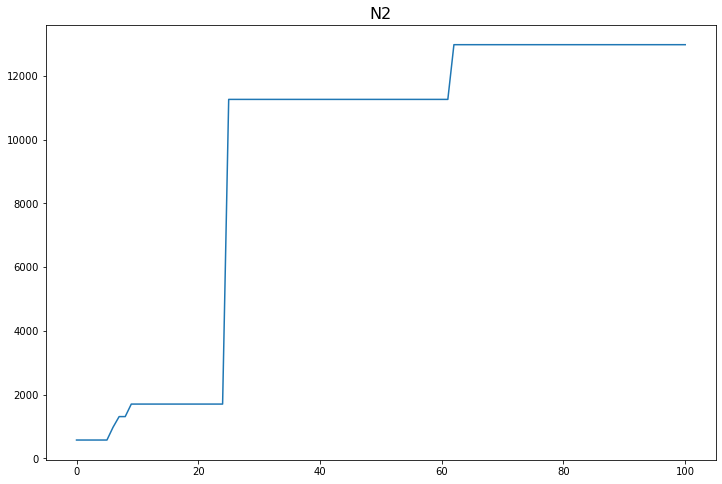

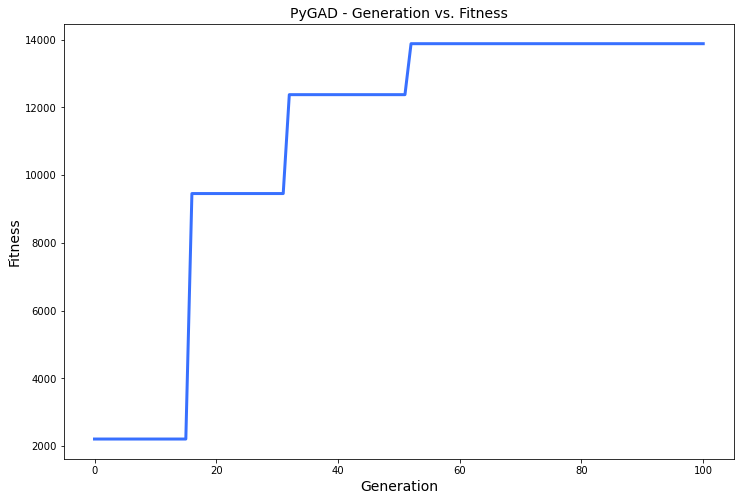

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 26.505 |==================| 28.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.435 |==================| 9.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 26.538 |==================| 378.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.439 |===========| 26.389 |==================| 6.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 26.448 |==================| 10.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 26.604 |==================| 15.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 26.569 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.019 |==================| 7.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 26.879 |==================| 134.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.026 |==================| 7.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 26.482 |==================| 2.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.03 |==================| 6.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.594 |==================| 3.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.96 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 26.482 |==================| 2.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.03 |==================| 6.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.594 |==================| 3.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.96 |==================| 13.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.862 |==================| 40.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 26.934 |==================| 20.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 26.771 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.03 |==================| 6.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.594 |==================| 3.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.96 |==================| 13.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.862 |==================| 40.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 26.934 |==================| 20.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 26.771 |==================| 8.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.734 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 26.915 |==================| 34.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.826 |==================| 16.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.011 |==================| 7.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.065 |==================| 5.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 26.891 |==================| 193.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.528 |==================| 2.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.875 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.011 |==================| 7.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.065 |==================| 5.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 26.891 |==================| 193.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.528 |==================| 2.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.875 |==================| 90.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 26.725 |==================| 6.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 26.469 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.048 |==================| 6.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.768 |==================| 8.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.951 |==================| 15.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |==================| 9.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.065 |==================| 5.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 26.987 |==================| 9.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.048 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.768 |==================| 8.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.951 |==================| 15.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |==================| 9.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.065 |==================| 5.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 26.987 |==================| 9.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.048 |==================| 6.163 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.9 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.951 |==================| 15.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |==================| 9.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.065 |==================| 5.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 26.987 |==================| 9.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.048 |==================| 6.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.754 |==================| 7.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.624 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.039 |==================| 6.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.959 |==================| 13.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 26.99 |==================| 9.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.826 |==================| 16.727 |==========
Fitness = 3639.9151323427586
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.754 |==================| 7.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.624 |==================| 3.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.959 |==================| 13.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 26.99 |==================| 9.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.826 |==================| 16.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.754 |==================| 7.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.624 |==================| 3.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.734 |==================| 6.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 26.963 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 26.938 |==================| 19.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 26.945 |==================| 16.998 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.802 |==================| 11.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 26.685 |==================| 4.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.96 |==================| 13.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |==================| 6.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.588 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 26.945 |==================| 16.998 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.802 |==================| 11.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 26.685 |==================| 4.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.96 |==================| 13.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |==================| 6.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.588 |==================| 3.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.69 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 26.505 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.08 |==================| 5.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.577 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.675 |==================| 4.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.858 |==================| 36.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.034 |==================| 6.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 26.972 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.08 |==================| 5.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.577 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.675 |==================| 4.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.858 |==================| 36.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.034 |==================| 6.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 26.972 |==================| 11.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 26.875 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.577 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.675 |==================| 4.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.858 |==================| 36.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.034 |==================| 6.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 26.972 |==================| 11.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 26.875 |==================| 87.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.783 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.996 |==================| 9.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.971 |==================| 11.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 26.567 |==================| 3.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.58 |==================| 3.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.031 |==================| 6.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 26.956 |==================| 14.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.912 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.971 |==================| 11.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 26.567 |==================| 3.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.58 |==================| 3.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.031 |==================| 6.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 26.956 |==================| 14.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.912 |==================| 39.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.855 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.633 |==================| 3.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.578 |==================| 3.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.042 |==================| 6.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.601 |==================| 3.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.849 |==================| 26.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.751 |==================| 7.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 26.964 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.578 |==================| 3.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.042 |==================| 6.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.601 |==================| 3.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.849 |==================| 26.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.751 |==================| 7.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 26.964 |==================| 12.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 26.649 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.601 |==================| 3.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.849 |==================| 26.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.751 |==================| 7.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 26.964 |==================| 12.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 26.649 |==================| 4.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 26.836 |==================| 19.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 26.931 |==================| 21.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.064 |==================| 5.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.054 |==================| 5.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 26.575 |==================| 3.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 26.961 |==================| 13.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 26.75 |==================| 7.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.064 |==================| 5.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.054 |==================| 5.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 26.575 |==================| 3.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 26.961 |==================| 13.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 26.75 |==================| 7.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |==================| 6.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 26.891 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 26.94 |==================| 18.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 26.566 |==================| 3.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.483 |==================| 2.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.803 |==================| 12.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 26.988 |==================| 9.825 |==========
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.058

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 26.566 |==================| 3.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.483 |==================| 2.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.803 |==================| 12.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 26.988 |==================| 9.825 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.058 |==================| 5.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 26.585 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.483 |==================| 2.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.803 |==================| 12.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 26.988 |==================| 9.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.678 |==================| 4.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.991 |==================| 9.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.901 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 26.796 |==================| 11.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 26.605 |==================| 3.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 26.533 |==================| 2.832 |==========
Fitness = 3639.9151323427586
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.678 |==================| 4.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.991 |==================| 9.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.901 |==================| 67.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 26.605 |==================| 3.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 26.533 |==================| 2.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.678 |==================| 4.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.991 |==================| 9.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.901 |==================| 67.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.916 |==================| 33.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 26.56 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 26.496 |==================| 2.561 |==========
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.489 |==================| 2.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.921 |==================| 28.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 26.931 |==================| 22.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 26.633 |==================| 3.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.517 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.997

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.489 |==================| 2.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.921 |==================| 28.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 26.931 |==================| 22.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 26.633 |==================| 3.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.517 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.997 |==================| 8.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.829 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.004 |==================| 8.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.038 |==================| 6.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.945 |==================| 16.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.789 |==================| 10.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 26.885 |==================| 1866.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.675 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.038 |==================| 6.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.945 |==================| 16.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.789 |==================| 10.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 26.885 |==================| 1866.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.675 |==================| 4.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 26.665 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.945 |==================| 16.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.789 |==================| 10.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 26.885 |==================| 1866.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.675 |==================| 4.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 26.665 |==================| 4.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 26.965 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 26.636 |==================| 4.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 26.55 |==================| 2.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 26.953 |==================| 14.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.821 |==================| 15.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.012 |==================| 7.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.565 |==================| 3.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 26.82 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 26.55 |==================| 2.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 26.953 |==================| 14.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.821 |==================| 15.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.012 |==================| 7.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.565 |==================| 3.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 26.82 |==================| 15.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.036 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 26.891 |==================| 191.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 27.043 |==================| 6.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 29.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.818 |==================| 14.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 26.733 |==================| 6.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.622 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.947 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 27.043 |==================| 6.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 29.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.818 |==================| 14.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 26.733 |==================| 6.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.622 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.947 |==================| 16.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.827 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 29.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.818 |==================| 14.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 26.733 |==================| 6.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.622 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.947 |==================| 16.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.827 |==================| 17.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 26.982 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.796 |==================| 11.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.996 |==================| 9.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.713 |==================| 5.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 26.974 |==================| 11.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 26.834 |==================| 19.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 26.954 |==================| 14.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.084 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.996 |==================| 9.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.713 |==================| 5.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 26.974 |==================| 11.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 26.834 |==================| 19.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 26.954 |==================| 14.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.084 |==================| 5.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 26.68 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.822 |==================| 15.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 26.609 |==================| 3.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.014 |==================| 7.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.854 |==================| 31.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.677 |==================| 4.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.741 |==================| 6.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 26.867 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 26.609 |==================| 3.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.014 |==================| 7.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.854 |==================| 31.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.677 |==================| 4.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.741 |==================| 6.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 26.867 |==================| 51.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 26.986 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.014 |==================| 7.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.854 |==================| 31.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.677 |==================| 4.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.741 |==================| 6.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 26.867 |==================| 51.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 26.986 |==================| 10.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.837 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.713 |==================| 5.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.998 |==================| 8.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.48 |==================| 2.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 26.494 |==================| 2.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.996 |==================| 9.073 |==========
Fitness = 3639.9151323427586
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.837 |==================| 20.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.998 |==================| 8.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.48 |==================| 2.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 26.494 |==================| 2.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.996 |==================| 9.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.837 |==================| 20.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.023 |==================| 7.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.028 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 26.943 |==================| 17.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.048 |==================| 6.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.937 |==================| 19.646 |==========
Generation = 19
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.84 |==================| 21.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.045 |==================| 6.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.007 |==================| 8.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.754 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.048 |==================| 6.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.937 |==================| 19.646 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.84 |==================| 21.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.045 |==================| 6.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.007 |==================| 8.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.754 |==================| 7.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.01 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.937 |==================| 19.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.043 |==================| 6.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.677 |==================| 4.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.956 |==================| 14.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.911 |==================| 39.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.957 |==================| 14.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 26.963 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.043 |==================| 6.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.677 |==================| 4.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.956 |==================| 14.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.911 |==================| 39.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.957 |==================| 14.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 26.963 |==================| 12.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.75 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.677 |==================| 4.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.956 |==================| 14.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.911 |==================| 39.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.957 |==================| 14.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 26.963 |==================| 12.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.75 |==================| 7.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.534 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.042 |==================| 6.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 26.814 |==================| 13.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 26.819 |==================| 14.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.062 |==================| 5.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 26.907 |==================| 48.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.896 |==================| 95.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.055 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 26.814 |==================| 13.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 26.819 |==================| 14.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.062 |==================| 5.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 26.907 |==================| 48.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.896 |==================| 95.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.055 |==================| 5.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.651 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.527 |==================| 2.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 26.616 |==================| 3.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.59 |==================| 3.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.88 |==================| 171.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.03 |==================| 6.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.986 |==================| 9.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================

======| 1.354 |===========| 26.527 |==================| 2.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 26.616 |==================| 3.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.59 |==================| 3.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.88 |==================| 171.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.03 |==================| 6.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.986 |==================| 9.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 114.044 |==========
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.88 |==================| 171.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.03 |==================| 6.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.986 |==================| 9.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 114.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.555 |==================| 3.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 26.503 |==================| 2.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 26.774 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.671 |==================| 4.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.037 |==================| 6.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 26.545 |==================| 2.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.062 |==================| 5.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.004 |==================| 8.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 26.952 |==================| 15.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.703 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.062 |==================| 5.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.004 |==================| 8.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 26.952 |==================| 15.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.703 |==================| 5.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.821 |==================| 15.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.004 |==================| 8.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 26.649 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.076 |==================| 5.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.008 |==================| 8.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.802 |==================| 11.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.91 |==================| 41.431 |==========
Generation = 24
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.076 |==================| 5.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 26.585 |==================| 3.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.735 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.008 |==================| 8.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.802 |==================| 11.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.91 |==================| 41.431 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.076 |==================| 5.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 26.585 |==================| 3.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.735 |==================| 6.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.833 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.91 |==================| 41.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.026 |==================| 7.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.024 |==================| 7.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.926 |==================| 25.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.914 |==================| 35.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.957 |==================| 14.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.849 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.926 |==================| 25.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.914 |==================| 35.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.957 |==================| 14.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.849 |==================| 27.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.853 |==================| 30.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 26.692 |==================| 5.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.763 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.914 |==================| 35.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.957 |==================| 14.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.849 |==================| 27.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.853 |==================| 30.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 26.692 |==================| 5.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.763 |==================| 8.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.792 |==================| 10.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.802 |==================| 11.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.897 |==================| 93.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.657 |==================| 4.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.67 |==================| 4.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.036 |==================| 6.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.518 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.802 |==================| 11.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.897 |==================| 93.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.657 |==================| 4.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.67 |==================| 4.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.036 |==================| 6.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.518 |==================| 2.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.489 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.914 |==================| 35.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 26.477 |==================| 2.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 26.64 |==================| 4.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.61 |==================| 3.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.759 |==================| 7.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 26.486 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.812 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 26.477 |==================| 2.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 26.64 |==================| 4.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.61 |==================| 3.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.759 |==================| 7.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 26.486 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.812 |==================| 13.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.686 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 26.64 |==================| 4.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.61 |==================| 3.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.759 |==================| 7.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 26.486 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.812 |==================| 13.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.686 |==================| 4.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.037 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.543 |==================| 2.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 318.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.726 |==================| 6.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.897 |==================| 94.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.763 |==================| 8.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.691 |==================| 5.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 26.539 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 318.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.726 |==================| 6.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.897 |==================| 94.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.763 |==================| 8.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.691 |==================| 5.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 26.539 |==================| 2.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.849 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 27.051 |==================| 6.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 26.607 |==================| 3.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 26.688 |==================| 5.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.651 |==================| 4.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 26.987 |==================| 9.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 26.553 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 26.607 |==================| 3.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 26.688 |==================| 5.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.651 |==================| 4.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 26.987 |==================| 9.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 26.553 |==================| 2.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.083 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 26.688 |==================| 5.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.651 |==================| 4.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 26.987 |==================| 9.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 26.553 |==================| 2.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.083 |==================| 5.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.912 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 26.549 |==================| 2.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.9 |==================| 69.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.648 |==================| 4.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.671 |==================| 4.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 26.696 |==================| 5.264 |==========
Fitness = 3639.9151323427586
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.912 |==================| 38.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.9 |==================| 69.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.648 |==================| 4.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.671 |==================| 4.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 26.696 |==================| 5.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.912 |==================| 38.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.666 |==================| 4.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.959 |==================| 13.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 26.566 |==================| 3.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.526 |==========
Generation = 31
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 26.951 |==================| 15.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.815 |==================| 14.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 479.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 26.8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 26.566 |==================| 3.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.526 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 26.951 |==================| 15.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.815 |==================| 14.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 479.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 26.843 |==================| 23.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 26.626

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.009 |==================| 8.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.714 |==================| 5.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 26.641 |==================| 4.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.988 |==================| 9.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 26.506 |==================| 2.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.944 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.009 |==================| 8.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.714 |==================| 5.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 26.641 |==================| 4.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.988 |==================| 9.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 26.506 |==================| 2.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.944 |==================| 17.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.674 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 26.641 |==================| 4.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.988 |==================| 9.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 26.506 |==================| 2.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.944 |==================| 17.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.674 |==================| 4.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 26.995 |==================| 9.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.039 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.71 |==================| 5.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.7 |==================| 5.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 26.972 |==================| 11.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.554 |==================| 3.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.922 |==================| 27.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 26.909 |==================| 44.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.946 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.7 |==================| 5.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 26.972 |==================| 11.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.554 |==================| 3.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.922 |==================| 27.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 26.909 |==================| 44.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.946 |==================| 16.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.041 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.81 |==================| 13.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.978 |==================| 10.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 26.599 |==================| 3.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.487 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.025 |==================| 7.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.614 |==================| 3.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.017 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.487 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.025 |==================| 7.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.614 |==================| 3.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.017 |==================| 7.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.541 |==================| 2.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 26.876 |==================| 102.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 26.943 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.017 |==================| 7.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.541 |==================| 2.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 26.876 |==================| 102.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 26.943 |==================| 17.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.062 |==================| 5.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 308.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.734 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.592 |==================| 3.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.775 |==================| 8.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.01 |==================| 8.069 |==========
Fitness = 3639.9151323427586
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.062 |==================| 5.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 308.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.734 |==================| 6.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.775 |==================| 8.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.01 |==================| 8.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.062 |==================| 5.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 308.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.734 |==================| 6.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.727 |==================| 6.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.695 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.052 |==================| 6.012 |==========
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 26.699 |==================| 5.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.902 |==================| 61.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.833 |==================| 18.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 26.938 |==================| 19.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.747 |==================| 7.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.998

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 26.699 |==================| 5.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.902 |==================| 61.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.833 |==================| 18.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 26.938 |==================| 19.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.747 |==================| 7.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.998 |==================| 8.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.892 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.045 |==================| 6.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |==================| 14.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.044 |==================| 6.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.674 |==================| 4.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.002 |==================| 8.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.777 |==================| 9.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.076 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |==================| 14.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.044 |==================| 6.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.674 |==================| 4.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.002 |==================| 8.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.777 |==================| 9.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.076 |==================| 5.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 26.829 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.044 |==================| 6.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.674 |==================| 4.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.002 |==================| 8.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.777 |==================| 9.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.076 |==================| 5.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 26.829 |==================| 17.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.007 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.833 |==================| 18.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.821 |==================| 15.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 26.773 |==================| 8.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 26.626 |==================| 3.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.958 |==================| 13.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.531 |==================| 2.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.646 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.821 |==================| 15.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 26.773 |==================| 8.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 26.626 |==================| 3.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.958 |==================| 13.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.531 |==================| 2.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.646 |==================| 4.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.618 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 26.937 |==================| 19.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.076 |==================| 5.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.911 |==================| 40.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.74 |==================| 6.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 26.751 |==================| 7.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.968 |==================| 12.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.904 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.076 |==================| 5.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.911 |==================| 40.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.74 |==================| 6.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 26.751 |==================| 7.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.968 |==================| 12.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.904 |==================| 55.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.951 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.911 |==================| 40.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.74 |==================| 6.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 26.751 |==================| 7.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.968 |==================| 12.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.904 |==================| 55.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.951 |==================| 15.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.544 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.92 |==================| 29.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.514 |==================| 2.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.919 |==================| 30.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.532 |==================| 2.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.827 |==================| 17.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.662 |==================| 4.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.846 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.514 |==================| 2.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.919 |==================| 30.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.532 |==================| 2.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.827 |==================| 17.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.662 |==================| 4.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.846 |==================| 25.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.849 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 26.999 |==================| 8.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.942 |==================| 17.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 26.699 |==================| 5.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.83 |==================| 17.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 26.63 |==================| 3.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.012 |==================| 7.936 |==========
Generation = 41
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 26.663 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 26.699 |==================| 5.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.83 |==================| 17.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 26.63 |==================| 3.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.012 |==================| 7.936 |==========
Change = -9.933501132763922e-08
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 26.663 |==================| 4.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.975 |==================| 11.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.83 |==================| 17.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 26.63 |==================| 3.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.012 |==================| 7.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.007 |==================| 8.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 26.535 |==================| 2.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.562 |==================| 3.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.997 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.06 |==================| 5.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 26.898 |==================| 82.359 |==========
Fitness = 3739.0025230141655
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.007 |==================| 8.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 26.535 |==================| 2.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.562 |==================| 3.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.997 |==================| 9.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 26.898 |==================| 82.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.007 |==================| 8.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 26.535 |==================| 2.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.562 |==================| 3.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.997 |==================| 9.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 26.535 |==================| 2.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 26.865 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.005 |==================| 8.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.048 |==================| 6.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 957.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.01 |==================| 8.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.052 |==================| 6.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.666 |==================| 4.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 26.68 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.048 |==================| 6.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 957.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.01 |==================| 8.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.052 |==================| 6.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.666 |==================| 4.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 26.68 |==================| 4.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 26.888 |==================| 547.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.052 |==================| 6.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.608 |==================| 3.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.92 |==================| 29.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.889 |==================| 348.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.957 |==================| 14.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 26.837 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.052 |==================| 6.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.608 |==================| 3.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.92 |==================| 29.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.889 |==================| 348.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.957 |==================| 14.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 26.837 |==================| 20.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.516 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.608 |==================| 3.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.92 |==================| 29.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.889 |==================| 348.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.957 |==================| 14.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 26.837 |==================| 20.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.516 |==================| 2.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.971 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.886 |==================| 2029.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.956 |==================| 14.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 26.967 |==================| 12.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.99 |==================| 9.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.02 |==================| 7.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.956 |==================| 14.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 26.967 |==================| 12.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.99 |==================| 9.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.02 |==================| 7.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 109.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.743 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.942 |==================| 17.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 26.916 |==================| 32.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 26.65 |==================| 4.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 26.805 |==================| 12.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.91 |==================| 41.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.96 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 26.916 |==================| 32.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 26.65 |==================| 4.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 26.805 |==================| 12.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.91 |==================| 41.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.96 |==================| 13.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.778 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 26.65 |==================| 4.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 26.805 |==================| 12.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.91 |==================| 41.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.96 |==================| 13.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.778 |==================| 9.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.934 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 26.523 |==================| 2.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.661 |==================| 4.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.824 |==================| 16.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 26.546 |==================| 2.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.978 |==================| 10.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.083 |==================| 5.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.763 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 26.546 |==================| 2.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.978 |==================| 10.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.083 |==================| 5.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.763 |==================| 8.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 27.033 |==================| 6.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 26.546 |==================| 2.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.619 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 26.844 |==================| 23.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 26.985 |==================| 10.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.793 |==================| 10.759 |==========
Generation = 48
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 26.855 |==================| 31.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 26.983 |==================| 10.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 26.985 |==================| 10.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.793 |==================| 10.759 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 26.855 |==================| 31.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 26.983 |==================| 10.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.001 |==================| 8.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 26.771 |==================| 8.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.502 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.065 |==================| 5.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 26.647 |==================| 4.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.807 |==================| 12.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.578 |==================| 3.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.832 |==================| 18.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 26.877 |==================| 109.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.807 |==================| 12.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.578 |==================| 3.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.832 |==================| 18.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 26.877 |==================| 109.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |==================| 14.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 26.962 |==================| 13.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 26.587 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.832 |==================| 18.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 26.877 |==================| 109.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |==================| 14.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 26.962 |==================| 13.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 26.587 |==================| 3.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 26.881 |==================| 197.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 26.994 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 26.98 |==================| 10.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.742 |==================| 6.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 26.564 |==================| 3.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 26.995 |==================| 9.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.983 |==================| 10.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 26.928 |==================| 24.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.048 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.742 |==================| 6.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 26.564 |==================| 3.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 26.995 |==================| 9.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.983 |==================| 10.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 26.928 |==================| 24.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.048 |==================| 6.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.893 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.008 |==================| 8.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.049 |==================| 6.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 26.764 |==================| 8.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.737 |==================| 6.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.05 |==================| 6.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.959 |==================| 13.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.976 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.049 |==================| 6.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 26.764 |==================| 8.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.737 |==================| 6.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.05 |==================| 6.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.959 |==================| 13.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.976 |==================| 11.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.955 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 26.764 |==================| 8.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.737 |==================| 6.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.05 |==================| 6.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.959 |==================| 13.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.976 |==================| 11.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.955 |==================| 14.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.991 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 26.923 |==================| 26.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.886 |==================| 7183.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.934 |==================| 20.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 27.066 |==================| 5.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.692 |==================| 5.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 26.798 |==================| 11.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.886 |==================| 7183.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.934 |==================| 20.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 27.066 |==================| 5.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.692 |==================| 5.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 26.798 |==================| 11.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 293.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.062 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.729 |==================| 6.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 26.939 |==================| 18.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.75 |==================| 7.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 26.949 |==================| 15.97 |==========
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 26.949 |==================| 15.97 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |==================| 6.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.691 |==================| 5.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.083 |==================| 5.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.845 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.473 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.662 |==================| 4.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.475 |==================| 2.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 26.696 |==================| 5.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.066 |==================| 5.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.981 |==================| 10.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.894 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.662 |==================| 4.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.475 |==================| 2.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 26.696 |==================| 5.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.066 |==================| 5.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.981 |==================| 10.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.894 |==================| 119.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 26.639 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.475 |==================| 2.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 26.696 |==================| 5.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.066 |==================| 5.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.981 |==================| 10.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.894 |==================| 119.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 26.639 |==================| 4.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 26.963 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 26.937 |==================| 19.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==================| 34.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.628 |==================| 3.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.063 |==================| 5.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 26.502 |==================| 2.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.72 |==================| 6.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.048 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==================| 34.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.628 |==================| 3.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.063 |==================| 5.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 26.502 |==================| 2.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.72 |==================| 6.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.048 |==================| 6.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 26.899 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.846 |==================| 25.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.736 |==================| 6.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.658 |==================| 4.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 26.945 |==================| 17.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.692 |==================| 5.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.736 |==================| 6.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.658 |==================| 4.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 26.945 |==================| 17.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.692 |==================| 5.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.593 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.736 |==================| 6.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.658 |==================| 4.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 26.945 |==================| 17.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.692 |==================| 5.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.593 |==================| 3.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 26.914 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 26.898 |==================| 82.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 26.914 |==================| 35.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.755 |==================| 7.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.715 |==================| 5.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.52 |==================| 2.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.724 |==================| 6.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 26.722 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 26.914 |==================| 35.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.755 |==================| 7.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.715 |==================| 5.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.52 |==================| 2.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.724 |==================| 6.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 26.722 |==================| 6.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.577 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.657 |==================| 4.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.614 |==================| 3.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.671 |==================| 4.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.577 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.934 |==================| 20.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.06 |==================| 5.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.072 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.614 |==================| 3.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.671 |==================| 4.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.577 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.934 |==================| 20.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.06 |==================| 5.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.072 |==================| 5.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 26.782 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.671 |==================| 4.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.577 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.934 |==================| 20.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.06 |==================| 5.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.072 |==================| 5.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 26.782 |==================| 9.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 26.669 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 26.941 |==================| 18.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.067 |==================| 5.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.958 |==================| 13.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.792 |==================| 10.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 26.753 |==================| 7.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.028 |==================| 7.052 |==========
Fitness = 7183.973987693705
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.067 |==================| 5.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.958 |==================| 13.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.792 |==================| 10.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 26.753 |==================| 7.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.028 |==================| 7.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 26.915 |==================| 34.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.823 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 26.935 |==================| 20.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 26.922 |==================| 27.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.713 |==================| 5.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.59 |==================| 3.381 |==========
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.056 |==================| 5.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.055 |==================| 5.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.99 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 26.922 |==================| 27.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.713 |==================| 5.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.59 |==================| 3.381 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.056 |==================| 5.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.055 |==================| 5.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.99 |==================| 9.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 26.977 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.713 |==================| 5.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.59 |==================| 3.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.06 |==================| 5.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.601 |==================| 3.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.902 |==================| 63.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |==================| 9.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 26.945 |==================| 16.909 |==========
Fitness = 7183.973987693705
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.06 |==================| 5.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.601 |==================| 3.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.902 |==================| 63.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |==================| 9.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |==================| 14.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.601 |==================| 3.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.902 |==================| 63.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |==================| 9.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |==================| 14.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==================| 34.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 26.922 |==================| 28.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.487 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 26.488 |==================| 2.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.855 |==================| 32.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 26.616 |==================| 3.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.55 |==================| 2.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 26.857 |==================| 34.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.997 |==================| 8.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 26.773 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.55 |==================| 2.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 26.857 |==================| 34.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.997 |==================| 8.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 26.773 |==================| 8.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.574 |==================| 3.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.012 |==================| 7.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.536 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.014 |==================| 7.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.743 |==================| 7.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 26.551 |==================| 2.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 26.818 |==================| 14.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.057 |==================| 5.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.521 |==================| 2.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.743 |==================| 7.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 26.551 |==================| 2.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 26.818 |==================| 14.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.057 |==================| 5.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.521 |==================| 2.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |==================| 9.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 26.924 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 26.551 |==================| 2.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 26.818 |==================| 14.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.057 |==================| 5.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.521 |==================| 2.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |==================| 9.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 26.924 |==================| 26.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 26.931 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.723 |==================| 6.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 26.605 |==================| 3.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 935.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.01 |==================| 8.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.957 |==================| 14.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 26.653 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 26.605 |==================| 3.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 935.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.01 |==================| 8.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.957 |==================| 14.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 26.653 |==================| 4.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.474 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.923 |==================| 27.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 26.995 |==================| 9.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.053 |==================| 6.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.079 |==================| 5.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 26.549 |==================| 2.972 |==========
Generation = 65
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.585 |==================| 3.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.082 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 26.995 |==================| 9.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.053 |==================| 6.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.079 |==================| 5.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 26.549 |==================| 2.972 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.585 |==================| 3.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.082 |==================| 5.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 26.732 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.053 |==================| 6.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.079 |==================| 5.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 26.549 |==================| 2.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 470.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.69 |==================| 5.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.946 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 26.978 |==================| 10.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 26.933 |==================| 21.423 |==========
Fitness = 7183.973987693705
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 470.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.69 |==================| 5.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.946 |==================| 16.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 26.933 |==================| 21.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 470.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.69 |==================| 5.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.946 |==================| 16.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 26.652 |==================| 4.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.572 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 26.952 |==================| 15.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 26.87 |==================| 60.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 26.952 |==================| 15.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 26.532 |==================| 2.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.057 |==================| 5.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 26.865 |==================| 47.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.88 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 26.952 |==================| 15.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 26.532 |==================| 2.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.057 |==================| 5.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 26.865 |==================| 47.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.88 |==================| 156.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.726 |==================| 6.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 26.622 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.046 |==================| 6.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.988 |==================| 9.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.812 |==================| 13.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.72 |==================| 6.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 806.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.922 |==================| 27.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.582 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.988 |==================| 9.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.812 |==================| 13.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.72 |==================| 6.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 806.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.922 |==================| 27.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.582 |==================| 3.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 26.961 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.812 |==================| 13.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.72 |==================| 6.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 806.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.922 |==================| 27.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.582 |==================| 3.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 26.961 |==================| 13.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.08 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 26.573 |==================| 3.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 26.755 |==================| 7.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 26.659 |==================| 4.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.542 |==================| 2.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 26.979 |==================| 10.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 26.985 |==================| 10.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 26.927 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 26.659 |==================| 4.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.542 |==================| 2.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 26.979 |==================| 10.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 26.985 |==================| 10.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 26.927 |==================| 24.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.558 |==================| 3.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.753 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 26.642 |==================| 4.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.928 |==================| 23.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==================| 10.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 26.992 |==================| 9.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |==================| 5.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.968 |==================| 12.141 |==========
Generation = 70
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 26.88

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.928 |==================| 23.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==================| 10.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 26.992 |==================| 9.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |==================| 5.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.968 |==================| 12.141 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 26.882 |==================| 278.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.715

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==================| 10.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 26.992 |==================| 9.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |==================| 5.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.968 |==================| 12.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 26.963 |==================| 13.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 26.468 |==================| 2.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.06 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.796 |==================| 11.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.512 |==================| 2.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 26.486 |==================| 2.501 |==========
Fitness = 7183.973987693705
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 26.963 |==================| 13.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 26.468 |==================| 2.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.06 |==================| 5.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.512 |==================| 2.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 26.486 |==================| 2.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 26.963 |==================| 13.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 26.468 |==================| 2.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.06 |==================| 5.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 26.547 |==================| 2.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 26.634 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.704 |==================| 5.487 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.886 |==================| 1972.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 26.938 |==================| 19.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 26.634 |==================| 3.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.916 |==================| 33.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.522 |==================| 2.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.01

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.886 |==================| 1972.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 26.938 |==================| 19.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 26.634 |==================| 3.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.916 |==================| 33.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.522 |==================| 2.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.011 |==================| 8.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.0 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 26.899 |==================| 77.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 26.993 |==================| 9.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.556 |==================| 3.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.827 |==================| 17.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.023 |==================| 7.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 26.982 |==================| 10.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.813 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.827 |==================| 17.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.023 |==================| 7.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 26.982 |==================| 10.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.813 |==================| 13.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.018 |==================| 7.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.8 |==================| 11.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 26.617 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.023 |==================| 7.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 26.982 |==================| 10.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.813 |==================| 13.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.018 |==================| 7.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.8 |==================| 11.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 26.617 |==================| 3.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 26.61 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.853 |==================| 30.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.023 |==================| 7.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 26.599 |==================| 3.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 26.968 |==================| 12.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.922 |==================| 27.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.489 |==================| 2.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.081 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 26.968 |==================| 12.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.922 |==================| 27.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.489 |==================| 2.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.081 |==================| 5.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.473 |==================| 2.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 26.765 |==================| 8.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.772 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.787 |==================| 10.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.666 |==================| 4.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.896 |==================| 103.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.479 |==================| 2.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.004 |==================| 8.505 |==========
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 26.848 |==================| 26.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.88

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.479 |==================| 2.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.004 |==================| 8.505 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 26.848 |==================| 26.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.886 |==================| 2558.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.482 |==================| 2.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 26.814 |==================| 13.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.522

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.004 |==================| 8.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.889 |==================| 369.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 26.772 |==================| 8.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 26.613 |==================| 3.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 26.639 |==================| 4.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 26.484 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.889 |==================| 369.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 26.772 |==================| 8.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 26.613 |==================| 3.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 26.639 |==================| 4.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 26.484 |==================| 2.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.069 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 26.772 |==================| 8.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 26.613 |==================| 3.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 26.639 |==================| 4.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 26.484 |==================| 2.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.069 |==================| 5.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.886 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 26.568 |==================| 3.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 26.916 |==================| 32.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.04 |==================| 6.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 26.772 |==================| 8.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 26.526 |==================| 2.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.815 |==================| 14.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.016 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 26.772 |==================| 8.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 26.526 |==================| 2.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.815 |==================| 14.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.016 |==================| 7.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 26.932 |==================| 21.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.916 |==================| 33.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.055 |==================| 5.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.782 |==================| 9.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.002 |==================| 8.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 26.935 |==================| 20.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.776 |==================| 9.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.647 |==================| 4.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.758 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 26.935 |==================| 20.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.776 |==================| 9.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.647 |==================| 4.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.758 |==================| 7.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.79 |==================| 10.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 26.961 |==================| 13.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.987 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.647 |==================| 4.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.758 |==================| 7.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.79 |==================| 10.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 26.961 |==================| 13.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.987 |==================| 9.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 26.643 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.019 |==================| 7.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.012 |==================| 7.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.081 |==================| 5.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 26.98 |==================| 10.672 |==========
Fitness = 7183.973987693705
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 26.643 |==================| 4.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.012 |==================| 7.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.081 |==================| 5.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 26.98 |==================| 10.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 26.643 |==================| 4.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.048 |==================| 6.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 26.798 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.04 |==================| 6.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.009 |==================| 8.099 |==========
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 26.964 |==================| 12.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.974 |==================| 11.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 26.659 |==================| 4.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.084 |==================| 5.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.082 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.009 |==================| 8.099 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 26.964 |==================| 12.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.974 |==================| 11.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 26.659 |==================| 4.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.084 |==================| 5.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.082 |==================| 5.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 26.899 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 26.933 |==================| 21.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 26.599 |==================| 3.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.055 |==================| 5.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.036 |==================| 6.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 26.76 |==================| 7.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.748 |==================| 7.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.806 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.055 |==================| 5.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.036 |==================| 6.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 26.76 |==================| 7.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.748 |==================| 7.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.806 |==================| 12.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.84 |==================| 21.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.917 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.748 |==================| 7.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.806 |==================| 12.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.84 |==================| 21.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.917 |==================| 32.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.876 |==================| 105.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.706 |==================| 5.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.752 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 26.942 |==================| 17.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 26.839 |==================| 21.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.622 |==================| 3.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.071 |==================| 5.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.807 |==================| 12.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 26.945 |==================| 17.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.002 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.622 |==================| 3.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.071 |==================| 5.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.807 |==================| 12.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 26.945 |==================| 17.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.002 |==================| 8.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 26.733 |==================| 6.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 26.917 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.439 |===========| 26.49 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.926 |==================| 25.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.853 |==================| 30.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.723 |==================| 6.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 26.908 |==================| 44.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 26.894 |==================| 125.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.717 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.723 |==================| 6.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 26.908 |==================| 44.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 26.894 |==================| 125.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.717 |==================| 5.931 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 26.774 |==================| 8.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==================| 34.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.669 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 26.908 |==================| 44.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 26.894 |==================| 125.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.717 |==================| 5.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.971 |==================| 11.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.829 |==================| 17.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.044 |==================| 6.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.735 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.696 |==================| 5.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.534 |==================| 2.839 |==========
Fitness = 7183.973987693705
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.971 |==================| 11.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.829 |==================| 17.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.044 |==================| 6.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.735 |==================| 6.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.534 |==================| 2.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.971 |==================| 11.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.829 |==================| 17.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.044 |==================| 6.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.735 |==================| 6.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.799 |==================| 11.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 26.61 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.988 |==================| 9.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 26.957 |==================| 14.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.001 |==================| 8.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.57 |==================| 3.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 26.759 |==================| 7.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.666 |==================| 4.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 26.957 |==================| 14.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.001 |==================| 8.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.57 |==================| 3.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 26.759 |==================| 7.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.666 |==================| 4.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 26.932 |==================| 21.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.926 |==================| 25.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.824 |==================| 16.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 26.984 |==================| 10.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.524 |==================| 2.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.04 |==================| 6.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.037 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.824 |==================| 16.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 26.984 |==================| 10.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.524 |==================| 2.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.04 |==================| 6.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.037 |==================| 6.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 26.869 |==================| 60.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 26.984 |==================| 10.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.524 |==================| 2.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.04 |==================| 6.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.037 |==================| 6.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 26.869 |==================| 60.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 832.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.027 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.908 |==================| 45.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.781 |==================| 9.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 26.64 |==================| 4.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.756 |==================| 7.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.886 |==================| 5643.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 26.869 |==================| 59.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.756 |==================| 7.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.886 |==================| 5643.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 26.869 |==================| 59.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==================| 34.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.013 |==================| 7.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.923 |==================| 27.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.645 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.022 |==================| 7.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.572 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.843 |==================| 23.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 26.974 |==================| 11.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.748 |==================| 7.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |==================| 5.791 |==========
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 26.979 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.572 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.843 |==================| 23.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 26.974 |==================| 11.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.748 |==================| 7.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |==================| 5.791 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 26.979 |==================| 10.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.518 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 26.974 |==================| 11.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.748 |==================| 7.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |==================| 5.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.038 |==================| 6.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.793 |==================| 10.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.068 |==================| 5.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.619 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.038 |==================| 6.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.793 |==================| 10.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.068 |==================| 5.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.619 |==================| 3.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.082 |==================| 5.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 26.907 |==================| 47.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.491 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.793 |==================| 10.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.068 |==================| 5.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.619 |==================| 3.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.082 |==================| 5.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 26.907 |==================| 47.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.491 |==================| 2.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.505 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 26.866 |==================| 50.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 26.669 |==================| 4.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.011 |==================| 7.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.478 |==================| 2.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.485 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.04 |==================| 6.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.947 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.011 |==================| 7.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.478 |==================| 2.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.485 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.04 |==================| 6.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.947 |==================| 16.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.748 |==================| 7.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.507 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.069 |==================| 5.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.73 |==================| 6.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 301.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.847 |==================| 25.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.812 |==================| 13.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 26.959 |==================| 13.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.73 |==================| 6.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 301.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.847 |==================| 25.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.812 |==================| 13.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 26.959 |==================| 13.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.556 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 301.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.847 |==================| 25.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.812 |==================| 13.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 26.959 |==================| 13.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.556 |==================| 3.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.916 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.517 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 26.633 |==================| 3.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.897 |==================| 93.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.057 |==================| 5.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.043 |==================| 6.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 26.982 |==================| 10.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.748 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 26.633 |==================| 3.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.897 |==================| 93.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.057 |==================| 5.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.043 |==================| 6.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 26.982 |==================| 10.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.748 |==================| 7.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.008 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.778 |==================| 9.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.781 |==================| 9.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.561 |==================| 3.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.535 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.041 |==================| 6.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.518 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.488 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.535 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.041 |==================| 6.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.518 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.488 |==================| 2.516 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.674 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.003 |==================| 8.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 26.963 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.488 |==================| 2.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 26.804 |==================| 12.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.775 |==================| 8.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.061 |==================| 5.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 26.661 |==================| 4.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.621 |==================| 3.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.52 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.061 |==================| 5.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 26.661 |==================| 4.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.621 |==================| 3.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.52 |==================| 2.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.948 |==================| 16.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.008 |==================| 8.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 26.967 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 26.661 |==================| 4.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.621 |==================| 3.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.52 |==================| 2.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.948 |==================| 16.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.008 |==================| 8.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 26.967 |==================| 12.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.919 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 26.867 |==================| 54.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 26.936 |==================| 19.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.847 |==================| 25.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 112.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 26.655 |==================| 4.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.677 |==================| 4.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.675 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 26.936 |==================| 19.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.847 |==================| 25.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 112.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 26.655 |==================| 4.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.677 |==================| 4.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.675 |==================| 4.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 26.653 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.991 |==================| 9.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 26.493 |==================| 2.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.072 |==================| 5.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.702 |==================| 5.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.821 |==================| 15.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.466 |==================| 2.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 26.601 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.702 |==================| 5.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.821 |==================| 15.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.466 |==================| 2.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 26.601 |==================| 3.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.544 |==================| 2.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 26.888 |==================| 612.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.966 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 26.601 |==================| 3.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.544 |==================| 2.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 26.888 |==================| 612.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.966 |==================| 12.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.542 |==================| 2.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 26.668 |==================| 4.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.036 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.88 |==================| 166.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.997 |==================| 9.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.598 |==================| 3.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 26.549 |==================| 2.967 |==========
Fitness = 7183.973987693705
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 26.668 |==================| 4.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.036 |==================| 6.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.997 |==================| 9.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.598 |==================| 3.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 26.549 |==================| 2.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 26.668 |==================| 4.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.036 |==================| 6.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 26.935 |==================| 20.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.897 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 26.853 |==================| 30.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 26.907 |==================| 46.897 |==========
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.607 |==================| 3.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.036 |==================| 6.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.077 |==================| 5.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.001 |==================| 8.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.049 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 26.907 |==================| 46.897 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.607 |==================| 3.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.036 |==================| 6.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.077 |==================| 5.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.001 |==================| 8.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.049 |==================| 6.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.974 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.028 |==================| 7.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.959 |==================| 13.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.991 |==================| 9.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.911 |==================| 40.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.489 |==================| 2.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.893 |==================| 138.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.071 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.991 |==================| 9.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.911 |==================| 40.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.489 |==================| 2.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.893 |==================| 138.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.071 |==================| 5.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 26.899 |==================| 77.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 26.825 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.893 |==================| 138.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.071 |==================| 5.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 26.899 |==================| 77.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 26.825 |==================| 16.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 26.995 |==================| 9.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.969 |==================| 12.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 26.505 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.755 |==================| 7.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.955 |==================| 14.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 26.639 |==================| 4.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.923 |==================| 27.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 26.642 |==================| 4.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.524 |==================| 2.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.028 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.955 |==================| 14.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 26.639 |==================| 4.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.923 |==================| 27.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 26.642 |==================| 4.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.524 |==================| 2.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.028 |==================| 7.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 26.772 |===============

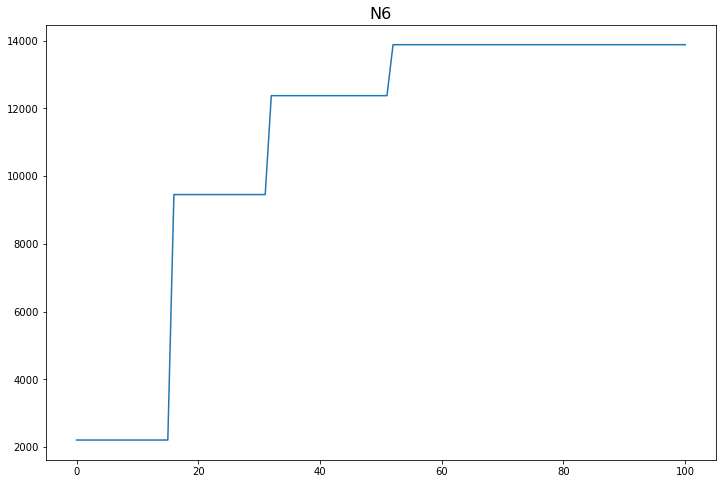

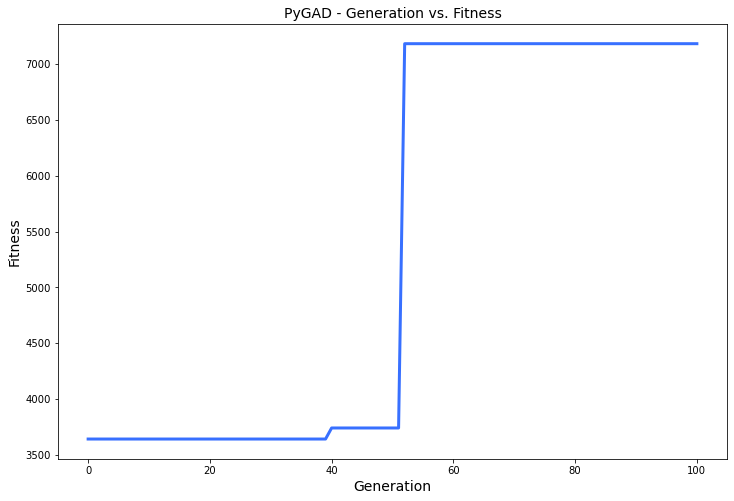

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.019 |==================| 7.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 26.889 |==================| 385.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 26.589 |==================| 3.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |==================| 5.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.858 |==================| 36.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.083 |==================| 5.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.755 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 24.538 |==================| 3.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 24.764 |==================| 11.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 25.002 |==================| 6.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 24.806 |==================| 21.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.12 |==================| 3.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.948 |==================| 10.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 24.517 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 24.764 |==================| 11.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 25.002 |==================| 6.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 24.806 |==================| 21.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.12 |==================| 3.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.948 |==================| 10.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 24.517 |==================| 2.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 25.035 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.12 |==================| 3.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.948 |==================| 10.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 24.517 |==================| 2.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 25.035 |==================| 5.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 25.001 |==================| 6.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 25.07 |==================| 4.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.667 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.959 |==================| 9.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.506 |===========| 24.215 |==================| 1.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 25.005 |==================| 6.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.933 |==================| 12.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.961 |==================| 9.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 25.153 |==================| 3.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.81 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.933 |==================| 12.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.961 |==================| 9.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 25.153 |==================| 3.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.81 |==================| 23.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 24.766 |==================| 11.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 25.134 |==================| 3.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 24.343 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 24.522 |==================| 3.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 25.105 |==================| 3.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 24.479 |==================| 2.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 25.08 |==================| 4.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.035 |==================| 5.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 25.072 |==================| 4.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 24.274 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 25.105 |==================| 3.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 24.479 |==================| 2.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 25.08 |==================| 4.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.035 |==================| 5.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 25.072 |==================| 4.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 24.274 |==================| 1.727 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 25.093 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 24.479 |==================| 2.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 25.08 |==================| 4.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.035 |==================| 5.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 25.072 |==================| 4.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 24.274 |==================| 1.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.821 |==================| 30.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 24.422 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 25.028 |==================| 5.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 24.323 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 24.242 |==================| 1.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 25.108 |==================| 3.923 |==========
Fitness = 158.25040129711914
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.821 |==================| 30.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 24.422 |==================| 2.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 24.323 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 24.242 |==================| 1.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 25.108 |==================| 3.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.821 |==================| 30.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 24.422 |==================| 2.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 25.023 |==================| 5.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 24.438 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.115 |==================| 3.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 24.481 |==================| 2.686 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 24.758 |==================| 10.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 24.329 |==================| 1.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.64 |==================| 4.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.684 |==================| 5.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.64 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 24.481 |==================| 2.686 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 24.758 |==================| 10.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 24.329 |==================| 1.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.64 |==================| 4.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.684 |==================| 5.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.64 |==================| 4.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 24.474 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 25.053 |==================| 5.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.804 |==================| 20.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 25.005 |==================| 6.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.907 |==================| 18.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.961 |==================| 9.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.115 |==================| 3.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 24.278 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.907 |==================| 18.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.961 |==================| 9.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.115 |==================| 3.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 24.278 |==================| 1.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.781 |==================| 13.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 25.083 |==================| 4.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.86 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 24.278 |==================| 1.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.781 |==================| 13.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 25.083 |==================| 4.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.86 |==================| 160.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.876 |==================| 43.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.706 |==================| 6.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.877 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 24.267 |==================| 1.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.992 |==================| 7.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.042 |==================| 5.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 24.465 |==================| 2.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 24.338 |==================| 1.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 24.23 |==================| 1.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 24.565 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.992 |==================| 7.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.042 |==================| 5.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 24.465 |==================| 2.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 24.338 |==================| 1.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 24.23 |==================| 1.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 24.565 |==================| 3.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.787 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.605 |==================| 4.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.91 |==================| 17.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.443 |==================| 2.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.998 |==================| 6.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 25.081 |==================| 4.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 24.513 |==================| 2.942 |==========
Generation = 8
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 25.027 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.998 |==================| 6.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 25.081 |==================| 4.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 24.513 |==================| 2.942 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 25.027 |==================| 5.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.99 |==================| 7.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 24.326 |==================| 1.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.997 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 25.044 |==================| 5.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 24.526 |==================| 3.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.99 |==================| 7.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.798 |==================| 18.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 24.308 |==================| 1.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 25.11 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 24.526 |==================| 3.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.99 |==================| 7.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.798 |==================| 18.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 24.308 |==================| 1.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 25.11 |==================| 3.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 25.131 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.99 |==================| 7.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.798 |==================| 18.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 24.308 |==================| 1.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 25.11 |==================| 3.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 25.131 |==================| 3.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.87 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 25.093 |==================| 4.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.925 |==================| 13.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.654 |==================| 5.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 24.775 |==================| 12.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 25.013 |==================| 6.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.983 |==================| 7.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.823 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.925 |==================| 13.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.654 |==================| 5.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 24.775 |==================| 12.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 25.013 |==================| 6.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.983 |==================| 7.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.823 |==================| 33.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 24.865 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.989 |==================| 7.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.711 |==================| 7.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 24.241 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.947 |==================| 10.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.988 |==================| 7.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 24.399 |==================| 2.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 24.535 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.711 |==================| 7.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 24.241 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.947 |==================| 10.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.988 |==================| 7.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 24.399 |==================| 2.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 24.535 |==================| 3.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 25.139 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 24.241 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.947 |==================| 10.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.988 |==================| 7.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 24.399 |==================| 2.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 24.535 |==================| 3.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 25.139 |==================| 3.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 25.033 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 25.125 |==================| 3.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 25.133 |==================| 3.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.449 |==================| 2.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.672 |==================| 5.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 24.48 |==================| 2.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 24.71 |==================| 6.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 24.568 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 25.133 |==================| 3.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.449 |==================| 2.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.672 |==================| 5.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 24.48 |==================| 2.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 24.71 |==================| 6.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 24.568 |==================| 3.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 25.028 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 25.06 |==================| 4.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.974 |==================| 8.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 25.028 |==================| 5.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.663 |==================| 5.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.955 |==================| 9.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.978 |==================| 8.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.403 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.663 |==================| 5.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.955 |==================| 9.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.978 |==================| 8.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.403 |==================| 2.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 25.115 |==================| 3.829 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 25.099 |==================| 4.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 24.442 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.955 |==================| 9.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.978 |==================| 8.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.403 |==================| 2.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 25.115 |==================| 3.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 25.106 |==================| 3.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 25.043 |==================| 5.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 24.353 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 25.018 |==================| 6.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 25.051 |==================| 5.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 25.142 |==================| 3.471 |==========
Fitness = 920.7971406162441
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 25.106 |==================| 3.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 25.043 |==================| 5.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 24.353 |==================| 1.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 25.051 |==================| 5.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 25.142 |==================| 3.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 25.106 |==================| 3.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 25.043 |==================| 5.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 24.353 |==================| 1.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 24.541 |==================| 3.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.878 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 24.235 |==================| 1.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.957 |==================| 9.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.793 |==================| 16.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 24.438 |==================| 2.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.923 |==================| 14.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.536 |==================| 3.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.108 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.793 |==================| 16.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 24.438 |==================| 2.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.923 |==================| 14.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.536 |==================| 3.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.108 |==================| 3.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 24.756 |==================| 10.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 25.097 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.706 |==================| 6.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.65 |==================| 4.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.805 |==================| 20.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.701 |==================| 6.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.871 |==================| 58.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 24.299 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.835 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.701 |==================| 6.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.871 |==================| 58.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 24.299 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.835 |==================| 55.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 25.016 |==================| 6.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 25.079 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.865 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.871 |==================| 58.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 24.299 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.835 |==================| 55.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 25.016 |==================| 6.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 25.079 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.865 |==================| 84.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.979 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 24.693 |==================| 6.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.826 |==================| 36.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 24.366 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.239 |==================| 1.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.903 |==================| 20.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.907 |==================| 18.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.129 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 24.366 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.239 |==================| 1.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.903 |==================| 20.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.907 |==================| 18.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.129 |==================| 3.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 24.339 |==================| 1.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 24.49 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 24.519 |==================| 2.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 24.481 |==================| 2.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.755 |==================| 10.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.266 |==================| 1.702 |==========
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 24.412 |==================| 2.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 24.528 |==================| 3.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.624 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 24.481 |==================| 2.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.755 |==================| 10.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.266 |==================| 1.702 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 24.412 |==================| 2.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 24.528 |==================| 3.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.624 |==================| 4.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.938 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.755 |==================| 10.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.266 |==================| 1.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.893 |==================| 24.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.801 |==================| 19.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 24.223 |==================| 1.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 24.254 |==================| 1.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.77 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.808 |==================| 22.204 |==========
Fitness = 1436.6057339368504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.893 |==================| 24.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.801 |==================| 19.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 24.223 |==================| 1.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 24.254 |==================| 1.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.77 |==================| 11.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.893 |==================| 24.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.801 |==================| 19.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 24.223 |==================| 1.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 24.254 |==================| 1.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.77 |==================| 11.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.979 |==================| 7.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.911 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 24.782 |==================| 14.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.747 |==================| 9.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 24.421 |==================| 2.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.668 |==================| 5.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 24.759 |==================| 10.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 24.592 |==================| 3.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 24.421 |==================| 2.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.668 |==================| 5.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 24.759 |==================| 10.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 24.592 |==================| 3.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.672 |==================| 5.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.833 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.776 |==================| 12.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 24.817 |==================| 27.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 25.018 |==================| 6.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 24.622 |==================| 4.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.266 |==================| 1.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 25.135 |==================| 3.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.81 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 24.622 |==================| 4.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.266 |==================| 1.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 25.135 |==================| 3.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.81 |==================| 22.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.55 |==================| 3.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 24.383 |==================| 2.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 24.324 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 25.135 |==================| 3.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.81 |==================| 22.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.55 |==================| 3.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 24.383 |==================| 2.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 24.324 |==================| 1.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.939 |==================| 11.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.7 |==================| 6

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 24.531 |==================| 3.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.654 |==================| 5.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 24.352 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.547 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 24.349 |==================| 1.983 |==========
Fitness = 1436.6057339368504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 24.399 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 24.352 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.547 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 24.349 |==================| 1.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 24.399 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 24.38 |==================| 2.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.146 |==================| 3.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 24.554 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 25.127 |==================| 3.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.898 |==================| 22.5 |==========
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 24.589 |==================| 3.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 24.331 |==================| 1.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.915 |==================| 16.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 24.493 |==================| 2.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.947 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 24.331 |==================| 1.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.915 |==================| 16.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 24.493 |==================| 2.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.947 |==================| 10.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 25.07 |==================| 4.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 24.725 |==================| 7.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.151 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 25.004 |==================| 6.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 24.936 |==================| 12.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 25.099 |==================| 4.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 24.833 |==================| 49.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 25.01 |==================| 6.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.706 |==================| 6.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.711 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 25.01 |==================| 6.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.706 |==================| 6.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.711 |==================| 7.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.766 |==================| 11.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 24.262 |==================| 1.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 25.121 |==================| 3.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.84 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.706 |==================| 6.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.711 |==================| 7.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.766 |==================| 11.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 24.262 |==================| 1.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 25.121 |==================| 3.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.84 |==================| 73.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 25.006 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 24.307 |==================| 1.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.815 |==================| 25.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.984 |==================| 7.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 24.378 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 24.807 |==================| 21.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 25.068 |==================| 4.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 25.144 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.984 |==================| 7.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 24.378 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 24.807 |==================| 21.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 25.068 |==================| 4.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 25.144 |==================| 3.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 25.152 |==================| 3.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 24.442 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 24.437 |==================| 2.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.934 |==================| 12.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 25.017 |==================| 6.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.826 |==================| 36.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 24.849 |==================| 209.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.909 |==================| 17.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.897 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.826 |==================| 36.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 24.849 |==================| 209.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.909 |==================| 17.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.897 |==================| 23.137 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.906 |==================| 19.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 24.448 |==================| 2.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.404 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.897 |==================| 23.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.951 |==================| 10.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 24.416 |==================| 2.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 24.539 |==================| 3.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.86 |==================| 156.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 24.311 |==================| 1.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.96 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.951 |==================| 10.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 24.416 |==================| 2.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 24.539 |==================| 3.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.86 |==================| 156.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 24.311 |==================| 1.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.96 |==================| 9.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 24.417 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 24.539 |==================| 3.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.86 |==================| 156.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 24.311 |==================| 1.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.96 |==================| 9.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 24.417 |==================| 2.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 25.099 |==================| 4.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 24.595 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.703 |==================| 6.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.913 |==================| 16.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.828 |==================| 39.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.653 |==================| 4.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 25.024 |==================| 5.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.685 |==================| 5.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 24.56 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.828 |==================| 39.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.653 |==================| 4.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 25.024 |==================| 5.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.685 |==================| 5.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 24.56 |==================| 3.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.98 |==================| 7.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 24.302 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.658 |==================| 5.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 24.689 |==================| 6.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 25.154 |==================| 3.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 24.415 |==================| 2.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.871 |==================| 55.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.59 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 25.154 |==================| 3.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 24.415 |==================| 2.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.871 |==================| 55.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.59 |==================| 3.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.797 |==================| 17.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 25.134 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.871 |==================| 55.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.59 |==================| 3.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.797 |==================| 17.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 25.134 |==================| 3.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.985 |==================| 7.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 25.137 |==================| 3.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 24.493 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.658 |==================| 5.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 25.15 |==================| 3.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 24.363 |==================| 2.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.853 |==================| 1419.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 25.085 |==================| 4.319 |==========
Fitness = 1436.6057339368504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 24.493 |==================| 2.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 25.15 |==================| 3.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 24.363 |==================| 2.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.853 |==================| 1419.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 25.085 |==================| 4.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 24.493 |==================| 2.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 24.372 |==================| 2.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 24.43 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.816 |==================| 26.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.89 |==================| 27.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 24.736 |==================| 8.504 |==========
Generation = 31
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 25.077 |==================| 4.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.562 |==================| 3.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.999 |==================| 6.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 25.003 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.89 |==================| 27.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 24.736 |==================| 8.504 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 25.077 |==================| 4.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.562 |==================| 3.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.999 |==================| 6.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 25.003 |==================| 6.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.896 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 24.22 |==================| 1.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 25.077 |==================| 4.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.856 |==================| 457.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.866 |==================| 79.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 24.322 |==================| 1.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 24.376 |==================| 2.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.913 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.866 |==================| 79.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 24.322 |==================| 1.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 24.376 |==================| 2.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.913 |==================| 16.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 24.708 |==================| 6.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 25.116 |==================| 3.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 25.047 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 24.322 |==================| 1.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 24.376 |==================| 2.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.913 |==================| 16.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 24.708 |==================| 6.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 25.116 |==================| 3.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 25.047 |==================| 5.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.9 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.585 |==================| 3.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 24.538 |==================| 3.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.749 |==================| 9.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.618 |==================| 4.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 24.359 |==================| 2.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 25.009 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.618 |==================| 4.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 24.359 |==================| 2.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 25.009 |==================| 6.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.898 |==================| 22.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.904 |==================| 19.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.637 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 24.402 |==================| 2.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.878 |==================| 40.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 25.075 |==================| 4.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 24.427 |==================| 2.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 24.614 |==================| 4.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 25.09 |==================| 4.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 25.052 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 25.075 |==================| 4.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 24.427 |==================| 2.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 24.614 |==================| 4.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 25.09 |==================| 4.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 25.052 |==================| 5.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.143 |==================| 3.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 25.131 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 25.09 |==================| 4.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 25.052 |==================| 5.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.143 |==================| 3.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 25.131 |==================| 3.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.132 |==================| 3.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.885 |==================| 31.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.599 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.112 |==================| 3.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 25.056 |==================| 4.944 |==========
Fitness = 1436.6057339368504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.132 |==================| 3.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.885 |==================| 31.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.599 |==================| 3.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.622 |==================| 4.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 25.056 |==================| 4.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.132 |==================| 3.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.885 |==================| 31.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.599 |==================| 3.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.622 |==================| 4.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 24.518 |==================| 2.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.452 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 24.8 |==================| 18.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 25.082 |==================| 4.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 25.105 |==================| 3.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.964 |==================| 9.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 25.065 |==================| 4.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.985 |==================| 7.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.97 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.964 |==================| 9.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 25.065 |==================| 4.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.985 |==================| 7.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.97 |==================| 8.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 25.014 |==================| 6.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 24.274 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.968 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 25.051 |==================| 5.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.866 |==================| 76.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 25.041 |==================| 5.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.859 |==================| 176.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 24.308 |==================| 1.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 25.024 |==================| 5.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 24.355 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.859 |==================| 176.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 24.308 |==================| 1.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 25.024 |==================| 5.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 24.355 |==================| 2.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 25.008 |==================| 6.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 24.85 |==================| 326.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 24.248 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 24.308 |==================| 1.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 25.024 |==================| 5.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 24.355 |==================| 2.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 25.008 |==================| 6.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 24.85 |==================| 326.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 24.248 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 24.543 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 24.326 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.939 |==================| 11.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.824 |==================| 34.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.777 |==================| 13.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 24.316 |==================| 1.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 24.726 |==================| 7.833 |==========
Fitness = 1436.6057339368504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.939 |==================| 11.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.824 |==================| 34.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.777 |==================| 13.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 24.316 |==================| 1.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 24.726 |==================| 7.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.854 |==================| 1325.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 25.018 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 25.101 |==================| 4.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.986 |==================| 7.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 24.681 |==================| 5.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 24.601 |==================| 3.964 |==========
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.019 |==================| 6.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 24.499 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 24.681 |==================| 5.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 24.601 |==================| 3.964 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.019 |==================| 6.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 24.499 |==================| 2.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.688 |==================| 6.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 25.116 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 25.075 |==================| 4.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 24.517 |==================| 2.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 24.339 |==================| 1.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.85 |==================| 261.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 25.059 |==================| 4.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 24.297 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 25.056 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 24.517 |==================| 2.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 24.339 |==================| 1.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.85 |==================| 261.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 25.059 |==================| 4.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 24.297 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 25.056 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.781 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 24.339 |==================| 1.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.85 |==================| 261.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 25.059 |==================| 4.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 24.297 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 25.056 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.781 |==================| 13.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.778 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 24.274 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 24.477 |==================| 2.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 25.026 |==================| 5.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 25.092 |==================| 4.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 24.733 |==================| 8.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 24.484 |==================| 2.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.121 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 24.477 |==================| 2.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 25.026 |==================| 5.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 25.092 |==================| 4.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 24.733 |==================| 8.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 24.484 |==================| 2.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.121 |==================| 3.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.035 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.653 |==================| 4.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.994 |==================| 7.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.108 |==================| 3.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 24.406 |==================| 2.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 25.012 |==================| 6.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.546 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 25.113 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.108 |==================| 3.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 24.406 |==================| 2.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 25.012 |==================| 6.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.546 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 25.113 |==================| 3.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.708 |==================| 6.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 25.102 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.546 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 25.113 |==================| 3.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.708 |==================| 6.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 25.102 |==================| 4.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 24.425 |==================| 2.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 25.061 |==================| 4.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.911 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 24.597 |==================| 3.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 24.477 |==================| 2.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 25.006 |==================| 6.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 24.316 |==================| 1.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 24.759 |==================| 10.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.834 |==================| 52.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.869 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 24.477 |==================| 2.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 25.006 |==================| 6.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 24.316 |==================| 1.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 24.759 |==================| 10.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.834 |==================| 52.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.869 |==================| 64.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.975 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 25.089 |==================| 4.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 25.09 |==================| 4.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 24.433 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.844 |==================| 110.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 24.519 |==================| 2.987 |==========
Generation = 44
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 24.326 |==================| 1.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 24.354 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 25.09 |==================| 4.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 24.433 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.844 |==================| 110.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 24.519 |==================| 2.987 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 24.326 |==================| 1.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 24.354 |==================| 2.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.023 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 24.433 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.844 |==================| 110.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 24.519 |==================| 2.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.667 |==================| 5.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 24.406 |==================| 2.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 24.673 |==================| 5.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 24.52 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.862 |==================| 114.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 24.538 |==================| 3.175 |==========
Fitness = 1436.6057339368504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.667 |==================| 5.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 24.406 |==================| 2.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 24.673 |==================| 5.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 24.52 |==================| 3.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 24.538 |==================| 3.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.667 |==================| 5.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 24.406 |==================| 2.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 24.673 |==================| 5.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 24.52 |==================| 3.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 24.548 |==================| 3.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.857 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.706 |==================| 6.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 25.06 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 25.128 |==================| 3.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 24.368 |==================| 2.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.787 |==================| 15.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 24.305 |==================| 1.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 24.285 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 25.06 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 25.128 |==================| 3.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 24.368 |==================| 2.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.787 |==================| 15.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 24.305 |==================| 1.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 24.285 |==================| 1.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 25.039 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.123 |==================| 3.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 25.063 |==================| 4.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.813 |==================| 25.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 24.484 |==================| 2.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 24.514 |==================| 2.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.146 |==================| 3.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 24.742 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 25.063 |==================| 4.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.813 |==================| 25.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 24.484 |==================| 2.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 24.514 |==================| 2.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.146 |==================| 3.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 24.742 |==================| 9.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 24.326 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.813 |==================| 25.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 24.484 |==================| 2.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 24.514 |==================| 2.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.146 |==================| 3.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 24.742 |==================| 9.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 24.326 |==================| 1.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 24.707 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 24.524 |==================| 3.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.018 |==================| 6.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.934 |==================| 12.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.959 |==================| 9.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.981 |==================| 7.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 24.713 |==================| 7.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 24.722 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.018 |==================| 6.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.934 |==================| 12.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.959 |==================| 9.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.981 |==================| 7.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 24.713 |==================| 7.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 24.722 |==================| 7.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.92 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 25.006 |==================| 6.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 24.54 |==================| 3.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 24.361 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 24.486 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 24.483 |==================| 2.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 24.699 |==================| 6.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.881 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 24.54 |==================| 3.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 24.361 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 24.486 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 24.483 |==================| 2.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 24.699 |==================| 6.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.881 |==================| 36.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 25.071 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 24.486 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 24.483 |==================| 2.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 24.699 |==================| 6.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.881 |==================| 36.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 25.071 |==================| 4.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.158 |==================| 3.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 25.134 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 24.229 |==================| 1.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.915 |==================| 16.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 24.37 |==================| 2.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 24.367 |==================| 2.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.123 |==================| 3.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.452 |==================| 2.49 |==========
Fitness = 1436.6057339368504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.915 |==================| 16.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 24.37 |==================| 2.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 24.367 |==================| 2.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.123 |==================| 3.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.452 |==================| 2.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 24.744 |==================| 9.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 25.049 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.856 |==================| 463.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.864 |==================| 98.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.928 |==================| 13.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 25.087 |==================| 4.273 |==========
Generation = 51
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.77 |==================| 11.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.95 |==================| 10.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 25.0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.864 |==================| 98.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.928 |==================| 13.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 25.087 |==================| 4.273 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.77 |==================| 11.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.95 |==================| 10.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 25.085 |==================| 4.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 24.428 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.928 |==================| 13.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 25.087 |==================| 4.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 24.498 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 25.072 |==================| 4.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 24.369 |==================| 2.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 24.463 |==================| 2.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 25.112 |==================| 3.862 |==========
Fitness = 1714.0888189005739
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 24.498 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 25.072 |==================| 4.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 24.369 |==================| 2.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 24.463 |==================| 2.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |==================| 80.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 24.498 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 25.072 |==================| 4.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 24.369 |==================| 2.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 24.463 |==================| 2.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |==================| 80.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 24.387 |==================| 2.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 25.079 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.782 |==================| 13.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 24.288 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 24.418 |==================| 2.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 24.437 |==================| 2.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 24.675 |==================| 5.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 24.433 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 24.37 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 24.288 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 24.418 |==================| 2.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 24.437 |==================| 2.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 24.675 |==================| 5.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 24.433 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 24.37 |==================| 2.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 24.321 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.968 |==================| 8.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.952 |==================| 10.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 24.282 |==================| 1.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.965 |==================| 8.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 24.68 |==================| 5.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.993 |==================| 7.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 24.34 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.952 |==================| 10.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 24.282 |==================| 1.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.965 |==================| 8.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 24.68 |==================| 5.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.993 |==================| 7.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 24.34 |==================| 1.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 24.804 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 24.282 |==================| 1.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.965 |==================| 8.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 24.68 |==================| 5.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.993 |==================| 7.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 24.34 |==================| 1.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 24.804 |==================| 20.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.561 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 24.327 |==================| 1.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.717 |==================| 7.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 24.233 |==================| 1.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.9 |==================| 21.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.686 |==================| 5.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 25.05 |==================| 5.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 25.045 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.717 |==================| 7.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 24.233 |==================| 1.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.9 |==================| 21.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.686 |==================| 5.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 25.05 |==================| 5.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 25.045 |==================| 5.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 25.028 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 25.052 |==================| 5.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 24.436 |==================| 2.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 25.085 |==================| 4.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 24.262 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.127 |==================| 3.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.959 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 24.436 |==================| 2.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 25.085 |==================| 4.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 24.262 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.127 |==================| 3.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.959 |==================| 9.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.992 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 24.262 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.127 |==================| 3.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.959 |==================| 9.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.992 |==================| 7.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 25.046 |==================| 5.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.143 |==================| 3.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.883 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 25.051 |==================| 5.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.724 |==================| 7.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 25.104 |==================| 3.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.735 |==================| 8.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 24.544 |==================| 3.23 |==========
Fitness = 1714.0888189005739
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.75 |==================| 9.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.724 |==================| 7.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 25.104 |==================| 3.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.735 |==================| 8.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 24.544 |==================| 3.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.75 |==================| 9.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 24.365 |==================| 2.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 24.589 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 24.792 |==================| 16.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 24.384 |==================| 2.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 24.607 |==================| 4.05 |==========
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.858 |==================| 237.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 25.062 |==================| 4.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.066 |==================| 4.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 25.099 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 24.384 |==================| 2.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 24.607 |==================| 4.05 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.858 |==================| 237.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 25.062 |==================| 4.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.066 |==================| 4.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 25.099 |==================| 4.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.968 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 24.607 |==================| 4.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.918 |==================| 15.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.123 |==================| 3.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.401 |==================| 2.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.146 |==================| 3.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 24.379 |==================| 2.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.016 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.918 |==================| 15.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.123 |==================| 3.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.401 |==================| 2.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.146 |==================| 3.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 24.379 |==================| 2.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.016 |==================| 6.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.869 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.123 |==================| 3.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.401 |==================| 2.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.146 |==================| 3.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 24.379 |==================| 2.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.016 |==================| 6.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.869 |==================| 66.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 24.529 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 24.38 |==================| 2.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 25.153 |==================| 3.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.904 |==================| 19.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.136 |==================| 3.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.858 |==================| 238.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.13 |==================| 3.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 24.694 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.136 |==================| 3.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.858 |==================| 238.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.13 |==================| 3.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 24.694 |==================| 6.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.929 |==================| 13.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.855 |==================| 601.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.939 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 24.551 |==================| 3.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 24.417 |==================| 2.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.671 |==================| 5.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 25.007 |==================| 6.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.443 |==================| 2.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 24.514 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 24.417 |==================| 2.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.671 |==================| 5.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 25.007 |==================| 6.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.443 |==================| 2.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 24.514 |==================| 2.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.984 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 25.007 |==================| 6.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.443 |==================| 2.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 24.514 |==================| 2.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.984 |==================| 7.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.895 |==================| 24.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 24.36 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.652 |==================| 4.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.616 |==================| 4.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 24.876 |==================| 44.299 |==========
Fitness = 1714.0888189005739
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 24.36 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 25.024 |==================| 5.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.652 |==================| 4.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.616 |==================| 4.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 24.876 |==================| 44.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 24.36 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 25.024 |==================| 5.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.652 |==================| 4.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 24.268 |==================| 1.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.952 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 25.146 |==================| 3.423 |==========
Generation = 63
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.761 |==================| 10.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.27 |==================| 1.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 24.504 |==================| 2.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.74 |==================| 8.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.647 |==================| 4.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 25.091 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.761 |==================| 10.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.27 |==================| 1.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 24.504 |==================| 2.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.74 |==================| 8.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.647 |==================| 4.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 25.091 |==================| 4.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 24.492 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 25.028 |==================| 5.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.705 |==================| 6.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.157 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.907 |==================| 18.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 25.06 |==================| 4.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 24.271 |==================| 1.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 24.259 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.705 |==================| 6.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.157 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.907 |==================| 18.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 25.06 |==================| 4.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 24.271 |==================| 1.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 24.259 |==================| 1.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 24.311 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.157 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.907 |==================| 18.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 25.06 |==================| 4.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 24.271 |==================| 1.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 24.259 |==================| 1.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 24.311 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 25.137 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 25.04 |==================| 5.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 24.232 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 24.602 |==================| 3.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 24.314 |==================| 1.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.269 |==================| 1.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.71 |==================| 6.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 25.009 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 24.232 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 24.602 |==================| 3.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 24.314 |==================| 1.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.269 |==================| 1.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.71 |==================| 6.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 25.009 |==================| 6.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 25.05 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 24.411 |==================| 2.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 24.381 |==================| 2.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.985 |==================| 7.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 24.263 |==================| 1.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 24.3 |==================| 1.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.757 |==================| 10.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.881 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 24.263 |==================| 1.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 24.3 |==================| 1.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.757 |==================| 10.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.881 |==================| 36.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 24.351 |==================| 1.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 24.764 |==================| 11.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 25.002 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 24.3 |==================| 1.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.757 |==================| 10.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.881 |==================| 36.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 24.351 |==================| 1.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 24.764 |==================| 11.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 25.002 |==================| 6.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.813 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 24.348 |==================| 1.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 24.4 |==================| 2.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.571 |==================| 3.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.881 |==================| 35.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.933 |==================| 12.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.907 |==================| 18.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.949 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 24.4 |==================| 2.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.571 |==================| 3.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.881 |==================| 35.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.933 |==================| 12.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.907 |==================| 18.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.949 |==================| 10.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.903 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 25.093 |==================| 4.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 24.517 |==================| 2.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 24.772 |==================| 12.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 24.512 |==================| 2.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.958 |==================| 9.568 |==========
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.042 |==================| 5.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.813 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 24.512 |==================| 2.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.958 |==================| 9.568 |==========
Change = 7535.497105144813
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.042 |==================| 5.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.813 |==================| 24.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 25.103 |==================| 4.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.815 |==================| 25.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 25.069 |==================| 4.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.147 |==================| 3.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 24.518 |==================| 2.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 25.102 |==================| 4.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 24.349 |==================| 1.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.766 |==================| 11.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 24.437 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 25.102 |==================| 4.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 24.349 |==================| 1.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.766 |==================| 11.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 24.437 |==================| 2.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 24.756 |==================| 10.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 24.433 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 24.349 |==================| 1.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.766 |==================| 11.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 24.437 |==================| 2.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 24.756 |==================| 10.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 24.433 |==================| 2.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 25.066 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.996 |==================| 7.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 25.099 |==================| 4.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.918 |==================| 15.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 24.478 |==================| 2.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.149 |==================| 3.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 25.143 |==================| 3.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 24.478 |==================| 2.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.149 |==================| 3.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 25.143 |==================| 3.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 24.501 |==================| 2.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 25.048 |==================| 5.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 24.496 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 24.745 |==================| 9.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 24.719 |==================| 7.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.942 |==================| 11.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.969 |==================| 8.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 24.272 |==================| 1.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 24.446 |==================| 2.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.141 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 24.719 |==================| 7.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.942 |==================| 11.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.969 |==================| 8.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 24.272 |==================| 1.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 24.446 |==================| 2.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.141 |==================| 3.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.111 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.942 |==================| 11.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.969 |==================| 8.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 24.272 |==================| 1.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 24.446 |==================| 2.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.141 |==================| 3.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.111 |==================| 3.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 24.296 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.831 |==================| 45.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 25.017 |==================| 6.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 25.028 |==================| 5.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.98 |==================| 7.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.683 |==================| 5.882 |==========
Fitness = 9249.585924045386
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 24.296 |==================| 1.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 25.017 |==================| 6.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 25.028 |==================| 5.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.98 |==================| 7.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.683 |==================| 5.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 24.296 |==================| 1.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 25.07 |==================| 4.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 24.292 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.918 |==================| 15.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.647 |==================| 4.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.711 |==================| 7.012 |==========
Generation = 73
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 24.461 |==================| 2.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 25.083 |==================| 4.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 25.137 |==================| 3.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 25.13 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.647 |==================| 4.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.711 |==================| 7.012 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 24.461 |==================| 2.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 25.083 |==================| 4.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 25.137 |==================| 3.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 25.13 |==================| 3.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.898 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.711 |==================| 7.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.906 |==================| 18.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.571 |==================| 3.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 24.363 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 24.48 |==================| 2.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 24.411 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.111 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.571 |==================| 3.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 24.363 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 24.48 |==================| 2.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 24.411 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.111 |==================| 3.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 24.725 |==================| 7.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.408 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 24.363 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 24.48 |==================| 2.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 24.411 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.111 |==================| 3.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 24.725 |==================| 7.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.408 |==================| 2.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.537 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 25.0 |==================| 6.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.881 |==================| 36.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 24.586 |==================| 3.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 24.235 |==================| 1.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.926 |==================| 13.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.983 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 24.586 |==================| 3.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 24.235 |==================| 1.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.926 |==================| 13.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.983 |==================| 7.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 24.373 |==================| 2.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.81 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 24.438 |==================| 2.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 24.875 |==================| 46.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.99 |==================| 7.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 25.082 |==================| 4.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 25.113 |==================| 3.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.737 |==================| 8.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.863 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 25.082 |==================| 4.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 25.113 |==================| 3.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.737 |==================| 8.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.863 |==================| 103.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.899 |==================| 21.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.812 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 25.113 |==================| 3.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.737 |==================| 8.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.863 |==================| 103.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.899 |==================| 21.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.812 |==================| 24.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 24.399 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.668 |==================| 5.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.997 |==================| 6.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 24.486 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.124 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 25.067 |==================| 4.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.266 |==================| 1.702 |==========
Fitness = 9249.585924045386
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 24.486 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.124 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 25.067 |==================| 4.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.266 |==================| 1.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 24.534 |==================| 3.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.971 |==================| 8.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.123 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.554 |==================| 3.34 |==========
Generation = 78
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.682 |==================| 5.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 24.378 |==================| 2.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 24.532 |==================| 3.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.877 |==================| 43.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 25.006 |==================| 6.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 24.326 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 24.378 |==================| 2.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 24.532 |==================| 3.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.877 |==================| 43.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 25.006 |==================| 6.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 24.326 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.911 |==================| 17.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 25.007 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 24.426 |==================| 2.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.88 |==================| 37.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.642 |==================| 4.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |==================| 3.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.981 |==================| 7.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.614 |==================| 4.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.105 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.88 |==================| 37.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.642 |==================| 4.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |==================| 3.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.981 |==================| 7.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.614 |==================| 4.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.105 |==================| 3.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.937 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.642 |==================| 4.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |==================| 3.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.981 |==================| 7.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.614 |==================| 4.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.105 |==================| 3.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.937 |==================| 11.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 25.022 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 24.718 |==================| 7.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.891 |==================| 26.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 25.087 |==================| 4.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 25.099 |==================| 4.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 24.31 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.885 |==================| 31.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.946 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 24.31 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.885 |==================| 31.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.946 |==================| 10.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.813 |==================| 24.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 24.76 |==================| 10.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 24.412 |==================| 2.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.157 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 24.315 |==================| 1.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 24.765 |==================| 11.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.801 |==================| 19.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 24.365 |==================| 2.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 24.493 |==================| 2.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 24.284 |==================| 1.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.002 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 24.365 |==================| 2.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 24.493 |==================| 2.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 24.284 |==================| 1.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.002 |==================| 6.713 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 24.867 |==================| 72.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 24.585 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 24.477 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 24.284 |==================| 1.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.002 |==================| 6.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.924 |==================| 14.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.854 |==================| 1290.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 24.382 |==================| 2.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 24.459 |==================| 2.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 24.502 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 24.242 |==================| 1.634 |==========
Fitness = 9249.585924045386
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.924 |==================| 14.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.854 |==================| 1290.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 24.382 |==================| 2.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 24.459 |==================| 2.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 24.502 |==================| 2.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.924 |==================| 14.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.854 |==================| 1290.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 24.382 |==================| 2.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 24.459 |==================| 2.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 24.502 |==================| 2.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 25.071 |==================| 4.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 24.386 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 25.083 |==================| 4.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 24.26 |==================| 1.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.801 |==================| 19.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 25.091 |==================| 4.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.879 |==================| 38.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 24.476 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.976 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 24.26 |==================| 1.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.801 |==================| 19.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 25.091 |==================| 4.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.879 |==================| 38.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 24.476 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.976 |==================| 8.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 24.607 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 24.743 |==================| 9.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 24.827 |==================| 37.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 24.517 |==================| 2.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 24.418 |==================| 2.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.6 |==================| 3.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 24.519 |==================| 2.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.861 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 24.827 |==================| 37.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 24.517 |==================| 2.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 24.418 |==================| 2.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.6 |==================| 3.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 24.519 |==================| 2.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.861 |==================| 140.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 25.097 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 24.517 |==================| 2.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 24.418 |==================| 2.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.6 |==================| 3.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 24.519 |==================| 2.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.861 |==================| 140.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 25.097 |==================| 4.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 25.027 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 25.039 |==================| 5.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.404 |==================| 2.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.857 |==================| 285.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.02 |==================| 5.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.239 |==================| 1.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.112 |==================| 3.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 24.337 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.404 |==================| 2.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.857 |==================| 285.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.02 |==================| 5.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.239 |==================| 1.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.112 |==================| 3.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 24.337 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.988 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.882 |==================| 35.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.846 |==================| 129.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 25.03 |==================| 5.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.536 |==================| 3.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 25.001 |==================| 6.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 25.007 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.846 |==================| 129.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 25.03 |==================| 5.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.536 |==================| 3.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 25.001 |==================| 6.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 25.007 |==================| 6.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 24.554 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 25.03 |==================| 5.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.536 |==================| 3.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 25.001 |==================| 6.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 25.007 |==================| 6.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 24.554 |==================| 3.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 24.513 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 25.042 |==================| 5.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.984 |==================| 7.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.921 |==================| 14.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 25.1 |==================| 4.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 24.574 |==================| 3.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.855 |==================| 494.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 25.047 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 25.1 |==================| 4.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 24.574 |==================| 3.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.855 |==================| 494.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 25.047 |==================| 5.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.912 |==================| 17.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.887 |==================| 29.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 25.06 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.934 |==================| 12.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 25.044 |==================| 5.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.558 |==================| 3.383 |==========
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 24.394 |==================| 2.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 25.091 |==================| 4.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.956 |==================| 9.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 24.354 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.558 |==================| 3.383 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 24.394 |==================| 2.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 25.091 |==================| 4.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.956 |==================| 9.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 24.354 |==================| 2.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.906 |==================| 19.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 24.226 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.984 |==================| 7.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 25.017 |==================| 6.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.65 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 24.543 |==================| 3.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 24.612 |==================| 4.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.87 |==================| 60.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 25.087 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 25.017 |==================| 6.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.65 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 24.543 |==================| 3.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 24.612 |==================| 4.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.87 |==================| 60.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 25.087 |==================| 4.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.948 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.65 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 24.543 |==================| 3.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 24.612 |==================| 4.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.87 |==================| 60.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 25.087 |==================| 4.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.948 |==================| 10.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 24.787 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.908 |==================| 18.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.111 |==================| 3.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 24.403 |==================| 2.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.831 |==================| 45.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 25.101 |==================| 4.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 24.698 |==================| 6.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.639 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.111 |==================| 3.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 24.403 |==================| 2.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.831 |==================| 45.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 25.101 |==================| 4.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 24.698 |==================| 6.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.639 |==================| 4.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.106 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.886 |==================| 30.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.995 |==================| 7.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 24.257 |==================| 1.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 24.421 |==================| 2.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 25.126 |==================| 3.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.121 |==================| 3.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.878 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 24.421 |==================| 2.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 25.126 |==================| 3.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.121 |==================| 3.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.878 |==================| 40.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 25.103 |==================| 4.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 24.707 |==================| 6.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.767 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 25.126 |==================| 3.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.121 |==================| 3.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.878 |==================| 40.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 25.103 |==================| 4.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 24.707 |==================| 6.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.767 |==================| 11.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.018 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 24.372 |==================| 2.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.917 |==================| 15.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.552 |==================| 3.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 25.128 |==================| 3.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 24.511 |==================| 2.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 25.07 |==================| 4.611 |==========
Fitness = 9249.585924045386
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.917 |==================| 15.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.552 |==================| 3.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 25.128 |==================| 3.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 24.511 |==================| 2.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 25.07 |==================| 4.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.953 |==================| 10.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 24.703 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.932 |==================| 12.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.853 |==================| 1491.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 24.353 |==================| 1.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 24.526 |==================| 3.058 |==========
Generation = 93
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 24.666 |==================| 5.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 24.672 |==================| 5.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.981 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.853 |==================| 1491.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 24.353 |==================| 1.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 24.526 |==================| 3.058 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 24.666 |==================| 5.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 24.672 |==================| 5.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.981 |==================| 7.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 24.327 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 24.353 |==================| 1.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 24.526 |==================| 3.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 24.555 |==================| 3.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 24.318 |==================| 1.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 25.137 |==================| 3.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.141 |==================| 3.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 24.475 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 25.135 |==================| 3.553 |==========
Fitness = 9249.585924045386
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 24.555 |==================| 3.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 24.318 |==================| 1.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 25.137 |==================| 3.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.141 |==================| 3.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 24.475 |==================| 2.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 24.555 |==================| 3.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 24.318 |==================| 1.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 25.137 |==================| 3.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.141 |==================| 3.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 24.475 |==================| 2.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 24.389 |==================| 2.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 24.744 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.935 |==================| 12.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 24.727 |==================| 7.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.97 |==================| 8.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 25.067 |==================| 4.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 24.389 |==================| 2.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.023 |==================| 5.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 24.509 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.97 |==================| 8.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 25.067 |==================| 4.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 24.389 |==================| 2.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.023 |==================| 5.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 24.509 |==================| 2.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.8 |==================| 18.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 25.104 |==================| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 25.031 |==================| 5.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.763 |==================| 11.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 25.106 |==================| 3.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 24.475 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.865 |==================| 86.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.269 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.868 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.763 |==================| 11.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 25.106 |==================| 3.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 24.475 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.865 |==================| 86.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.269 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.868 |==================| 70.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.871 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 25.106 |==================| 3.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 24.475 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.865 |==================| 86.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.269 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.868 |==================| 70.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.871 |==================| 55.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 24.244 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 24.404 |==================| 2.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.974 |==================| 8.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.924 |==================| 14.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 25.034 |==================| 5.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 24.53 |==================| 3.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 25.051 |==================| 5.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 24.664 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.924 |==================| 14.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 25.034 |==================| 5.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 24.53 |==================| 3.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 25.051 |==================| 5.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 24.664 |==================| 5.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 24.418 |==================| 2.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.793 |==================| 16.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 24.845 |==================| 116.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 24.301 |==================| 1.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 24.636 |==================| 4.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 24.862 |==================| 110.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 24.262 |==================| 1.692 |==========
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 24.4

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 24.636 |==================| 4.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 24.862 |==================| 110.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 24.262 |==================| 1.692 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 24.41 |==================| 2.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 24.508 |==================| 2.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 25.019 |==================| 6.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.987 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 24.262 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 24.421 |==================| 2.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.905 |==================| 19.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.657 |==================| 5.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.833 |==================| 48.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.768 |==================| 11.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.408 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.905 |==================| 19.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.657 |==================| 5.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.833 |==================| 48.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.768 |==================| 11.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.408 |==================| 2.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.871 |==================| 56.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 25.03 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.657 |==================| 5.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.833 |==================| 48.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.768 |==================| 11.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.408 |==================| 2.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.871 |==================| 56.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 25.03 |==================| 5.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 24.275 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.938 |==================| 11.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.742 |==================| 8.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.889 |==================| 28.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 24.601 |==================| 3.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.956 |==================| 9.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.112 |==================| 3.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.901 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.742 |==================| 8.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.889 |==================| 28.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 24.601 |==================| 3.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.956 |==================| 9.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.112 |==================| 3.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.901 |==================| 20.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 25.063 |===============

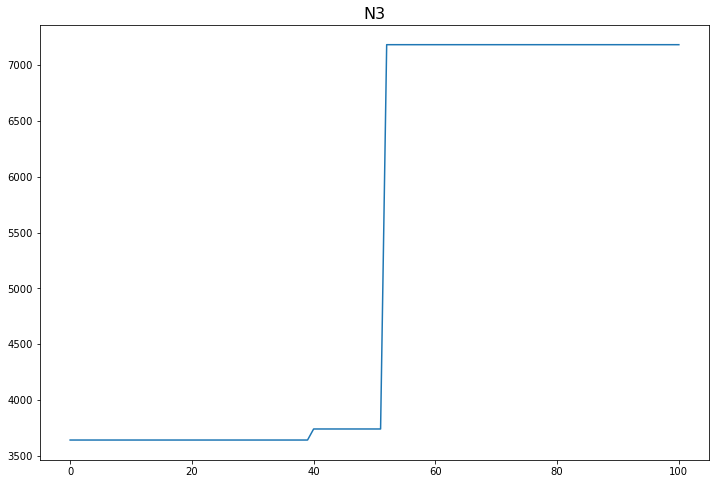

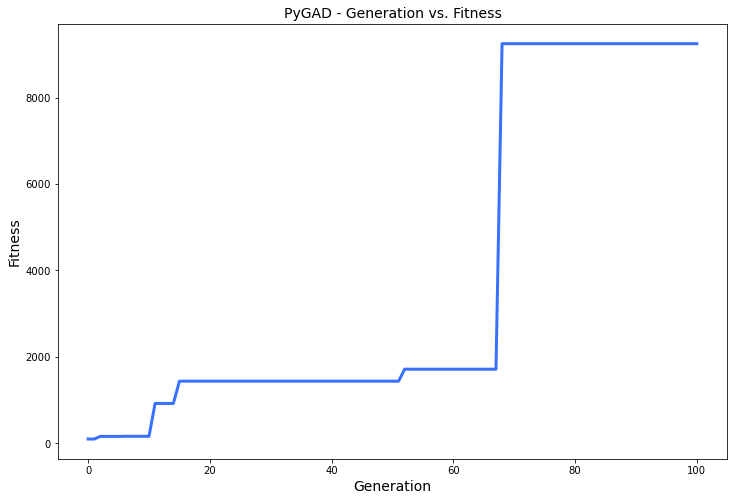

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 24.357 |==================| 2.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.02 |==================| 6.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 25.076 |==================| 4.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.938 |==================| 11.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.742 |==================| 8.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.889 |==================| 28.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 24.601 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 30.368 |==================| 1.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 29.98 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 30.085 |==================| 1.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 29.373 |==================| 13.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.231 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 29.715 |==================| 3.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.043 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 29.373 |==================| 13.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.231 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 29.715 |==================| 3.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.043 |==================| 0.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.341 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 30.23 |==================| 1.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 30.501 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 29.715 |==================| 3.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.043 |==================| 0.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.341 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 30.23 |==================| 1.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 30.501 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 30.582 |==================| 0.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 28.085 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.819 |==================| 0.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 30.296 |==================| 1.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.095 |==================| 0.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 29.841 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.597 |==================| 0.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 29.66 |==================| 4.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 30.355 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 29.841 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.597 |==================| 0.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 29.66 |==================| 4.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 30.355 |==================| 1.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 29.985 |==================| 1.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 30.153 |==================| 1.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 29.712 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 29.916 |==================| 2.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 29.897 |==================| 2.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.832 |==================| 1.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 29.481 |==================| 27.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 30.542 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 29.432 |==================| 74.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.997 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 29.897 |==================| 2.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.832 |==================| 1.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 29.481 |==================| 27.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 30.542 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 29.432 |==================| 74.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.997 |==================| 0.408 |==========
Change = 60.46254320102545
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 29.481 |==================| 27.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 30.542 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 29.432 |==================| 74.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.997 |==================| 0.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 28.911 |==================| 1.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.718 |==================| 3.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 27.824 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.93 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 29.817 |==================| 2.691 |==========
Fitness = 74.83354065675873
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 28.911 |==================| 1.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.718 |==================| 3.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 27.824 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.934 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.718 |==================| 3.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 27.824 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.934 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 27.362 |==================| 0.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 30.491 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 29.53 |==================| 11.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 30.361 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 29.692 |==================| 4.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 27.43 |==================| 0.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.942 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 29.425 |==================| 50.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 29.207 |==================| 4.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.957 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.778 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 27.43 |==================| 0.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.942 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 29.425 |==================| 50.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 29.207 |==================| 4.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.957 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.778 |==================| 1.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 27.997 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 29.331 |==================| 8.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 28.425 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.181 |==================| 0.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 30.244 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 29.507 |==================| 16.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.473 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 30.352 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 28.425 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.181 |==================| 0.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 30.244 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 29.507 |==================| 16.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.473 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 30.352 |==================| 1.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 28.039 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.181 |==================| 0.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 30.244 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 29.507 |==================| 16.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.473 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 30.352 |==================| 1.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 28.039 |==================| 0.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 29.939 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 28.554 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 29.698 |==================| 3.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 29.768 |==================| 3.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 29.325 |==================| 8.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.467 |==================| 1.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 29.531 |==================| 11.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 27.01 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 29.698 |==================| 3.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 29.768 |==================| 3.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 29.325 |==================| 8.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.467 |==================| 1.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 29.531 |==================| 11.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 27.01 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 29.445 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 27.834 |==================| 0.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 29.312 |==================| 7.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 29.625 |==================| 5.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 29.849 |==================| 2.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 29.9 |==================| 2.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.831 |==================| 1.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 29.986 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 29.312 |==================| 7.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 29.625 |==================| 5.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 29.849 |==================| 2.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 29.9 |==================| 2.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.831 |==================| 1.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 29.986 |==================| 1.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 29.295 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 29.625 |==================| 5.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 29.849 |==================| 2.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 29.9 |==================| 2.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.831 |==================| 1.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 29.986 |==================| 1.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 29.295 |==================| 6.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 28.117 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.32 |==================| 0.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 30.497 |==================| 0.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 27.34 |==================| 0.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.717 |==================| 3.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 27.321 |==================| 0.471 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 28.117 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 30.497 |==================| 0.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 27.34 |==================| 0.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.717 |==================| 3.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 27.321 |==================| 0.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 28.117 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.226 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 30.0 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 28.354 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 30.289 |==================| 1.184 |==========
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 29.205 |==================| 4.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 29.519 |==================| 13.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 27.456 |==================| 0.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 30.215 |==================| 1.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 27.564 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 29.205 |==================| 4.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 29.519 |==================| 13.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 27.456 |==================| 0.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 30.215 |==================| 1.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 27.564 |==================| 0.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 29.471 |==================| 38.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.861 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 28.105 |==================| 0.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 29.189 |==================| 3.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 29.483 |==================| 26.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 30.169 |==================| 1.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 29.894 |==================| 2.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.945 |==================| 1.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 29.015 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 29.189 |==================| 3.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 29.483 |==================| 26.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 30.169 |==================| 1.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 29.894 |==================| 2.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.945 |==================| 1.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 29.015 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 29.482 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 29.483 |==================| 26.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 30.169 |==================| 1.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 29.894 |==================| 2.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.945 |==================| 1.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 29.015 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 29.482 |==================| 27.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 30.506 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 27.081 |==================| 0.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.476 |==================| 0.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 30.46 |==================| 0.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 29.626 |==================| 5.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.847 |==================| 1.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 30.491 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.671 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.476 |==================| 0.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 30.46 |==================| 0.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 29.626 |==================| 5.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.847 |==================| 1.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 30.491 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.671 |==================| 1.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.135 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 29.901 |==================| 2.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 27.022 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 29.828 |==================| 2.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 29.879 |==================| 2.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.63 |==================| 1.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 27.131 |==================| 0.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 29.379 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 29.828 |==================| 2.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 29.879 |==================| 2.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.63 |==================| 1.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 27.131 |==================| 0.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 29.379 |==================| 15.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.94 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 30.166 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 29.879 |==================| 2.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.63 |==================| 1.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 27.131 |==================| 0.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 29.379 |==================| 15.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.94 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 30.166 |==================| 1.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 29.612 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 27.447 |==================| 0.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.731 |==================| 0.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 30.239 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 27.971 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 28.207 |==================| 0.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.537 |==================| 1.102 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.731 |==================| 0.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 30.239 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 27.971 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 28.207 |==================| 0.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.537 |==================| 1.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 29.261 |==================| 5.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.982 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 30.294 |==================| 1.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 27.315 |==================| 0.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.708 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 29.434 |==================| 91.134 |==========
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 29.421 |==================| 41.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.761 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 27.614 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 27.315 |==================| 0.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.708 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 29.434 |==================| 91.134 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 29.421 |==================| 41.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.761 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 27.614 |==================| 0.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 29.977 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.708 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 29.434 |==================| 91.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.523 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 27.725 |==================| 0.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 27.623 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 29.642 |==================| 5.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.446 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.21 |==================| 0.81 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.523 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 27.725 |==================| 0.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 27.623 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 29.642 |==================| 5.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.446 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.523 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 27.725 |==================| 0.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 27.623 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 29.642 |==================| 5.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.446 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 29.825 |==================| 2.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.892 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 27.981 |==================| 0.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 30.09 |==================| 1.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 29.279 |==================| 6.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.536 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.759 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 26.715 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 29.289 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 30.09 |==================| 1.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 29.279 |==================| 6.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.536 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.759 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 26.715 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 29.289 |==================| 6.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 27.355 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.262 |==================| 0.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 27.214 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 30.4 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 27.168 |==================| 0.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 29.42 |==================| 39.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 29.917 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 28.664 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 27.168 |==================| 0.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 29.42 |==================| 39.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 29.917 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 28.664 |==================| 1.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 29.115 |==================| 3.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 29.484 |==================| 26.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 29.397 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 28.664 |==================| 1.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 29.115 |==================| 3.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 29.484 |==================| 26.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 29.397 |==================| 20.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 29.59 |==================| 6.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 27.023 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 27.837 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 27.576 |==================| 0.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 28.656 |==================| 1.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 27.571 |==================| 0.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.618 |==================| 0.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.961 |==================| 2.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.652 |==================| 0.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.899 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 28.656 |==================| 1.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 27.571 |==================| 0.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.618 |==================| 0.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.961 |==================| 2.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.652 |==================| 0.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.899 |==================| 1.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 27.61 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 30.332 |==================| 1.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 30.56 |==================| 0.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 28.087 |==================| 0.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 29.3 |==================| 6.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 29.776 |==================| 3.024 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 30.079 |==================| 1.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 27.357 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 30.56 |==================| 0.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 28.087 |==================| 0.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 29.3 |==================| 6.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 29.776 |==================| 3.024 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 30.079 |==================| 1.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 27.357 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 30.182 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 29.3 |==================| 6.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 29.776 |==================| 3.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 29.887 |==================| 2.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 29.336 |==================| 9.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 30.035 |==================| 1.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 28.347 |==================| 0.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 27.17 |==================| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 27.891 |==================| 0.644 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 29.887 |==================| 2.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 29.336 |==================| 9.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 30.035 |==================| 1.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 28.347 |==================| 0.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 27.17 |==================| 0.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 29.336 |==================| 9.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 30.035 |==================| 1.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 28.347 |==================| 0.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 27.17 |==================| 0.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.494 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 28.977 |==================| 2.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 29.958 |==================| 1.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 30.407 |==================| 1.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 27.438 |==================| 0.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 29.665 |==================| 4.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 27.464 |==================| 0.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 28.327 |==================| 0.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.262 |==================| 0.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 29.859 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 27.464 |==================| 0.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 28.327 |==================| 0.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.262 |==================| 0.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 29.859 |==================| 2.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 30.471 |==================| 0.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.822 |==================| 0.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 27.985 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.322 |==================| 0.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 28.027 |==================| 0.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 28.072 |==================| 0.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 28.59 |==================| 1.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.139 |==================| 0.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.361 |==================| 1.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.234 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 28.072 |==================| 0.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 28.59 |==================| 1.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.139 |==================| 0.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.361 |==================| 1.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.234 |==================| 0.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.174 |==================| 1.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 28.562 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 28.59 |==================| 1.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.139 |==================| 0.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.361 |==================| 1.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.234 |==================| 0.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.174 |==================| 1.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 28.562 |==================| 1.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 29.629 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.843 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 29.069 |==================| 2.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 29.624 |==================| 5.609 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 29.629 |==================| 5.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 29.697 |==================| 3.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 26.703 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 29.624 |==================| 5.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 29.629 |==================| 5.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 29.697 |==================| 3.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 26.703 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 29.861 |==================| 2.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.696 |==================| 1.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 30.105 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 30.302 |==================| 1.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 29.884 |==================| 2.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.711 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 30.128 |==================| 1.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 28.283 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.941 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 26.664 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 29.884 |==================| 2.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.711 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 30.128 |==================| 1.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 28.283 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.941 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 26.664 |==================| 0.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.645 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 27.648 |==================| 0.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 28.411 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 27.508 |==================| 0.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 30.309 |==================| 1.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 29.29 |==================| 6.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.439 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.863 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 28.411 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 27.508 |==================| 0.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 30.309 |==================| 1.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 29.29 |==================| 6.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.439 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.863 |==================| 1.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 26.722 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 27.508 |==================| 0.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 30.309 |==================| 1.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 29.29 |==================| 6.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.439 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.863 |==================| 1.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 26.722 |==================| 0.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.882 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.695 |==================| 0.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 27.486 |==================| 0.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 29.011 |==================| 2.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 29.665 |==================| 4.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 27.798 |==================| 0.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.522 |==================| 0.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.533 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 27.486 |==================| 0.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 29.011 |==================| 2.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 29.665 |==================| 4.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 27.798 |==================| 0.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.522 |==================| 0.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.533 |==================| 1.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 30.417 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 28.511 |==================| 1.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 29.664 |==================| 4.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 30.226 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 30.054 |==================| 1.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.898 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 30.286 |==================| 1.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 30.222 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 30.226 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 30.054 |==================| 1.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.898 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 30.286 |==================| 1.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 30.222 |==================| 1.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 30.453 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 28.846 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 30.286 |==================| 1.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 30.222 |==================| 1.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 30.453 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 28.846 |==================| 1.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.526 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 26.823 |==================| 0.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 28.626 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 29.806 |==================| 2.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 30.276 |==================| 1.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 29.976 |==================| 1.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 30.394 |==================| 1.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 30.216 |==================| 1.298 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 30.083 |==================| 1.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 30.394 |==================| 1.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 30.216 |==================| 1.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 30.083 |==================| 1.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 30.113 |==================| 1.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 27.006 |==================| 0.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 29.504 |==================| 16.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 30.328 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.33 |==================| 0.897 |==========
Generation = 30
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 29.511 |==================| 15.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 30.217 |==================| 1.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.77 |==================| 0.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.527 |==================| 1.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 27.54 |==================| 0.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 29.455 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 29.511 |==================| 15.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 30.217 |==================| 1.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.77 |==================| 0.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.527 |==================| 1.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 27.54 |==================| 0.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 29.455 |==================| 103.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.463 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 30.512 |==================| 0.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 28.097 |==================| 0.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 27.064 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 29.377 |==================| 14.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 27.211 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 29.804 |==================| 2.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 30.309 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 29.377 |==================| 14.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 27.211 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 29.804 |==================| 2.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 30.309 |==================| 1.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.798 |==================| 1.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 30.243 |==================| 1.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 30.062 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 27.211 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 29.804 |==================| 2.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 30.309 |==================| 1.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.798 |==================| 1.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 30.243 |==================| 1.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 30.062 |==================| 1.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 30.42 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 30.282 |==================| 1.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 30.293 |==================| 1.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.138 |==================| 3.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 30.007 |==================| 1.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 29.829 |==================| 2.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 27.386 |==================| 0.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.996 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.138 |==================| 3.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 30.007 |==================| 1.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 29.829 |==================| 2.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 27.386 |==================| 0.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.996 |==================| 2.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 28.08 |==================| 0.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 27.64 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 29.977 |==================| 1.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.061 |==================| 0.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 30.483 |==================| 0.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 29.97 |==================| 1.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.931 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 29.618 |==================| 5.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 29.924 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 29.97 |==================| 1.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.931 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 29.618 |==================| 5.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 29.924 |==================| 2.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 30.518 |==================| 0.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 29.838 |==================| 2.548 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 28.429 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.931 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 29.618 |==================| 5.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 29.924 |==================| 2.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 30.518 |==================| 0.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 29.838 |==================| 2.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.37 |==================| 1.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 27.542 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 30.195 |==================| 1.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.566 |==================| 1.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.209 |==================| 1.309 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.37 |==================| 1.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 27.542 |==================| 0.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 28.633 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.37 |==================| 1.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 27.542 |==================| 0.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 28.633 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 30.212 |==================| 1.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 29.67 |==================| 4.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 30.159 |==================| 1.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 30.541 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 30.053 |==================| 1.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 29.866 |==================| 2.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.7 |==================| 1.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.043 |==================| 0.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 30.158 |==================| 1.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 28.299 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 27.733 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.043 |==================| 0.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 30.158 |==================| 1.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 28.299 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 27.733 |==================| 0.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 30.454 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 29.614 |==================| 5.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.923 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.745 |==================| 3.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 27.109 |==================| 0.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.162 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 29.936 |==================| 2.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 30.105 |==================| 1.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.607 |==================| 1.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 26.493 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 29.936 |==================| 2.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 30.105 |==================| 1.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.607 |==================| 1.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 26.493 |==================| 0.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 27.395 |==================| 0.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.557 |==================| 0.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 29.575 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 26.493 |==================| 0.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 27.395 |==================| 0.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.557 |==================| 0.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 29.575 |==================| 7.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 27.432 |==================| 0.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 29.91 |==================| 2.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.008 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 30.06 |==================| 1.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 30.283 |==================| 1.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 30.319 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.131 |==================| 0.761 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.008 |==================| 2.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 29.531 |==================| 11.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 30.283 |==================| 1.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 30.319 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.131 |==================| 0.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.008 |==================| 2.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 29.531 |==================| 11.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 30.351 |==================| 1.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.734 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 30.354 |==================| 1.101 |==========
Generation = 38
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 29.846 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 27.997 |==================| 0.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.175 |==================| 0.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.471 |==================| 1.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 30.132 |==================| 1.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 26.832 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 27.997 |==================| 0.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.175 |==================| 0.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.471 |==================| 1.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 30.132 |==================| 1.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 26.832 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 30.433 |==================| 1.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 27.705 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 27.644 |==================| 0.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 27.843 |==================| 0.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 30.289 |==================| 1.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.981 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 30.21 |==================| 1.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 30.372 |==================| 1.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 29.792 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 27.843 |==================| 0.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 30.289 |==================| 1.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.981 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 30.21 |==================| 1.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 30.372 |==================| 1.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 29.792 |==================| 2.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 30.302 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 30.289 |==================| 1.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.981 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 30.21 |==================| 1.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 30.372 |==================| 1.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 29.792 |==================| 2.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 30.302 |==================| 1.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 30.267 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 30.55 |==================| 0.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 30.097 |==================| 1.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 27.717 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.927 |==================| 1.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.932 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 30.211 |==================| 1.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 28.379 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 27.717 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.927 |==================| 1.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.932 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 30.211 |==================| 1.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 28.379 |==================| 0.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 29.466 |==================| 48.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 29.898 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 27.895 |==================| 0.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 29.816 |==================| 2.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.14 |==================| 0.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 30.491 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.36 |==================| 1.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.055 |==================| 1.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 29.971 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 30.491 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.36 |==================| 1.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.055 |==================| 1.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 29.971 |==================| 1.903 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 27.574 |==================| 0.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 30.126 |==================| 1.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 30.595 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 29.971 |==================| 1.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.58 |==================| 1.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 29.621 |==================| 5.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 29.033 |==================| 2.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.958 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 28.679 |==================| 1.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 27.214 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 29.033 |==================| 2.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.958 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 28.679 |==================| 1.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 27.214 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.054 |==================| 1.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 29.485 |==================| 24.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.061 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 27.214 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.054 |==================| 1.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 29.485 |==================| 24.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.061 |==================| 0.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 27.515 |==================| 0.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 29.081 |==================| 2.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.462 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 27.512 |==================| 0.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 30.347 |==================| 1.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 28.652 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 29.103 |==================| 2.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 28.031 |==================| 0.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.3 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.323 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 30.347 |==================| 1.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 28.652 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 29.103 |==================| 2.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 28.031 |==================| 0.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.3 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.323 |==================| 0.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.857 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.848 |==================| 0.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 30.331 |==================| 1.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 29.695 |==================| 4.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 27.526 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 29.733 |==================| 3.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.621 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.471 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 30.331 |==================| 1.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 29.695 |==================| 4.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 27.526 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 29.733 |==================| 3.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.621 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.471 |==================| 1.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.557 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 29.733 |==================| 3.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.621 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.471 |==================| 1.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.557 |==================| 0.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.807 |==================| 0.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 28.854 |==================| 1.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 30.582 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 28.037 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 29.733 |==================| 3.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.583 |==================| 0.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 28.854 |==================| 1.692 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 27.898 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 29.582 |==================| 7.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 28.854 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 27.898 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 29.582 |==================| 7.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 29.83 |==================| 2.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.745 |==================| 3.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 30.14 |==================| 1.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 29.502 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.384 |==================| 1.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 26.48 |==================| 0.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 27.454 |==================| 0.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 29.897 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.481 |==================| 1.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 28.022 |==================| 0.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.555 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 29.897 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.481 |==================| 1.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 28.022 |==================| 0.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.555 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.174 |==================| 1.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 29.822 |==================| 2.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.175 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 27.677 |==================| 0.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 30.505 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 30.44 |==================| 1.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.854 |==================| 0.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 29.11 |==================| 2.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.531 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 29.811 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 30.44 |==================| 1.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.854 |==================| 0.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 29.11 |==================| 2.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.531 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 29.811 |==================| 2.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.494 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 30.333 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 29.11 |==================| 2.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.531 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 29.811 |==================| 2.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.494 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 30.333 |==================| 1.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 29.753 |==================| 3.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 30.591 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 30.56 |==================| 0.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.758 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.232 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.524 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.527 |==================| 0.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 28.357 |==================| 0.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.209 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.758 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.232 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.524 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.527 |==================| 0.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 28.357 |==================| 0.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.209 |==================| 1.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 28.007 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 29.43 |==================| 65.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 30.033 |==================| 1.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 28.525 |==================| 1.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 30.124 |==================| 1.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 27.397 |==================| 0.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.596 |==================| 0.351 |==========
Generation = 49
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 27.62 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 30.033 |==================| 1.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 28.525 |==================| 1.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 30.124 |==================| 1.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 27.397 |==================| 0.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.596 |==================| 0.351 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 27.62 |==================| 0.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.672 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 27.397 |==================| 0.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.596 |==================| 0.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 30.397 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 30.287 |==================| 1.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 29.948 |==================| 1.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 27.624 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 27.266 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 30.397 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 30.287 |==================| 1.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 29.948 |==================| 1.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 27.624 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 27.266 |==================| 0.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 29.662 |==================| 4.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 29.532 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 29.948 |==================| 1.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 27.624 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 27.266 |==================| 0.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 29.662 |==================| 4.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 29.532 |==================| 11.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 29.474 |==================| 34.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 29.556 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 29.802 |==================| 2.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.055 |==================| 1.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.694 |==================| 0.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 27.297 |==================| 0.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 29.642 |==================| 5.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 30.083 |==================| 1.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 29.841 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.055 |==================| 1.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.694 |==================| 0.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 27.297 |==================| 0.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 29.642 |==================| 5.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 30.083 |==================| 1.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 29.841 |==================| 2.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.32 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.745 |==================| 0.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.945 |==================| 1.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.508 |==================| 0.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 29.287 |==================| 6.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 29.693 |==================| 4.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.349 |==================| 1.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 30.477 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 29.287 |==================| 6.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 29.693 |==================| 4.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.349 |==================| 1.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 30.477 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.94 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 29.713 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 29.292 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 29.693 |==================| 4.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.349 |==================| 1.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 30.477 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.94 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 29.713 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 29.292 |==================| 6.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 29.975 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 29.651 |==================| 4.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 26.798 |==================| 0.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 27.14 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.773 |==================| 0.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 28.056 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.752 |==================| 1.443 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 26.798 |==================| 0.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 27.14 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.773 |==================| 0.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 28.056 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.752 |==================| 1.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 27.738 |==================| 0.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 29.631 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.961 |==================| 0.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 29.856 |==================| 2.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 30.019 |==================| 1.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 30.208 |==================| 1.311 |==========
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 29.96 |==================| 1.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 29.569 |==================| 8.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 30.007 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 30.019 |==================| 1.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 30.208 |==================| 1.311 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 29.96 |==================| 1.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 29.569 |==================| 8.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 30.007 |==================| 1.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.496 |==================| 1.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 30.016 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 30.126 |==================| 1.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.416 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.626 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 29.991 |==================| 1.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.542 |==================| 1.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.69 |==================| 0.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.19 |==================| 1.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.416 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.626 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 29.991 |==================| 1.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.542 |==================| 1.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.69 |==================| 0.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.19 |==================| 1.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 29.281 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.542 |==================| 1.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.69 |==================| 0.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.19 |==================| 1.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 29.281 |==================| 6.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 29.712 |==================| 3.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 29.977 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 29.992 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 26.835 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.761 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 29.313 |==================| 7.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 29.601 |==================| 6.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 29.907 |==================| 2.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 26.902 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 30.421 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 29.313 |==================| 7.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 29.601 |==================| 6.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 29.907 |==================| 2.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 26.902 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 30.421 |==================| 1.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.662 |==================| 0.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.539 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 27.22 |==================| 0.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 29.288 |==================| 6.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.93 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.982 |==================| 2.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 29.989 |==================| 1.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 29.604 |==================| 6.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 26.739 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.982 |==================| 2.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 29.989 |==================| 1.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 29.604 |==================| 6.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 26.739 |==================| 0.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 30.196 |==================| 1.332 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 29.337 |==================| 9.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 28.708 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 29.604 |==================| 6.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 26.739 |==================| 0.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 30.196 |==================| 1.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.901 |==================| 1.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 30.002 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 27.74 |==================| 0.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 27.544 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 29.621 |==================| 5.694 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.901 |==================| 1.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 30.002 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 27.74 |==================| 0.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 27.544 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.702 |==================| 0.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 30.002 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 27.74 |==================| 0.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 27.544 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.702 |==================| 0.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 26.666 |==================| 0.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 29.716 |==================| 3.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 30.311 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 30.235 |==================| 1.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.622 |==================| 1.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 27.371 |==================| 0.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 26.928 |==================| 0.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.054 |==================| 1.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 27.913 |==================| 0.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.533 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 27.371 |==================| 0.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 26.928 |==================| 0.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.054 |==================| 1.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 27.913 |==================| 0.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.533 |==================| 0.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.471 |==================| 1.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 29.876 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 29.315 |==================| 7.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 27.699 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 30.435 |==================| 1.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.732 |==================| 3.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.694 |==================| 0.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 30.485 |==================| 0.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 29.435 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 27.699 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 30.435 |==================| 1.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.732 |==================| 3.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.694 |==================| 0.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 30.485 |==================| 0.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 29.435 |==================| 97.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 27.341 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.732 |==================| 3.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.694 |==================| 0.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 30.485 |==================| 0.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 29.435 |==================| 97.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 27.341 |==================| 0.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 27.774 |==================| 0.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.776 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 29.071 |==================| 2.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.38 |==================| 0.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 30.038 |==================| 1.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 29.336 |==================| 9.173 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 27.012 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 30.206 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.38 |==================| 0.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 30.038 |==================| 1.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 29.336 |==================| 9.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 27.012 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 30.206 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 29.327 |==================| 8.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 27.522 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 28.926 |==================| 1.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 30.585 |==================| 0.877 |==========
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 29.186 |==================| 3.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 30.057 |==================| 1.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 30.285 |==================| 1.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 29.589 |==================| 6.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 29.042 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 29.186 |==================| 3.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 30.057 |==================| 1.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 30.285 |==================| 1.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 29.589 |==================| 6.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 29.042 |==================| 2.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 27.098 |==================| 0.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 29.691 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 26.904 |==================| 0.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.335 |==================| 1.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 30.036 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 27.917 |==================| 0.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 30.33 |==================| 1.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.955 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.582 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.335 |==================| 1.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 30.036 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 27.917 |==================| 0.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 30.33 |==================| 1.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.955 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.582 |==================| 1.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.383 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 30.036 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 27.917 |==================| 0.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 30.33 |==================| 1.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.955 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.582 |==================| 1.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.383 |==================| 1.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.568 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 29.275 |==================| 5.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 30.076 |==================| 1.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.994 |==================| 2.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 29.209 |==================| 4.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 30.051 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.701 |==================| 1.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 29.78 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 30.076 |==================| 1.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.994 |==================| 2.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 29.209 |==================| 4.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 30.051 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.701 |==================| 1.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 29.78 |==================| 2.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 27.315 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 30.332 |==================| 1.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 30.096 |==================| 1.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 28.004 |==================| 0.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 29.288 |==================| 6.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 29.353 |==================| 10.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 29.624 |==================| 5.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 29.87 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 29.288 |==================| 6.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 29.353 |==================| 10.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 29.624 |==================| 5.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 29.87 |==================| 2.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 28.655 |==================| 1.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.181 |==================| 1.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.786 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 29.353 |==================| 10.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 29.624 |==================| 5.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 29.87 |==================| 2.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 28.655 |==================| 1.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.181 |==================| 1.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.786 |==================| 1.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 27.49 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 28.088 |==================| 0.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 27.393 |==================| 0.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 29.29 |==================| 6.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 30.129 |==================| 1.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.943 |==================| 0.666 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.37 |==================| 1.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 29.29 |==================| 6.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 30.129 |==================| 1.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.943 |==================| 0.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.37 |==================| 1.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 27.667 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 30.007 |==================| 1.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 30.312 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 30.52 |==================| 0.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 28.097 |==================| 0.742 |==========
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 27.711 |==================| 0.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 30.416 |==================| 1.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 30.206 |==================| 1.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.908 |==================| 1.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 29.833 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 30.416 |==================| 1.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 30.206 |==================| 1.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.908 |==================| 1.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 29.833 |==================| 2.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 30.362 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 27.022 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 29.862 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 30.068 |==================| 1.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 27.614 |==================| 0.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.93 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 29.274 |==================| 5.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 26.8 |==================| 0.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 30.268 |==================| 1.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 30.578 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 27.614 |==================| 0.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.93 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 29.274 |==================| 5.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 26.8 |==================| 0.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 30.268 |==================| 1.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 30.578 |==================| 0.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 27.456 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.93 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 29.274 |==================| 5.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 26.8 |==================| 0.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 30.268 |==================| 1.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 30.578 |==================| 0.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 27.456 |==================| 0.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 27.825 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 29.449 |==================| 256.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 29.434 |==================| 87.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 30.378 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 27.437 |==================| 0.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 29.781 |==================| 2.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 30.528 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.476 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 30.378 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 27.437 |==================| 0.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 29.781 |==================| 2.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 30.528 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.476 |==================| 1.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 27.657 |==================| 0.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 29.499 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 30.14 |==================| 1.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.942 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 30.342 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 27.284 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 28.295 |==================| 0.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 28.903 |==================| 1.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 29.217 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 27.284 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 28.295 |==================| 0.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 28.903 |==================| 1.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 29.217 |==================| 4.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 28.499 |==================| 1.057 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 28.591 |==================| 1.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.949 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 28.295 |==================| 0.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 28.903 |==================| 1.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 29.217 |==================| 4.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 28.499 |==================| 1.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.538 |==================| 1.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 30.452 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.527 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 29.585 |==================| 7.148 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.538 |==================| 1.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 30.452 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.527 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 29.824 |==================| 2.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 30.215 |==================| 1.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 30.452 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.527 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 29.824 |==================| 2.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 30.215 |==================| 1.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 28.556 |==================| 1.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.779 |==================| 1.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 28.123 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 30.421 |==================| 1.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 27.954 |==================| 0.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 29.714 |==================| 3.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 27.268 |==================| 0.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 29.927 |==================| 2.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.523 |==================| 0.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 29.596 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 27.954 |==================| 0.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 29.714 |==================| 3.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 27.268 |==================| 0.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 29.927 |==================| 2.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.523 |==================| 0.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 29.596 |==================| 6.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.933 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 28.691 |==================| 1.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.945 |==================| 1.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.697 |==================| 1.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.749 |==================| 1.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 30.452 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 30.584 |==================| 0.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 28.817 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.749 |==================| 1.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 30.452 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 30.584 |==================| 0.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 28.817 |==================| 1.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.055 |==================| 1.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 30.221 |==================| 1.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.71 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 28.817 |==================| 1.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.055 |==================| 1.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 30.221 |==================| 1.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.71 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 30.267 |==================| 1.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 29.499 |==================| 18.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 27.963 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 29.815 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 29.668 |==================| 4.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 30.29 |==================| 1.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 27.571 |==================| 0.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 30.4 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 27.933 |==================| 0.661 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 29.668 |==================| 4.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 30.29 |==================| 1.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 27.571 |==================| 0.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 30.4 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 27.933 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 29.294 |==================| 6.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.821 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 30.169 |==================| 1.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.492 |==================| 1.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 30.503 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 27.379 |==================| 0.484 |==========
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 28.023 |==================| 0.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.718 |==================| 3.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 30.4 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 27.379 |==================| 0.484 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 28.023 |==================| 0.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.718 |==================| 3.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 30.4 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 28.927 |==================| 1.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 30.407 |==================| 1.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 29.6 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 30.542 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 27.528 |==================| 0.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 29.772 |==================| 3.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.063 |==================| 1.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 29.183 |==================| 3.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 27.507 |==================| 0.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.148 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.063 |==================| 1.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 29.183 |==================| 3.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 27.507 |==================| 0.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.148 |==================| 3.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 27.381 |==================| 0.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 29.062 |==================| 2.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 29.858 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 29.183 |==================| 3.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 27.507 |==================| 0.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.148 |==================| 3.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 27.381 |==================| 0.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 29.062 |==================| 2.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 29.858 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.985 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 30.063 |==================| 1.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 27.132 |==================| 0.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 29.511 |==================| 15.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 30.446 |==================| 0.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 30.573 |==================| 0.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 30.422 |==================| 1.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 30.197 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 30.446 |==================| 0.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 30.573 |==================| 0.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 30.422 |==================| 1.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 30.197 |==================| 1.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 29.846 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 28.12 |==================| 0.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.065 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.95 |==================| 2.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 29.522 |==================| 13.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 27.537 |==================| 0.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 30.326 |==================| 1.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.35 |==================| 1.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 29.509 |==================| 15.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 30.397 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 27.537 |==================| 0.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 30.326 |==================| 1.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.35 |==================| 1.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 29.509 |==================| 15.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 30.397 |==================| 1.051 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 29.427 |==================| 54.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 27.769 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.35 |==================| 1.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 29.509 |==================| 15.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 30.397 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 29.512 |==================| 14.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 30.369 |==================| 1.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 27.35 |==================| 0.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.759 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 29.512 |==================| 14.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 30.369 |==================| 1.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 27.35 |==================| 0.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.759 |==================| 1.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.485 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 29.851 |==================| 2.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 29.704 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 27.35 |==================| 0.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.759 |==================| 1.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.485 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 29.851 |==================| 2.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 29.704 |==================| 3.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 29.733 |==================| 3.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 27.597 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.334 |==================| 1.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 27.955 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 29.796 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 27.074 |==================| 0.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 29.397 |==================| 20.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 30.461 |==================| 0.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.884 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 27.955 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 29.796 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 27.074 |==================| 0.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 29.397 |==================| 20.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 30.461 |==================| 0.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.884 |==================| 1.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 29.56 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 28.009 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 30.39 |==================| 1.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 29.171 |==================| 3.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 30.114 |==================| 1.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 30.262 |==================| 1.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 29.823 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.944 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 30.39 |==================| 1.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 29.171 |==================| 3.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 30.114 |==================| 1.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 30.262 |==================| 1.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 29.823 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.944 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 29.051 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 30.114 |==================| 1.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 30.262 |==================| 1.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 29.823 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.944 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 29.051 |==================| 2.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 30.094 |==================| 1.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.981 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 30.191 |==================| 1.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 30.54 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 30.563 |==================| 0.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 30.573 |==================| 0.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 28.69 |==================| 1.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 28.64 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 29.755 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 30.54 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 30.563 |==================| 0.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 30.573 |==================| 0.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 28.69 |==================| 1.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 28.64 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 29.755 |==================| 3.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 30.112 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 29.11 |==================| 2.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.194 |==================| 0.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 29.18 |==================| 3.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 29.744 |==================| 3.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.831 |==================| 0.383 |==========
Generation = 83
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 27.874 |==================| 0.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 29.061 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.194 |==================| 0.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 29.18 |==================| 3.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 29.744 |==================| 3.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.831 |==================| 0.383 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 27.874 |==================| 0.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 29.061 |==================| 2.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 27.102 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.831 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 30.104 |==================| 1.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 30.376 |==================| 1.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.527 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.769 |==================| 1.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.701 |==================| 1.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.862 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 30.376 |==================| 1.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.527 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.769 |==================| 1.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.701 |==================| 1.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.862 |==================| 1.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.745 |==================| 3.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.763 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.527 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.769 |==================| 1.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.701 |==================| 1.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.862 |==================| 1.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.745 |==================| 3.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.763 |==================| 1.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 30.428 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 28.841 |==================| 1.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 30.539 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 30.565 |==================| 0.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.843 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 26.781 |==================| 0.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 29.341 |==================| 9.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.646 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 30.539 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 30.565 |==================| 0.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.843 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 26.781 |==================| 0.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 29.341 |==================| 9.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.646 |==================| 0.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.135 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 27.46 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 28.037 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 27.253 |==================| 0.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.21 |==================| 1.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.672 |==================| 0.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.942 |==================| 0.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 29.774 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 27.253 |==================| 0.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.21 |==================| 1.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.672 |==================| 0.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.942 |==================| 0.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 29.774 |==================| 3.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.556 |==================| 0.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 30.315 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.942 |==================| 0.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 29.774 |==================| 3.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.556 |==================| 0.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 30.315 |==================| 1.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 29.16 |==================| 3.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.549 |==================| 1.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.065 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.36 |==================| 0.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.908 |==================| 1.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.621 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 30.368 |==================| 1.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 30.533 |==================| 0.92 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.065 |==================| 1.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.908 |==================| 1.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.621 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 30.368 |==================| 1.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 30.533 |==================| 0.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.065 |==================| 1.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 29.06 |==================| 2.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.068 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 28.107 |==================| 0.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 29.477 |==================| 31.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 30.38 |==================| 1.07 |==========
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 30.317 |==================| 1.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 30.504 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.475 |==================| 0.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.273 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 30.317 |==================| 1.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 30.504 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.475 |==================| 0.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.273 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 29.633 |==================| 5.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 30.403 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.921 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 29.88 |==================| 2.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 27.037 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 30.281 |==================| 1.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 27.753 |==================| 0.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 29.514 |==================| 14.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 30.566 |==================| 0.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 30.038 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 27.753 |==================| 0.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 29.514 |==================| 14.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 30.566 |==================| 0.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 30.038 |==================| 1.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 28.351 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 28.461 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 30.571 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 30.038 |==================| 1.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 28.351 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 28.461 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 30.571 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 30.347 |==================| 1.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 29.054 |==================| 2.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 29.311 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 29.579 |==================| 7.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 29.902 |==================| 2.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 27.748 |==================| 0.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 29.517 |==================| 13.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 27.245 |==================| 0.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 29.46 |==================| 65.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 29.026 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 27.748 |==================| 0.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 29.517 |==================| 13.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 27.245 |==================| 0.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 29.46 |==================| 65.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 29.026 |==================| 2.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 29.482 |==================| 26.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 30.414 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 30.125 |==================| 1.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 27.185 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 27.054 |==================| 0.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.337 |==================| 0.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 29.852 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.769 |==================| 1.48 |==========
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.509 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 27.185 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 27.054 |==================| 0.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.337 |==================| 0.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 29.852 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.769 |==================| 1.48 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.509 |==================| 0.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 30.455 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 29.852 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.769 |==================| 1.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 28.036 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 30.535 |==================| 0.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.612 |==================| 0.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 30.325 |==================| 1.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 27.024 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 29.694 |==================| 4.027 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 28.036 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 30.535 |==================| 0.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.612 |==================| 0.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 30.325 |==================| 1.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 27.024 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 30.535 |==================| 0.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.612 |==================| 0.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 30.325 |==================| 1.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 27.024 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.566 |==================| 0.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 29.469 |==================| 41.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 27.065 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 29.625 |==================| 5.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 30.514 |==================| 0.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 29.796 |==================| 2.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 29.031 |==================| 2.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.362 |==================| 0.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.814 |==================| 1.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.719 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 29.796 |==================| 2.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 29.031 |==================| 2.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.362 |==================| 0.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.814 |==================| 1.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.719 |==================| 3.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 29.592 |==================| 6.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 28.692 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 30.425 |==================| 1.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.668 |==================| 0.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.189 |==================| 0.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.191 |==================| 3.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 28.991 |==================| 2.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 30.415 |==================| 1.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 30.518 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.668 |==================| 0.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.189 |==================| 0.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.191 |==================| 3.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 28.991 |==================| 2.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 30.415 |==================| 1.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 30.518 |==================| 0.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 27.806 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.189 |==================| 0.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.191 |==================| 3.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 28.991 |==================| 2.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 30.415 |==================| 1.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 30.518 |==================| 0.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 27.806 |==================| 0.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.508 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 29.47 |==================| 40.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.864 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 29.465 |==================| 49.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 28.05 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.766 |==================| 0.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 27.953 |==================| 0.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 29.535 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 29.465 |==================| 49.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 28.05 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.766 |==================| 0.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 27.953 |==================| 0.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 29.535 |==================| 11.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 30.4 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 30.273 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 29.501 |==================| 17.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 27.281 |==================| 0.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.746 |==================| 3.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.555 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 29.325 |==================| 8.317 |==========
Generation = 96
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 27.702 |==================| 0.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 29.671 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.746 |==================| 3.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.555 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 29.325 |==================| 8.317 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 27.702 |==================| 0.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 29.671 |==================| 4.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 27.143 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.897 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.555 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 29.325 |==================| 8.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.746 |==================| 3.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 29.206 |==================| 4.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 29.709 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.334 |==================| 1.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.927 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 28.591 |==================| 1.171 |==========
Fitness = 2010.5302664180117
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.746 |==================| 3.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 29.206 |==================| 4.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 29.709 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.334 |==================| 1.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.927 |==================| 1.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.746 |==================| 3.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 29.206 |==================| 4.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 29.709 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.334 |==================| 1.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.927 |==================| 1.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 28.098 |==================| 0.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 27.361 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.73 |==================| 3.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 27.506 |==================| 0.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 30.438 |==================| 1.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 29.549 |==================| 9.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.529 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 29.722 |==================| 3.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 28.767 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 29.549 |==================| 9.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.529 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 29.722 |==================| 3.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 28.767 |==================| 1.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 30.092 |==================| 1.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 29.735 |==================| 3.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 30.301 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.988 |==================| 2.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 30.155 |==================| 1.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.42 |==================| 0.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 29.219 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 30.284 |==================| 1.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 29.752 |==================| 3.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 27.55 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 30.155 |==================| 1.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.42 |==================| 0.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 29.219 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 30.284 |==================| 1.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 29.752 |==================| 3.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 27.55 |==================| 0.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 29.868 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.42 |==================| 0.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 29.219 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 30.284 |==================| 1.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 29.752 |==================| 3.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 27.55 |==================| 0.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 29.868 |==================| 2.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.14 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 29.953 |==================| 1.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 29.235 |==================| 4.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 26.682 |==================| 0.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 29.236 |==================| 4.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.994 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 29.813 |==================| 2.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.916 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 29.236 |==================| 4.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.994 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 29.813 |==================| 2.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.916 |==================| 1.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 30.272 |==================| 1.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.746 |==================| 1.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 27.819 |==================

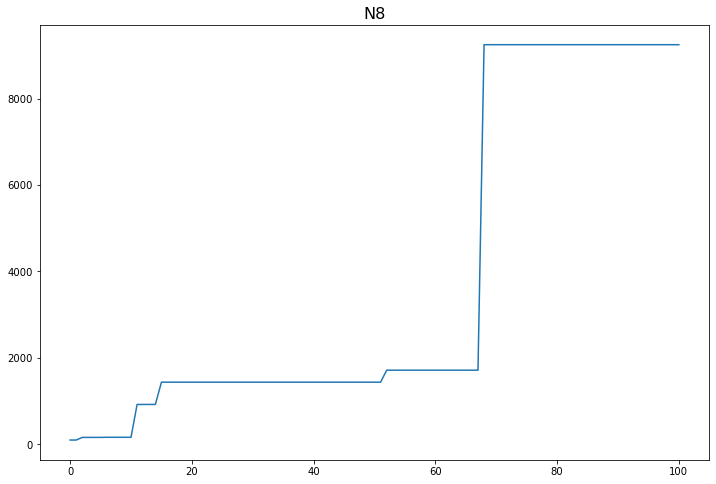

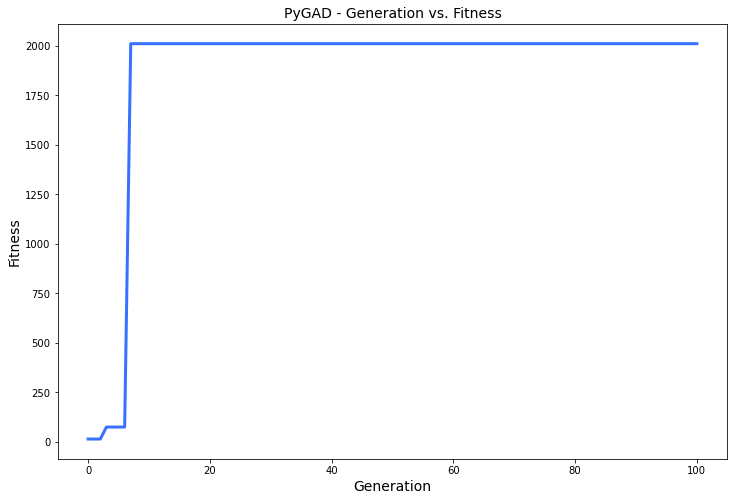

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 27.819 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 27.948 |==================| 0.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 29.281 |==================| 6.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 29.086 |==================| 2.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.043 |==================| 0.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 26.837 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.232 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 23.692 |==================| 2.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.372 |==================| 3.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.928 |==================| 7.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 24.044 |==================| 62.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.151 |==================| 11.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 23.459 |==================| 1.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.603 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.372 |==================| 3.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.928 |==================| 7.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 24.044 |==================| 62.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.151 |==================| 11.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 23.459 |==================| 1.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.603 |==================| 2.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.116 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.928 |==================| 7.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 24.044 |==================| 62.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.151 |==================| 11.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 23.459 |==================| 1.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.603 |==================| 2.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.116 |==================| 18.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 24.081 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.118 |==================| 17.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.191 |==================| 7.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 23.762 |==================| 3.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.096 |==================| 28.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 23.454 |==================| 1.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 23.462 |==================| 1.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.342 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.191 |==================| 7.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 23.762 |==================| 3.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.096 |==================| 28.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 23.454 |==================| 1.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 23.462 |==================| 1.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.342 |==================| 3.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.98 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.761 |==================| 3.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.224 |==================| 6.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.266 |==================| 4.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 23.574 |==================| 2.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.096 |==================| 27.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 23.557 |==================| 1.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.102 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.266 |==================| 4.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 23.574 |==================| 2.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.096 |==================| 27.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 23.557 |==================| 1.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.102 |==================| 24.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.134 |==================| 13.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.182 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 23.574 |==================| 2.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.096 |==================| 27.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 23.557 |==================| 1.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.102 |==================| 24.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.134 |==================| 13.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.182 |==================| 8.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.343 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.194 |==================| 7.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.242 |==================| 5.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.259 |==================| 5.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.036 |==================| 40.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 23.567 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.335 |==================| 3.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.357 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.259 |==================| 5.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.036 |==================| 40.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 23.567 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.335 |==================| 3.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.357 |==================| 3.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.038 |==================| 44.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 23.784 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.517 |===========| 23.415 |==================| 1.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 23.877 |==================| 5.446 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 23.499 |==================| 1.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 23.454 |==================| 1.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 23.434 |==================| 1.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.979 |==================| 12.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 23.877 |==================| 5.446 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 23.499 |==================| 1.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 23.454 |==================| 1.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 23.434 |==================| 1.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.979 |==================| 12.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |==================| 3.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.13 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 23.768 |==================| 3.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.257 |==================| 5.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.205 |==================| 6.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.249 |==================| 5.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.455 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.764 |==================| 3.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 23.466 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.257 |==================| 5.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.205 |==================| 6.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.249 |==================| 5.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.455 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.764 |==================| 3.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 23.466 |==================| 1.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.078 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.205 |==================| 6.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.249 |==================| 5.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.455 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.764 |==================| 3.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 23.466 |==================| 1.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.078 |==================| 58.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 23.92 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 23.682 |==================| 2.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.793 |==================| 3.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.324 |==================| 3.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.316 |==================| 3.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 23.448 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.087 |==================| 37.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.126 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.793 |==================| 3.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.324 |==================| 3.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.316 |==================| 3.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 23.448 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.087 |==================| 37.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.126 |==================| 15.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.345 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 23.446 |==================| 1.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.349 |==================| 3.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 23.545 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.132 |==================| 14.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 23.982 |==================| 12.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.21 |==================| 6.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 23.787 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.349 |==================| 3.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 23.545 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.132 |==================| 14.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 23.982 |==================| 12.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.21 |==================| 6.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 23.787 |==================| 3.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.106 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 23.545 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.132 |==================| 14.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 23.982 |==================| 12.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.21 |==================| 6.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 23.787 |==================| 3.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.106 |==================| 21.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.325 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 23.998 |==================| 15.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.032 |==================| 34.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.879 |==================| 5.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.124 |==================| 15.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.164 |==================| 9.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.834 |==================| 4.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 23.707 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.032 |==================| 34.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.879 |==================| 5.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.124 |==================| 15.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.164 |==================| 9.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.834 |==================| 4.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 23.707 |==================| 2.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.221 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.164 |==================| 9.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.781 |==================| 3.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 23.552 |==================| 1.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.129 |==================| 14.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 23.933 |==================| 7.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.336 |==================| 3.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.04 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 23.552 |==================| 1.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.129 |==================| 14.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 23.933 |==================| 7.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.336 |==================| 3.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.04 |==================| 48.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.202 |==================| 7.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.344 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.336 |==================| 3.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.04 |==================| 48.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.202 |==================| 7.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.344 |==================| 3.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 23.642 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 23.504 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.259 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.214 |==================| 6.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.751 |==================| 3.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 23.92 |==================| 7.123 |==========
Fitness = 864.3686662778002
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 23.642 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 23.504 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.259 |==================| 5.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 23.92 |==================| 7.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 23.642 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 23.504 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.259 |==================| 5.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 23.739 |==================| 3.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.143 |==================| 12.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 23.497 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.235 |==================| 5.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 23.74 |==================| 3.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.966 |==================| 10.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.282 |==================| 4.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.261 |==================| 4.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.093 |==================| 31.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.257 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.282 |==================| 4.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.261 |==================| 4.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.093 |==================| 31.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.257 |==================| 5.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 24.008 |==================| 19.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 23.772 |==================| 3.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.991 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.285 |==================| 4.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.261 |==================| 4.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.854 |==================| 4.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 23.522 |==================| 1.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.13 |==================| 14.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 23.528 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |==================| 3.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.261 |==================| 4.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.854 |==================| 4.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 23.522 |==================| 1.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.13 |==================| 14.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 23.528 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |==================| 3.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 23.44 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 23.522 |==================| 1.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.13 |==================| 14.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 23.528 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |==================| 3.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 23.44 |==================| 1.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.194 |==================| 7.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.294 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.231 |==================| 5.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.77 |==================| 3.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.087 |==================| 38.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 23.626 |==================| 2.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.161 |==================| 9.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.259 |==================| 5.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.281 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.77 |==================| 3.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.087 |==================| 38.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 23.626 |==================| 2.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.161 |==================| 9.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.259 |==================| 5.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.281 |==================| 4.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 23.561 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.364 |==================| 3.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.069 |==================| 113.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.247 |==================| 5.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==================| 8.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.981 |==================| 12.567 |==========
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 23.535 |==================| 1.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.259 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.247 |==================| 5.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==================| 8.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.981 |==================| 12.567 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 23.535 |==================| 1.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.259 |==================| 5.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.157 |==================| 10.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.123 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.981 |==================| 12.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.264 |==================| 4.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.301 |==================| 4.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.347 |==================| 3.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.038 |==================| 43.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 23.743 |==================| 3.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 23.818 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.347 |==================| 3.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.038 |==================| 43.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 23.743 |==================| 3.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 23.818 |==================| 4.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 23.933 |==================| 7.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 23.736 |==================| 3.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 23.836 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.038 |==================| 43.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 23.743 |==================| 3.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 23.818 |==================| 4.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 23.933 |==================| 7.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 23.736 |==================| 3.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 23.836 |==================| 4.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 23.48 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 23.511 |==================| 1.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.154 |==================| 10.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.27 |==================| 4.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 23.589 |==================| 2.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 23.578 |==================| 2.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 23.445 |==================| 1.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.1 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.154 |==================| 10.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.27 |==================| 4.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 23.589 |==================| 2.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 23.578 |==================| 2.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 23.445 |==================| 1.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.1 |==================| 25.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.299 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.997 |==================| 15.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 23.485 |==================| 1.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 23.534 |==================| 1.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.218 |==================| 6.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.086 |==================| 39.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.314 |==================| 3.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 23.485 |==================| 1.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 23.534 |==================| 1.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.218 |==================| 6.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.086 |==================| 39.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.314 |==================| 3.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |==================| 7.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.25 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.086 |==================| 39.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.314 |==================| 3.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |==================| 7.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.25 |==================| 5.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.097 |==================| 27.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.187 |==================| 7.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 23.785 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 23.989 |==================| 13.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.001 |==================| 16.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.038 |==================| 44.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.27 |==================| 4.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.222 |==================| 6.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.931 |==================| 7.721 |==========
Fitness = 864.3686662778002
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.27 |==================| 4.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.222 |==================| 6.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.931 |==================| 7.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 23.876 |==================| 5.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.303 |==================| 4.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.737 |==================| 3.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.234 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.795 |==================| 3.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 23.898 |==================| 6.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.031 |==================| 33.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.205 |==================| 6.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |==================| 3.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.233 |==================| 5.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.003 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.031 |==================| 33.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.205 |==================| 6.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |==================| 3.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.233 |==================| 5.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.003 |==================| 17.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 23.575 |==================| 2.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 23.587 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.195 |==================| 7.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.314 |==================| 3.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.352 |==================| 3.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 23.948 |==================| 8.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.234 |==================| 5.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 23.481 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 23.742 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 23.948 |==================| 8.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.234 |==================| 5.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 23.481 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 23.742 |==================| 3.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 23.496 |==================| 1.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.246 |==================| 5.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.355 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.234 |==================| 5.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 23.481 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 23.742 |==================| 3.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 23.496 |==================| 1.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.246 |==================| 5.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.355 |==================| 3.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.077 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.183 |==================| 8.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 23.838 |==================| 4.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.098 |==================| 26.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.683 |==================| 2.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.061 |==================| 1237.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.177 |==================| 8.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.179 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.098 |==================| 26.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.683 |==================| 2.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.061 |==================| 1237.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.177 |==================| 8.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.179 |==================| 8.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.159 |==================| 10.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 23.497 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 23.454 |==================| 1.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 23.473 |==================| 1.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.049 |==================| 83.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.275 |==================| 4.657 |==========
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.828 |==================| 4.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 23.714 |==================| 2.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.126 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 23.473 |==================| 1.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.049 |==================| 83.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.275 |==================| 4.657 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.828 |==================| 4.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 23.714 |==================| 2.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.126 |==================| 15.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.115 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.049 |==================| 83.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.275 |==================| 4.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.316 |==================| 3.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 23.627 |==================| 2.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.058 |==================| 370.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.238 |==================| 5.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.185 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 23.627 |==================| 2.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.058 |==================| 370.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.238 |==================| 5.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.185 |==================| 8.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 23.685 |==================| 2.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.079 |==================| 54.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.118 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.058 |==================| 370.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.238 |==================| 5.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.185 |==================| 8.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 23.685 |==================| 2.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.079 |==================| 54.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.118 |==================| 17.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.212 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.098 |==================| 26.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 23.491 |==================| 1.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 23.688 |==================| 2.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.337 |==================| 3.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 23.712 |==================| 2.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 23.714 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.337 |==================| 3.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 23.712 |==================| 2.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 23.714 |==================| 2.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 23.505 |==================| 1.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.359 |==================| 3.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 24.324 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.29 |==================| 4.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 23.877 |==================| 5.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.209 |==================| 6.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.188 |==================| 7.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.16 |==================| 10.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 23.558 |==================| 1.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.173 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.188 |==================| 7.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.16 |==================| 10.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 23.558 |==================| 1.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.173 |==================| 8.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.748 |==================| 3.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.23 |==================| 5.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 23.818 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.16 |==================| 10.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 23.558 |==================| 1.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.173 |==================| 8.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.748 |==================| 3.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.23 |==================| 5.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 23.818 |==================| 4.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 23.659 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.11 |==================| 20.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.768 |==================| 3.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.275 |==================| 4.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.131 |==================| 14.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 23.998 |==================| 16.003 |==========
Fitness = 1237.33316545156
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 23.659 |==================| 2.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.768 |==================| 3.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.275 |==================| 4.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.131 |==================| 14.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 23.998 |==================| 16.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 23.659 |==================| 2.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.126 |==================| 15.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 23.572 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 23.698 |==================| 2.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.315 |==================| 3.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.072 |==========
Generation = 28
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.37 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 23.725 |==================| 2.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.321 |==================| 3.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 23.538 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.315 |==================| 3.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.072 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.37 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 23.725 |==================| 2.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.321 |==================| 3.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 23.538 |==================| 1.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 23.922 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.302 |==================| 4.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 23.87 |==================| 5.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 23.726 |==================| 2.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.056 |==================| 247.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 23.57 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.252 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.302 |==================| 4.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 23.87 |==================| 5.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 23.726 |==================| 2.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.056 |==================| 247.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 23.57 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.252 |==================| 5.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.368 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 23.87 |==================| 5.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 23.726 |==================| 2.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.056 |==================| 247.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 23.57 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.252 |==================| 5.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.368 |==================| 3.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.155 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 23.813 |==================| 4.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.241 |==================| 5.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.213 |==================| 6.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 23.498 |==================| 1.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 23.863 |==================| 5.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.283 |==================| 4.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.308 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.241 |==================| 5.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.213 |==================| 6.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 23.498 |==================| 1.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 23.863 |==================| 5.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.283 |==================| 4.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.308 |==================| 4.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.313 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.34 |==================| 3.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.105 |==================| 22.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.138 |==================| 12.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.361 |==================| 3.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 23.44 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.281 |==================| 4.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.926 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.105 |==================| 22.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.138 |==================| 12.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.361 |==================| 3.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 23.44 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.281 |==================| 4.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.926 |==================| 7.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 23.738 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.138 |==================| 12.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.361 |==================| 3.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 23.44 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.281 |==================| 4.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.926 |==================| 7.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 23.738 |==================| 3.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 23.579 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.065 |==================| 201.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 23.532 |==================| 1.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.15 |==================| 11.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |==================| 7.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.149 |==================| 11.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.028 |==================| 31.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.202 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.15 |==================| 11.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |==================| 7.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.149 |==================| 11.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.028 |==================| 31.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.202 |==================| 7.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.336 |==================| 3.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.992 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.223 |==================| 6.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 23.88 |==================| 5.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.928 |==================| 7.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 23.551 |==================| 1.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 23.511 |==================| 1.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.364 |==================| 3.29 |==========
Generation = 33
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.342 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.928 |==================| 7.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 23.551 |==================| 1.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 23.511 |==================| 1.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.364 |==================| 3.29 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.342 |==================| 3.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 23.582 |==================| 2.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 23.61 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 23.511 |==================| 1.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.364 |==================| 3.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 23.501 |==================| 1.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.316 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 23.636 |==================| 2.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 23.565 |==================| 2.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.917 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.29 |==================| 4.353 |==========
Fitness = 1237.33316545156
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 23.501 |==================| 1.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.316 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 23.636 |==================| 2.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 23.565 |==================| 2.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.917 |==================| 6.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 23.501 |==================| 1.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.316 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 23.636 |==================| 2.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 23.565 |==================| 2.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.917 |==================| 6.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.368 |==================| 3.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.053 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.159 |==================| 10.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 23.884 |==================| 5.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.321 |===========| 23.54 |==================| 1.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.187 |==================| 7.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 23.62 |==================| 2.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 23.621 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.235 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.321 |===========| 23.54 |==================| 1.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.187 |==================| 7.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 23.62 |==================| 2.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 23.621 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.235 |==================| 5.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.914 |==================| 6.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 24.176 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 23.668 |==================| 2.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.078 |==================| 57.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 24.297 |==================| 4.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.35 |==================| 3.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.35 |==================| 3.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 23.896 |==================| 6.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.078 |==================| 57.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 24.297 |==================| 4.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.35 |==================| 3.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.35 |==================| 3.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 23.896 |==================| 6.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |==================| 21.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.188 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 24.297 |==================| 4.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.35 |==================| 3.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.35 |==================| 3.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 23.896 |==================| 6.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |==================| 21.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.188 |==================| 7.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 23.65 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.366 |==================| 3.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.251 |==================| 5.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.236 |==================| 5.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.797 |==================| 3.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.33 |==================| 3.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 23.57 |==================| 2.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.096 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.251 |==================| 5.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.236 |==================| 5.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.797 |==================| 3.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.33 |==================| 3.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 23.57 |==================| 2.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.096 |==================| 28.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.107 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 23.595 |==================| 2.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 23.661 |==================| 2.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.213 |==================| 6.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 23.481 |==================| 1.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.247 |==================| 5.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.107 |==================| 21.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.09 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 23.661 |==================| 2.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.213 |==================| 6.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 23.481 |==================| 1.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.247 |==================| 5.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.107 |==================| 21.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.09 |==================| 33.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 23.873 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.213 |==================| 6.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 23.481 |==================| 1.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.247 |==================| 5.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.107 |==================| 21.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.09 |==================| 33.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 23.873 |==================| 5.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.36 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.844 |==================| 4.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.02 |==================| 24.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.831 |==================| 4.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 23.919 |==================| 7.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 23.711 |==================| 2.861 |==========
Fitness = 1237.33316545156
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.36 |==================| 3.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 23.919 |==================| 7.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 23.711 |==================| 2.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.36 |==================| 3.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 23.682 |==================| 2.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.236 |==================| 5.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.335 |==================| 3.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 23.526 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.231 |==================| 5.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.226 |==================| 6.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 23.906 |==================| 6.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.342 |==================| 3.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 24.023 |==================| 26.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.748 |==================| 3.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 23.625 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.226 |==================| 6.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 23.906 |==================| 6.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.342 |==================| 3.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 24.023 |==================| 26.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.748 |==================| 3.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 23.625 |==================| 2.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 23.984 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.238 |==================| 5.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.333 |==================| 3.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.282 |==================| 4.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.833 |==================| 4.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 23.671 |==================| 2.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.973 |==================| 11.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 23.989 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.333 |==================| 3.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.282 |==================| 4.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.833 |==================| 4.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 23.671 |==================| 2.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.973 |==================| 11.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 23.989 |==================| 13.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.068 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.282 |==================| 4.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.833 |==================| 4.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 23.671 |==================| 2.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.973 |==================| 11.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 23.989 |==================| 13.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.068 |==================| 127.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.306 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.208 |==================| 6.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 23.634 |==================| 2.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.095 |==================| 28.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.828 |==================| 4.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.109 |==================| 20.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.118 |==================| 17.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 23.705 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 23.634 |==================| 2.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.095 |==================| 28.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.828 |==================| 4.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.109 |==================| 20.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.118 |==================| 17.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 23.705 |==================| 2.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 23.684 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.07 |==================| 101.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.342 |==================| 3.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.208 |==================| 6.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.332 |==================| 3.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.07 |==================| 100.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.796 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.332 |==================| 3.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.07 |==================| 100.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.796 |==================| 3.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 23.465 |==================| 1.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 23.439 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 23.846 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.796 |==================| 3.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 23.465 |==================| 1.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 23.439 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 23.846 |==================| 4.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 24.056 |==================| 215.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 23.468 |==================| 1.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.24 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 23.574 |==================| 2.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.0 |==================| 16.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.139 |==================| 12.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 23.836 |==================| 4.448 |==========
Fitness = 1237.33316545156
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.24 |==================| 5.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.871 |==================| 5.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.0 |==================| 16.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.139 |==================| 12.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 23.836 |==================| 4.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.24 |==================| 5.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.871 |==================| 5.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.019 |==================| 24.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 24.212 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.289 |==================| 4.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 24.023 |==================| 26.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.141 |==================| 12.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.18 |==================| 8.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.18 |==================| 8.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.26 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.289 |==================| 4.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 24.023 |==================| 26.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.141 |==================| 12.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.18 |==================| 8.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.18 |==================| 8.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.26 |==================| 5.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.759 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.226 |==================| 6.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.001 |==================| 16.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 23.651 |==================| 2.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.844 |==================| 4.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.811 |==================| 4.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.104 |==================| 23.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.211 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.001 |==================| 16.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 23.651 |==================| 2.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.844 |==================| 4.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.811 |==================| 4.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.104 |==================| 23.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.211 |==================| 6.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.216 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.811 |==================| 4.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.104 |==================| 23.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.211 |==================| 6.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.216 |==================| 6.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.146 |==================| 11.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 23.766 |==================| 3.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.248 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.339 |==================| 3.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 23.59 |==================| 2.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.06 |==================| 2586.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 23.681 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.781 |==================| 3.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 23.654 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.317 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 23.59 |==================| 2.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.06 |==================| 2586.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 23.681 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.781 |==================| 3.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 23.654 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.317 |==================| 3.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.312 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.123 |==================| 15.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.758 |==================| 3.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 23.959 |==================| 9.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 23.563 |==================| 2.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.277 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 23.713 |==================| 2.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 23.755 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.758 |==================| 3.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 23.959 |==================| 9.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 23.563 |==================| 2.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.277 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 23.713 |==================| 2.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 23.755 |==================| 3.275 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.964 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 23.959 |==================| 9.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 23.563 |==================| 2.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.277 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 23.713 |==================| 2.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 23.755 |==================| 3.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.083 |==================| 43.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.371 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.242 |==================| 5.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.239 |==================| 5.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.36 |==================| 3.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.759 |==================| 3.312 |==========
Fitness = 2586.2354931389655
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.083 |==================| 43.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.371 |==================| 3.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.239 |==================| 5.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.36 |==================| 3.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.759 |==================| 3.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.083 |==================| 43.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.371 |==================| 3.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.853 |==================| 4.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.359 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.137 |==================| 13.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.865 |==================| 5.123 |==========
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.365 |==================| 3.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.908 |==================| 6.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.156 |==================| 10.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.283 |==================| 4.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.1 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.865 |==================| 5.123 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.365 |==================| 3.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.908 |==================| 6.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.156 |==================| 10.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.283 |==================| 4.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.1 |==================| 25.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.16 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.256 |==================| 5.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.003 |==================| 17.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 23.494 |==================| 1.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 23.428 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |==================| 143.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.102 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 23.494 |==================| 1.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 23.428 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |==================| 143.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.102 |==================| 23.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.019 |==================| 23.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.071 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.102 |==================| 23.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.019 |==================| 23.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.071 |==================| 94.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.266 |==================| 4.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.302 |==================| 4.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.797 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 23.48 |==================| 1.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.235 |==================| 5.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.142 |==================| 12.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 23.515 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 23.716 |==================| 2.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.048 |==================| 82.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 23.815 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.235 |==================| 5.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.142 |==================| 12.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 23.515 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 23.716 |==================| 2.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.048 |==================| 82.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 23.815 |==================| 4.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 23.635 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.178 |==================| 8.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.346 |==================| 3.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 23.857 |==================| 4.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.754 |==================| 3.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.756 |==================| 3.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.349 |==================| 3.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.119 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.346 |==================| 3.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 23.857 |==================| 4.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.754 |==================| 3.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.756 |==================| 3.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.349 |==================| 3.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.119 |==================| 17.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.027 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 23.857 |==================| 4.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.754 |==================| 3.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.756 |==================| 3.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.349 |==================| 3.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.119 |==================| 17.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.027 |==================| 29.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.363 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.294 |==================| 4.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.335 |==================| 3.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.073 |==================| 77.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.317 |==================| 3.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 23.69 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.214 |==================| 6.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.097 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.335 |==================| 3.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.073 |==================| 77.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.317 |==================| 3.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 23.69 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.214 |==================| 6.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.097 |==================| 27.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.066 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.225 |==================| 6.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.258 |==================| 5.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 23.8 |==================| 3.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 23.617 |==================| 2.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.086 |==================| 39.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.927 |==================| 7.465 |==========
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.866 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.258 |==================| 5.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 23.8 |==================| 3.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 23.617 |==================| 2.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.086 |==================| 39.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.927 |==================| 7.465 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.866 |==================| 5.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.108 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 23.8 |==================| 3.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 23.617 |==================| 2.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.086 |==================| 39.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.927 |==================| 7.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.154 |==================| 10.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.641 |==================| 2.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.22 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.203 |==================| 7.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 23.522 |==================| 1.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.904 |==================| 6.4 |==========
Fitness = 2586.2354931389655
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.154 |==================| 10.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.641 |==================| 2.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.22 |==================| 6.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 23.522 |==================| 1.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.904 |==================| 6.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.154 |==================| 10.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.641 |==================| 2.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.22 |==================| 6.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.117 |==================| 17.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.301 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.066 |==================| 200.592 |==========
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 23.43 |==================| 1.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.253 |==================| 5.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 23.509 |==================| 1.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 23.894 |==================| 6.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 23.549 |==================| 1.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 23.674 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.253 |==================| 5.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 23.509 |==================| 1.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 23.894 |==================| 6.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 23.549 |==================| 1.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 23.674 |==================| 2.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.319 |==================| 3.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.315 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.773 |==================| 3.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.365 |==================| 3.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.136 |==================| 13.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.326 |==================| 3.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.218 |==================| 6.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 23.838 |==================| 4.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.135 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.136 |==================| 13.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.326 |==================| 3.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.218 |==================| 6.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 23.838 |==================| 4.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.135 |==================| 13.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 23.774 |==================| 3.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 24.042 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 23.838 |==================| 4.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.135 |==================| 13.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 23.774 |==================| 3.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 24.042 |==================| 52.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.81 |==================| 3.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.372 |==================| 3.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 23.46 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.243 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.341 |==================| 3.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.356 |==================| 3.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 23.687 |==================| 2.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.287 |==================| 4.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.327 |==================| 3.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.329 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 23.687 |==================| 2.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.287 |==================| 4.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.327 |==================| 3.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.329 |==================| 3.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.119 |==================| 17.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.171 |==================| 9.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.238 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 23.499 |==================| 1.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 23.576 |==================| 2.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.296 |==================| 4.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 23.888 |==================| 5.798 |==========
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 23.876 |==================| 5.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 23.646 |==================| 2.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.127 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 23.576 |==================| 2.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.296 |==================| 4.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 23.888 |==================| 5.798 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 23.876 |==================| 5.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 23.646 |==================| 2.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.127 |==================| 14.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 23.997 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.296 |==================| 4.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 23.888 |==================| 5.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.201 |==================| 7.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 23.759 |==================| 3.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.221 |==================| 6.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 23.476 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.178 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.183 |==================| 8.197 |==========
Fitness = 2586.2354931389655
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.201 |==================| 7.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 23.759 |==================| 3.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.221 |==================| 6.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 23.476 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.178 |==================| 8.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.201 |==================| 7.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 23.759 |==================| 3.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.221 |==================| 6.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 23.476 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.178 |==================| 8.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.254 |==================| 5.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 23.728 |==================| 3.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 23.736 |==================| 3.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.223 |==================| 6.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 23.592 |==================| 2.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 23.544 |==================| 1.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.162 |==================| 9.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.329 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 23.736 |==================| 3.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.223 |==================| 6.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 23.592 |==================| 2.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 23.544 |==================| 1.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.162 |==================| 9.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.329 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.062 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.136 |==================| 13.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 23.92 |==================| 7.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 23.822 |==================| 4.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 23.827 |==================| 4.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 23.44 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.286 |==================| 4.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 23.516 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 23.92 |==================| 7.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 23.822 |==================| 4.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 23.827 |==================| 4.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 23.44 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.286 |==================| 4.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 23.516 |==================| 1.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.105 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 23.822 |==================| 4.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 23.827 |==================| 4.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 23.44 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.286 |==================| 4.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 23.516 |==================| 1.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.105 |==================| 22.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.251 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.329 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.27 |==================| 4.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.826 |==================| 4.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.149 |==================| 11.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 23.668 |==================| 2.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.252 |==================| 5.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.252 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.27 |==================| 4.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.826 |==================| 4.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.149 |==================| 11.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 23.668 |==================| 2.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.252 |==================| 5.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.252 |==================| 5.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 23.455 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 23.818 |==================| 4.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.903 |==================| 6.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.031 |==================| 33.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.137 |==================| 13.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.017 |==================| 23.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 23.514 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 23.684 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.903 |==================| 6.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.031 |==================| 33.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.137 |==================| 13.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.017 |==================| 23.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 23.514 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 23.684 |==================| 2.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.159 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.031 |==================| 33.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.137 |==================| 13.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.017 |==================| 23.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 23.514 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 23.684 |==================| 2.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.159 |==================| 10.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 23.607 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.126 |==================| 15.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 23.429 |==================| 1.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.757 |==================| 3.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.234 |==================| 5.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.984 |==================| 13.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 23.852 |==================| 4.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 23.929 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 23.429 |==================| 1.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.757 |==================| 3.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.234 |==================| 5.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.984 |==================| 13.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 23.852 |==================| 4.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 23.929 |==================| 7.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 23.513 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.221 |==================| 6.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.173 |==================| 8.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.731 |==================| 3.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 23.456 |==================| 1.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.901 |==================| 6.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.271 |==================| 4.744 |==========
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.916 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.173 |==================| 8.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.731 |==================| 3.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 23.456 |==================| 1.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.901 |==================| 6.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.271 |==================| 4.744 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.916 |==================| 6.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.307 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.731 |==================| 3.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 23.456 |==================| 1.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.901 |==================| 6.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.271 |==================| 4.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 23.743 |==================| 3.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.162 |==================| 9.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 23.643 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.307 |==================| 4.063 |==========
Fitness = 2586.2354931389655
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 23.743 |==================| 3.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.162 |==================| 9.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 23.643 |==================| 2.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.062 |==================| 531.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.246 |==================| 5.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 23.643 |==================| 2.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.062 |==================| 531.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.246 |==================| 5.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.217 |==================| 6.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 24.297 |==================| 4.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 23.857 |==================| 4.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.325 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 23.552 |==================| 1.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.327 |==================| 3.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 23.508 |==================| 1.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 23.615 |==================| 2.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.291 |==================| 4.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 23.557 |==================| 1.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.316 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.327 |==================| 3.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 23.508 |==================| 1.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 23.615 |==================| 2.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.291 |==================| 4.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 23.557 |==================| 1.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.316 |==================| 3.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.124 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.23 |==================| 5.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 23.858 |==================| 4.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.225 |==================| 6.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.237 |==================| 5.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.841 |==================| 4.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 23.654 |==================| 2.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 23.696 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.237 |==================| 5.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.841 |==================| 4.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 23.654 |==================| 2.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 23.696 |==================| 2.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.055 |==================| 184.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.152 |==================| 10.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.094 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.841 |==================| 4.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 23.654 |==================| 2.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 23.696 |==================| 2.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.055 |==================| 184.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.152 |==================| 10.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.094 |==================| 29.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.312 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 23.683 |==================| 2.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.828 |==================| 4.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.133 |==================| 13.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.274 |==================| 4.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 23.606 |==================| 2.199 |==========
Fitness = 2586.2354931389655
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 23.831 |==================| 4.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.274 |==================| 4.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 23.606 |==================| 2.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 23.831 |==================| 4.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.334 |==================| 3.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.828 |==================| 4.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.904 |==================| 6.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.158 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 23.518 |==================| 1.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.0 |==================| 16.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.284 |==================| 4.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 23.534 |==================| 1.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.214 |==================| 6.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 23.513 |==================| 1.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.313 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 23.534 |==================| 1.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.214 |==================| 6.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 23.513 |==================| 1.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.313 |==================| 3.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 23.995 |==================| 15.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.123 |==================| 15.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.122 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 23.472 |==================| 1.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.828 |==================| 4.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.088 |==================| 36.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.163 |==================| 9.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.968 |==================| 10.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.128 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.828 |==================| 4.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.088 |==================| 36.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.163 |==================| 9.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.968 |==================| 10.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.128 |==================| 14.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.843 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.088 |==================| 36.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.163 |==================| 9.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.968 |==================| 10.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.128 |==================| 14.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.843 |==================| 4.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.185 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.329 |==================| 3.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.213 |==================| 6.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.125 |==================| 15.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 23.595 |==================| 2.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 23.662 |==================| 2.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.152 |==================| 10.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 23.802 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.213 |==================| 6.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.125 |==================| 15.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 23.595 |==================| 2.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 23.662 |==================| 2.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.152 |==================| 10.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 23.802 |==================| 3.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.737 |==================| 3.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.073 |==================| 77.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 23.719 |==================| 2.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.135 |==================| 13.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.101 |==================| 24.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 24.055 |==================| 189.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.793 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.073 |==================| 77.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 23.719 |==================| 2.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.135 |==================| 13.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.101 |==================| 24.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 24.055 |==================| 189.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.793 |==================| 3.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.372 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 23.719 |==================| 2.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.135 |==================| 13.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.101 |==================| 24.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 24.055 |==================| 189.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.793 |==================| 3.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.372 |==================| 3.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.315 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 23.663 |==================| 2.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.17 |==================| 9.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 23.559 |==================| 1.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.916 |==================| 6.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.026 |==================| 28.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.076 |==================| 63.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.359 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.17 |==================| 9.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 23.559 |==================| 1.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.916 |==================| 6.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.026 |==================| 28.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.076 |==================| 63.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.359 |==================| 3.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.344 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.078 |==================| 57.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 23.909 |==================| 6.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.24 |==================| 5.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 23.533 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.191 |==================| 7.657 |==========
Generation = 77
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 23.847 |==================| 4.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.226 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 23.909 |==================| 6.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.24 |==================| 5.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 23.533 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.191 |==================| 7.657 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 23.847 |==================| 4.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.226 |==================| 6.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 23.447 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 23.533 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.191 |==================| 7.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.096 |==================| 28.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 23.561 |==================| 2.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.277 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.763 |==================| 3.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.326 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 23.561 |==================| 2.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.277 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.763 |==================| 3.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.326 |==================| 3.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.007 |==================| 18.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 23.878 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.035 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.277 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.763 |==================| 3.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.326 |==================| 3.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.007 |==================| 18.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 23.878 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.035 |==================| 39.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.121 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 23.528 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.127 |==================| 14.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.063 |==================| 469.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.317 |==================| 3.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.186 |==================| 7.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.101 |==================| 24.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.127 |==================| 14.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.063 |==================| 469.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.317 |==================| 3.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.186 |==================| 7.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.101 |==================| 24.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==================| 8.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 23.767 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 23.897 |==================| 6.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.334 |==================| 3.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.117 |==================| 17.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.928 |==================| 7.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.784 |==================| 3.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.272 |==================| 4.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.885 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.334 |==================| 3.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.117 |==================| 17.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.928 |==================| 7.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.784 |==================| 3.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.272 |==================| 4.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.885 |==================| 5.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 23.663 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.117 |==================| 17.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.928 |==================| 7.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.784 |==================| 3.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.272 |==================| 4.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.885 |==================| 5.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 23.663 |==================| 2.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.665 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 23.886 |==================| 5.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.212 |==================| 6.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 23.474 |==================| 1.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 23.433 |==================| 1.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 23.712 |==================| 2.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 23.74 |==================| 3.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 23.654 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 23.433 |==================| 1.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 23.712 |==================| 2.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 23.74 |==================| 3.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 23.654 |==================| 2.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.186 |==================| 7.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.085 |==================| 40.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.316 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.868 |==================| 5.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 23.562 |==================| 2.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.216 |==================| 6.444 |==========
Generation = 82
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 23.61 |==================| 2.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.83 |==================| 4.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 23.563 |==================| 2.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.015 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 23.562 |==================| 2.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.216 |==================| 6.444 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 23.61 |==================| 2.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.83 |==================| 4.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 23.563 |==================| 2.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.015 |==================| 21.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.116 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.216 |==================| 6.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.25 |==================| 5.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 23.648 |==================| 2.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.168 |==================| 9.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.113 |==================| 18.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.09 |==================| 34.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 23.948 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.25 |==================| 5.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 23.648 |==================| 2.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.168 |==================| 9.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.113 |==================| 18.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.09 |==================| 34.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 23.948 |==================| 8.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.321 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 23.648 |==================| 2.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.168 |==================| 9.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.113 |==================| 18.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.09 |==================| 34.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 23.948 |==================| 8.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.321 |==================| 3.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 23.433 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.3 |==================| 4.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.174 |==================| 8.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 23.836 |==================| 4.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.76 |==================| 3.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.305 |==================| 4.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.324 |==================| 3.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 23.509 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.174 |==================| 8.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 23.836 |==================| 4.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.76 |==================| 3.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.305 |==================| 4.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.324 |==================| 3.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 23.509 |==================| 1.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 23.446 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.088 |==================| 36.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.088 |==================| 36.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.141 |==================| 12.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.307 |==================| 4.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.291 |==================| 4.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.875 |==================| 5.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 23.74 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.307 |==================| 4.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.291 |==================| 4.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.875 |==================| 5.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 23.74 |==================| 3.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.318 |==================| 3.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 23.505 |==================| 1.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.116 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.291 |==================| 4.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.875 |==================| 5.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 23.74 |==================| 3.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.318 |==================| 3.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 23.505 |==================| 1.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.116 |==================| 18.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.249 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.337 |==================| 3.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 23.61 |==================| 2.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==================| 8.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.209 |==================| 6.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.102 |==================| 24.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 23.539 |==================| 1.917 |==========
Fitness = 2586.2354931389655
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 23.61 |==================| 2.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==================| 8.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.209 |==================| 6.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.102 |==================| 24.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 23.539 |==================| 1.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.216 |==================| 6.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.28 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.269 |==================| 4.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.279 |==================| 4.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.371 |==================| 3.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 23.69 |==================| 2.702 |==========
Generation = 87
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.195 |==================| 7.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.327 |==================| 3.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.294 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.279 |==================| 4.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.371 |==================| 3.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 23.69 |==================| 2.702 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.195 |==================| 7.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.327 |==================| 3.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.294 |==================| 4.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.024 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.371 |==================| 3.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 23.69 |==================| 2.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.339 |==================| 3.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.314 |==================| 3.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.331 |==================| 3.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.927 |==================| 7.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.14 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.314 |==================| 3.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.331 |==================| 3.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.927 |==================| 7.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.14 |==================| 12.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 23.596 |==================| 2.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 23.675 |==================| 2.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 23.719 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.927 |==================| 7.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.14 |==================| 12.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 23.596 |==================| 2.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 23.675 |==================| 2.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 23.719 |==================| 2.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.131 |==================| 14.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 23.534 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.111 |==================| 19.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 23.692 |==================| 2.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.288 |==================| 4.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 23.529 |==================| 1.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.903 |==================| 6.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.155 |==================| 10.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.104 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 23.692 |==================| 2.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.288 |==================| 4.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 23.529 |==================| 1.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.903 |==================| 6.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.155 |==================| 10.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.104 |==================| 23.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 23.683 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.156 |==================| 10.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.358 |==================| 3.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.174 |==================| 8.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.206 |==================| 6.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.349 |==================| 3.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.067 |==================| 165.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.308 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.358 |==================| 3.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.174 |==================| 8.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.206 |==================| 6.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.349 |==================| 3.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.067 |==================| 165.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.308 |==================| 4.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.792 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.174 |==================| 8.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.206 |==================| 6.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.349 |==================| 3.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.067 |==================| 165.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.308 |==================| 4.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.792 |==================| 3.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 24.045 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 23.558 |==================| 1.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 23.596 |==================| 2.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.035 |==================| 39.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 23.615 |==================| 2.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 23.612 |==================| 2.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.825 |==================| 4.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.371 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 23.596 |==================| 2.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.035 |==================| 39.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 23.615 |==================| 2.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 23.612 |==================| 2.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.825 |==================| 4.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.371 |==================| 3.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.25 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.109 |==================| 20.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.204 |==================| 6.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.136 |==================| 13.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 23.444 |==================| 1.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.357 |==================| 3.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 23.868 |==================| 5.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 23.736 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.204 |==================| 6.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.136 |==================| 13.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 23.444 |==================| 1.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.357 |==================| 3.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 23.868 |==================| 5.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 23.736 |==================| 3.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 24.072 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.136 |==================| 13.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 23.444 |==================| 1.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.357 |==================| 3.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 23.868 |==================| 5.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 23.736 |==================| 3.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 24.072 |==================| 86.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.337 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.974 |==================| 11.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 23.823 |==================| 4.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.246 |==================| 5.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.793 |==================| 3.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.071 |==================| 95.743 |==========
Fitness = 2586.2354931389655
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.337 |==================| 3.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 23.823 |==================| 4.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.246 |==================| 5.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.793 |==================| 3.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.071 |==================| 95.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.337 |==================| 3.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 24.162 |==================| 9.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.254 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.122 |==================| 16.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.331 |==================| 3.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.793 |==================| 3.74 |==========
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 23.456 |==================| 1.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 23.672 |==================| 2.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.236 |==================| 5.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.288 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.331 |==================| 3.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.793 |==================| 3.74 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 23.456 |==================| 1.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 23.672 |==================| 2.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.236 |==================| 5.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.288 |==================| 4.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.324 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.235 |==================| 5.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 23.462 |==================| 1.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 23.821 |==================| 4.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.333 |==================| 3.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.157 |==================| 10.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 23.72 |==================| 2.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.329 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 23.462 |==================| 1.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 23.821 |==================| 4.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.333 |==================| 3.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.157 |==================| 10.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 23.72 |==================| 2.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.329 |==================| 3.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 23.563 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.157 |==================| 10.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 23.72 |==================| 2.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.329 |==================| 3.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 23.563 |==================| 2.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.903 |==================| 6.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.118 |==================| 17.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.991 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.213 |==================| 6.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 23.858 |==================| 4.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.173 |==================| 8.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.304 |==================| 4.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 23.623 |==================| 2.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.297 |==================| 4.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.786 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 23.858 |==================| 4.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.173 |==================| 8.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.304 |==================| 4.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 23.623 |==================| 2.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.297 |==================| 4.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.786 |==================| 3.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.206 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 23.831 |==================| 4.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.946 |==================| 8.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.908 |==================| 6.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.233 |==================| 5.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 23.906 |==================| 6.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.766 |==================| 3.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.198 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.946 |==================| 8.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.908 |==================| 6.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.233 |==================| 5.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 23.906 |==================| 6.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.766 |==================| 3.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.198 |==================| 7.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 23.705 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.908 |==================| 6.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.233 |==================| 5.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 23.906 |==================| 6.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.766 |==================| 3.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.198 |==================| 7.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 23.705 |==================| 2.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.199 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.321 |===========| 23.54 |==================| 1.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.363 |==================| 3.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.753 |==================| 3.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.992 |==================| 14.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 23.582 |==================| 2.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.043 |==================| 56.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 23.425 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.363 |==================| 3.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.753 |==================| 3.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.992 |==================| 14.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 23.582 |==================| 2.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.043 |==================| 56.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 23.425 |==================| 1.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 23.59 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 23.953 |==================| 9.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 23.712 |==================| 2.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.883 |==================| 5.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 23.703 |==================| 2.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.053 |==================| 136.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.254 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.967 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 23.712 |==================| 2.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.883 |==================| 5.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 23.703 |==================| 2.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.053 |==================| 136.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.254 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.967 |==================| 10.739 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.269 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.883 |==================| 5.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 23.703 |==================| 2.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.053 |==================| 136.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.254 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.967 |==================| 10.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.927 |==================| 7.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.782 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.141 |==================| 12.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 23.608 |==================| 2.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 23.508 |==================| 1.81 |==========
Fitness = 2586.2354931389655
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.927 |==================| 7.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.782 |==================| 3.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.807 |==================| 3.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.927 |==================| 7.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.782 |==================| 3.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.807 |==================| 3.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.179 |==================| 8.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.016 |==================| 22.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.123 |==================|

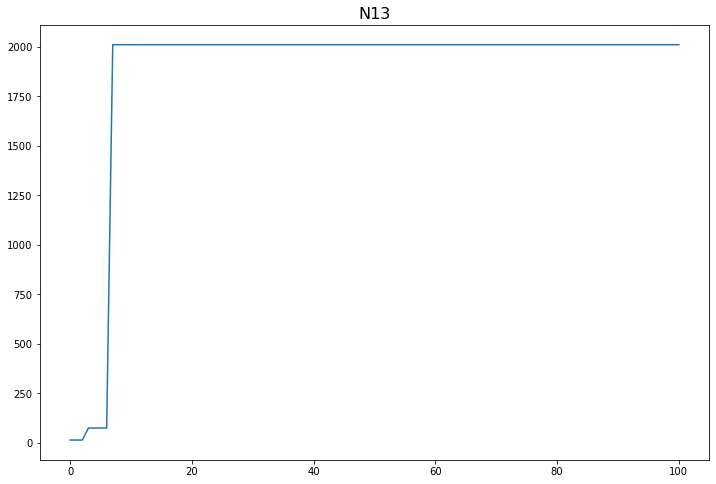

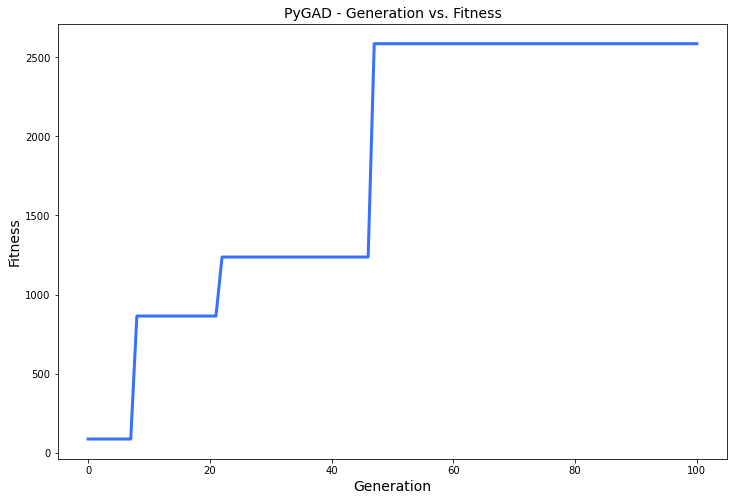

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.927 |==================| 7.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.782 |==================| 3.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.807 |==================| 3.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.179 |==================| 8.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.016 |==================| 22.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.123 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.671 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.008 |==================| 0.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 23.058 |==================| 1.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.79 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 23.064 |==================| 1.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.685 |==================| 1.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 22.269 |==================| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 23.058 |==================| 1.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.79 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 23.064 |==================| 1.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.685 |==================| 1.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 22.269 |==================| 0.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.626 |==================| 1.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.711 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 23.064 |==================| 1.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.685 |==================| 1.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 22.269 |==================| 0.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.626 |==================| 1.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.711 |==================| 1.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.986 |==================| 7.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 22.183 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.579 |==================| 1.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 23.842 |==================| 104.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 21.093 |==================| 0.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 22.482 |==================| 0.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.518 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 21.403 |==================| 0.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.513 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 23.842 |==================| 104.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 21.093 |==================| 0.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 22.482 |==================| 0.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.518 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 21.403 |==================| 0.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.513 |==================| 1.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.93 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 25.049 |==================| 0.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.694 |==================| 1.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.478 |==================| 1.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.861 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.807 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 25.032 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.93 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.861 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.807 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 25.032 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.93 |==================| 0.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 22.269 |==================| 0.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.944 |==================| 0.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.555 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.93 |==================| 0.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 22.269 |==================| 0.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.944 |==================| 0.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.555 |==================| 1.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.51 |==================| 1.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.873 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.819 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.846 |==================| 1.006 |==========
Fitness = 104.37667513527049
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.51 |==================| 1.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.873 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.819 |==================| 1.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.429 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 20.866 |==================| 0.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.51 |==================| 1.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.873 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.819 |==================| 1.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.429 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 20.866 |==================| 0.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 22.995 |==================| 1.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.39 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 25.013 |==================| 0.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.14 |==================| 3.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 22.822 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.656 |==================| 1.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.76 |==================| 1.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.857 |==================| 0.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 22.008 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.14 |==================| 3.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 22.822 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.656 |==================| 1.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.76 |==================| 1.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.857 |==================| 0.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 22.008 |==================| 0.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 21.897 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 25.047 |==================| 0.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 20.464 |==================| 0.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.364 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.127 |==================| 0.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 21.875 |==================| 0.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.364 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.586 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 20.464 |==================| 0.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.364 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.127 |==================| 0.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 21.875 |==================| 0.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.364 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.586 |==================| 1.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.508 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.364 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.127 |==================| 0.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 21.875 |==================| 0.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.364 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.586 |==================| 1.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.508 |==================| 1.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.648 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.156 |==================| 3.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.047 |==================| 5.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.275 |==================| 2.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 22.744 |==================| 0.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.955 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 22.971 |==================| 1.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 22.227 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.047 |==================| 5.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.275 |==================| 2.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 22.744 |==================| 0.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.955 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 22.971 |==================| 1.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 22.227 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.366 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 20.897 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 22.741 |==================| 0.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 22.77 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.952 |==================| 0.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.468 |==================| 1.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.337 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.627 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 22.741 |==================| 0.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 22.77 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.952 |==================| 0.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.468 |==================| 1.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.337 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.627 |==================| 1.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 20.727 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 22.77 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.952 |==================| 0.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.468 |==================| 1.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.337 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.627 |==================| 1.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 20.727 |==================| 0.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 20.684 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 22.688 |==================| 0.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.97 |==================| 0.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.948 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.743 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 22.035 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 20.496 |==================| 0.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 23.842 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.97 |==================| 0.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.948 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.743 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 22.035 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 20.496 |==================| 0.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 23.842 |==================| 100.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 22.141 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.899 |==================| 0.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.782 |==================| 1.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.823 |==================| 1.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.45 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 22.139 |==================| 0.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.092 |==================| 1.317 |==========
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.103 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.782 |==================| 1.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.823 |==================| 1.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.45 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 22.139 |==================| 0.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.092 |==================| 1.317 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.103 |==================| 3.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.971 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.823 |==================| 1.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.45 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 22.139 |==================| 0.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.092 |==================| 1.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 23.815 |==================| 27.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 21.242 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 23.92 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 20.961 |==================| 0.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.545 |==================| 1.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 23.005 |==================| 1.18 |==========
Fitness = 104.37667513527049
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 23.815 |==================| 27.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 21.242 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 23.92 |==================| 14.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.545 |==================| 1.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 23.005 |==================| 1.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 23.815 |==================| 27.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 21.242 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 23.92 |==================| 14.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 23.065 |==================| 1.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.775 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.433 |==================| 1.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 25.047 |==================| 0.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 22.643 |==================| 0.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 21.03 |==================| 0.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.612 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 20.454 |==================| 0.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.56 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 21.03 |==================| 0.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.612 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 20.454 |==================| 0.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.56 |==================| 1.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.388 |==================| 2.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 23.64 |==================| 4.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 22.968 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.311 |==================| 1.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.872 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 20.504 |==================| 0.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.572 |==================| 1.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.153 |==================| 3.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.426 |==================| 1.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 21.173 |==================| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.872 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 20.504 |==================| 0.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.572 |==================| 1.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.153 |==================| 3.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.426 |==================| 1.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 21.173 |==================| 0.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.324 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 20.504 |==================| 0.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.572 |==================| 1.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.153 |==================| 3.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.426 |==================| 1.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 21.173 |==================| 0.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.324 |==================| 1.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 21.019 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 23.003 |==================| 1.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 20.732 |==================| 0.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.653 |==================| 1.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.602 |==================| 1.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 22.707 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.119 |==================| 3.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.065 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 20.732 |==================| 0.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.653 |==================| 1.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.602 |==================| 1.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 22.707 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.119 |==================| 3.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.065 |==================| 4.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 21.348 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.542 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.822 |==================| 1.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 21.823 |==================| 0.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 20.86 |==================| 0.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.458 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.258 |==================| 1.685 |==========
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 22.522 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 20.86 |==================| 0.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.458 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.258 |==================| 1.685 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 22.522 |==================| 0.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 23.052 |==================| 1.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.819 |==================| 1.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 22.56 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.458 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.258 |==================| 1.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 22.415 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.293 |==================| 1.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.638 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.664 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.592 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 22.864 |==================| 1.012 |==========
Fitness = 1404.1586951969396
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 22.415 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.293 |==================| 1.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.638 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.664 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.592 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 22.415 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.293 |==================| 1.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.638 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.664 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.592 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.906 |==================| 18.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.522 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.634 |==================| 1.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.439 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.65 |==================| 1.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 22.474 |==================| 0.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.664 |==================| 5.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 22.458 |==================| 0.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.916 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.439 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.65 |==================| 1.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 22.474 |==================| 0.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.664 |==================| 5.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 22.458 |==================| 0.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.916 |==================| 0.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 21.249 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 22.741 |==================| 0.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.037 |==================| 5.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 22.23 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.48 |==================| 1.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 22.043 |==================| 0.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 23.963 |==================| 9.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.641 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.037 |==================| 5.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 22.23 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.48 |==================| 1.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 22.043 |==================| 0.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 23.963 |==================| 9.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.641 |==================| 1.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.046 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 22.043 |==================| 0.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 23.963 |==================| 9.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.641 |==================| 1.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.046 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.488 |==================| 1.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.87 |==================| 0.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.849 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.444 |==================| 1.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.253 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.965 |==================| 0.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 23.891 |==================| 25.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.157 |==================| 3.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 20.458 |==================| 0.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.781 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.965 |==================| 0.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 23.891 |==================| 25.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.157 |==================| 3.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 20.458 |==================| 0.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.781 |==================| 14.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.164 |==================| 3.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 23.486 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.977 |==================| 7.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.749 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 20.522 |==================| 0.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.198 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 21.545 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.133 |==================| 3.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.884 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.749 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 20.522 |==================| 0.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.198 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 21.545 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.133 |==================| 3.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.884 |==================| 31.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 22.198 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 20.522 |==================| 0.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.198 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 21.545 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.133 |==================| 3.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.884 |==================| 31.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 22.198 |==================| 0.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.888 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.638 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.097 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.677 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.988 |==================| 7.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.935 |==================| 12.052 |==========
Fitness = 1404.1586951969396
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.888 |==================| 0.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.097 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.677 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.988 |==================| 7.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.935 |==================| 12.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.888 |==================| 0.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 22.936 |==================| 1.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.647 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.27 |==================| 2.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.31 |==================| 2.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.049 |==================| 5.08 |==========
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 23.339 |==================| 1.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.199 |==================| 2.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.962 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 22.174 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.31 |==================| 2.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.049 |==================| 5.08 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 23.339 |==================| 1.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.199 |==================| 2.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.962 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 22.174 |==================| 0.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.547 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.049 |==================| 5.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 20.676 |==================| 0.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 21.765 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.125 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.027 |==================| 5.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 21.668 |==================| 0.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 23.837 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 20.676 |==================| 0.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 21.765 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.125 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.027 |==================| 5.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 21.668 |==================| 0.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 23.837 |==================| 67.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.388 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 21.765 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.125 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.027 |==================| 5.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 21.668 |==================| 0.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 23.837 |==================| 67.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.388 |==================| 1.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 21.413 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 21.357 |==================| 0.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.883 |==================| 1.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.381 |==================| 1.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.586 |==================| 1.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 22.567 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 22.162 |==================| 0.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.549 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.883 |==================| 1.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.381 |==================| 1.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.586 |==================| 1.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 22.567 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 22.162 |==================| 0.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.549 |==================| 3.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 22.529 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 22.142 |==================| 0.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.324 |==================| 1.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 22.718 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 21.939 |==================| 0.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.64 |==================| 1.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.211 |==================| 2.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 21.968 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.324 |==================| 1.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 22.718 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 21.939 |==================| 0.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.64 |==================| 1.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.211 |==================| 2.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 21.968 |==================| 0.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 21.061 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 22.718 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 21.939 |==================| 0.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.64 |==================| 1.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.211 |==================| 2.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 21.968 |==================| 0.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 21.061 |==================| 0.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.316 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.971 |==================| 8.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.73 |==================| 1.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 21.27 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 20.965 |==================| 0.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.196 |==================| 2.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 21.401 |==================| 0.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.074 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.73 |==================| 1.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 21.27 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 20.965 |==================| 0.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.196 |==================| 2.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 21.401 |==================| 0.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.074 |==================| 4.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.299 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.246 |==================| 2.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 21.643 |==================| 0.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 22.809 |==================| 0.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.795 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.003 |==================| 0.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.985 |==================| 7.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 21.703 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 21.643 |==================| 0.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 22.809 |==================| 0.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.795 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.003 |==================| 0.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.985 |==================| 7.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 21.703 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 20.556 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 22.809 |==================| 0.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.795 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.003 |==================| 0.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.985 |==================| 7.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 21.703 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 20.556 |==================| 0.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 22.592 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.467 |==================| 1.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 20.475 |==================| 0.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 23.507 |==================| 2.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 20.916 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 20.577 |==================| 0.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.493 |==================| 1.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 20.597 |==================| 0.3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 23.507 |==================| 2.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 20.916 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 20.577 |==================| 0.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.493 |==================| 1.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 20.597 |==================| 0.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 22.992 |==================| 1.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 20.758 |==================| 0.3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.948 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 22.402 |==================| 0.69 |==========
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.028 |==================| 5.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.501 |==================| 1.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 22.414 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.627 |==================| 1.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 22.183 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 22.402 |==================| 0.69 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.028 |==================| 5.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.501 |==================| 1.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 22.414 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.627 |==================| 1.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 22.183 |==================| 0.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 22.898 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 21.746 |==================| 0.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 22.368 |==================| 0.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.769 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.403 |==================| 1.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.016 |==================| 6.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 20.764 |==================| 0.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.76 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 22.368 |==================| 0.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.769 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.403 |==================| 1.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.016 |==================| 6.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 20.764 |==================| 0.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.76 |==================| 1.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.848 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.769 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.403 |==================| 1.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.016 |==================| 6.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 20.764 |==================| 0.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.76 |==================| 1.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.848 |==================| 1.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 21.255 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 22.303 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 20.984 |==================| 0.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.168 |==================| 3.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 22.405 |==================| 0.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.125 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.887 |==================| 28.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.021 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 20.984 |==================| 0.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.168 |==================| 3.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 22.405 |==================| 0.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.125 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.887 |==================| 28.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.021 |==================| 0.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 22.713 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.349 |==================| 2.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.88 |==================| 35.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.854 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 21.955 |==================| 0.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 20.897 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 21.306 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.198 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.88 |==================| 35.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.854 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 21.955 |==================| 0.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 20.897 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 21.306 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.198 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.945 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.854 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 21.955 |==================| 0.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 20.897 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 21.306 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.198 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.945 |==================| 0.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 20.681 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.903 |==================| 0.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 23.069 |==================| 1.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.542 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.754 |==================| 1.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.255 |==================| 2.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.505 |==================| 1.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.952 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.754 |==================| 1.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.255 |==================| 2.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.505 |==================| 1.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.952 |==================| 0.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.035 |==================| 5.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 23.561 |==================| 3.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.323 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.189 |==================| 2.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.395 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.049 |==================| 5.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.42 |==================| 1.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.645 |==================| 1.26 |==========
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 21.118 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.109 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.049 |==================| 5.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.42 |==================| 1.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.645 |==================| 1.26 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 21.118 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.109 |==================| 3.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 21.51 |==================| 0.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.052 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.645 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 22.377 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 22.026 |==================| 0.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 22.738 |==================| 0.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 22.563 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 20.923 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 20.672 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 22.738 |==================| 0.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 22.563 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 20.923 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 20.672 |==================| 0.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.809 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 22.285 |==================| 0.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 21.122 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 20.672 |==================| 0.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.809 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 22.285 |==================| 0.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 21.122 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.555 |==================| 1.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 25.046 |==================| 0.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 21.928 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.332 |==================| 1.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.502 |==================| 1.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.507 |==================| 1.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 21.872 |==================| 0.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.753 |==================| 1.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.943 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.728 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.502 |==================| 1.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.507 |==================| 1.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 21.872 |==================| 0.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.753 |==================| 1.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.943 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.728 |==================| 1.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.61 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 22.104 |==================| 0.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.891 |==================| 0.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.182 |==================| 1.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.068 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 22.939 |==================| 1.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.435 |==================| 1.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 20.817 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.182 |==================| 1.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.068 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 22.939 |==================| 1.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.435 |==================| 1.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 20.817 |==================| 0.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 22.441 |==================| 0.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 21.353 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.435 |==================| 1.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 20.817 |==================| 0.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 22.441 |==================| 0.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 21.353 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.524 |==================| 1.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 21.451 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 23.331 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 21.66 |==================| 0.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 21.352 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 20.457 |==================| 0.295 |==========
Fitness = 1404.1586951969396
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.524 |==================| 1.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 21.451 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 23.331 |==================| 1.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 21.352 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 20.457 |==================| 0.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.524 |==================| 1.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 21.451 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 23.331 |==================| 1.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.906 |==================| 18.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 21.544 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.996 |==================| 6.919 |==========
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 21.967 |==================| 0.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.036 |==================| 5.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.172 |==================| 1.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.894 |==================| 0.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.135 |==================| 3.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.98 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 21.967 |==================| 0.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.036 |==================| 5.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.172 |==================| 1.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.894 |==================| 0.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.135 |==================| 3.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.98 |==================| 7.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 22.501 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 22.562 |==================| 0.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 21.389 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.464 |==================| 1.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.765 |==================| 1.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 20.835 |==================| 0.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.592 |==================| 1.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.226 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.464 |==================| 1.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.765 |==================| 1.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 20.835 |==================| 0.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.592 |==================| 1.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.226 |==================| 1.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.81 |==================| 23.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 21.91 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.592 |==================| 1.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.226 |==================| 1.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.81 |==================| 23.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 21.91 |==================| 0.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.464 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.307 |==================| 1.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.429 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.185 |==================| 3.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.761 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 23.994 |==================| 7.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 22.742 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 21.998 |==================| 0.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 21.806 |==================| 0.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.408 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.761 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 23.994 |==================| 7.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 22.742 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 21.998 |==================| 0.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 21.806 |==================| 0.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.408 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 20.825 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.711 |==================| 1.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 20.671 |==================| 0.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.515 |==================| 1.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 22.285 |==================| 0.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.138 |==================| 1.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.354 |==================| 2.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 20.895 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 22.285 |==================| 0.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.138 |==================| 1.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.354 |==================| 2.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 20.895 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.183 |==================| 1.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.227 |==================| 1.6 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.953 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.354 |==================| 2.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 20.895 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.183 |==================| 1.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.227 |==================| 1.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.884 |==================| 1.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 20.813 |==================| 0.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 20.477 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.676 |==================| 1.214 |==========
Fitness = 1404.1586951969396
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.884 |==================| 1.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 20.813 |==================| 0.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 20.477 |==================| 0.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 22.874 |==================| 1.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 21.689 |==================| 0.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 20.813 |==================| 0.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 20.477 |==================| 0.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 22.874 |==================| 1.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 21.689 |==================| 0.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.945 |==================| 10.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 21.391 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 21.86 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 23.999 |==================| 6.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 23.341 |==================| 1.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 20.91 |==================| 0.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.991 |==================| 0.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 21.595 |==================| 0.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.056 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.21 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 23.341 |==================| 1.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 20.91 |==================| 0.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.991 |==================| 0.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 21.595 |==================| 0.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.056 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.21 |==================| 2.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 20.572 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 22.32 |==================| 0.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.806 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 21.61 |==================| 0.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.516 |==================| 1.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.316 |==================| 1.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 22.543 |==================| 0.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 21.07 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.806 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 21.61 |==================| 0.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.516 |==================| 1.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.316 |==================| 1.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 22.543 |==================| 0.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 21.07 |==================| 0.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 21.263 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 21.61 |==================| 0.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.516 |==================| 1.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.316 |==================| 1.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 22.543 |==================| 0.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 21.07 |==================| 0.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 21.263 |==================| 0.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 21.496 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.348 |==================| 1.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.07 |==================| 4.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.79 |==================| 0.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 22.201 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.904 |==================| 0.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.712 |==================| 1.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.84 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.07 |==================| 4.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.79 |==================| 0.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 22.201 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.904 |==================| 0.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.712 |==================| 1.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.84 |==================| 1.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.36 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 22.817 |==================| 0.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 23.074 |==================| 1.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 21.701 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.622 |==================| 1.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 23.812 |==================| 24.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 20.642 |==================| 0.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 22.313 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 23.074 |==================| 1.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 21.701 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.622 |==================| 1.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 23.812 |==================| 24.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 20.642 |==================| 0.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 22.313 |==================| 0.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.053 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 21.701 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.622 |==================| 1.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 23.812 |==================| 24.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 20.642 |==================| 0.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 22.313 |==================| 0.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.053 |==================| 0.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.207 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 22.734 |==================| 0.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 21.578 |==================| 0.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 22.05 |==================| 0.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.704 |==================| 1.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.923 |==================| 14.037 |==========
Fitness = 6059.581092351341
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.207 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 21.578 |==================| 0.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 22.05 |==================| 0.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.704 |==================| 1.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.923 |==================| 14.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.207 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.046 |==================| 5.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 21.924 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.997 |==================| 6.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.657 |==================| 5.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 21.051 |==================| 0.357 |==========
Generation = 49
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 20.656 |==================| 0.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 21.555 |==================| 0.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 23.893 |==================| 24.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.246 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.657 |==================| 5.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 21.051 |==================| 0.357 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 20.656 |==================| 0.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 21.555 |==================| 0.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 23.893 |==================| 24.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.246 |==================| 1.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.792 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 21.051 |==================| 0.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.832 |==================| 1.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 21.857 |==================| 0.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.912 |==================| 16.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 23.857 |==================| 213.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 20.623 |==================| 0.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 21.952 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.912 |==================| 16.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 23.857 |==================| 213.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 20.623 |==================| 0.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 21.952 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.159 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.944 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 23.647 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 20.623 |==================| 0.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 21.952 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.159 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.944 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 23.647 |==================| 4.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 23.448 |==================| 2.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.046 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 20.944 |==================| 0.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.18 |==================| 3.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 21.021 |==================| 0.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.725 |==================| 1.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 25.011 |==================| 0.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.774 |==================| 12.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.86 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.18 |==================| 3.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 21.021 |==================| 0.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.725 |==================| 1.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 25.011 |==================| 0.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.774 |==================| 12.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.86 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.709 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 22.205 |==================| 0.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.492 |==================| 1.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 20.688 |==================| 0.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.855 |==================| 0.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.704 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.805 |==================| 1.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.417 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.492 |==================| 1.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 20.688 |==================| 0.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.855 |==================| 0.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.704 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.805 |==================| 1.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.417 |==================| 1.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.549 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.704 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.805 |==================| 1.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.417 |==================| 1.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.549 |==================| 1.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.211 |==================| 2.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 20.863 |==================| 0.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.036 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.049 |==================| 5.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 21.062 |==================| 0.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.349 |==================| 2.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 22.783 |==================| 0.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 22.669 |==================| 0.845 |==========
Fitness = 6059.581092351341
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.798 |==================| 1.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 22.783 |==================| 0.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 22.669 |==================| 0.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.798 |==================| 1.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 21.777 |==================| 0.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.632 |==================| 4.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.254 |==================| 2.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 22.986 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.556 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 22.353 |==================| 0.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 22.222 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 23.993 |==================| 7.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.626 |==================| 1.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.211 |==================| 1.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.653 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 23.993 |==================| 7.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.626 |==================| 1.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.211 |==================| 1.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.653 |==================| 1.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 21.025 |==================| 0.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 22.061 |==================| 0.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 23.153 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.415 |==================| 1.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.38 |==================| 1.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 21.176 |==================| 0.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 21.586 |==================| 0.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 22.975 |==================| 1.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 21.356 |==================| 0.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 22.889 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 21.176 |==================| 0.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 21.586 |==================| 0.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 22.975 |==================| 1.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 21.356 |==================| 0.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 22.889 |==================| 1.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 22.424 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.946 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 21.356 |==================| 0.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 22.889 |==================| 1.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 22.424 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.946 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 23.423 |==================| 2.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 22.074 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 23.89 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 23.467 |==================| 2.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 21.491 |==================| 0.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.052 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.302 |==================| 1.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 21.755 |==================| 0.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 20.739 |==================| 0.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.019 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 21.491 |==================| 0.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.052 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.302 |==================| 1.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 21.755 |==================| 0.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 20.739 |==================| 0.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.019 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 21.161 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.598 |==================| 1.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 22.037 |==================| 0.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.06 |==================| 4.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 25.005 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.73 |==================| 1.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 21.891 |==================| 0.51 |==========
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 20.873 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.06 |==================| 4.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 25.005 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.73 |==================| 1.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 21.891 |==================| 0.51 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 20.873 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 21.608 |==================| 0.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.078 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 25.005 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.73 |==================| 1.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 21.891 |==================| 0.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.492 |==================| 1.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.955 |==================| 0.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.74 |==================| 1.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.378 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.492 |==================| 1.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.955 |==================| 0.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.74 |==================| 1.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.378 |==================| 1.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 22.594 |==================| 0.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.413 |==================| 1.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.987 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.378 |==================| 1.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 22.594 |==================| 0.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.413 |==================| 1.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.987 |==================| 0.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.518 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.633 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 21.067 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.227 |==================| 2.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.839 |==================| 1.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.755 |==================| 1.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.784 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.116 |==================| 3.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.972 |==================| 8.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 21.132 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.839 |==================| 1.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.755 |==================| 1.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.784 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.116 |==================| 3.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.972 |==================| 8.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 21.132 |==================| 0.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.901 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 21.163 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 22.87 |==================| 1.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 24.353 |==================| 1.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 22.99 |==================| 1.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.628 |==================| 1.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.959 |==================| 0.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.912 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 22.99 |==================| 1.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.628 |==================| 1.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.959 |==================| 0.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.912 |==================| 0.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 21.794 |==================| 0.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.923 |==================| 14.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.262 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.912 |==================| 0.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 21.794 |==================| 0.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.923 |==================| 14.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.262 |==================| 1.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.788 |==================| 1.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.039 |==================| 5.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.853 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 22.217 |==================| 0.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 20.518 |==================| 0.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.033 |==================| 5.513 |==========
Fitness = 6059.581092351341
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.853 |==================| 0.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 21.499 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 23.459 |==================| 2.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.853 |==================| 0.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 21.499 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 23.459 |==================| 2.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 20.545 |==================| 0.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 20.726 |==================| 0.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.384 |==================| 2.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.591 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.7 |==================| 1.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 22.265 |==================| 0.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.06 |==================| 0.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 22.343 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 21.974 |==================| 0.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.444 |==================| 1.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.263 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 22.265 |==================| 0.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.06 |==================| 0.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 22.343 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 21.974 |==================| 0.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.444 |==================| 1.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.263 |==================| 0.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.434 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.397 |==================| 1.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 23.79 |==================| 16.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.253 |==================| 2.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 25.025 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.975 |==================| 8.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.897 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.002 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 23.79 |==================| 16.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.253 |==================| 2.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 25.025 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.975 |==================| 8.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.897 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.002 |==================| 0.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 22.651 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 25.025 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.975 |==================| 8.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.897 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.002 |==================| 0.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 22.651 |==================| 0.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.476 |==================| 2.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.804 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.701 |==================| 1.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.003 |==================| 0.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 25.026 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 22.019 |==================| 0.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.885 |==================| 30.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.285 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.758 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.003 |==================| 0.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 25.026 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 22.019 |==================| 0.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.885 |==================| 30.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.285 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.758 |==================| 1.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 22.348 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.835 |==================| 1.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 20.454 |==================| 0.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.023 |==================| 5.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.836 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 22.763 |==================| 0.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 22.534 |==================| 0.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 22.447 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 20.454 |==================| 0.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.023 |==================| 5.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.836 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 22.763 |==================| 0.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 22.534 |==================| 0.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 22.447 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 25.043 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.023 |==================| 5.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.836 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 22.763 |==================| 0.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 22.534 |==================| 0.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 22.447 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 25.043 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.226 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.591 |==================| 3.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.982 |==================| 0.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.072 |==================| 4.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 20.837 |==================| 0.332 |==========
Fitness = 6059.581092351341
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.226 |==================| 2.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 21.809 |==================| 0.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 20.837 |==================| 0.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.226 |==================| 2.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 21.809 |==================| 0.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.862 |==================| 94.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.316 |==================| 2.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.969 |==================| 8.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 21.528 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 21.334 |==================| 0.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.582 |==================| 1.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 20.606 |==================| 0.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.741 |==================| 1.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 22.091 |==================| 0.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.956 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.607 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.582 |==================| 1.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 20.606 |==================| 0.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.741 |==================| 1.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 22.091 |==================| 0.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.956 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.607 |==================| 4.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.53 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.934 |==================| 12.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.773 |==================| 1.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.931 |==================| 12.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.364 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.608 |==================| 1.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 22.706 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.467 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.773 |==================| 1.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.931 |==================| 12.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.364 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.608 |==================| 1.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 22.706 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.467 |==================| 1.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.525 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.931 |==================| 12.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.364 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.608 |==================| 1.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 22.706 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.467 |==================| 1.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.525 |==================| 3.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 23.938 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 20.779 |==================| 0.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.937 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 20.483 |==================| 0.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.825 |==================| 1.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 22.91 |==================| 1.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 23.72 |==================| 7.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 23.771 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.937 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 20.483 |==================| 0.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.825 |==================| 1.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 22.91 |==================| 1.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 23.72 |==================| 7.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 23.771 |==================| 12.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.85 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.244 |==================| 2.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.142 |==================| 3.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 22.462 |==================| 0.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.86 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 25.037 |==================| 0.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.389 |==================| 1.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.314 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.142 |==================| 3.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 22.462 |==================| 0.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.86 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 25.037 |==================| 0.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.389 |==================| 1.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.314 |==================| 2.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.95 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.86 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 25.037 |==================| 0.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.389 |==================| 1.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.314 |==================| 2.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.95 |==================| 10.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.627 |==================| 1.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.689 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.277 |==================| 2.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 23.824 |==================| 35.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 20.554 |==================| 0.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.714 |==================| 1.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.403 |==================| 2.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.968 |==================| 0.896 |==========
Fitness = 6059.581092351341
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 23.824 |==================| 35.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 20.554 |==================| 0.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.714 |==================| 1.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.403 |==================| 2.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.968 |==================| 0.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.869 |==================| 0.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 20.513 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 23.069 |==================| 1.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 23.691 |==================| 6.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 20.491 |==================| 0.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 22.524 |==================| 0.753 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.26 |==================| 2.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.522 |==================| 1.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 22.876 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 20.491 |==================| 0.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 22.524 |==================| 0.753 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.26 |==================| 2.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.522 |==================| 1.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 22.876 |==================| 1.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 21.893 |==================| 0.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 23.101 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.87 |==================| 0.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.559 |==================| 1.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.679 |==================| 1.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.073 |==================| 4.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 22.785 |==================| 0.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.036 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 21.63 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.559 |==================| 1.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.679 |==================| 1.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.073 |==================| 4.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 22.785 |==================| 0.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.036 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 21.63 |==================| 0.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 25.042 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.679 |==================| 1.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.073 |==================| 4.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 22.785 |==================| 0.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.036 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 21.63 |==================| 0.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 25.042 |==================| 0.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.517 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.115 |==================| 3.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 21.049 |==================| 0.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 22.844 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 23.757 |==================| 10.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 20.829 |==================| 0.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 22.707 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.232 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 21.049 |==================| 0.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 22.844 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 23.757 |==================| 10.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 20.829 |==================| 0.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 22.707 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.232 |==================| 2.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.586 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 21.084 |==================| 0.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.982 |==================| 0.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.408 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 22.302 |==================| 0.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 20.952 |==================| 0.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.439 |===========| 20.656 |==================| 0.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 22.333 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 22.302 |==================| 0.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 20.952 |==================| 0.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.439 |===========| 20.656 |==================| 0.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 22.333 |==================| 0.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 21.846 |==================| 0.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.191 |==================| 2.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.687 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 20.952 |==================| 0.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.439 |===========| 20.656 |==================| 0.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 22.333 |==================| 0.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 21.846 |==================| 0.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.191 |==================| 2.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.687 |==================| 1.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.028 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.141 |==================| 1.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 21.753 |==================| 0.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.725 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.492 |==================| 1.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.058 |==================| 4.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.848 |==================| 274.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 23.674 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 21.753 |==================| 0.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.725 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.492 |==================| 1.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.058 |==================| 4.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.848 |==================| 274.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 23.674 |==================| 5.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.619 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.656 |==================| 5.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 21.596 |==================| 0.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 25.036 |==================| 0.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.938 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.885 |==================| 0.968 |==========
Generation = 77
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 23.866 |==================| 68.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 22.01 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 21.596 |==================| 0.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 25.036 |==================| 0.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.938 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.885 |==================| 0.968 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 23.866 |==================| 68.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 22.01 |==================| 0.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.909 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.938 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.885 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 22.689 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 21.359 |==================| 0.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.704 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.09 |==================| 4.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.893 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 21.359 |==================| 0.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.704 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.09 |==================| 4.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.893 |==================| 1.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 23.723 |==================| 7.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 23.749 |==================| 9.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.415 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.704 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.09 |==================| 4.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.893 |==================| 1.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 23.723 |==================| 7.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 23.749 |==================| 9.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.415 |==================| 2.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 22.441 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.148 |==================| 3.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.638 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.997 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 23.58 |==================| 3.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.656 |==================| 5.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.969 |==================| 8.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.914 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.638 |==================| 1.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.997 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 23.58 |==================| 3.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.656 |==================| 5.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.969 |==================| 8.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.914 |==================| 16.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.065 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.634 |==================| 1.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.414 |==================| 1.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.787 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.424 |==================| 1.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 23.888 |==================| 27.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.902 |==================| 20.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 22.987 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.414 |==================| 1.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.787 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.424 |==================| 1.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 23.888 |==================| 27.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.902 |==================| 20.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 22.987 |==================| 1.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.285 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.787 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.424 |==================| 1.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 23.888 |==================| 27.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.902 |==================| 20.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 22.987 |==================| 1.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.285 |==================| 2.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 23.239 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.978 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.999 |==================| 0.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 23.279 |==================| 1.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.869 |==================| 0.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.45 |==================| 1.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.199 |==================| 1.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.016 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.999 |==================| 0.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 23.279 |==================| 1.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.869 |==================| 0.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.45 |==================| 1.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.199 |==================| 1.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.016 |==================| 6.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.372 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.057 |==================| 4.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.707 |==================| 1.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 21.561 |==================| 0.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.474 |==================| 1.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 22.61 |==================| 0.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.645 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 23.614 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 21.561 |==================| 0.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.474 |==================| 1.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 22.61 |==================| 0.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.645 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 23.614 |==================| 4.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.32 |==================| 2.137 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 22.695 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.474 |==================| 1.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 22.61 |==================| 0.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.645 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 23.614 |==================| 4.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.32 |==================| 2.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.204 |==================| 2.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 21.454 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 23.938 |==================| 11.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.585 |==================| 1.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.591 |==================| 1.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.109 |==================| 3.885 |==========
Fitness = 6059.581092351341
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.204 |==================| 2.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 21.454 |==================| 0.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.591 |==================| 1.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.109 |==================| 3.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.204 |==================| 2.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 21.454 |==================| 0.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 23.799 |==================| 19.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 21.306 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 21.06 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.846 |==================| 1.006 |==========
Generation = 84
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.451 |==================| 1.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.321 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.166 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.095 |==================| 4.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.606 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.362 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.451 |==================| 1.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.321 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.166 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.095 |==================| 4.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.606 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.362 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.776 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 23.695 |==================| 6.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 20.809 |==================| 0.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 23.428 |==================| 2.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.045 |==================| 5.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 22.597 |==================| 0.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 21.492 |==================| 0.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 22.791 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 23.428 |==================| 2.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.045 |==================| 5.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 22.597 |==================| 0.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 21.492 |==================| 0.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 22.791 |==================| 0.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.7 |==================| 1.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.536 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.045 |==================| 5.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 22.597 |==================| 0.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 21.492 |==================| 0.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 22.791 |==================| 0.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.7 |==================| 1.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.536 |==================| 1.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 20.66 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 22.765 |==================| 0.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 21.55 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 22.719 |==================| 0.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 21.731 |==================| 0.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 20.763 |==================| 0.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.092 |==================| 4.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.058 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 21.731 |==================| 0.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 20.763 |==================| 0.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.092 |==================| 4.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.058 |==================| 4.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 23.676 |==================| 5.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.981 |==================| 7.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 22.788 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.61 |==================| 4.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.233 |==================| 2.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 22.032 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.785 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.526 |==================| 1.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.253 |==================| 2.493 |==========
Generation = 87
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.064 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.785 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.526 |==================| 1.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.253 |==================| 2.493 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.064 |==================| 4.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.019 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.774 |==================| 1.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.345 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.526 |==================| 1.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.253 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.412 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 23.167 |==================| 1.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.381 |==================| 1.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 20.875 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 23.046 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.539 |==================| 1.455 |==========
Fitness = 6059.581092351341
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.412 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 23.167 |==================| 1.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.381 |==================| 1.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 20.875 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 23.046 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.412 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 23.167 |==================| 1.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.381 |==================| 1.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 20.875 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 23.046 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.862 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 21.559 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 21.252 |==================| 0.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 20.768 |==================| 0.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 23.008 |==================| 1.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.034 |==================| 5.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.67 |==================| 1.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 22.106 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.094 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 20.768 |==================| 0.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 23.008 |==================| 1.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.034 |==================| 5.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.67 |==================| 1.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 22.106 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.094 |==================| 4.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 23.741 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 21.613 |==================| 0.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 22.128 |==================| 0.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 21.162 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 23.29 |==================| 1.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 20.446 |==================| 0.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.02 |==================| 5.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 22.184 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 22.128 |==================| 0.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 21.162 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 23.29 |==================| 1.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 20.446 |==================| 0.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.02 |==================| 5.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 22.184 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.582 |==================| 1.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 21.162 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 23.29 |==================| 1.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 20.446 |==================| 0.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.02 |==================| 5.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 22.184 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.582 |==================| 1.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 24.353 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.453 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 22.634 |==================| 0.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.962 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 22.401 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.483 |==================| 1.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 22.225 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 22.057 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 22.634 |==================| 0.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.962 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 22.401 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.483 |==================| 1.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 22.225 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 22.057 |==================| 0.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.321 |===========| 21.098 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 22.374 |==================| 0.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 21.486 |==================| 0.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.908 |==================| 17.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.401 |==================| 1.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.051 |==================| 0.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 21.937 |==================| 0.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.98 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 21.486 |==================| 0.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.908 |==================| 17.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.401 |==================| 1.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.051 |==================| 0.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 21.937 |==================| 0.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.98 |==================| 0.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.878 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.908 |==================| 17.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.401 |==================| 1.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.051 |==================| 0.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 21.937 |==================| 0.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.98 |==================| 0.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.878 |==================| 0.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 23.103 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 23.675 |==================| 5.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.499 |==================| 1.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.758 |==================| 1.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 22.58 |==================| 0.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.549 |==================| 3.305 |==========
Fitness = 6059.581092351341
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.677 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 22.58 |==================| 0.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.549 |==================| 3.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.677 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.893 |==================| 1.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 21.235 |==================| 0.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 21.115 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 21.911 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.951 |==================| 0.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 20.879 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.622 |==================| 4.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 20.582 |==================| 0.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.433 |==================| 1.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 22.405 |==================| 0.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.311 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 20.879 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.622 |==================| 4.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 20.582 |==================| 0.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.433 |==================| 1.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 22.405 |==================| 0.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.311 |==================| 2.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 23.925 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 21.737 |==================| 0.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.536 |==================| 3.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 22.782 |==================| 0.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.793 |==================| 1.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 23.671 |==================| 5.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 25.061 |==================| 0.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.589 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 22.782 |==================| 0.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.793 |==================| 1.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 23.671 |==================| 5.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 25.061 |==================| 0.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.589 |==================| 3.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 21.986 |==================| 0.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.127 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 23.671 |==================| 5.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 25.061 |==================| 0.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.589 |==================| 3.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 21.986 |==================| 0.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.127 |==================| 3.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.27 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 21.324 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 22.798 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 23.295 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 21.441 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.932 |==================| 0.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 21.67 |==================| 0.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.024 |==================| 1.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.834 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 23.295 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 21.441 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.932 |==================| 0.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 21.67 |==================| 0.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.024 |==================| 1.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.834 |==================| 1.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 21.864 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.115 |==================| 3.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 22.672 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.595 |==================| 1.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.542 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 21.347 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.074 |==================| 4.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.638 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.595 |==================| 1.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.542 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 21.347 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.074 |==================| 4.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.638 |==================| 1.271 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 20.451 |==================| 0.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.62 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.542 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 21.347 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.074 |==================| 4.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.638 |==================| 1.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 23.796 |==================| 18.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 20.565 |==================| 0.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.594 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.235 |==================| 2.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 22.508 |==================| 0.744 |==========
Fitness = 6059.581092351341
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 23.796 |==================| 18.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 20.565 |==================| 0.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.594 |==================| 1.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 21.957 |==================| 0.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 20.565 |==================| 0.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.594 |==================| 1.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 21.957 |==================| 0.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 23.267 |==================| 1.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 20.591 |==================| 0.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.841 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.68 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 21.807 |==================| 0.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 23.213 |==================| 1.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.164 |==================| 1.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 21.809 |==================| 0.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.035 |==================| 1.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 23.493 |==================| 2.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 23.431 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 23.213 |==================| 1.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.164 |==================| 1.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 21.809 |==================| 0.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.035 |==================| 1.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 23.493 |==================| 2.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 23.431 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.214 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 22.398 |==================| 0.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.311 |==================| 2.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 21.123 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 22.942 |==================| 1.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 21.696 |==================| 0.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 21.646 |==================| 0.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.276 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 22.942 |==================| 1.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 21.696 |==================| 0.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 21.646 |==================| 0.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.276 |==================| 2.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 23.571 |==================| 3.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.569 |==================| 1.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.111 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 21.696 |==================| 0.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 21.646 |==================| 0.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.276 |==================| 2.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 23.571 |==================| 3.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.569 |==================| 1.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.111 |==================| 3.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 23.859 |================

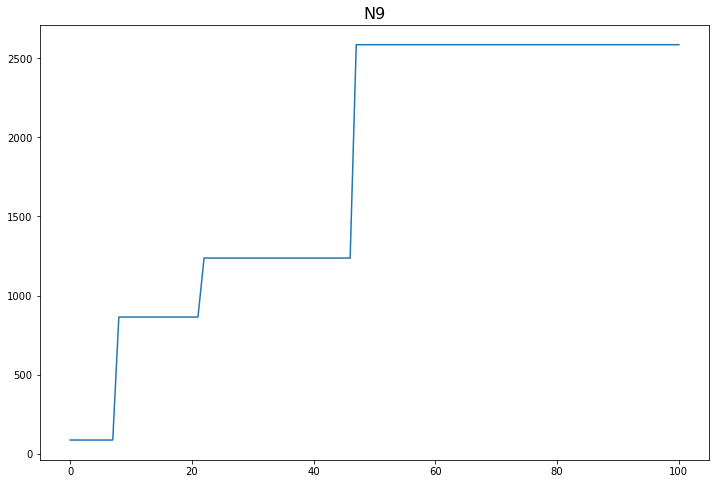

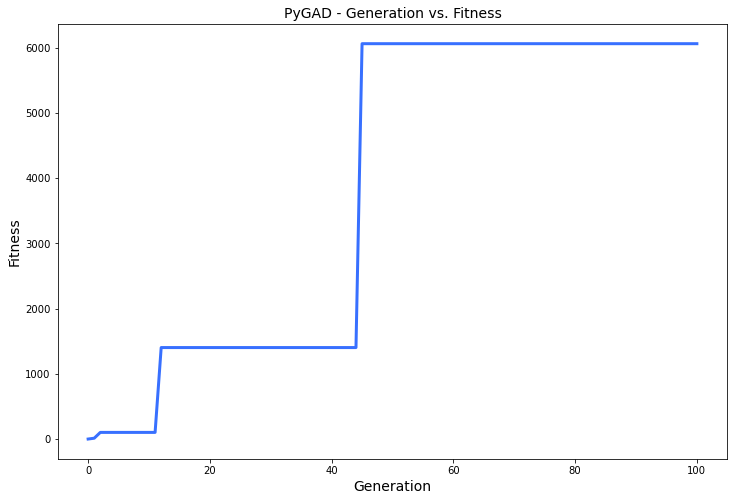

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.218 |==================| 2.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.726 |==================| 1.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 21.688 |==================| 0.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 21.612 |==================| 0.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.021 |==================| 0.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 22.398 |==================| 0.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.311 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 27.872 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.862 |==================| 0.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 28.884 |==================| 2.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 27.958 |==================| 2.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.904 |==================| 2.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 27.467 |==================| 1.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.848 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 27.958 |==================| 2.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.904 |==================| 2.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 27.467 |==================| 1.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.848 |==================| 2.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.515 |==================| 11.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.657 |==================| 4.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 27.874 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.848 |==================| 2.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.515 |==================| 11.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.657 |==================| 4.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 27.874 |==================| 1.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.696 |==================| 3.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.008 |==================| 2.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 27.568 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.512 |==================| 11.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 27.719 |==================| 1.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.881 |==================| 0.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.725 |==================| 0.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 27.854 |==================| 1.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.993 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.505 |===========| 26.602 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.725 |==================| 0.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 27.854 |==================| 1.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.993 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.505 |===========| 26.602 |==================| 0.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 27.671 |==================| 1.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.957 |==================| 1.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.674 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 27.317 |==================| 0.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 28.667 |==================| 4.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.76 |==================| 2.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 27.543 |==================| 1.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.88 |==================| 0.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 27.119 |==================| 0.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.588 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 28.667 |==================| 4.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.76 |==================| 2.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 27.543 |==================| 1.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.88 |==================| 0.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 27.119 |==================| 0.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.588 |==================| 6.16 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 26.852 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.76 |==================| 2.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 27.543 |==================| 1.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.88 |==================| 0.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 27.119 |==================| 0.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.588 |==================| 6.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.675 |==================| 4.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 27.012 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.874 |==================| 0.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 28.015 |==================| 2.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 27.293 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 28.941 |==================| 1.942 |==========
Fitness = 98.91643801716799
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.675 |==================| 4.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 27.012 |==================| 0.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 28.015 |==================| 2.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 27.293 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 28.941 |==================| 1.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.675 |==================| 4.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 27.012 |==================| 0.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.542 |==================| 8.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.048 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 27.208 |==================| 0.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 27.946 |==================| 2.082 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.801 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 27.464 |==================| 1.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 26.67 |==================| 0.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.531 |==================| 9.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.983 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 27.946 |==================| 2.082 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.801 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 27.464 |==================| 1.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 26.67 |==================| 0.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.531 |==================| 9.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.983 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.635 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.843 |==================| 2.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.957 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 27.51 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 28.211 |==================| 4.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.682 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.992 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.745 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 27.51 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 28.211 |==================| 4.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.682 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.992 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.745 |==================| 0.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 27.497 |==================| 1.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.258 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.992 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.745 |==================| 0.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 27.497 |==================| 1.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.258 |==================| 5.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.769 |==================| 2.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 27.009 |==================| 0.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 26.98 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.799 |==================| 0.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.865 |==================| 2.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 27.514 |==================| 1.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.674 |==================| 4.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.507 |==================| 12.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 27.578 |==================| 1.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 27.745 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.865 |==================| 2.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 27.514 |==================| 1.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.674 |==================| 4.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.507 |==================| 12.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 27.578 |==================| 1.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 27.745 |==================| 1.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.686 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 27.054 |==================| 0.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 28.015 |==================| 2.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.601 |==================| 5.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.481 |==================| 18.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.915 |==================| 2.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.728 |==================| 3.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.923 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 28.015 |==================| 2.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.601 |==================| 5.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.481 |==================| 18.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.915 |==================| 2.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.728 |==================| 3.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.923 |==================| 0.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 28.734 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.601 |==================| 5.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.481 |==================| 18.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.915 |==================| 2.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.728 |==================| 3.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.923 |==================| 0.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 28.734 |==================| 3.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.605 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 27.18 |==================| 0.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 27.641 |==================| 1.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.452 |==================| 38.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.599 |==================| 5.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.854 |==================| 0.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.69 |==================| 3.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.145 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.599 |==================| 5.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.854 |==================| 0.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.69 |==================| 3.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.145 |==================| 3.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.644 |==================| 4.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.657 |==================| 4.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 27.854 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.872 |==================| 2.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.717 |==================| 3.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.641 |==================| 4.663 |==========
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.623 |==================| 5.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 27.124 |==================| 0.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.59 |==================| 6.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.118 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.717 |==================| 3.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.641 |==================| 4.663 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.623 |==================| 5.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 27.124 |==================| 0.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.59 |==================| 6.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.118 |==================| 3.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 28.262 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.641 |==================| 4.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 28.911 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.527 |==================| 9.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.957 |==================| 1.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.195 |==================| 4.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.981 |==================| 0.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 27.419 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 28.911 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.527 |==================| 9.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.957 |==================| 1.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.195 |==================| 4.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.981 |==================| 0.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 27.419 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 27.981 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.195 |==================| 4.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.981 |==================| 0.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 27.419 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 27.981 |==================| 2.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.767 |==================| 2.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 27.275 |==================| 0.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 28.221 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 27.511 |==================| 1.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 28.884 |==================| 2.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.682 |==================| 3.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 27.392 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.971 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.769 |==================| 2.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 27.66 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.682 |==================| 3.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 27.392 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.971 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.769 |==================| 2.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 27.66 |==================| 1.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 27.713 |==================| 1.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.611 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.616 |==================| 5.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 27.441 |==================| 1.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.575 |==================| 6.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.264 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.727 |==================| 0.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.993 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 27.261 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 27.441 |==================| 1.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.575 |==================| 6.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.264 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.727 |==================| 0.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.993 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 27.261 |==================| 0.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.639 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.575 |==================| 6.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.264 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.727 |==================| 0.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.993 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 27.261 |==================| 0.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.639 |==================| 4.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.689 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 28.14 |==================| 3.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 27.062 |==================| 0.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 28.91 |==================| 2.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.778 |==================| 2.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 27.071 |==================| 0.738 |==========
Fitness = 98.91643801716799
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.844 |==================| 2.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.778 |==================| 2.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 27.071 |==================| 0.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.844 |==================| 2.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 27.814 |==================| 1.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.382 |==================| 22.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.863 |==================| 2.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.285 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.781 |==================| 2.817 |==========
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 27.132 |==================| 0.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 26.731 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.741 |==================| 3.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.698 |==================| 3.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.151 |==================| 3.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.719 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 27.132 |==================| 0.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 26.731 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.741 |==================| 3.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.698 |==================| 3.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.151 |==================| 3.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.719 |==================| 3.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.538 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 27.347 |==================| 0.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.447 |==================| 48.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.953 |==================| 2.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.74 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.502 |===========| 26.609 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 27.055 |==================| 0.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.637 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.447 |==================| 48.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.953 |==================| 2.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.74 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.502 |===========| 26.609 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 27.055 |==================| 0.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.637 |==================| 4.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.397 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.953 |==================| 2.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.74 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.502 |===========| 26.609 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 27.055 |==================| 0.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.637 |==================| 4.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.397 |==================| 34.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.82 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.7 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.512 |==================| 11.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 27.683 |==================| 1.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.904 |==================| 1.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.03 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.927 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.713 |==================| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.512 |==================| 11.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 27.683 |==================| 1.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.904 |==================| 1.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.03 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.927 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.713 |==================| 0.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 27.955 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 27.251 |==================| 0.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 27.852 |==================| 1.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.216 |==================| 0.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.765 |==================| 2.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.783 |==================| 1.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 27.412 |==================| 0.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.894 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 27.852 |==================| 1.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.216 |==================| 0.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.765 |==================| 2.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.783 |==================| 1.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 27.412 |==================| 0.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.894 |==================| 2.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.024 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.216 |==================| 0.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.765 |==================| 2.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.783 |==================| 1.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 27.412 |==================| 0.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.894 |==================| 2.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.024 |==================| 2.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.798 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 27.693 |==================| 1.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.935 |==================| 1.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 28.734 |==================| 3.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 27.049 |==================| 0.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.753 |==================| 3.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.377 |==================| 20.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.955 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.935 |==================| 1.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 28.734 |==================| 3.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 27.049 |==================| 0.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.753 |==================| 3.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.377 |==================| 20.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.955 |==================| 0.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.841 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.525 |==================| 10.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 27.976 |==================| 2.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.307 |==================| 8.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 27.922 |==================| 1.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.443 |==================| 1.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================| 5.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.432 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 27.976 |==================| 2.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.307 |==================| 8.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 27.922 |==================| 1.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.443 |==================| 1.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================| 5.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.432 |==================| 158.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.323 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.307 |==================| 8.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 27.922 |==================| 1.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.443 |==================| 1.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================| 5.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.432 |==================| 158.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.323 |==================| 9.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 27.587 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.766 |==================| 2.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 28.896 |==================| 2.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.665 |==================| 4.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.976 |==================| 1.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.792 |==================| 2.731 |==========
Fitness = 158.41385882291095
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 27.587 |==================| 1.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 28.896 |==================| 2.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.665 |==================| 4.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.976 |==================| 1.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.792 |==================| 2.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 27.587 |==================| 1.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.361 |==================| 15.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.903 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.782 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.877 |==================| 2.216 |==========
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.445 |==================| 52.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.905 |==================| 2.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.668 |==================| 4.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 27.52 |==================| 1.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.558 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.905 |==================| 2.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.668 |==================| 4.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 27.52 |==================| 1.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.558 |==================| 7.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.91 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 27.184 |==================| 0.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.894 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.611 |==================| 5.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.89 |==================| 0.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 27.895 |==================| 1.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.482 |==================| 17.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 28.228 |==================| 5.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.79 |==================| 2.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 28.365 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.482 |==================| 17.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 28.228 |==================| 5.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.79 |==================| 2.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 28.365 |==================| 16.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.873 |==================| 2.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.997 |==================| 1.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 27.752 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 28.228 |==================| 5.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.79 |==================| 2.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 28.365 |==================| 16.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.873 |==================| 2.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.997 |==================| 1.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 27.752 |==================| 1.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 27.068 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.993 |==================| 1.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.935 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.949 |==================| 1.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.138 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 27.283 |==================| 0.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.924 |==================| 2.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.85 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.935 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.949 |==================| 1.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.138 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 27.283 |==================| 0.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.924 |==================| 2.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.85 |==================| 2.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.529 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.449 |==================| 43.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.618 |==================| 5.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.898 |==================| 2.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 27.367 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.579 |==================| 6.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.954 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.912 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.618 |==================| 5.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.898 |==================| 2.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 27.367 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.579 |==================| 6.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.954 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.912 |==================| 2.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.994 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.898 |==================| 2.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 27.367 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.579 |==================| 6.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.954 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.912 |==================| 2.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.994 |==================| 1.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 27.392 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 27.32 |==================| 0.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.936 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 28.53 |==================| 9.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.758 |==================| 1.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.718 |==================| 0.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.928 |==================| 1.992 |==========
Fitness = 1071.3871694971333
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 28.53 |==================| 9.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.758 |==================| 1.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.718 |==================| 0.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.928 |==================| 1.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.64 |==================| 4.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.452 |==================| 37.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 27.227 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.706 |==================| 3.574 |==========
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.77 |==================| 2.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.93 |==================| 0.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 27.114 |==================| 0.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.968 |==================| 1.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 28.906 |==================| 2.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.598 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.77 |==================| 2.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.93 |==================| 0.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 27.114 |==================| 0.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.968 |==================| 1.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 28.906 |==================| 2.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.598 |==================| 5.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.904 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.918 |==================| 2.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.583 |==================| 6.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 27.334 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.689 |==================| 3.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.925 |==================| 0.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.142 |==================| 3.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.583 |==================| 6.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 27.334 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.689 |==================| 3.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.925 |==================| 0.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.142 |==================| 3.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 27.334 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.689 |==================| 3.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.925 |==================| 0.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.142 |==================| 3.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.564 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.453 |==================| 36.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.511 |==================| 11.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 27.41 |==================| 0.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.943 |==================| 2.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |==================| 3.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.85 |==================| 2.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.819 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.511 |==================| 11.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 27.41 |==================| 0.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.943 |==================| 2.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |==================| 3.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.85 |==================| 2.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.819 |==================| 2.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.686 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.616 |==================| 5.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 27.494 |==================| 1.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.46 |==================| 29.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 28.614 |==================| 5.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.215 |==================| 4.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.665 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.46 |==================| 29.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 28.614 |==================| 5.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.215 |==================| 4.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.665 |==================| 0.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.907 |==================| 2.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.363 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 28.614 |==================| 5.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.215 |==================| 4.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.665 |==================| 0.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.907 |==================| 2.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.363 |==================| 15.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.681 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 28.774 |==================| 2.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.784 |==================| 2.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.681 |==================| 3.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 26.701 |==================| 0.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.622 |==================| 0.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 27.536 |==================| 1.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.988 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.681 |==================| 3.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 26.701 |==================| 0.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.622 |==================| 0.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 27.536 |==================| 1.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.988 |==================| 2.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 28.188 |==================| 4.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 26.671 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 28.566 |==================| 7.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.985 |==================| 1.789 |==========
Generation = 32
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.37 |==================| 17.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.986 |==================| 0.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 26.832 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.933 |==================| 1.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 27.364 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.985 |==================| 1.789 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.37 |==================| 17.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.986 |==================| 0.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 26.832 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.933 |==================| 1.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 27.364 |==================| 0.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.892 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 28.779 |==================| 2.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.816 |==================| 2.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 27.38 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.459 |==================| 30.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.826 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.034 |==================| 2.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 27.883 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 27.38 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.459 |==================| 30.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.826 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.034 |==================| 2.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 27.883 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.042 |==================| 2.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 27.874 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.826 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.034 |==================| 2.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 27.883 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.042 |==================| 2.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 27.874 |==================| 1.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.975 |==================| 1.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 28.871 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.963 |==================| 0.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.798 |==================| 1.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.583 |==================| 6.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.908 |==================| 2.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.764 |==================| 0.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 27.836 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.798 |==================| 1.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.583 |==================| 6.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.908 |==================| 2.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.764 |==================| 0.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 27.836 |==================| 1.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.965 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 27.549 |==================| 1.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.82 |==================| 2.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 27.111 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.275 |==================| 6.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.856 |==================| 1.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.955 |==================| 1.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.758 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.82 |==================| 2.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 27.111 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.275 |==================| 6.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.856 |==================| 1.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.955 |==================| 1.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.758 |==================| 3.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 27.548 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 27.111 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.275 |==================| 6.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.856 |==================| 1.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.955 |==================| 1.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.758 |==================| 3.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 27.548 |==================| 1.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.289 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.781 |==================| 2.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.733 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 27.843 |==================| 1.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.595 |==================| 5.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 26.629 |==================| 0.556 |==========
Fitness = 1071.3871694971333
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.289 |==================| 7.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.733 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 27.843 |==================| 1.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.595 |==================| 5.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 26.629 |==================| 0.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.289 |==================| 7.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 28.92 |==================| 2.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 27.77 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 28.667 |==================| 4.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.678 |==================| 0.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.986 |==================| 1.788 |==========
Generation = 37
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.362 |==================| 15.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.88 |==================| 2.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.994 |==================| 0.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.572 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.678 |==================| 0.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.986 |==================| 1.788 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.362 |==================| 15.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.88 |==================| 2.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.994 |==================| 0.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.572 |==================| 6.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 28.428 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.986 |==================| 1.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 27.796 |==================| 1.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.954 |==================| 1.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.49 |==================| 15.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 27.014 |==================| 0.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 27.674 |==================| 1.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 27.483 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.954 |==================| 1.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.49 |==================| 15.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 27.014 |==================| 0.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 27.674 |==================| 1.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 27.483 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.284 |==================| 7.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.514 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 27.674 |==================| 1.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 27.483 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.284 |==================| 7.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.514 |==================| 11.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.562 |==================| 7.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.621 |==================| 5.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.101 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 28.442 |==================| 62.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.882 |==================| 0.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.908 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.882 |==================| 2.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 27.472 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 28.242 |==================| 5.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.677 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.908 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.882 |==================| 2.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 27.472 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 28.242 |==================| 5.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.677 |==================| 3.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.012 |==================| 2.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 27.271 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.869 |==================| 0.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 27.258 |==================| 0.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 27.844 |==================| 1.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.798 |==================| 1.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.94 |==================| 1.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.439 |==================| 75.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.601 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 27.844 |==================| 1.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.798 |==================| 1.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.94 |==================| 1.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.439 |==================| 75.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.601 |==================| 5.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 28.015 |==================| 2.433 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.116 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.94 |==================| 1.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.439 |==================| 75.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.601 |==================| 5.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 28.015 |==================| 2.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 28.245 |==================| 5.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.839 |==================| 2.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 27.424 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 28.984 |==================| 1.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.997 |==================| 1.75 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 28.245 |==================| 5.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.839 |==================| 2.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 27.424 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.758 |==================| 1.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.839 |==================| 2.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 27.424 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.758 |==================| 1.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 27.896 |==================| 1.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.654 |==================| 0.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.426 |==================| 1739.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.954 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.646 |==================| 4.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 27.105 |==================| 0.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.812 |==================| 2.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 28.958 |==================| 1.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.768 |==================| 2.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 27.225 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 26.643 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 28.958 |==================| 1.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.768 |==================| 2.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 27.225 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 26.643 |==================| 0.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.875 |==================| 2.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.658 |==================| 4.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.24 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.823 |==================| 2.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 27.849 |==================| 1.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.505 |==================| 12.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 27.638 |==================| 1.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.599 |==================| 5.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 27.209 |==================| 0.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 27.385 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 27.638 |==================| 1.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.599 |==================| 5.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 27.209 |==================| 0.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 27.385 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.674 |==================| 4.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.688 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 27.236 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.599 |==================| 5.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 27.209 |==================| 0.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 27.385 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.674 |==================| 4.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.688 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 27.236 |==================| 0.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.717 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.372 |===========| 26.884 |==================| 0.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 27.178 |==================| 0.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 28.372 |==================| 18.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 27.129 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.636 |==================| 4.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 27.187 |==================| 0.807 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 27.178 |==================| 0.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 28.372 |==================| 18.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 27.129 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.636 |==================| 4.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 27.187 |==================| 0.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 27.021 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.858 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 28.22 |==================| 4.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.741 |==================| 3.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 27.246 |==================| 0.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 28.98 |==================| 1.805 |==========
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 27.039 |==================| 0.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.942 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.914 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.741 |==================| 3.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 27.246 |==================| 0.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 28.98 |==================| 1.805 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 27.039 |==================| 0.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.942 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.914 |==================| 2.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 28.552 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 27.246 |==================| 0.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 28.98 |==================| 1.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 27.275 |==================| 0.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 28.954 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.992 |==================| 1.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.814 |==================| 2.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.686 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 27.04 |==================| 0.722 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 27.275 |==================| 0.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 28.954 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.992 |==================| 1.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.814 |==================| 2.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.686 |==================| 3.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 27.275 |==================| 0.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 28.954 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.992 |==================| 1.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.814 |==================| 2.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.686 |==================| 3.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.707 |==================| 1.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.763 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 28.262 |==================| 6.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.813 |==================| 2.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 28.309 |==================| 8.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.415 |==================| 92.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 27.367 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.595 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.813 |==================| 2.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 28.309 |==================| 8.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.415 |==================| 92.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 27.367 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.595 |==================| 5.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.798 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.927 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 27.323 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.93 |==================| 1.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 28.456 |==================| 32.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 28.796 |==================| 2.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.972 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 28.36 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 28.456 |==================| 32.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 28.796 |==================| 2.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.972 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 28.36 |==================| 15.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.592 |==================| 6.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.988 |==================| 1.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 27.007 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 28.796 |==================| 2.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.972 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 28.36 |==================| 15.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.592 |==================| 6.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.988 |==================| 1.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 27.007 |==================| 0.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 27.882 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.38 |==================| 21.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.427 |==================| 1471.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.062 |==================| 2.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 27.333 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.74 |==================| 3.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.401 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.427 |==================| 1471.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.062 |==================| 2.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 27.333 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.74 |==================| 3.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.401 |==================| 0.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 27.79 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 27.165 |==================| 0.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.676 |==================| 3.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.878 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.775 |==================| 1.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.849 |==================| 2.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.434 |==================| 123.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 27.825 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.676 |==================| 3.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.878 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.775 |==================| 1.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.849 |==================| 2.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.434 |==================| 123.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 27.825 |==================| 1.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.634 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.878 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.775 |==================| 1.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.849 |==================| 2.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.434 |==================| 123.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 27.825 |==================| 1.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.634 |==================| 4.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 27.727 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 27.495 |==================| 1.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.424 |==================| 389.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.869 |==================| 2.257 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 27.727 |==================| 1.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.632 |==================| 4.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.451 |==================| 39.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.424 |==================| 389.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.869 |==================| 2.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 27.727 |==================| 1.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.632 |==================| 4.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.451 |==================| 39.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.876 |==================| 1.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.968 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.025 |==================| 2.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 27.415 |==================| 0.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 27.313 |==================| 0.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.776 |==================| 2.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 27.514 |==================| 1.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 27.046 |==================| 0.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.752 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.776 |==================| 2.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 27.514 |==================| 1.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 27.046 |==================| 0.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.752 |==================| 3.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.817 |==================| 2.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 27.182 |==================| 0.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.881 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 27.48 |==================| 1.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.971 |==================| 1.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.253 |==================| 5.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.972 |==================| 1.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.879 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.928 |==================| 1.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.808 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.253 |==================| 5.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.972 |==================| 1.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.879 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.928 |==================| 1.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.808 |==================| 2.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.949 |==================| 1.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.632 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.972 |==================| 1.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.879 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.928 |==================| 1.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.808 |==================| 2.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.949 |==================| 1.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.632 |==================| 4.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 27.364 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.708 |==================| 0.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.676 |==================| 3.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 27.472 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.624 |==================| 5.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.134 |==================| 3.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 27.136 |==================| 0.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.627 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 27.472 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.624 |==================| 5.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.134 |==================| 3.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 27.136 |==================| 0.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.627 |==================| 4.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 27.709 |==================| 1.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.931 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.737 |==================| 3.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.803 |==================| 2.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.306 |==========
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.89 |==================| 0.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.307 |==================| 8.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.622 |==================| 5.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 27.07 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.803 |==================| 2.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.306 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.89 |==================| 0.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.307 |==================| 8.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.622 |==================| 5.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 27.07 |==================| 0.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 27.327 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.533 |==================| 9.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.444 |==================| 55.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 27.608 |==================| 1.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 28.953 |==================| 1.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.686 |==================| 3.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.539 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.533 |==================| 9.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.444 |==================| 55.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 27.608 |==================| 1.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 28.953 |==================| 1.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.686 |==================| 3.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.539 |==================| 8.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.752 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.444 |==================| 55.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 27.608 |==================| 1.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 28.953 |==================| 1.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.686 |==================| 3.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.539 |==================| 8.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.752 |==================| 3.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.825 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 27.674 |==================| 1.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.968 |==================| 1.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 29.0 |==================| 1.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 28.237 |==================| 5.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.538 |==================| 8.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 27.089 |==================| 0.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 27.718 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.968 |==================| 1.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 29.0 |==================| 1.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 28.237 |==================| 5.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.538 |==================| 8.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 27.089 |==================| 0.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 27.718 |==================| 1.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.794 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 27.485 |==================| 1.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.348 |==================| 12.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 28.953 |==================| 1.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 28.464 |==================| 26.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.981 |==================| 0.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.395 |==================| 32.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 27.368 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 28.464 |==================| 26.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.981 |==================| 0.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.395 |==================| 32.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 27.368 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 28.088 |==================| 2.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.878 |==================| 2.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 27.377 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.981 |==================| 0.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.395 |==================| 32.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 27.368 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 28.088 |==================| 2.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.878 |==================| 2.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 27.377 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.537 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.862 |==================| 2.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.712 |==================| 3.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.809 |==================| 2.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 27.745 |==================| 1.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.929 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.765 |==================| 2.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.789 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.712 |==================| 3.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.809 |==================| 2.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 27.745 |==================| 1.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.929 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.765 |==================| 2.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.789 |==================| 2.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.716 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.644 |==================| 4.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 27.163 |==================| 0.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.039 |==================| 2.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.952 |==================| 2.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 27.594 |==================| 1.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.039 |==================| 2.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.813 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 27.163 |==================| 0.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.039 |==================| 2.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.952 |==================| 2.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 27.594 |==================| 1.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.039 |==================| 2.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.813 |==================| 2.581 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.839 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.039 |==================| 2.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.952 |==================| 2.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 27.594 |==================| 1.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.039 |==================| 2.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.813 |==================| 2.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.957 |==================| 1.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 27.869 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 26.852 |==================| 0.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.74 |==================| 3.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 27.333 |==================| 0.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 27.396 |==================| 0.971 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.957 |==================| 1.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 27.869 |==================| 1.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 27.333 |==================| 0.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 27.396 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.957 |==================| 1.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 27.869 |==================| 1.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 26.786 |==================| 0.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 28.683 |==================| 3.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 28.123 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 27.972 |==================| 2.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.489 |==================| 15.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.784 |==================| 1.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.783 |==================| 2.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 27.134 |==================| 0.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.724 |==================| 3.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 27.003 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.784 |==================| 1.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.783 |==================| 2.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 27.134 |==================| 0.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.724 |==================| 3.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 27.003 |==================| 0.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 28.222 |==================| 4.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 27.772 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 27.389 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.733 |==================| 0.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 27.157 |==================| 0.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.316 |==================| 9.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.736 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.752 |==================| 3.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 27.144 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.733 |==================| 0.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 27.157 |==================| 0.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.316 |==================| 9.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.736 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.752 |==================| 3.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 27.144 |==================| 0.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.499 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 27.157 |==================| 0.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.316 |==================| 9.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.736 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.752 |==================| 3.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 27.144 |==================| 0.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.499 |==================| 13.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.927 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.223 |==================| 4.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.818 |==================| 0.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.641 |==================| 4.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 28.92 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.558 |==================| 7.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.806 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.659 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.818 |==================| 0.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.641 |==================| 4.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 28.92 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.558 |==================| 7.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.806 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.659 |==================| 4.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.028 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.735 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 27.317 |==================| 0.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 27.236 |==================| 0.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.521 |==================| 10.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 27.127 |==================| 0.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.511 |==================| 11.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.817 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 27.317 |==================| 0.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 27.236 |==================| 0.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.521 |==================| 10.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 27.127 |==================| 0.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.511 |==================| 11.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.817 |==================| 2.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 27.147 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 27.236 |==================| 0.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.521 |==================| 10.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 27.127 |==================| 0.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.511 |==================| 11.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.817 |==================| 2.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 27.147 |==================| 0.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.461 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.689 |==================| 3.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 1.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.733 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.758 |==================| 3.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.163 |==================| 3.802 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.461 |==================| 28.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 1.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.733 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.758 |==================| 3.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.163 |==================| 3.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.461 |==================| 28.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.341 |==================| 11.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.853 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 26.97 |==================| 0.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.933 |==================| 1.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.266 |==================| 6.258 |==========
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.827 |==================| 2.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.591 |==================| 6.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 27.211 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 27.946 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.933 |==================| 1.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.266 |==================| 6.258 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.827 |==================| 2.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.591 |==================| 6.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 27.211 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 27.946 |==================| 2.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 27.582 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.266 |==================| 6.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 27.488 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.874 |==================| 2.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.537 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.892 |==================| 0.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 27.339 |==================| 0.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.192 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.537 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.892 |==================| 0.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 27.339 |==================| 0.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.192 |==================| 4.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.717 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.828 |==================| 0.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.512 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 27.339 |==================| 0.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.192 |==================| 4.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.717 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.828 |==================| 0.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.512 |==================| 11.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.455 |==================| 35.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 27.202 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.662 |==================| 4.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.831 |==================| 2.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 27.417 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 28.5 |==================| 13.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 28.338 |==================| 11.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 28.701 |==================| 3.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.162 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.831 |==================| 2.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 27.417 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 28.5 |==================| 13.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 28.338 |==================| 11.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 28.701 |==================| 3.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.162 |==================| 3.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.097 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 27.763 |==================| 1.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 28.372 |==================| 18.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.532 |==================| 9.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 27.383 |==================| 0.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.119 |==================| 3.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 27.061 |==================| 0.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.677 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 28.372 |==================| 18.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.532 |==================| 9.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 27.383 |==================| 0.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.119 |==================| 3.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 27.061 |==================| 0.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.677 |==================| 3.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 27.903 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.532 |==================| 9.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 27.383 |==================| 0.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.119 |==================| 3.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 27.061 |==================| 0.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.677 |==================| 3.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 27.903 |==================| 1.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 28.339 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.984 |==================| 2.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.618 |==================| 5.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 27.867 |==================| 1.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.944 |==================| 1.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.516 |==================| 11.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 27.552 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.412 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.618 |==================| 5.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 27.867 |==================| 1.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.944 |==================| 1.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.516 |==================| 11.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 27.552 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.412 |==================| 68.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.638 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 28.805 |==================| 2.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 28.568 |==================| 7.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.646 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.96 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 27.284 |==================| 0.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.748 |==================| 3.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.838 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 28.568 |==================| 7.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.646 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.96 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 27.284 |==================| 0.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.748 |==================| 3.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.838 |==================| 2.429 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 27.257 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.646 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.96 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 27.284 |==================| 0.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.748 |==================| 3.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.838 |==================| 2.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.146 |==================| 3.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.942 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 28.919 |==================| 2.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.895 |==================| 2.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.905 |==================| 1.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.803 |==================| 2.652 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.146 |==================| 3.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.942 |==================| 1.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.895 |==================| 2.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.905 |==================| 1.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.803 |==================| 2.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.146 |==================| 3.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.942 |==================| 1.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.781 |==================| 2.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.665 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 27.92 |==================| 1.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.442 |==================| 61.024 |==========
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 27.452 |==================| 1.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.955 |==================| 1.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 28.804 |==================| 2.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.265 |==================| 6.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.72 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.442 |==================| 61.024 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 27.452 |==================| 1.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.955 |==================| 1.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 28.804 |==================| 2.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.265 |==================| 6.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.72 |==================| 3.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 27.521 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 27.696 |==================| 1.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.727 |==================| 0.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.79 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.936 |==================| 1.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.725 |==================| 3.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 27.62 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 27.539 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.727 |==================| 0.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.79 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.936 |==================| 1.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.725 |==================| 3.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 27.62 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 27.539 |==================| 1.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 27.305 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.79 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.936 |==================| 1.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.725 |==================| 3.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 27.62 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 27.539 |==================| 1.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 27.305 |==================| 0.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 28.358 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 27.065 |==================| 0.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.157 |==================| 3.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 28.419 |==================| 138.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.827 |==================| 2.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.835 |==================| 2.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.562 |==================| 7.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.599 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.827 |==================| 2.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.835 |==================| 2.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.562 |==================| 7.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.599 |==================| 5.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.851 |==================| 2.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.966 |==================| 1.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 28.986 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 26.711 |==================| 0.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 27.516 |==================| 1.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.62 |==================| 5.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.112 |==================| 3.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.634 |==================| 4.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.951 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.523 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 27.516 |==================| 1.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.62 |==================| 5.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.112 |==================| 3.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.634 |==================| 4.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.951 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.523 |==================| 10.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 28.574 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.62 |==================| 5.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.112 |==================| 3.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.634 |==================| 4.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.951 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.523 |==================| 10.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 28.574 |==================| 6.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.056 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 27.976 |==================| 2.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.649 |==================| 4.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 28.429 |==================| 397.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.943 |==================| 1.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 27.941 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 27.529 |==================| 1.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.686 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.649 |==================| 4.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 28.429 |==================| 397.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.943 |==================| 1.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 27.941 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 27.529 |==================| 1.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.686 |==================| 3.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.788 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 28.024 |==================| 2.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.362 |==================| 15.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.844 |==================| 2.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 27.489 |==================| 1.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.168 |==================| 3.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.876 |==================| 0.645 |==========
Generation = 79
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.525 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.362 |==================| 15.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.844 |==================| 2.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 27.489 |==================| 1.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.168 |==================| 3.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.876 |==================| 0.645 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.525 |==================| 10.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 28.795 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 27.489 |==================| 1.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.168 |==================| 3.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.876 |==================| 0.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.859 |==================| 2.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.687 |==================| 3.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 27.561 |==================| 1.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 27.941 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.859 |==================| 2.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.687 |==================| 3.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 27.561 |==================| 1.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 27.941 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.565 |==================| 7.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 27.342 |==================| 0.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.563 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.687 |==================| 3.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 27.561 |==================| 1.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 27.941 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.565 |==================| 7.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 27.342 |==================| 0.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.563 |==================| 7.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 27.566 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 27.281 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 28.11 |==================| 3.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 28.755 |==================| 3.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 27.819 |==================| 1.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 27.321 |==================| 0.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.649 |==================| 4.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.525 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 28.755 |==================| 3.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 27.819 |==================| 1.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 27.321 |==================| 0.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.649 |==================| 4.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.525 |==================| 10.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.946 |==================| 1.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 27.06 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 27.574 |==================| 1.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.622 |==================| 5.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 27.252 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 27.737 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 28.02 |==================| 2.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 28.107 |==================| 3.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.948 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.622 |==================| 5.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 27.252 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 27.737 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 28.02 |==================| 2.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 28.107 |==================| 3.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.948 |==================| 1.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 27.27 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 27.252 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 27.737 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 28.02 |==================| 2.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 28.107 |==================| 3.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.948 |==================| 1.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 27.27 |==================| 0.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 27.144 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 28.549 |==================| 8.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 28.75 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.707 |==================| 3.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.435 |==================| 113.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.312 |==================| 8.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.646 |==================| 4.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.672 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 28.75 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.707 |==================| 3.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.435 |==================| 113.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.312 |==================| 8.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.646 |==================| 4.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.672 |==================| 4.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.176 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.853 |==================| 2.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.859 |==================| 2.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 28.958 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.889 |==================| 0.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.06 |==================| 2.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 27.494 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.511 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.859 |==================| 2.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 28.958 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.889 |==================| 0.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.06 |==================| 2.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 27.494 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.511 |==================| 11.837 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.629 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 28.958 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.889 |==================| 0.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.06 |==================| 2.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 27.494 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.511 |==================| 11.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.633 |==================| 0.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.899 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.605 |==================| 5.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.851 |==================| 2.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 27.859 |==================| 1.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 27.204 |==================| 0.819 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.633 |==================| 0.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.899 |==================| 2.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 27.204 |==================| 0.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.633 |==================| 0.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.899 |==================| 2.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.748 |==================| 3.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 27.621 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.13 |==================| 3.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 26.639 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 27.435 |==================| 1.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.971 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.851 |==================| 2.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.968 |==================| 1.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 28.346 |==================| 12.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 27.863 |==================| 1.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.721 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.971 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.851 |==================| 2.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.968 |==================| 1.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 28.346 |==================| 12.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 27.863 |==================| 1.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.721 |==================| 3.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 27.057 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.217 |==================| 4.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.511 |==================| 11.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 27.608 |==================| 1.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.834 |==================| 2.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.58 |==================| 6.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 27.394 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.522 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.511 |==================| 11.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 27.608 |==================| 1.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.834 |==================| 2.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.58 |==================| 6.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 27.394 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.522 |==================| 10.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.753 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 27.608 |==================| 1.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.834 |==================| 2.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.58 |==================| 6.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 27.394 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.522 |==================| 10.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.753 |==================| 3.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.115 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 28.911 |==================| 2.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.192 |==================| 4.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 27.12 |==================| 0.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 26.991 |==================| 0.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.684 |==================| 0.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.583 |==================| 6.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.459 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 27.12 |==================| 0.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 26.991 |==================| 0.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.684 |==================| 0.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.583 |==================| 6.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.459 |==================| 30.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.928 |==================| 1.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 28.302 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 28.265 |==================| 6.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.995 |==================| 2.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.521 |==================| 10.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.993 |==================| 1.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 27.822 |==================| 1.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 27.847 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 26.969 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.995 |==================| 2.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.521 |==================| 10.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.993 |==================| 1.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 27.822 |==================| 1.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 27.847 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 26.969 |==================| 0.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.445 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.521 |==================| 10.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.993 |==================| 1.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 27.822 |==================| 1.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 27.847 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 26.969 |==================| 0.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.445 |==================| 52.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.989 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 27.348 |==================| 0.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.962 |==================| 0.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 28.201 |==================| 4.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.78 |==================| 2.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 26.638 |==================| 0.559 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.989 |==================| 1.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.962 |==================| 0.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 28.201 |==================| 4.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.78 |==================| 2.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 26.638 |==================| 0.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.989 |==================| 1.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.781 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.784 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 27.04 |==================| 0.722 |==========
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.138 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.664 |==================| 4.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.427 |==================| 728.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 27.155 |==================| 0.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.965 |==================| 0.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 27.107 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.427 |==================| 728.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 27.155 |==================| 0.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.965 |==================| 0.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 27.107 |==================| 0.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.868 |==================| 2.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.588 |==================| 6.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 27.492 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.46 |==================| 29.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.087 |==================| 2.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.601 |==================| 5.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 27.68 |==================| 1.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 27.459 |==================| 1.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.88 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 27.344 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.087 |==================| 2.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.601 |==================| 5.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 27.68 |==================| 1.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 27.459 |==================| 1.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.88 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 27.344 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.505 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 27.68 |==================| 1.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 27.459 |==================| 1.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.88 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 27.344 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.505 |==================| 12.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.507 |==================| 12.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 27.135 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 27.024 |==================| 0.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 27.103 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.621 |==================| 5.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.812 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.472 |==================| 21.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.658 |==================| 0.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.702 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 27.103 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.621 |==================| 5.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.812 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.472 |==================| 21.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.658 |==================| 0.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.702 |==================| 3.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.963 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.017 |==================| 2.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 27.425 |==================| 0.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 27.105 |==================| 0.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.121 |==================| 3.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.755 |==================| 3.039 |==========
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 27.162 |==================| 0.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 27.42 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 27.425 |==================| 0.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 27.105 |==================| 0.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.121 |==================| 3.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.755 |==================| 3.039 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 27.162 |==================| 0.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 27.42 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 27.643 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.755 |==================| 3.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 27.578 |==================| 1.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.138 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.57 |==================| 6.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.695 |==================| 3.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.926 |==================| 0.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.15 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 27.578 |==================| 1.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.138 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.57 |==================| 6.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.695 |==================| 3.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.926 |==================| 0.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.15 |==================| 3.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.956 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.138 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.57 |==================| 6.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.695 |==================| 3.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.926 |==================| 0.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.15 |==================| 3.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.956 |==================| 1.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 28.0 |==================| 2.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.901 |==================| 2.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.896 |==================| 0.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 27.979 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.699 |==================| 3.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.57 |==================| 6.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.834 |==================| 2.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.72 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.699 |==================| 3.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.57 |==================| 6.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.834 |==================| 2.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.72 |==================| 3.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 27.755 |==================| 1.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 27.418 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.4 |==================| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.345 |==================| 12.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.899 |==================| 2.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.334 |==================| 10.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.564 |==================| 7.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.852 |==================| 2.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.691 |==================| 0.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.463 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.899 |==================| 2.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.334 |==================| 10.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.564 |==================| 7.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.852 |==================| 2.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.691 |==================| 0.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.463 |==================| 27.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.758 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.334 |==================| 10.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.564 |==================| 7.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.852 |==================| 2.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.691 |==================| 0.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.463 |==================| 27.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.758 |==================| 3.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.288 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.952 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 27.376 |==================| 0.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.442 |==================| 61.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.66 |==================| 4.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 26.741 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.877 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.581 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 27.376 |==================| 0.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.442 |==================| 61.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.66 |==================| 4.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 26.741 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.877 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.581 |==================| 6.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.682 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 27.426 |==================| 1.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 27.348 |==================| 0.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.172 |==================| 3.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 27.002 |==================| 0.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 28.102 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.949 |==================| 1.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 27.768 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 27.348 |==================| 0.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.172 |==================| 3.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 27.002 |==================| 0.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 28.102 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.949 |==================| 1.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 27.768 |==================| 1.52 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.559 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.172 |==================| 3.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 27.002 |==================| 0.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 28.102 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.949 |==================| 1.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 27.768 |==================| 1.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.826 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.837 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.909 |==================| 2.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 27.388 |==================| 0.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.637 |==================| 4.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 27.221 |==================| 0.83 |==========
Fitness = 1739.0594124213644
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.826 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.837 |==================| 1.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 27.388 |==================| 0.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.637 |==================| 4.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 27.221 |==================| 0.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.826 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.837 |==================| 1.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.682 |==================| 1.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.391 |==================

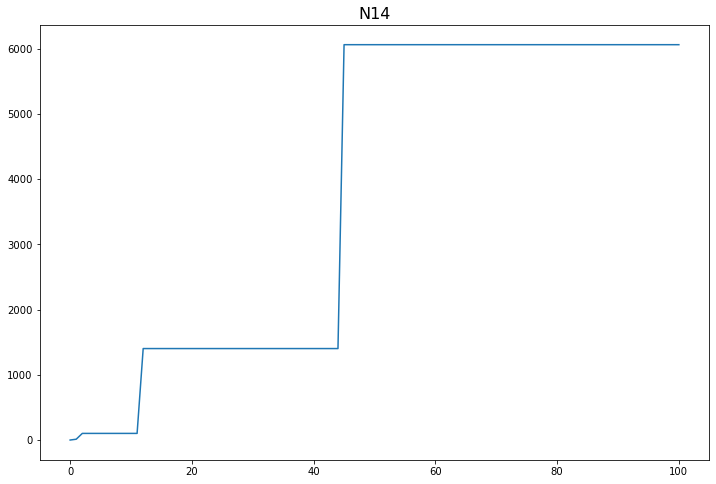

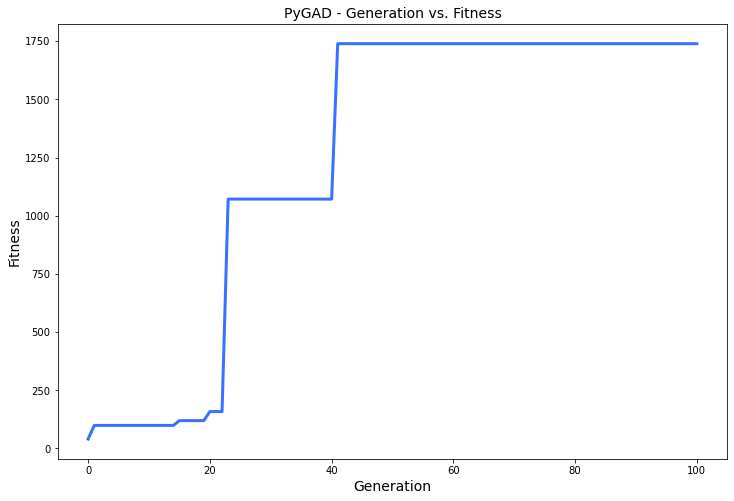

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.826 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.837 |==================| 1.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.682 |==================| 1.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.391 |==================| 28.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 28.211 |==================| 4.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.789 |==================| 2.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 27.496 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 26.261 |==================| 0.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.389 |==================| 15.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 25.808 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 26.497 |==================| 1.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 25.667 |==================| 0.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.438 |==================| 8.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.303 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 26.497 |==================| 1.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 25.667 |==================| 0.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.438 |==================| 8.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.303 |==================| 0.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.706 |==================| 2.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 27.312 |==================| 75.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.793 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.303 |==================| 0.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.706 |==================| 2.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 27.312 |==================| 75.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.793 |==================| 2.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.515 |===========| 25.597 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.974 |==================| 2.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 27.015 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.831 |==================| 1.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.808 |==================| 2.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.228 |==================| 10.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.815 |==================| 2.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.387 |==================| 16.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.832 |==================| 1.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 27.173 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.228 |==================| 10.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.815 |==================| 2.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.387 |==================| 16.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.832 |==================| 1.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 27.173 |==================| 6.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.521 |==================| 5.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.545 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.587 |==================| 1.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 26.925 |==================| 2.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 26.521 |==================| 1.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 27.241 |==================| 11.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 27.243 |==================| 12.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.599 |==================| 3.661 |==========
Generation = 3
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 25.758 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 27.241 |==================| 11.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 27.243 |==================| 12.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.599 |==================| 3.661 |==========
Change = 171.23532357224963
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 25.758 |==================| 0.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.42 |==================| 10.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.759 |==================| 2.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 27.243 |==================| 12.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.599 |==================| 3.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 25.764 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.4 |==================| 13.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.802 |==================| 2.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.378 |==================| 19.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.359 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.09 |==================| 0.809 |==========
Fitness = 247.23163086707305
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 25.764 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.4 |==================| 13.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.802 |==================| 2.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.378 |==================| 19.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.359 |==================| 30.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 25.764 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.4 |==================| 13.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.802 |==================| 2.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.378 |==================| 19.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.359 |==================| 30.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 25.859 |==================| 0.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.493 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.802 |==================| 2.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.782 |==================| 2.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 27.326 |==================| 1573.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.516 |==================| 1.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 25.731 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.898 |==================| 2.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 25.639 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.782 |==================| 2.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 27.326 |==================| 1573.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.516 |==================| 1.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 25.731 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.898 |==================| 2.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 25.639 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.614 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.593 |==================| 1.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.571 |==================| 4.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 25.978 |==================| 0.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.514 |==================| 5.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.804 |==================| 2.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 25.767 |==================| 0.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.701 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 25.978 |==================| 0.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.514 |==================| 5.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.804 |==================| 2.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 25.767 |==================| 0.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.701 |==================| 2.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.726 |==================| 2.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.783 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 25.767 |==================| 0.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.701 |==================| 2.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.726 |==================| 2.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.783 |==================| 2.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.837 |==================| 1.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.37 |==================| 22.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.817 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 26.603 |==================| 1.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 27.737 |==================| 2.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.581 |==================| 3.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.449 |==================| 8.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.811 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.417 |==================| 10.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 27.478 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 27.737 |==================| 2.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.581 |==================| 3.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.449 |==================| 8.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.811 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.417 |==================| 10.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 27.478 |==================| 6.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.781 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 25.845 |==================| 0.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 26.305 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.655 |==================| 3.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.786 |==================| 2.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.433 |==================| 9.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 25.846 |==================| 0.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 26.085 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 26.305 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.655 |==================| 3.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.786 |==================| 2.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.433 |==================| 9.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 25.846 |==================| 0.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 26.085 |==================| 0.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.955 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.655 |==================| 3.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.786 |==================| 2.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.433 |==================| 9.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 25.846 |==================| 0.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 26.085 |==================| 0.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.955 |==================| 2.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.706 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.789 |==================| 2.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.576 |==================| 3.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.618 |==================| 1.414 |==========
Fitness = 1573.1894672729431
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.706 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.443 |==================| 8.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 25.725 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.618 |==================| 1.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.706 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.443 |==================| 8.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 25.725 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 27.309 |==================| 60.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 27.251 |==================| 13.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.521 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.634 |==================| 3.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.839 |==================| 1.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.621 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.7 |==================| 2.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.158 |==================| 5.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.638 |==================| 3.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.064 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.839 |==================| 1.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.621 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.7 |==================| 2.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.158 |==================| 5.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.638 |==================| 3.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.064 |==================| 3.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.748 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.799 |==================| 2.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.609 |==================| 3.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.838 |==================| 1.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 27.24 |==================| 11.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.826 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.152 |==================| 5.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 25.994 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.609 |==================| 3.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.838 |==================| 1.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 27.24 |==================| 11.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.826 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.152 |==================| 5.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 25.994 |==================| 0.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.363 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.838 |==================| 1.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 27.24 |==================| 11.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.826 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.152 |==================| 5.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 25.994 |==================| 0.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.363 |==================| 26.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 26.54 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 26.354 |==================| 1.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 26.998 |==================| 3.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.751 |==================| 2.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.946 |==================| 2.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.668 |==================| 2.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.617 |==================| 3.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 27.233 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 26.998 |==================| 3.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.751 |==================| 2.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.946 |==================| 2.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.668 |==================| 2.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.617 |==================| 3.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 27.233 |==================| 10.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 25.941 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.726 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 27.263 |==================| 15.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 26.23 |==================| 0.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.667 |==================| 2.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.152 |==================| 5.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.226 |==================| 10.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 26.309 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 26.23 |==================| 0.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.667 |==================| 2.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.152 |==================| 5.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.226 |==================| 10.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 26.309 |==================| 0.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.572 |==================| 4.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 25.734 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.226 |==================| 10.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 26.309 |==================| 0.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.572 |==================| 4.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 25.734 |==================| 0.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.332 |==================| 161.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.841 |==================| 1.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.597 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 27.31 |==================| 64.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.683 |==================| 2.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.71 |==================| 2.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.756 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 27.119 |==================| 4.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.591 |==================| 3.766 |==========
Fitness = 1573.1894672729431
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.683 |==================| 2.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.71 |==================| 2.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.756 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 27.119 |==================| 4.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.591 |==================| 3.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.802 |==================| 2.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.486 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.616 |==================| 1.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.618 |==================| 1.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.833 |==================| 1.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.761 |==================| 1.771 |==========
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.506 |==================| 5.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.37 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 25.769 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.618 |==================| 1.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.833 |==================| 1.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.761 |==================| 1.771 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.506 |==================| 5.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.37 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 25.769 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.583 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.833 |==================| 1.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.761 |==================| 1.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.778 |==================| 2.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 25.8 |==================| 0.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 25.695 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.52 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.48 |==================| 6.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.778 |==================| 2.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 25.8 |==================| 0.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 25.695 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.52 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.48 |==================| 6.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.212 |==================| 0.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.37 |==================| 1.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.52 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.48 |==================| 6.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.212 |==================| 0.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.37 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.412 |==================| 11.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.749 |==================| 2.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 27.257 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.046 |==================| 0.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.752 |==================| 2.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.576 |==================| 3.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.257 |==================| 0.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.692 |==================| 2.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.817 |==================| 2.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.476 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.752 |==================| 2.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.576 |==================| 3.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.257 |==================| 0.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.692 |==================| 2.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.817 |==================| 2.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.476 |==================| 6.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 26.185 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.692 |==================| 2.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 27.118 |==================| 4.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.049 |==================| 0.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.744 |==================| 2.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.494 |==================| 5.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.529 |==================| 4.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.472 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.744 |==================| 2.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.494 |==================| 5.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.529 |==================| 4.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.472 |==================| 6.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.705 |==================| 2.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.761 |==================| 2.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.571 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.529 |==================| 4.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.472 |==================| 6.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.705 |==================| 2.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.761 |==================| 2.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.571 |==================| 1.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.806 |==================| 2.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 25.859 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.556 |==================| 1.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 27.114 |==================| 4.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.66 |==================| 2.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 27.326 |==================| 82891.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.61 |==================| 1.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.768 |==================| 2.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.459 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 27.114 |==================| 4.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.66 |==================| 2.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 27.326 |==================| 82891.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.61 |==================| 1.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.768 |==================| 2.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.459 |==================| 7.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.835 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.562 |==================| 4.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.746 |==================| 2.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.967 |==================| 2.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.836 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.506 |==================| 5.539 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.266 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.619 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.746 |==================| 2.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.967 |==================| 2.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.836 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.506 |==================| 5.539 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.266 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.619 |==================| 3.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.66 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.967 |==================| 2.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.836 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.506 |==================| 5.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 26.831 |==================| 2.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.064 |==================| 3.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.358 |==================| 30.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 26.892 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 26.365 |==================| 1.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.823 |==================| 2.012 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 26.831 |==================| 2.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.064 |==================| 3.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.358 |==================| 30.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 26.892 |==================| 2.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 26.831 |==================| 2.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.064 |==================| 3.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.358 |==================| 30.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 26.892 |==================| 2.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.099 |==================| 0.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.818 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.527 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 26.695 |==================| 1.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.838 |==================| 1.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 25.798 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.566 |==================| 1.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.694 |==================| 2.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 27.207 |==================| 8.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 26.137 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.838 |==================| 1.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 25.798 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.566 |==================| 1.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.694 |==================| 2.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 27.207 |==================| 8.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 26.137 |==================| 0.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.157 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.746 |==================| 2.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.371 |==================| 21.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.323 |==================| 345.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.55 |==================| 4.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.772 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.519 |==================| 5.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 26.272 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.371 |==================| 21.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.323 |==================| 345.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.55 |==================| 4.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.772 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.519 |==================| 5.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 26.272 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 27.446 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.323 |==================| 345.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.55 |==================| 4.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.772 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.519 |==================| 5.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 26.272 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 27.446 |==================| 8.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.8 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.76 |==================| 1.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.563 |==================| 4.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.792 |==================| 2.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.877 |==================| 2.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.434 |==================| 9.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.113 |==================| 0.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.801 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.877 |==================| 2.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.434 |==================| 9.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.113 |==================| 0.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.801 |==================| 2.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.991 |==================| 2.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 25.678 |==================| 0.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.799 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.46 |==================| 7.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.19 |==================| 7.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.315 |==================| 98.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.191 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.383 |==================| 17.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.793 |==================| 2.14 |==========
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.761 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.19 |==================| 7.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.315 |==================| 98.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.191 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.383 |==================| 17.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.793 |==================| 2.14 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.761 |==================| 2.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.556 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.315 |==================| 98.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.191 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.383 |==================| 17.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.793 |==================| 2.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 26.153 |==================| 0.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.686 |==================| 1.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 27.594 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.718 |==================| 2.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.362 |==================| 27.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.589 |==================| 3.799 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 26.153 |==================| 0.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.686 |==================| 1.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 27.594 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.362 |==================| 27.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.589 |==================| 3.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 26.153 |==================| 0.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.686 |==================| 1.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 27.594 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 25.829 |==================| 0.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.567 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.825 |==================| 2.002 |==========
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 25.762 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.685 |==================| 2.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.429 |==================| 1.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.43 |==================| 9.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.785 |==================| 2.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.537 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.685 |==================| 2.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.429 |==================| 1.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.43 |==================| 9.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.785 |==================| 2.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.537 |==================| 1.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.694 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 26.465 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.486 |==================| 6.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.322 |==================| 0.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.655 |==================| 3.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.825 |==================| 2.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.703 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 27.771 |==================| 2.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.76 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.322 |==================| 0.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.655 |==================| 3.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.825 |==================| 2.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.703 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 27.771 |==================| 2.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.76 |==================| 2.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.877 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.655 |==================| 3.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.825 |==================| 2.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.703 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 27.771 |==================| 2.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.76 |==================| 2.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.877 |==================| 2.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.662 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 27.673 |==================| 2.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.372 |==================| 21.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.402 |==================| 13.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.621 |==================| 3.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 27.397 |==================| 13.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 26.84 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 25.719 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.372 |==================| 21.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.402 |==================| 13.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.621 |==================| 3.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 27.397 |==================| 13.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 26.84 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 25.719 |==================| 0.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.587 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 26.108 |==================| 0.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 25.828 |==================| 0.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.672 |==================| 2.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.54 |==================| 4.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 26.432 |==================| 1.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.379 |==================| 18.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.76 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.672 |==================| 2.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.54 |==================| 4.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 26.432 |==================| 1.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.379 |==================| 18.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.76 |==================| 2.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.593 |==================| 1.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.411 |==================| 11.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.379 |==================| 18.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.76 |==================| 2.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.593 |==================| 1.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.411 |==================| 11.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 27.145 |==================| 5.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.748 |==================| 2.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 26.874 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.741 |==================| 2.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.234 |==================| 0.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 26.527 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 25.799 |==================| 0.655 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.748 |==================| 2.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 26.874 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.234 |==================| 0.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 26.527 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 25.799 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.748 |==================| 2.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 26.874 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 26.639 |==================| 1.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 26.494 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.454 |==================| 1.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.554 |==================| 4.375 |==========
Generation = 32
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.66 |==================| 2.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.698 |==================| 2.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.412 |==================| 11.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 25.701 |==================| 0.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 27.244 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.554 |==================| 4.375 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.66 |==================| 2.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.698 |==================| 2.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.412 |==================| 11.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 25.701 |==================| 0.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 27.244 |==================| 12.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 26.948 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.764 |==================| 1.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 26.037 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.331 |==================| 188.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.106 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.508 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.573 |==================| 4.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.466 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 26.037 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.331 |==================| 188.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.106 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.508 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.573 |==================| 4.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.466 |==================| 7.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 27.284 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.331 |==================| 188.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.106 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.508 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.573 |==================| 4.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.466 |==================| 7.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 27.284 |==================| 24.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.543 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.075 |==================| 0.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.565 |==================| 4.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.409 |==================| 11.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.84 |==================| 1.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.475 |==================| 6.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.789 |==================| 2.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.805 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.565 |==================| 4.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.409 |==================| 11.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.84 |==================| 1.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.475 |==================| 6.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.789 |==================| 2.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.805 |==================| 1.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.806 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.389 |==================| 15.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.499 |==================| 5.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.694 |==================| 2.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.19 |==================| 0.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 25.807 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.504 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.499 |==================| 5.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.694 |==================| 2.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.19 |==================| 0.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 25.807 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.504 |==================| 5.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.065 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.694 |==================| 2.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.19 |==================| 0.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 25.807 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.504 |==================| 5.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.065 |==================| 3.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.439 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 26.161 |==================| 0.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 27.629 |==================| 3.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.364 |==================| 25.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 26.877 |==================| 2.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.814 |==================| 2.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.497 |==================| 5.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.442 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 27.629 |==================| 3.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.364 |==================| 25.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 26.877 |==================| 2.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.814 |==================| 2.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.497 |==================| 5.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.442 |==================| 8.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.791 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.639 |==================| 3.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.536 |==================| 4.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 26.374 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.821 |==================| 2.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.831 |==================| 1.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.532 |==================| 1.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.232 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.536 |==================| 4.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 26.374 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.821 |==================| 2.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.831 |==================| 1.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.532 |==================| 1.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.232 |==================| 0.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 25.843 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.821 |==================| 2.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.831 |==================| 1.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.532 |==================| 1.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.232 |==================| 0.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 25.843 |==================| 0.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.639 |==================| 3.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.773 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 26.808 |==================| 1.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.172 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.719 |==================| 2.539 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.773 |==================| 2.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.751 |==================| 2.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.635 |==================| 3.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.172 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.719 |==================| 2.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.773 |==================| 2.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.751 |==================| 2.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.635 |==================| 3.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.458 |==================| 7.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 27.558 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 26.424 |==================| 1.11 |==========
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.631 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.722 |==================| 2.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 27.194 |==================| 7.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.819 |==================| 2.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 27.299 |==================| 37.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.429 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.631 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.722 |==================| 2.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 27.194 |==================| 7.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.819 |==================| 2.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 27.299 |==================| 37.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.429 |==================| 9.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.067 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 25.923 |==================| 0.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 26.385 |==================| 1.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.671 |==================| 2.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 25.92 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.756 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.484 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 26.385 |==================| 1.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.671 |==================| 2.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 25.92 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.756 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.484 |==================| 6.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.621 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.671 |==================| 2.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 25.92 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.756 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.484 |==================| 6.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.621 |==================| 3.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.661 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 26.245 |==================| 0.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.68 |==================| 2.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.169 |==================| 0.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.047 |==================| 0.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 26.298 |==================| 0.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.768 |==================| 2.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.4 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.169 |==================| 0.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.047 |==================| 0.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 26.298 |==================| 0.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.768 |==================| 2.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.4 |==================| 13.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.066 |==================| 0.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.795 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.373 |==================| 21.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.524 |==================| 5.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.515 |==================| 5.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 25.958 |==================| 0.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 27.252 |==================| 13.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.2 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.178 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.524 |==================| 5.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.515 |==================| 5.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 25.958 |==================| 0.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 27.252 |==================| 13.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.2 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.178 |==================| 0.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.363 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.515 |==================| 5.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 25.958 |==================| 0.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 27.252 |==================| 13.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.2 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.178 |==================| 0.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.363 |==================| 1.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.672 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 27.126 |==================| 5.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.613 |==================| 1.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 26.0 |==================| 0.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.841 |==================| 1.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.659 |==================| 2.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.901 |==================| 2.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 26.502 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.613 |==================| 1.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 26.0 |==================| 0.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.841 |==================| 1.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.659 |==================| 2.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.901 |==================| 2.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 26.502 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.382 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.811 |==================| 2.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 26.425 |==================| 1.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.374 |==================| 20.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 25.779 |==================| 0.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.808 |==================| 2.075 |==========
Generation = 44
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 26.816 |==================| 1.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 27.043 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 25.779 |==================| 0.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.808 |==================| 2.075 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 26.816 |==================| 1.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 27.043 |==================| 3.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 26.449 |==================| 1.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.559 |==================| 4.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 26.643 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.489 |==================| 6.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 27.07 |==================| 3.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 26.568 |==================| 1.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.732 |==================| 2.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.66 |==================| 1.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 27.277 |==================| 20.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.629 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 26.568 |==================| 1.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.732 |==================| 2.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.66 |==================| 1.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 27.277 |==================| 20.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.629 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 26.528 |==================| 1.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 27.248 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 27.277 |==================| 20.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.629 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 26.528 |==================| 1.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 27.248 |==================| 12.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.536 |==================| 4.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.681 |==================| 2.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.7 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 26.134 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.302 |==================| 0.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 27.271 |==================| 18.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.635 |==================| 3.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.265 |==================| 0.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.514 |==================| 5.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.816 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.635 |==================| 3.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.265 |==================| 0.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.514 |==================| 5.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.816 |==================| 2.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.275 |==================| 19.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.145 |==================| 0.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 25.659 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.57 |==================| 4.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.487 |==================| 1.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.787 |==================| 1.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 25.71 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.145 |==================| 0.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.614 |==================| 1.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.409 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.487 |==================| 1.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.787 |==================| 1.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 25.71 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.145 |==================| 0.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.614 |==================| 1.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.409 |==================| 11.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.336 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.787 |==================| 1.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 25.71 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.145 |==================| 0.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.614 |==================| 1.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.409 |==================| 11.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.336 |==================| 93.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.629 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.487 |==================| 6.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.408 |==================| 12.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.556 |==================| 4.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.811 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.825 |==================| 2.003 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.629 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.408 |==================| 12.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.556 |==================| 4.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.811 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.825 |==================| 2.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.629 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.613 |==================| 3.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.431 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.764 |==================| 2.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.668 |==================| 2.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.204 |==================| 8.216 |==========
Generation = 49
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.208 |==================| 0.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.687 |==================| 1.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 27.34 |==================| 67.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.146 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.668 |==================| 2.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.204 |==================| 8.216 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.208 |==================| 0.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.687 |==================| 1.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 27.34 |==================| 67.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.146 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 26.514 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.204 |==================| 8.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.63 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.787 |==================| 2.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.621 |==================| 3.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.375 |==================| 20.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.699 |==================| 2.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.678 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 25.63 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.787 |==================| 2.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.621 |==================| 3.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.375 |==================| 20.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.699 |==================| 2.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.678 |==================| 2.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 25.982 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.621 |==================| 3.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.375 |==================| 20.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.699 |==================| 2.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.678 |==================| 2.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 25.982 |==================| 0.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 25.93 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.541 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.791 |==================| 2.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.363 |==================| 26.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.827 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.53 |==================| 4.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.569 |==================| 4.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 26.374 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.888 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.827 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.53 |==================| 4.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.569 |==================| 4.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 26.374 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.888 |==================| 2.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 27.073 |==================| 3.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.749 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.374 |==================| 20.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 25.852 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.797 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 25.676 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.827 |==================| 1.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.731 |==================| 2.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.496 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 25.852 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.797 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 25.676 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.827 |==================| 1.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.731 |==================| 2.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.496 |==================| 5.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.508 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.797 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 25.676 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.827 |==================| 1.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.731 |==================| 2.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.496 |==================| 5.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.508 |==================| 5.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.452 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.249 |==================| 13.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.319 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.685 |==================| 2.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.333 |==================| 127.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.747 |==================| 1.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.637 |==================| 3.211 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.319 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.685 |==================| 2.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.333 |==================| 127.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.747 |==================| 1.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.637 |==================| 3.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 26.007 |==================| 0.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.175 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.77 |==================| 2.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.438 |==================| 8.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.903 |==================| 2.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.475 |==================| 6.698 |==========
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 26.608 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.49 |==================| 6.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.673 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.438 |==================| 8.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.903 |==================| 2.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.475 |==================| 6.698 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 26.608 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.49 |==================| 6.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.673 |==================| 1.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.742 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.903 |==================| 2.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.475 |==================| 6.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 27.132 |==================| 5.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.793 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.39 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 26.239 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.516 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.412 |==================| 11.514 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 27.132 |==================| 5.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.793 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.39 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 26.239 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.516 |==================| 1.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.793 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.39 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 26.239 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.516 |==================| 1.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.967 |==================| 2.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.667 |==================| 1.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 25.946 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.279 |==================| 21.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.25 |==================| 13.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 25.824 |==================| 0.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.722 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.373 |==================| 21.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 26.671 |==================| 1.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.417 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.25 |==================| 13.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 25.824 |==================| 0.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.722 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.373 |==================| 21.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 26.671 |==================| 1.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.417 |==================| 10.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 26.742 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.8 |==================| 1.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.159 |==================| 6.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 25.852 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.788 |==================| 2.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.586 |==================| 3.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.632 |==================| 3.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.012 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.159 |==================| 6.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 25.852 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.788 |==================| 2.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.586 |==================| 3.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.632 |==================| 3.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.012 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.725 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 25.852 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.788 |==================| 2.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.586 |==================| 3.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.632 |==================| 3.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.012 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.725 |==================| 2.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.706 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.739 |==================| 2.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.138 |==================| 5.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 26.194 |==================| 0.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.952 |==================| 2.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.561 |==================| 4.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 26.159 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.678 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.138 |==================| 5.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 26.194 |==================| 0.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.952 |==================| 2.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.561 |==================| 4.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 26.159 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.678 |==================| 2.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.692 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 26.207 |==================| 0.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 26.207 |==================| 0.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.791 |==================| 2.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.783 |==================| 2.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.17 |==================| 0.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.416 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 26.354 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.783 |==================| 2.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.17 |==================| 0.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.416 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 26.354 |==================| 1.029 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 27.702 |==================| 2.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.348 |==================| 45.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.6 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.17 |==================| 0.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.416 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 26.354 |==================| 1.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.695 |==================| 2.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.838 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.586 |==================| 3.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.66 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 26.087 |==================| 0.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 27.185 |==================| 7.118 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.695 |==================| 2.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.838 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.586 |==================| 3.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.66 |==================| 2.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 27.185 |==================| 7.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.695 |==================| 2.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.838 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.586 |==================| 3.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.66 |==================| 2.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 27.065 |==================| 3.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.666 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 26.454 |==================| 1.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.592 |==================| 3.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.681 |==================| 2.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.371 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.573 |==================| 4.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.821 |==================| 2.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.619 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.592 |==================| 3.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.681 |==================| 2.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.371 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.573 |==================| 4.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.821 |==================| 2.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.619 |==================| 3.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 27.08 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.605 |==================| 3.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.043 |==================| 0.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.442 |==================| 8.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.47 |==================| 6.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.529 |==================| 4.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 26.316 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.209 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.442 |==================| 8.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.47 |==================| 6.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.529 |==================| 4.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 26.316 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.209 |==================| 0.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 25.772 |==================| 0.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 25.945 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.47 |==================| 6.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.529 |==================| 4.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 26.316 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.209 |==================| 0.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 25.772 |==================| 0.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 25.945 |==================| 0.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 26.4 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 27.219 |==================| 9.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 27.224 |==================| 9.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.716 |==================| 2.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.42 |==================| 10.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 26.465 |==================| 1.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.445 |==================| 8.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.531 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 27.224 |==================| 9.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.716 |==================| 2.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.42 |==================| 10.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 26.465 |==================| 1.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.445 |==================| 8.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.531 |==================| 1.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 25.816 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.764 |==================| 2.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.606 |==================| 3.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.811 |==================| 1.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.332 |==================| 155.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.972 |==================| 2.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 27.212 |==================| 8.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.726 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.606 |==================| 3.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.811 |==================| 1.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.332 |==================| 155.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.972 |==================| 2.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 27.212 |==================| 8.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.726 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.274 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.811 |==================| 1.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.332 |==================| 155.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.972 |==================| 2.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 27.212 |==================| 8.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.726 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.274 |==================| 19.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 26.788 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 26.832 |==================| 2.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.408 |==================| 12.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 26.752 |==================| 1.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.596 |==================| 1.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.399 |==================| 13.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 27.107 |==================| 4.578 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.408 |==================| 12.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 26.752 |==================| 1.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.596 |==================| 1.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.399 |==================| 13.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 27.107 |==================| 4.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.77 |==================| 1.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.7 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.547 |==================| 4.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.839 |==================| 1.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 27.479 |==================| 6.502 |==========
Generation = 66
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 27.165 |==================| 6.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 26.467 |==================| 1.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 26.22 |==================| 0.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.769 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 27.165 |==================| 6.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 26.467 |==================| 1.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 26.22 |==================| 0.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.769 |==================| 2.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.609 |==================| 1.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.662 |==================| 2.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 27.784 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.719 |==================| 2.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.515 |==================| 5.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.465 |==================| 7.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 26.693 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 27.307 |==================| 54.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.633 |==================| 3.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.338 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.515 |==================| 5.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.465 |==================| 7.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 26.693 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 27.307 |==================| 54.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.633 |==================| 3.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.338 |==================| 76.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 26.917 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 26.693 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 27.307 |==================| 54.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.633 |==================| 3.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.338 |==================| 76.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 26.917 |==================| 2.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.579 |==================| 3.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 25.991 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.683 |==================| 2.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.633 |==================| 3.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.457 |==================| 7.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.521 |==================| 5.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.031 |==================| 0.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 26.128 |==================| 0.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 27.183 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.633 |==================| 3.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.457 |==================| 7.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.521 |==================| 5.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.031 |==================| 0.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 26.128 |==================| 0.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 27.183 |==================| 7.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.627 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.654 |==================| 3.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.768 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.665 |==================| 2.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 25.77 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 25.91 |==================| 0.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.644 |==================| 3.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.966 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.768 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.665 |==================| 2.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 25.77 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 25.91 |==================| 0.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.644 |==================| 3.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.966 |==================| 2.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.763 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.665 |==================| 2.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 25.77 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 25.91 |==================| 0.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.644 |==================| 3.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.966 |==================| 2.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.763 |==================| 2.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.845 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.647 |==================| 3.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 26.406 |==================| 1.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 27.512 |==================| 5.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.57 |==================| 4.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.692 |==================| 2.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.087 |==================| 4.187 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.57 |==================| 4.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.692 |==================| 2.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.087 |==================| 4.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.619 |==================| 3.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 27.361 |==================| 27.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.164 |==================| 0.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 27.066 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 26.158 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.683 |==================| 2.794 |==========
Generation = 71
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.584 |==================| 3.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.547 |==================| 4.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 26.263 |==================| 0.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.159 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.767 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.683 |==================| 2.794 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.584 |==================| 3.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.547 |==================| 4.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 26.263 |==================| 0.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.159 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.767 |==================| 2.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 27.005 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.043 |==================| 0.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.613 |==================| 3.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.4 |==================| 13.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 26.366 |==================| 1.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.707 |==================| 2.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 26.441 |==================| 1.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.6 |==================| 3.6

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.613 |==================| 3.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.4 |==================| 13.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 26.366 |==================| 1.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.707 |==================| 2.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 26.441 |==================| 1.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.6 |==================| 3.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.344 |==================| 5

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.4 |==================| 13.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 26.366 |==================| 1.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.707 |==================| 2.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 26.441 |==================| 1.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.6 |==================| 3.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.344 |==================| 53.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.585 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.485 |==================| 1.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.525 |==================| 5.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.824 |==================| 2.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.942 |==================| 2.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 26.401 |==================| 1.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.793 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.143 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.824 |==================| 2.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.942 |==================| 2.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 26.401 |==================| 1.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.793 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.143 |==================| 0.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.392 |==================| 15.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 25.642 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.538 |==================| 4.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 25.763 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.489 |==================| 6.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.736 |==================| 2.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.774 |==================| 2.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.584 |==================| 3.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.823 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 25.763 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.489 |==================| 6.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.736 |==================| 2.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.774 |==================| 2.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.584 |==================| 3.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.823 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.276 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.489 |==================| 6.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.736 |==================| 2.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.774 |==================| 2.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.584 |==================| 3.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.823 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.276 |==================| 0.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.555 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 25.923 |==================| 0.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.735 |==================| 2.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.497 |==================| 5.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.19 |==================| 0.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.628 |==================| 3.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.294 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.567 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.735 |==================| 2.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.497 |==================| 5.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.19 |==================| 0.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.628 |==================| 3.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.294 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.567 |==================| 1.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 27.203 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.247 |==================| 0.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.336 |==================| 93.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.633 |==================| 3.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.023 |==================| 3.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.828 |==================| 1.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.047 |==================| 0.782 |==========
Generation = 76
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 27.427 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.336 |==================| 93.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.633 |==================| 3.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.023 |==================| 3.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.828 |==================| 1.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.047 |==================| 0.782 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 27.427 |==================| 9.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.36 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.633 |==================| 3.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.023 |==================| 3.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.828 |==================| 1.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.047 |==================| 0.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 25.642 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.725 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.807 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 27.303 |==================| 44.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.439 |==================| 8.84 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 25.642 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.725 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.807 |==================| 2.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.661 |==================| 2.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.725 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.807 |==================| 2.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.661 |==================| 2.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.441 |==================| 8.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.434 |==================| 9.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 26.146 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 27.031 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.492 |==================| 6.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.696 |==================| 2.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 25.651 |==================| 0.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.581 |==================| 3.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.82 |==================| 2.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 27.078 |==================| 4.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.75 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.696 |==================| 2.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 25.651 |==================| 0.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.581 |==================| 3.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.82 |==================| 2.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 27.078 |==================| 4.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.75 |==================| 2.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 27.511 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.741 |==================| 1.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.613 |==================| 1.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.481 |==================| 6.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.513 |==================| 5.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.593 |==================| 1.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.55 |==================| 4.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 26.602 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.613 |==================| 1.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.481 |==================| 6.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.513 |==================| 5.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.593 |==================| 1.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.55 |==================| 4.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 26.602 |==================| 1.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.079 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.481 |==================| 6.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.513 |==================| 5.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.593 |==================| 1.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.55 |==================| 4.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 26.602 |==================| 1.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.079 |==================| 0.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.482 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.395 |==================| 14.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 25.955 |==================| 0.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.639 |==================| 3.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.636 |==================| 3.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.798 |==================| 2.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.883 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 26.26 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 25.955 |==================| 0.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.639 |==================| 3.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.636 |==================| 3.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.798 |==================| 2.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.883 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 26.26 |==================| 0.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 25.989 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 27.025 |==================| 3.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.786 |==================| 2.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 25.784 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.765 |==================| 1.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 26.468 |==================| 1.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 25.888 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.596 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.786 |==================| 2.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 25.784 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.765 |==================| 1.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 26.468 |==================| 1.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 25.888 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.596 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 26.86 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 25.784 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.765 |==================| 1.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 26.468 |==================| 1.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 25.888 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.596 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 26.86 |==================| 2.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 26.944 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.683 |==================| 1.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.528 |==================| 4.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 27.182 |==================| 6.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 27.144 |==================| 5.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 27.351 |==================| 39.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.722 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.661 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.528 |==================| 4.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 27.182 |==================| 6.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 27.144 |==================| 5.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 27.351 |==================| 39.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.722 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.661 |==================| 2.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.058 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.807 |==================| 2.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.472 |==================| 1.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.821 |==================| 2.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.336 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.504 |==================| 5.603 |==========
Generation = 83
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.687 |==================| 1.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.488 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.472 |==================| 1.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.821 |==================| 2.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.336 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.504 |==================| 5.603 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.687 |==================| 1.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.488 |==================| 6.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.729 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.821 |==================| 2.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.336 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.504 |==================| 5.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.072 |==================| 0.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 26.002 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.576 |==================| 3.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.475 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.356 |==================| 32.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.463 |==================| 7.288 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.072 |==================| 0.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 26.002 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.576 |==================| 3.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.475 |==================| 6.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.463 |==================| 7.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.072 |==================| 0.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 26.002 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.576 |==================| 3.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.475 |==================| 6.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 27.13 |==================| 5.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.569 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.363 |==================| 26.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.506 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.559 |==================| 4.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.584 |==================| 3.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 25.784 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.68 |==================| 2.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.755 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.559 |==================| 4.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.584 |==================| 3.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 25.784 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.68 |==================| 2.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.755 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.786 |==================| 2.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.871 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.59 |==================| 3.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.686 |==================| 1.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.204 |==================| 8.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 26.917 |==================| 2.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.615 |==================| 3.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.684 |==================| 2.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 26.849 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.686 |==================| 1.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.204 |==================| 8.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 26.917 |==================| 2.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.615 |==================| 3.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.684 |==================| 2.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 26.849 |==================| 2.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.594 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.204 |==================| 8.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 26.917 |==================| 2.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.615 |==================| 3.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.684 |==================| 2.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 26.849 |==================| 2.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.594 |==================| 1.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.044 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.505 |==================| 5.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.493 |==================| 5.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.145 |==================| 0.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 26.567 |==================| 1.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.746 |==================| 2.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.748 |==================| 2.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.805 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.493 |==================| 5.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.145 |==================| 0.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 26.567 |==================| 1.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.746 |==================| 2.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.748 |==================| 2.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.805 |==================| 2.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.866 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.983 |==================| 2.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.585 |==================| 3.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.895 |==================| 2.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 25.892 |==================| 0.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.141 |==================| 0.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.662 |==================| 2.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.799 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 25.892 |==================| 0.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.141 |==================| 0.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.662 |==================| 2.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.799 |==================| 2.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.516 |==================| 5.244 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.686 |==================| 1.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.701 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.141 |==================| 0.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.662 |==================| 2.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.799 |==================| 2.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.516 |==================| 5.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.788 |==================| 2.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.529 |==================| 4.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.758 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.268 |==================| 0.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.815 |==================| 2.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.472 |==================| 6.829 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.788 |==================| 2.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.529 |==================| 4.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.758 |==================| 2.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.815 |==================| 2.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.472 |==================| 6.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.788 |==================| 2.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.529 |==================| 4.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.758 |==================| 2.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 27.258 |==================| 14.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 26.604 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.624 |==================| 3.346 |==========
Generation = 90
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.099 |==================| 4.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.781 |==================| 2.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.388 |==================| 16.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.456 |==================| 7.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.425 |==================| 10.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.042 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.099 |==================| 4.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.781 |==================| 2.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.388 |==================| 16.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.456 |==================| 7.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.425 |==================| 10.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.042 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.581 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.466 |==================| 7.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.993 |==================| 3.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.676 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.571 |==================| 4.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.536 |==================| 4.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.777 |==================| 2.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 25.804 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.993 |==================| 3.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.676 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.571 |==================| 4.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.536 |==================| 4.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.777 |==================| 2.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 25.804 |==================| 0.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 25.657 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.676 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.571 |==================| 4.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.536 |==================| 4.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.777 |==================| 2.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 25.804 |==================| 0.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 25.657 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.407 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 27.015 |==================| 3.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.961 |==================| 2.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.591 |==================| 1.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 25.964 |==================| 0.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 27.167 |==================| 6.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.445 |==================| 8.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.796 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.961 |==================| 2.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.591 |==================| 1.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 25.964 |==================| 0.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 27.167 |==================| 6.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.445 |==================| 8.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.796 |==================| 2.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.512 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 25.664 |==================| 0.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.426 |==================| 9.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.641 |==================| 3.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.094 |==================| 4.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.159 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.013 |==================| 3.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.346 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.426 |==================| 9.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.641 |==================| 3.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.094 |==================| 4.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.159 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.013 |==================| 3.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.346 |==================| 48.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.71 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.641 |==================| 3.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.094 |==================| 4.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.159 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.013 |==================| 3.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.346 |==================| 48.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.71 |==================| 2.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.534 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.072 |==================| 0.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.36 |==================| 29.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 26.115 |==================| 0.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.659 |==================| 1.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.751 |==================| 2.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 25.707 |==================| 0.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.677 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.36 |==================| 29.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 26.115 |==================| 0.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.659 |==================| 1.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.751 |==================| 2.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 25.707 |==================| 0.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.677 |==================| 2.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.768 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.579 |==================| 3.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.69 |==================| 2.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.697 |==================| 1.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 27.078 |==================| 4.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 27.342 |==================| 62.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 25.896 |==================| 0.7 |==========
Generation = 95
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.514 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.697 |==================| 1.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 27.078 |==================| 4.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 27.342 |==================| 62.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 25.896 |==================| 0.7 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.514 |==================| 5.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.708 |==================| 1.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.568 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 27.078 |==================| 4.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 27.342 |==================| 62.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 25.896 |==================| 0.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 26.896 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.289 |==================| 27.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.284 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.439 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 26.623 |==================| 1.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 26.238 |==================| 0.92 |==========
Fitness = 82891.65913501711
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 26.896 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.289 |==================| 27.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.284 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.439 |==================| 8.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 26.238 |==================| 0.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 26.896 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.289 |==================| 27.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.284 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.439 |==================| 8.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.566 |==================| 4.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.545 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.648 |==================| 3.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.378 |==================| 19.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.414 |==================| 11.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.796 |==================| 1.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 26.146 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 27.511 |==================| 5.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 26.935 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.378 |==================| 19.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.414 |==================| 11.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.796 |==================| 1.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 26.146 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 27.511 |==================| 5.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 26.935 |==================| 2.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 26.391 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.689 |==================| 2.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.637 |==================| 1.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.526 |==================| 4.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.331 |==================| 178.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 26.54 |==================| 1.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.275 |==================| 19.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.055 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.637 |==================| 1.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.526 |==================| 4.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.331 |==================| 178.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 26.54 |==================| 1.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.275 |==================| 19.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.055 |==================| 0.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 26.391 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.526 |==================| 4.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.331 |==================| 178.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 26.54 |==================| 1.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.275 |==================| 19.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.055 |==================| 0.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 26.391 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.651 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.151 |==================| 5.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.633 |==================| 1.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.631 |==================| 3.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.676 |==================| 2.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.08 |==================| 0.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.755 |==================| 2.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.066 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.633 |==================| 1.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.631 |==================| 3.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.676 |==================| 2.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.08 |==================| 0.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.755 |==================| 2.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.066 |==================| 0.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.719 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.434 |==================| 9.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 25.874 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.715 |==================| 2.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.057 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 26.229 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 25.94 |==================| 0.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.598 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 25.874 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.715 |==================| 2.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.057 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 26.229 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 25.94 |==================| 0.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.598 |==================| 3.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.492 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.057 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 26.229 |==================| 0.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 25.94 |==================| 0.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.598 |==================| 3.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.492 |==================| 6.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.589 |==================| 3.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.376 |==================

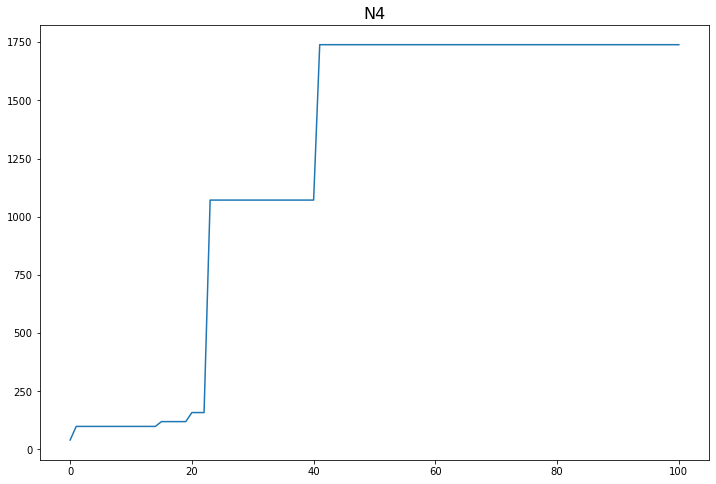

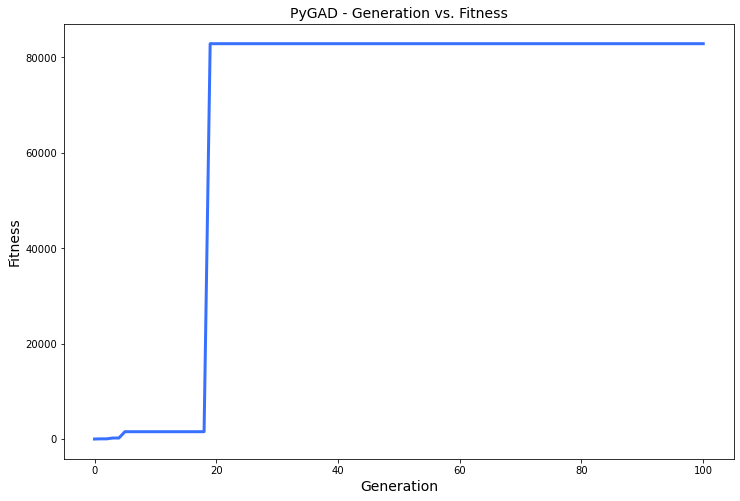

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 26.244 |==================| 0.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.379 |==================| 18.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 26.281 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.795 |==================| 2.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.655 |==================| 3.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.405 |==================| 12.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.575 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.405 |==================| 1.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.504 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.865 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 20.946 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 21.166 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 21.156 |==================| 0.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.232 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.865 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 20.946 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 21.166 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 21.156 |==================| 0.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.232 |==================| 1.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 22.828 |==================| 1.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.658 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 20.946 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 21.166 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 21.156 |==================| 0.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.232 |==================| 1.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 22.828 |==================| 1.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.658 |==================| 9.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.049 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.174 |==================| 2.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.726 |==================| 5.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.311 |==================| 1.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.571 |==================| 0.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.005 |==================| 2.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 22.688 |==================| 1.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.118 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.726 |==================| 5.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.311 |==================| 1.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.571 |==================| 0.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.005 |==================| 2.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 22.688 |==================| 1.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.118 |==================| 1.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 21.436 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 21.34 |==================| 0.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 22.804 |==================| 1.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.573 |==================| 0.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 23.148 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.029 |==================| 2.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.863 |==================| 3.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 21.595 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 22.804 |==================| 1.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.573 |==================| 0.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 23.148 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.029 |==================| 2.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.863 |==================| 3.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 21.595 |==================| 0.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.306 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.573 |==================| 0.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 23.148 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.029 |==================| 2.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.863 |==================| 3.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 21.595 |==================| 0.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.306 |==================| 1.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.113 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.727 |==================| 5.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.558 |==================| 106.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 21.014 |==================| 0.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.465 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 21.352 |==================| 0.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.032 |==================| 2.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 23.007 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.558 |==================| 106.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 21.014 |==================| 0.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.465 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 21.352 |==================| 0.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.032 |==================| 2.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 23.007 |==================| 1.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.626 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.377 |==================| 1.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 22.659 |==================| 1.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.727 |==================| 5.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.611 |==================| 16.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 22.352 |==================| 0.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.519 |==================| 1.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.144 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 22.659 |==================| 1.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.727 |==================| 5.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.611 |==================| 16.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 22.352 |==================| 0.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.519 |==================| 1.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.144 |==================| 2.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 22.211 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.727 |==================| 5.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.611 |==================| 16.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 22.352 |==================| 0.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.519 |==================| 1.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.144 |==================| 2.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 22.211 |==================| 0.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.016 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 21.206 |==================| 0.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 22.078 |==================| 0.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 22.662 |==================| 1.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.081 |==================| 2.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 21.982 |==================| 0.638 |==========
Fitness = 131.9217410118206
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.016 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 22.078 |==================| 0.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 22.662 |==================| 1.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.081 |==================| 2.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 21.982 |==================| 0.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.016 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.86 |==================| 3.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 22.06 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 23.788 |==================| 4.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 22.804 |==================| 1.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.185 |==================| 1.571 |==========
Generation = 7
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.365 |==================| 5.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.201 |==================| 1.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.521 |==================| 36.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 20.977 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 22.804 |==================| 1.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.185 |==================| 1.571 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.365 |==================| 5.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.201 |==================| 1.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.521 |==================| 36.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 20.977 |==================| 0.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.01 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 21.841 |==================| 0.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.922 |==================| 2.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.547 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 21.697 |==================| 0.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.63 |==================| 12.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.794 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 21.983 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.922 |==================| 2.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.547 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 21.697 |==================| 0.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.63 |==================| 12.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.794 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 21.983 |==================| 0.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.563 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.63 |==================| 12.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.794 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 21.983 |==================| 0.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.563 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.306 |==================| 4.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 22.076 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.483 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.614 |==================| 15.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.857 |==================| 3.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 20.965 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.304 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.198 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.864 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 22.618 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.857 |==================| 3.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 20.965 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.304 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.198 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.864 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 22.618 |==================| 1.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 21.299 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.155 |==================| 2.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.106 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 22.824 |==================| 1.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.573 |==================| 41.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.003 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.144 |==================| 1.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.2 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.573 |==================| 41.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.003 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.144 |==================| 1.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.2 |==================| 2.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.611 |==================| 16.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.446 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 21.364 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.003 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.144 |==================| 1.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.2 |==================| 2.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.611 |==================| 16.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.446 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 21.364 |==================| 0.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 22.224 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 22.783 |==================| 1.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 22.431 |==================| 0.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.737 |==================| 5.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 23.82 |==================| 3.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.642 |==================| 10.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 21.82 |==================| 0.578 |==========
Fitness = 131.9217410118206
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 22.431 |==================| 0.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.737 |==================| 5.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 23.82 |==================| 3.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.642 |==================| 10.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 21.82 |==================| 0.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.437 |==================| 1.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 23.889 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.295 |==================| 1.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 22.587 |==================| 1.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.736 |==================| 5.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.073 |==================| 1.91 |==========
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 22.826 |==================| 1.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 22.641 |==================| 1.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.006 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 22.587 |==================| 1.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.736 |==================| 5.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.073 |==================| 1.91 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 22.826 |==================| 1.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 22.641 |==================| 1.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.006 |==================| 2.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 21.487 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.736 |==================| 5.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.073 |==================| 1.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 22.19 |==================| 0.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 22.668 |==================| 1.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 21.595 |==================| 0.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 22.872 |==================| 1.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.607 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.294 |==================| 1.342 |==========
Fitness = 131.9217410118206
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 22.19 |==================| 0.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 22.668 |==================| 1.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 21.595 |==================| 0.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 22.872 |==================| 1.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.607 |==================| 17.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 22.19 |==================| 0.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 22.668 |==================| 1.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 21.595 |==================| 0.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 22.872 |==================| 1.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.607 |==================| 17.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 22.18 |==================| 0.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 22.035 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 22.169 |==================| 0.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.504 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 23.941 |==================| 2.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.219 |==================| 1.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 23.942 |==================| 2.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.182 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 22.108 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.504 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 23.941 |==================| 2.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.219 |==================| 1.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 23.942 |==================| 2.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.182 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 22.108 |==================| 0.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.3 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.252 |==================| 1.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 22.899 |==================| 1.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.259 |==================| 1.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.626 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.001 |==================| 2.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.558 |==================| 109.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 23.685 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 22.899 |==================| 1.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.259 |==================| 1.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.626 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.001 |==================| 2.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.558 |==================| 109.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 23.685 |==================| 7.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.686 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.259 |==================| 1.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.626 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.001 |==================| 2.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.558 |==================| 109.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 23.685 |==================| 7.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.686 |==================| 7.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.132 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.055 |==================| 1.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.317 |==================| 1.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.467 |==================| 1.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.187 |==================| 1.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 22.917 |==================| 1.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 23.838 |==================| 3.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 23.745 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.317 |==================| 1.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.467 |==================| 1.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.187 |==================| 1.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 22.917 |==================| 1.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 23.838 |==================| 3.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 23.745 |==================| 5.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.544 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 22.762 |==================| 1.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.352 |==================| 1.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 22.16 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 23.236 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.066 |==================| 1.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.308 |==================| 0.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 21.594 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.352 |==================| 1.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 22.16 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 23.236 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.066 |==================| 1.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.308 |==================| 0.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 21.594 |==================| 0.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 23.257 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 22.16 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 23.236 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.066 |==================| 1.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.308 |==================| 0.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 21.594 |==================| 0.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 23.257 |==================| 3.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.661 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.368 |==================| 1.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.497 |==================| 1.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.226 |==================| 1.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.289 |==================| 1.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.353 |==================| 5.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.238 |==================| 1.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 22.306 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.497 |==================| 1.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.226 |==================| 1.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.289 |==================| 1.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.353 |==================| 5.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.238 |==================| 1.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 22.306 |==================| 0.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.127 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.089 |==================| 1.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.125 |==================| 1.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.342 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.249 |==================| 1.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.569 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 22.857 |==================| 1.445 |==========
Generation = 19
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 22.969 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.125 |==================| 1.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.342 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.249 |==================| 1.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.569 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 22.857 |==================| 1.445 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 22.969 |==================| 1.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.894 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.342 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.249 |==================| 1.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.569 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 22.857 |==================| 1.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.738 |==================| 5.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.872 |==================| 3.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 22.856 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.35 |==================| 1.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 23.717 |==================| 5.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.488 |==================| 16.3 |==========
Fitness = 131.9217410118206
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.738 |==================| 5.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.872 |==================| 3.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 22.856 |==================| 1.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 23.717 |==================| 5.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.488 |==================| 16.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.738 |==================| 5.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.872 |==================| 3.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 22.856 |==================| 1.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.081 |==================| 2.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.46 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 22.053 |==================| 0.668 |==========
Generation = 21
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.402 |==================| 1.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 20.992 |==================| 0.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.542 |==================| 1.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 23.723 |==================| 5.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.644 |==================| 10.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.204 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.402 |==================| 1.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 20.992 |==================| 0.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.542 |==================| 1.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 23.723 |==================| 5.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.644 |==================| 10.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.204 |==================| 1.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 21.89 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.505 |==================| 1.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 22.558 |==================| 1.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.72 |==================| 5.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.145 |==================| 2.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.182 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 23.903 |==================| 2.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 20.984 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 22.558 |==================| 1.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.72 |==================| 5.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.145 |==================| 2.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.182 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 23.903 |==================| 2.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 20.984 |==================| 0.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.019 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.182 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 23.903 |==================| 2.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 20.984 |==================| 0.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.019 |==================| 2.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 23.805 |==================| 3.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 22.811 |==================| 1.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.432 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.313 |==================| 1.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 22.037 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 23.633 |==================| 11.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 22.256 |==================| 0.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 22.392 |==================| 0.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 23.51 |==================| 25.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.482 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 22.037 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 23.633 |==================| 11.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 22.256 |==================| 0.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 22.392 |==================| 0.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 23.51 |==================| 25.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.482 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.172 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.37 |==================| 1.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.748 |==================| 5.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 21.401 |==================| 0.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 23.06 |==================| 2.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.361 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.037 |==================| 2.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 23.67 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.748 |==================| 5.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 21.401 |==================| 0.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 23.06 |==================| 2.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.361 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.037 |==================| 2.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 23.67 |==================| 8.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 23.767 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 21.401 |==================| 0.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 23.06 |==================| 2.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.361 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.037 |==================| 2.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 23.67 |==================| 8.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 23.767 |==================| 4.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 23.566 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.316 |==================| 1.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.433 |==================| 1.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 22.223 |==================| 0.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 23.69 |==================| 7.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 22.731 |==================| 1.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.364 |==================| 1.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 22.603 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.433 |==================| 1.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 22.223 |==================| 0.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 23.69 |==================| 7.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 22.731 |==================| 1.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.364 |==================| 1.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 22.603 |==================| 1.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 22.69 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.726 |==================| 5.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 23.806 |==================| 3.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 21.249 |==================| 0.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.374 |==================| 1.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 22.53 |==================| 0.981 |==========
Generation = 26
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.493 |==================| 1.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.787 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 23.806 |==================| 3.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 21.249 |==================| 0.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.374 |==================| 1.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 22.53 |==================| 0.981 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.493 |==================| 1.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.787 |==================| 1.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 22.179 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 22.53 |==================| 0.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 23.618 |==================| 14.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 21.305 |==================| 0.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.31 |==================| 0.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 21.178 |==================| 0.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 22.63 |==================| 1.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.368 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.31 |==================| 0.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 21.178 |==================| 0.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 22.63 |==================| 1.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.368 |==================| 1.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.478 |==================| 1.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.721 |==================| 5.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 21.376 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.368 |==================| 1.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.478 |==================| 1.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.721 |==================| 5.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 21.376 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 20.924 |==================| 0.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.224 |==================| 1.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 20.948 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.454 |==================| 1.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 22.768 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.11 |==================| 1.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 21.558 |==================| 0.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 22.844 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 22.538 |==================| 0.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 23.414 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 22.768 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.11 |==================| 1.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 21.558 |==================| 0.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 22.844 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 22.538 |==================| 0.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 23.414 |==================| 7.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.174 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 23.415 |==================| 7.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 23.779 |==================| 4.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.068 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.549 |==================| 4493.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.383 |==================| 1.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 21.958 |==================| 0.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 21.824 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.068 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.549 |==================| 4493.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.383 |==================| 1.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 21.958 |==================| 0.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 21.824 |==================| 0.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 21.956 |==================| 0.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.991 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.383 |==================| 1.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 21.958 |==================| 0.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 21.824 |==================| 0.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 21.956 |==================| 0.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.991 |==================| 2.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.576 |==================| 37.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.578 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 23.681 |==================| 7.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.268 |==================| 1.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.49 |==================| 17.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.865 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.429 |==================| 1.136 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.578 |==================| 34.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.268 |==================| 1.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.49 |==================| 17.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.865 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.429 |==================| 1.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.578 |==================| 34.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 22.537 |==================| 0.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 22.857 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.284 |==================| 1.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.278 |==================| 1.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 23.304 |==================| 4.085 |==========
Generation = 31
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 21.36 |==================| 0.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.59 |==================| 24.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.86 |==================| 3.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.012 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.278 |==================| 1.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 23.304 |==================| 4.085 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 21.36 |==================| 0.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.59 |==================| 24.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.86 |==================| 3.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.012 |==================| 2.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.519 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 23.304 |==================| 4.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 23.797 |==================| 4.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.729 |==================| 5.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.294 |==================| 1.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 21.601 |==================| 0.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 22.575 |==================| 1.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 21.59 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 23.797 |==================| 4.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.729 |==================| 5.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.294 |==================| 1.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 21.601 |==================| 0.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 22.575 |==================| 1.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 21.59 |==================| 0.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.278 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.729 |==================| 5.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.294 |==================| 1.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 21.601 |==================| 0.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 22.575 |==================| 1.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 21.59 |==================| 0.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.278 |==================| 1.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 22.348 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.05 |==================| 2.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 21.139 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 23.603 |==================| 18.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.564 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.029 |==================| 2.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.307 |==================| 4.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 21.828 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 21.139 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 23.603 |==================| 18.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.564 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.029 |==================| 2.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.307 |==================| 4.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 21.828 |==================| 0.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 23.961 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.049 |==================| 2.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.594 |==================| 21.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.854 |==================| 3.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.474 |==================| 1.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 23.186 |==================| 2.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 21.224 |==================| 0.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 22.64 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.594 |==================| 21.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.854 |==================| 3.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.474 |==================| 1.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 23.186 |==================| 2.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 21.224 |==================| 0.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 22.64 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.374 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.854 |==================| 3.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.474 |==================| 1.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 23.186 |==================| 2.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 21.224 |==================| 0.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 22.64 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.374 |==================| 1.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.177 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 23.752 |==================| 4.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.568 |==================| 0.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.626 |==================| 12.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.758 |==================| 4.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.15 |==================| 2.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 22.547 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 22.724 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.758 |==================| 4.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.15 |==================| 2.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 22.547 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 22.724 |==================| 1.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 21.848 |==================| 0.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 23.609 |==================| 16.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 23.808 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 21.242 |==================| 0.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 22.008 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.595 |==================| 21.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 21.821 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 21.973 |==================| 0.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 23.553 |==================| 229.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 22.681 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 22.008 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.595 |==================| 21.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 21.821 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 21.973 |==================| 0.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 23.553 |==================| 229.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 22.681 |==================| 1.153 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 21.924 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.595 |==================| 21.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 21.821 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 21.973 |==================| 0.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 23.553 |==================| 229.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 22.681 |==================| 1.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 21.363 |==================| 0.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.118 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 23.822 |==================| 3.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.204 |==================| 1.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.396 |==================| 1.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.787 |==================| 1.313 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 21.363 |==================| 0.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.118 |==================| 2.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.396 |==================| 1.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.787 |==================| 1.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 21.363 |==================| 0.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.118 |==================| 2.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 22.92 |==================| 1.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.494 |==================| 1.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.569 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 23.62 |==================| 14.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.291 |==================| 1.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 21.116 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.27 |==================| 1.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.083 |==================| 2.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.166 |==================| 1.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.975 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.291 |==================| 1.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 21.116 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.27 |==================| 1.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.083 |==================| 2.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.166 |==================| 1.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.975 |==================| 2.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 22.605 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.213 |==================| 1.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 21.479 |==================| 0.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 21.649 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.128 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.289 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.737 |==================| 5.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 20.946 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 21.479 |==================| 0.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 21.649 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.128 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.289 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.737 |==================| 5.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 20.946 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 23.886 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 21.649 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.128 |==================| 1.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.289 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.737 |==================| 5.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 20.946 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 23.886 |==================| 2.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.996 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.538 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.893 |==================| 2.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.56 |==================| 0.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 23.917 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.995 |==================| 2.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.417 |==================| 1.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.309 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.893 |==================| 2.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.56 |==================| 0.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 23.917 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.995 |==================| 2.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.417 |==================| 1.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.309 |==================| 0.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.142 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 22.748 |==================| 1.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.363 |==================| 1.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.928 |==================| 2.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 21.738 |==================| 0.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.2 |==================| 1.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.492 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.575 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.363 |==================| 1.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.928 |==================| 2.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 21.738 |==================| 0.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.2 |==================| 1.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.492 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.575 |==================| 38.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 21.683 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.928 |==================| 2.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 21.738 |==================| 0.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.2 |==================| 1.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.492 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.575 |==================| 38.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 21.683 |==================| 0.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 23.725 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.169 |==================| 2.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.133 |==================| 1.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.402 |==================| 1.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 21.437 |==================| 0.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 21.733 |==================| 0.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.662 |==================| 8.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.351 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.402 |==================| 1.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 21.437 |==================| 0.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 21.733 |==================| 0.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.662 |==================| 8.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.351 |==================| 1.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.161 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.241 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.269 |==================| 1.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 21.347 |==================| 0.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 23.672 |==================| 8.129 |==========
Generation = 43
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 21.558 |==================| 0.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 23.781 |==================| 4.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 23.776 |==================| 4.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.546 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 21.347 |==================| 0.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 23.672 |==================| 8.129 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 21.558 |==================| 0.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 23.781 |==================| 4.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 23.776 |==================| 4.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.546 |==================| 1.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.178 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 23.672 |==================| 8.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.651 |==================| 9.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.463 |==================| 1.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 23.633 |==================| 11.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.041 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.203 |==================| 1.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.156 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.651 |==================| 9.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.463 |==================| 1.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 23.633 |==================| 11.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.041 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.203 |==================| 1.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.156 |==================| 2.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.039 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.463 |==================| 1.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 23.633 |==================| 11.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.041 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.203 |==================| 1.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.156 |==================| 2.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.039 |==================| 1.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 23.256 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.003 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.646 |==================| 10.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.559 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 23.93 |==================| 2.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.861 |==================| 3.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.36 |==================| 1.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 22.49 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.646 |==================| 10.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.559 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 23.93 |==================| 2.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.861 |==================| 3.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.36 |==================| 1.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 22.49 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 21.584 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 21.876 |==================| 0.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.593 |==================| 22.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.336 |==================| 1.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 23.824 |==================| 3.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.158 |==================| 2.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 22.984 |==================| 1.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.258 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.593 |==================| 22.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.336 |==================| 1.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 23.824 |==================| 3.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.158 |==================| 2.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 22.984 |==================| 1.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.258 |==================| 1.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.556 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.336 |==================| 1.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 23.824 |==================| 3.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.158 |==================| 2.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 22.984 |==================| 1.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.258 |==================| 1.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.556 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 23.028 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.6 |==================| 19.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 21.313 |==================| 0.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.389 |==================| 1.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.481 |==================| 1.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 23.756 |==================| 4.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.38 |==================| 0.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 22.43 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 21.313 |==================| 0.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.389 |==================| 1.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.481 |==================| 1.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 23.756 |==================| 4.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.38 |==================| 0.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 22.43 |==================| 0.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 23.953 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 21.381 |==================| 0.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.573 |==================| 41.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 23.044 |==================| 1.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.737 |==================| 5.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.235 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 22.736 |==================| 1.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.489 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.573 |==================| 41.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 23.044 |==================| 1.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.737 |==================| 5.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.235 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 22.736 |==================| 1.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.489 |==================| 16.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 21.105 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.235 |==================| 3.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 22.736 |==================| 1.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.489 |==================| 16.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 21.105 |==================| 0.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.45 |==================| 1.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 23.839 |==================| 3.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.174 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 21.72 |==================| 0.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 22.269 |==================| 0.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.862 |==================| 3.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.696 |==================| 6.796 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.174 |==================| 2.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.059 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.862 |==================| 3.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.696 |==================| 6.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.174 |==================| 2.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.059 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 23.356 |==================| 5.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.067 |==================| 2.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.14 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.555 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.458 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.657 |==================| 9.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 24.444 |==================| 1.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.214 |==================| 1.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.564 |==================| 0.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.286 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.458 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.657 |==================| 9.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 24.444 |==================| 1.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.214 |==================| 1.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.564 |==================| 0.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.286 |==================| 1.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 21.215 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.726 |==================| 5.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 23.351 |==================| 5.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.598 |==================| 20.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.1 |==================| 1.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.522 |==================| 37.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.407 |==================| 1.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 23.285 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 23.351 |==================| 5.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.598 |==================| 20.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.1 |==================| 1.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.522 |==================| 37.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.407 |==================| 1.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 23.285 |==================| 3.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 22.796 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.598 |==================| 20.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.1 |==================| 1.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.522 |==================| 37.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.407 |==================| 1.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 23.285 |==================| 3.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 22.796 |==================| 1.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.193 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 22.632 |==================| 1.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.031 |==================| 2.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 23.683 |==================| 7.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 21.577 |==================| 0.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 21.692 |==================| 0.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.457 |==================| 1.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 21.117 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.031 |==================| 2.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 23.683 |==================| 7.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 21.577 |==================| 0.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 21.692 |==================| 0.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.457 |==================| 1.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 21.117 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.725 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.091 |==================| 1.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.356 |==================| 1.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 22.283 |==================| 0.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 23.875 |==================| 3.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.424 |==================| 1.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 22.065 |==================| 0.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 21.608 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.356 |==================| 1.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 22.283 |==================| 0.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 23.875 |==================| 3.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.424 |==================| 1.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 22.065 |==================| 0.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 21.608 |==================| 0.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 21.21 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 23.875 |==================| 3.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.424 |==================| 1.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 22.065 |==================| 0.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 21.608 |==================| 0.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 21.21 |==================| 0.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 21.775 |==================| 0.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 22.844 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 21.684 |==================| 0.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.737 |==================| 5.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.072 |==================| 1.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.219 |==================| 1.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.505 |==================| 1.045 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 23.417 |==================| 7.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.737 |==================| 5.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.072 |==================| 1.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.219 |==================| 1.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.505 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 23.417 |==================| 7.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 22.838 |==================| 1.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 22.314 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 22.749 |==================| 1.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 23.552 |==================| 313.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 22.029 |==================| 0.658 |==========
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.788 |==================| 1.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 23.518 |==================| 32.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 21.644 |==================| 0.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 20.927

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 23.552 |==================| 313.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 22.029 |==================| 0.658 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 22.788 |==================| 1.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 23.518 |==================| 32.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 21.644 |==================| 0.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 20.927 |==================| 0.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.337 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 22.029 |==================| 0.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 23.108 |==================| 2.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.555 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 22.493 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 22.031 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 21.46 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.05 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 23.108 |==================| 2.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.555 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 22.493 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 22.031 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 21.46 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.05 |==================| 1.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.363 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 22.031 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 21.46 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.05 |==================| 1.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.363 |==================| 1.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 23.944 |==================| 2.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 23.452 |==================| 10.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 23.907 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 22.328 |==================| 0.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.794 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.19 |==================| 1.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 21.223 |==================| 0.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 21.526 |==================| 0.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 22.211 |==================| 0.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.035 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 21.223 |==================| 0.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 21.526 |==================| 0.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 22.211 |==================| 0.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.035 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 21.208 |==================| 0.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.396 |==================| 6.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.06 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 21.427 |==================| 0.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 22.603 |==================| 1.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.548 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 21.965 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.313 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.567 |==================| 56.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 22.233 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 22.603 |==================| 1.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.548 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 21.965 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.313 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.567 |==================| 56.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 22.233 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 21.151 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.548 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 21.965 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.313 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.567 |==================| 56.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 22.233 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 21.151 |==================| 0.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.532 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 21.644 |==================| 0.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.035 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.214 |==================| 1.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 22.084 |==================| 0.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.675 |==================| 0.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.334 |==================| 1.274 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.035 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.214 |==================| 1.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 22.084 |==================| 0.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.675 |==================| 0.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.334 |==================| 1.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 22.043 |==================| 0.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 21.801 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.239 |==================| 1.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.591 |==================| 23.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.628 |==================| 12.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.892 |==================| 2.913 |==========
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 23.918 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 22.704 |==================| 1.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 21.492 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.591 |==================| 23.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.628 |==================| 12.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.892 |==================| 2.913 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 23.918 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 22.704 |==================| 1.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 21.492 |==================| 0.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 20.997 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.628 |==================| 12.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.892 |==================| 2.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 23.699 |==================| 6.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 22.302 |==================| 0.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.369 |==================| 1.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.368 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.03 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 21.888 |==================| 0.602 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 23.699 |==================| 6.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 22.302 |==================| 0.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.369 |==================| 1.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.368 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.03 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 23.699 |==================| 6.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 22.302 |==================| 0.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.369 |==================| 1.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.368 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.03 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 22.034 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 21.828 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 22.129 |==================| 0.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 22.598 |==================| 1.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.264 |==================| 1.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 23.453 |==================| 10.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 23.932 |==================| 2.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.313 |==================| 1.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.248 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 22.598 |==================| 1.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.264 |==================| 1.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 23.453 |==================| 10.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 23.932 |==================| 2.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.313 |==================| 1.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.248 |==================| 3.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.081 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 21.042 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 22.375 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.29 |==================| 1.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.458 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 22.747 |==================| 1.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 20.951 |==================| 0.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.397 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.29 |==================| 1.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.458 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 22.747 |==================| 1.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 20.951 |==================| 0.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.397 |==================| 6.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 22.184 |==================| 0.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 21.149 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 20.951 |==================| 0.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.397 |==================| 6.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 22.184 |==================| 0.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 21.149 |==================| 0.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 21.413 |==================| 0.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.419 |==================| 1.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 22.759 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 23.418 |==================| 7.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.231 |==================| 1.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 23.513 |==================| 27.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 21.558 |==================| 0.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 21.892 |==================| 0.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 23.816 |==================| 3.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.204 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.231 |==================| 1.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 23.513 |==================| 27.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 21.558 |==================| 0.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 21.892 |==================| 0.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 23.816 |==================| 3.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.204 |==================| 0.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.564 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 22.327 |==================| 0.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.547 |==================| 458.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.86 |==================| 3.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.895 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 21.581 |==================| 0.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 22.964 |==================| 1.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.685 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.547 |==================| 458.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.86 |==================| 3.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.895 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 21.581 |==================| 0.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 22.964 |==================| 1.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.685 |==================| 7.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 23.981 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.86 |==================| 3.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.895 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 21.581 |==================| 0.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 22.964 |==================| 1.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.685 |==================| 7.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 23.981 |==================| 2.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 23.604 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.591 |==================| 23.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 21.041 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 22.538 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 22.637 |==================| 1.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 23.889 |==================| 2.943 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 23.604 |==================| 18.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 21.041 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 22.538 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 22.637 |==================| 1.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 23.889 |==================| 2.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 23.604 |==================| 18.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 21.362 |==================| 0.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 23.946 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 21.658 |==================| 0.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 21.77 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.031 |==================| 2.075 |==========
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.995 |==================| 2.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.167 |==================| 1.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.489 |==================| 1.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 21.088 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 21.77 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.031 |==================| 2.075 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.995 |==================| 2.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.167 |==================| 1.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.489 |==================| 1.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 21.088 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.154 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.031 |==================| 2.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.371 |==================| 1.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.35 |==================| 1.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.151 |==================| 1.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 23.538 |==================| 93.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 22.588 |==================| 1.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 22.617 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.371 |==================| 1.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.35 |==================| 1.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.151 |==================| 1.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 23.538 |==================| 93.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 22.588 |==================| 1.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 22.617 |==================| 1.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 22.256 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.151 |==================| 1.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 23.538 |==================| 93.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 22.588 |==================| 1.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 22.617 |==================| 1.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 22.256 |==================| 0.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 22.5 |==================| 0.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 20.925 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 22.589 |==================| 1.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 21.624 |==================| 0.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.139 |==================| 1.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 21.049 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 23.969 |==================| 2.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.496 |==================| 1.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.86 |==================| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.139 |==================| 1.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 21.049 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 23.969 |==================| 2.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.496 |==================| 1.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 23.86 |==================| 3.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.292 |==================| 1.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.15 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.287 |==================| 1.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 21.929 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.072 |==================| 1.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 21.513 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.149 |==================| 1.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.079 |==================| 1.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 21.426 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 21.929 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.072 |==================| 1.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 21.513 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.149 |==================| 1.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.079 |==================| 1.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 21.426 |==================| 0.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.39 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.072 |==================| 1.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 21.513 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.149 |==================| 1.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.079 |==================| 1.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 21.426 |==================| 0.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.39 |==================| 1.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 23.451 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 21.399 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 21.22 |==================| 0.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 21.142 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.233 |==================| 1.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 22.396 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.18 |==================| 2.708 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 21.22 |==================| 0.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 21.142 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.233 |==================| 1.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 22.396 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.18 |==================| 2.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 23.891 |==================| 2.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 21.182 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.245 |==================| 1.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 20.962 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 21.882 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.582 |==================| 0.968 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.958 |==================| 2.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.268 |==================| 1.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.659 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 20.962 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 21.882 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.582 |==================| 0.968 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.958 |==================| 2.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.268 |==================| 1.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.659 |==================| 9.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 22.755 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 21.882 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.582 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.312 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 21.008 |==================| 0.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.197 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.212 |==================| 1.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 22.041 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 23.359 |==================| 5.267 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.312 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 21.008 |==================| 0.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.197 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.212 |==================| 1.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 22.041 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.312 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 21.008 |==================| 0.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.197 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.212 |==================| 1.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 22.041 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.069 |==================| 1.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 21.903 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.261 |==================| 3.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 21.813 |==================| 0.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 23.355 |==================| 5.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.567 |==================| 0.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 21.213 |==================| 0.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.073 |==================| 1.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.356 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 23.355 |==================| 5.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.567 |==================| 0.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 21.213 |==================| 0.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.073 |==================| 1.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.356 |==================| 1.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.014 |==================| 2.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.262 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 21.764 |==================| 0.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.436 |==================| 1.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 23.976 |==================| 2.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.829 |==================| 3.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 21.513 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.364 |==================| 5.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.494 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.436 |==================| 1.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 23.976 |==================| 2.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.829 |==================| 3.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 21.513 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.364 |==================| 5.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.494 |==================| 1.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 21.302 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 23.976 |==================| 2.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.829 |==================| 3.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 21.513 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.364 |==================| 5.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.494 |==================| 1.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 21.302 |==================| 0.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 22.763 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.429 |==================| 1.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 21.036 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.883 |==================| 2.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 22.01 |==================| 0.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.334 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 21.63 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.911 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 21.036 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.883 |==================| 2.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 22.01 |==================| 0.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.334 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 21.63 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.911 |==================| 2.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.024 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.177 |==================| 1.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 23.8 |==================| 3.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 23.869 |==================| 3.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.323 |==================| 1.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 21.517 |==================| 0.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.27 |==================| 1.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 22.586 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 23.8 |==================| 3.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 23.869 |==================| 3.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.323 |==================| 1.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 21.517 |==================| 0.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.27 |==================| 1.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 22.586 |==================| 1.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 22.602 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.323 |==================| 1.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 21.517 |==================| 0.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.27 |==================| 1.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 22.586 |==================| 1.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 22.602 |==================| 1.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.216 |==================| 1.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 22.255 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 22.03 |==================| 0.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 22.401 |==================| 0.871 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.216 |==================| 1.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 22.255 |==================| 0.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 22.615 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.073 |==================| 1.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 22.401 |==================| 0.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.216 |==================| 1.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 22.255 |==================| 0.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 22.615 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.073 |==================| 1.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 23.533 |==================| 63.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 21.474 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 23.98 |==================| 2.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.287 |==================| 1.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 23.579 |==================| 32.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.572 |==================| 43.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 21.624 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 22.984 |==================| 1.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 23.617 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.572 |==================| 43.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 21.624 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 22.984 |==================| 1.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 23.617 |==================| 14.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 22.474 |==================| 0.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 23.578 |==================| 34.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 24.443 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 22.023 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.473 |==================| 1.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.487 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.034 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 22.04 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 22.831 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 22.066 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.487 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.034 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 22.04 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 22.831 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 22.066 |==================| 0.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 21.945 |==================| 0.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 22.05 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.034 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 22.04 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 22.831 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 22.066 |==================| 0.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 21.945 |==================| 0.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 22.05 |==================| 0.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.157 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 21.471 |==================| 0.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 21.158 |==================| 0.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 22.423 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.115 |==================| 2.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.199 |==================| 2.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.302 |==================| 1.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 23.071 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.115 |==================| 2.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 23.199 |==================| 2.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.302 |==================| 1.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 23.071 |==================| 2.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 23.254 |==================| 3.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 21.318 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 22.658 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.229 |==================| 3.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 21.965 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 22.938 |==================| 1.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.895 |==================| 2.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.119 |==================| 1.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.17 |==================| 2.642 |==========
Generation = 82
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.334 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 21.965 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 22.938 |==================| 1.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.895 |==================| 2.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.119 |==================| 1.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.17 |==================| 2.642 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.334 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 21.303 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 22.938 |==================| 1.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.895 |==================| 2.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.119 |==================| 1.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.17 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.305 |==================| 4.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 22.86 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 23.668 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.397 |==================| 1.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.463 |==================| 1.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.923 |==================| 2.67 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.305 |==================| 4.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 22.86 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 23.668 |==================| 8.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.463 |==================| 1.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.923 |==================| 2.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.305 |==================| 4.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 22.86 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 23.668 |==================| 8.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 20.929 |==================| 0.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 23.377 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 22.889 |==================| 1.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 21.706 |==================| 0.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.243 |==================| 3.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 23.227 |==================| 3.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.333 |==================| 0.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 21.529 |==================| 0.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 21.544 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 23.227 |==================| 3.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.333 |==================| 0.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 21.529 |==================| 0.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 21.544 |==================| 0.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 22.16 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 21.154 |==================| 0.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.11 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 23.536 |==================| 74.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.859 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.396 |==================| 1.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 21.269 |==================| 0.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 22.035 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.901 |==================| 2.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.056 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.859 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.396 |==================| 1.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 21.269 |==================| 0.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 22.035 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.901 |==================| 2.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.056 |==================| 1.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 24.363 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 21.269 |==================| 0.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 22.035 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.901 |==================| 2.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.056 |==================| 1.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 24.363 |==================| 1.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.132 |==================| 1.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.707 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.191 |==================| 2.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 22.495 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 22.482 |==================| 0.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.163 |==================| 1.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.418 |==================| 1.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.33 |==================| 1.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 22.025 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 22.495 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 22.482 |==================| 0.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.163 |==================| 1.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.418 |==================| 1.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.33 |==================| 1.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 22.025 |==================| 0.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 21.479 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.655 |==================| 9.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.563 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.857 |==================| 3.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 21.426 |==================| 0.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 22.866 |==================| 1.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.958 |==================| 2.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.529 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.563 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.857 |==================| 3.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 21.426 |==================| 0.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 22.866 |==================| 1.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.958 |==================| 2.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.529 |==================| 1.02 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.993 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 23.857 |==================| 3.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 21.426 |==================| 0.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 22.866 |==================| 1.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.958 |==================| 2.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.529 |==================| 1.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.276 |==================| 1.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.726 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 21.619 |==================| 0.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 22.744 |==================| 1.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 23.525 |==================| 41.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 22.187 |==================| 0.734 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.276 |==================| 1.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.726 |==================| 1.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 22.187 |==================| 0.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.276 |==================| 1.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.726 |==================| 1.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 22.61 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 23.763 |==================| 4.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 23.185 |==================| 2.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 22.979 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.707 |==================| 6.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 21.732 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.1 |==================| 1.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.493 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.585 |==================| 27.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 22.514 |==================| 0.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.332 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.1 |==================| 1.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.493 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.585 |==================| 27.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 22.514 |==================| 0.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.332 |==================| 1.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 23.881 |==================| 3.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.308 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.012 |==================| 2.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 23.717 |==================| 5.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 22.467 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.562 |==================| 0.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 23.988 |==================| 2.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.035 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 22.123 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 23.717 |==================| 5.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 22.467 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.562 |==================| 0.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 23.988 |==================| 2.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.035 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 22.123 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.336 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 22.467 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.562 |==================| 0.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 23.988 |==================| 2.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.035 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 22.123 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.336 |==================| 0.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.665 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 23.457 |==================| 10.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 23.807 |==================| 3.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 22.024 |==================| 0.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.079 |==================| 2.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 23.037 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.2 |==================| 0.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 22.577 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.079 |==================| 2.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 23.037 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.2 |==================| 0.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 22.577 |==================| 1.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 22.353 |==================| 0.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.393 |==================| 1.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.486 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.279 |==================| 1.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 21.049 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.504 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.568 |==================| 51.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.6 |==================| 19.493 |==========
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.71 |==================| 6.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 22.733 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 21.049 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.504 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.568 |==================| 51.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.6 |==================| 19.493 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.71 |==================| 6.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 22.733 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.221 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.504 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.568 |==================| 51.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.6 |==================| 19.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 21.969 |==================| 0.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.215 |==================| 1.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.348 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 22.034 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.433 |==================| 1.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 21.078 |==================| 0.405 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 21.969 |==================| 0.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.215 |==================| 1.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.348 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 22.034 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 21.078 |==================| 0.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 21.969 |==================| 0.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.215 |==================| 1.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.348 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 22.034 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 21.852 |==================| 0.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.365 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.473 |==================| 1.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 21.518 |==================| 0.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 21.584 |==================| 0.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 22.845 |==================| 1.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.225 |==================| 1.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 21.91 |==================| 0.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.347 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 21.518 |==================| 0.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 21.584 |==================| 0.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 22.845 |==================| 1.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.225 |==================| 1.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 21.91 |==================| 0.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.347 |==================| 1.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 23.973 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 21.908 |==================| 0.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.114 |==================| 1.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.372 |===========| 21.28 |==================| 0.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 20.967 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 21.462 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.926 |==================| 2.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 21.402 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 20.967 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 21.462 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.926 |==================| 2.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 21.402 |==================| 0.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 20.938 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 22.706 |==================| 1.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 23.944 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.926 |==================| 2.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 21.402 |==================| 0.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 20.938 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 22.706 |==================| 1.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 23.944 |==================| 2.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.863 |==================| 3.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 23.889 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.119 |==================| 1.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.194 |==================| 1.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 22.627 |==================| 1.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.528 |==================| 47.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 23.839 |==================| 3.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.099 |==================| 2.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 22.916 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.194 |==================| 1.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 22.627 |==================| 1.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.528 |==================| 47.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 23.839 |==================| 3.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.099 |==================| 2.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 22.916 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.461 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.706 |==================| 6.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.992 |==================| 2.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.164 |==================| 1.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.14 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.366 |==================| 5.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.171 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 22.345 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.992 |==================| 2.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.164 |==================| 1.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.14 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.366 |==================| 5.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.171 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 22.345 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 22.057 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.164 |==================| 1.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.14 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.366 |==================| 5.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.171 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 22.345 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 22.057 |==================| 0.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 22.765 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 23.704 |==================| 6.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 22.972 |==================| 1.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.391 |==================| 1.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.365 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 20.927 |==================| 0.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 22.742 |==================| 1.239 |==========
Fitness = 4493.10755454616
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.391 |==================| 1.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.365 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 20.927 |==================| 0.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 22.742 |==================| 1.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 23.4 |==================| 6.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 23.499 |==================| 20.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.83 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.148 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 23.211 |==================| 2.957 |==========
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.269 |==================| 1.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.232 |==================| 3.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 23.202 |==================| 2.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 23.552 |==================| 374.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 21.603

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 23.211 |==================| 2.957 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.269 |==================| 1.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.232 |==================| 3.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 23.202 |==================| 2.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 23.552 |==================| 374.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 21.603 |==================| 0.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 23.043 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 23.434 |==================| 8.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 22.711 |==================| 1.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 22.534 |==================| 0.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.322 |==================| 1.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 22.941 |==================| 1.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.948 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.628 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.322 |==================| 1.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 22.941 |==================| 1.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.948 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.628 |==================| 12.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.145 |==================| 1.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 24.443 |==================| 1.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.991 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 22.941 |==================| 1.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.948 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.628 |==================| 12.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.145 |==================| 1.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 24.443 |==================| 1.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.991 |==================| 2.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 21.539 |================

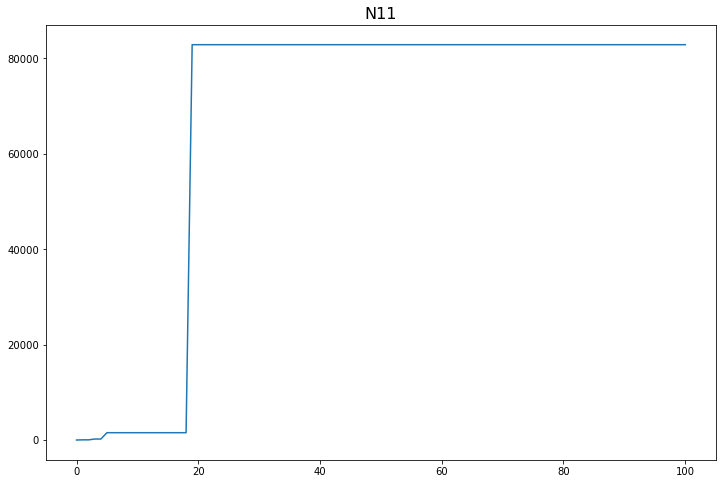

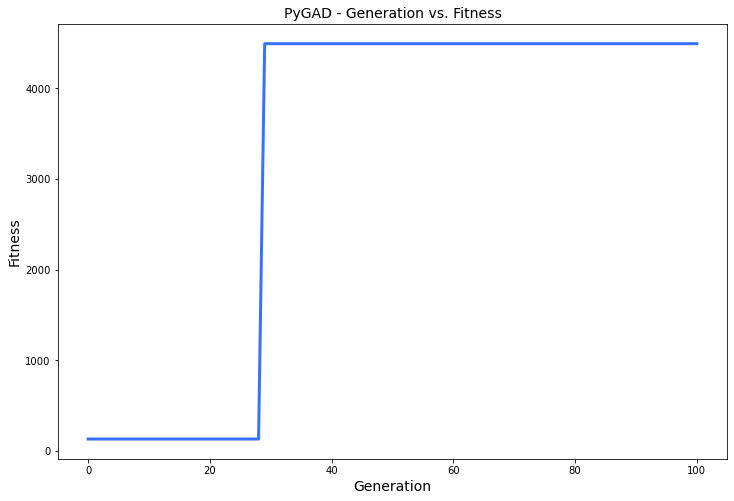

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.139 |==================| 1.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.251 |==================| 1.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 23.434 |==================| 8.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 22.711 |==================| 1.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 22.534 |==================| 0.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.322 |==================| 1.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 22.941 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.666 |==================| 6.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.842 |==================| 52.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.661 |==================| 6.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.925 |==================| 9.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 28.841 |==================| 56.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 28.46 |==================| 2.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.88 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.661 |==================| 6.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.925 |==================| 9.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 28.841 |==================| 56.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 28.46 |==================| 2.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.88 |==================| 17.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.522 |==================| 3.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.917 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 28.46 |==================| 2.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.88 |==================| 17.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.522 |==================| 3.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.917 |==================| 10.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.932 |==================| 9.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.854 |==================| 32.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.864 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 28.545 |==================| 3.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 28.452 |==================| 2.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 28.573 |==================| 3.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.865 |==================| 24.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.96 |==================| 7.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 28.9 |==================| 12.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.929 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 28.452 |==================| 2.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 28.573 |==================| 3.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.865 |==================| 24.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.96 |==================| 7.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 28.9 |==================| 12.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.929 |==================| 9.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.926 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.758 |==================| 15.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.85 |==================| 37.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.826 |==================| 307.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.931 |==================| 9.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.752 |==================| 14.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.791 |==================| 30.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 28.476 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.85 |==================| 37.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.826 |==================| 307.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.931 |==================| 9.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.752 |==================| 14.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.791 |==================| 30.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 28.476 |==================| 2.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.947 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.826 |==================| 307.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.931 |==================| 9.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.752 |==================| 14.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.791 |==================| 30.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 28.476 |==================| 2.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.947 |==================| 8.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.862 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.905 |==================| 12.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.924 |==================| 9.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 28.722 |==================| 9.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.864 |==================| 24.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.871 |==================| 20.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 28.655 |==================| 5.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 28.519 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.864 |==================| 24.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.871 |==================| 20.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 28.655 |==================| 5.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 28.519 |==================| 3.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.736 |==================| 11.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 28.62 |==================| 4.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.854 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 28.682 |==================| 7.055 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.654 |==================| 5.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 28.613 |==================| 4.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.928 |==================| 9.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 28.53 |==================| 3.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.897 |==================| 13.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.868 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.928 |==================| 9.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 28.53 |==================| 3.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.897 |==================| 13.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.868 |==================| 22.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.732 |==================| 10.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.963 |==================| 7.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.949 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 28.455 |==================| 2.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 28.678 |==================| 6.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.905 |==================| 12.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 28.65 |==================| 5.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.88 |==================| 17.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.736 |==================| 11.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 28.49 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 28.678 |==================| 6.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.905 |==================| 12.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 28.65 |==================| 5.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.88 |==================| 17.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.736 |==================| 11.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 28.49 |==================| 3.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.715 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.905 |==================| 12.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 28.65 |==================| 5.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.88 |==================| 17.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.736 |==================| 11.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 28.49 |==================| 3.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.715 |==================| 9.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.953 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.827 |==================| 247.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 28.555 |==================| 3.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.945 |==================| 8.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.939 |==================| 8.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 28.803 |==================| 48.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.879 |==================| 18.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.825 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 28.555 |==================| 3.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.945 |==================| 8.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.939 |==================| 8.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 28.803 |==================| 48.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.879 |==================| 18.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.825 |==================| 630.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 28.449 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.898 |==================| 13.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 28.611 |==================| 4.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.849 |==================| 38.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.908 |==================| 11.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.932 |==================| 9.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.445 |==================| 2.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 28.611 |==================| 4.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.849 |==================| 38.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.908 |==================| 11.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.932 |==================| 9.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.445 |==================| 2.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |==================| 8.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 28.609 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.932 |==================| 9.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.445 |==================| 2.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |==================| 8.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 28.609 |==================| 4.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 28.447 |==================| 2.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 28.471 |==================| 2.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.899 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 28.488 |==================| 2.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.764 |==================| 16.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 28.567 |==================| 3.905 |==========
Fitness = 630.6033776556366
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.909 |==================| 11.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.916 |==================| 10.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 28.567 |==================| 3.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.909 |==================| 11.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.916 |==================| 10.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 28.493 |==================| 3.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 28.952 |==================| 7.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 28.457 |==================| 2.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.956 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 28.584 |==================| 4.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.766 |==================| 17.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 28.938 |==================| 8.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.92 |==================| 10.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 28.634 |==================| 5.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 28.524 |==================| 3.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.757 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.92 |==================| 10.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 28.634 |==================| 5.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 28.524 |==================| 3.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.757 |==================| 15.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.87 |==================| 21.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 28.506 |==================| 3.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 28.589 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 28.51 |==================| 3.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 28.688 |==================| 7.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 28.569 |==================| 3.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.947 |==================| 8.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 28.426 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.758 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 28.688 |==================| 7.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 28.569 |==================| 3.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.947 |==================| 8.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 28.426 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.758 |==================| 15.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 28.564 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 28.569 |==================| 3.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.947 |==================| 8.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 28.426 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.758 |==================| 15.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 28.564 |==================| 3.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.91 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 28.604 |==================| 4.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 28.543 |==================| 3.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 28.433 |==================| 2.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.939 |==================| 8.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |==================| 8.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.953 |==================| 7.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.915 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.939 |==================| 8.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |==================| 8.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.953 |==================| 7.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.915 |==================| 10.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.856 |==================| 30.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.835 |==================| 86.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.751 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.951 |==================| 7.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 28.67 |==================| 6.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 28.804 |==================| 51.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.857 |==================| 29.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.913 |==================| 11.105 |==========
Generation = 13
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.667 |==================| 6.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 28.436 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.857 |==================| 29.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.913 |==================| 11.105 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.667 |==================| 6.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 28.436 |==================| 2.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 28.626 |==================| 5.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.842 |==================| 52.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.885 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.913 |==================| 11.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.748 |==================| 13.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.888 |==================| 15.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 28.499 |==================| 3.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.954 |==================| 7.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 28.513 |==================| 3.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.706 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.748 |==================| 13.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.888 |==================| 15.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 28.499 |==================| 3.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.954 |==================| 7.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 28.513 |==================| 3.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.706 |==================| 8.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 28.477 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.888 |==================| 15.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 28.499 |==================| 3.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.954 |==================| 7.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 28.513 |==================| 3.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.706 |==================| 8.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 28.477 |==================| 2.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.885 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.855 |==================| 31.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.805 |==================| 54.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.942 |==================| 8.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 28.929 |==================| 9.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.663 |==================| 6.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.817 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.805 |==================| 54.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.942 |==================| 8.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 28.929 |==================| 9.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.663 |==================| 6.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.817 |==================| 149.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.812 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 28.471 |==================| 2.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.731 |==================| 10.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.813 |==================| 97.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.75 |==================| 13.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.603 |==================| 4.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 28.512 |==================| 3.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.872 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.731 |==================| 10.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.813 |==================| 97.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.75 |==================| 13.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.603 |==================| 4.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 28.512 |==================| 3.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.872 |==================| 20.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.902 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.813 |==================| 97.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.75 |==================| 13.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.603 |==================| 4.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 28.512 |==================| 3.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.872 |==================| 20.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.902 |==================| 12.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 28.648 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 28.876 |==================| 19.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 28.431 |==================| 2.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.89 |==================| 14.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.862 |==================| 26.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 28.47 |==================| 2.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 28.915 |==================| 10.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 28.54 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 28.431 |==================| 2.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.89 |==================| 14.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.862 |==================| 26.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 28.47 |==================| 2.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 28.915 |==================| 10.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 28.54 |==================| 3.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.829 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.891 |==================| 14.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.882 |==================| 17.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.902 |==================| 12.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 28.505 |==================| 3.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.919 |==================| 10.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 28.467 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.837 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.882 |==================| 17.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.902 |==================| 12.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 28.505 |==================| 3.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.919 |==================| 10.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 28.467 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.837 |==================| 74.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.792 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.902 |==================| 12.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 28.505 |==================| 3.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.919 |==================| 10.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 28.467 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.837 |==================| 74.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.792 |==================| 32.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 28.597 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 28.807 |==================| 61.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.812 |==================| 88.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 28.441 |==================| 2.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 28.482 |==================| 2.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 28.908 |==================| 11.751 |==========
Fitness = 630.6033776556366
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 28.482 |==================| 2.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 28.908 |==================| 11.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 28.572 |==================| 3.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 28.571 |==================| 3.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.894 |==================| 14.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.692 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 28.9 |==================| 13.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 28.566 |==================| 3.884 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.946 |==================| 8.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.942 |==================| 8.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 28.901 |==================| 12.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.946 |==================| 8.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.942 |==================| 8.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 28.901 |==================| 12.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 28.567 |==================| 3.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.918 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.844 |==================| 47.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.898 |==================| 13.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 28.482 |==================| 2.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.934 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |==================| 7.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.754 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.844 |==================| 47.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.898 |==================| 13.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 28.482 |==================| 2.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.934 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |==================| 7.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.754 |==================| 14.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.889 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.898 |==================| 13.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 28.482 |==================| 2.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.934 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |==================| 7.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.754 |==================| 14.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.889 |==================| 15.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.837 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.866 |==================| 23.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 28.586 |==================| 4.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.844 |==================| 49.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 28.564 |==================| 3.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.951 |==================| 7.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.718 |==================| 9.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 28.585 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 28.586 |==================| 4.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.844 |==================| 49.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 28.564 |==================| 3.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.951 |==================| 7.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.718 |==================| 9.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 28.585 |==================| 4.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.926 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.933 |==================| 9.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.844 |==================| 49.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 28.468 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.956 |==================| 7.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.782 |==================| 24.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.707 |==================| 8.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.951 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.844 |==================| 49.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 28.468 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.956 |==================| 7.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.782 |==================| 24.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.707 |==================| 8.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.951 |==================| 7.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.905 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 28.468 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.956 |==================| 7.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.782 |==================| 24.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.707 |==================| 8.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.951 |==================| 7.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.905 |==================| 12.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 28.803 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.823 |==================| 12361.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 28.42 |==================| 2.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.845 |==================| 45.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.909 |==================| 11.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.84 |==================| 61.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.836 |==================| 78.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.885 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 28.42 |==================| 2.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.845 |==================| 45.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.909 |==================| 11.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.84 |==================| 61.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.836 |==================| 78.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.885 |==================| 16.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 28.551 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.844 |==================| 47.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.868 |==================| 22.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.956 |==================| 7.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.813 |==================| 96.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 28.557 |==================| 3.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.711 |==================| 8.913 |==========
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.868 |==================| 22.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.956 |==================| 7.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.813 |==================| 96.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 28.557 |==================| 3.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.711 |==================| 8.913 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 28.799 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.956 |==================| 7.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.813 |==================| 96.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 28.557 |==================| 3.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.711 |==================| 8.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.767 |==================| 17.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.86 |==================| 27.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 28.62 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.928 |==================| 9.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.873 |==================| 20.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.913 |==================| 11.157 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.767 |==================| 17.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.86 |==================| 27.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 28.62 |==================| 4.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.873 |==================| 20.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.913 |==================| 11.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.767 |==================| 17.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.86 |==================| 27.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 28.62 |==================| 4.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 28.532 |==================| 3.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.944 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 28.503 |==================| 3.119 |==========
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.735 |==================| 11.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 28.82 |==================| 281.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.663 |==================| 6.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.916 |==================| 10.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.874 |==================| 19.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.95

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.735 |==================| 11.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 28.82 |==================| 281.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.663 |==================| 6.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.916 |==================| 10.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.874 |==================| 19.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.95 |==================| 7.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 28.713 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 28.591 |==================| 4.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.776 |==================| 21.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 28.515 |==================| 3.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 28.858 |==================| 28.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.834 |==================| 90.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 28.772 |==================| 19.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.914 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.776 |==================| 21.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 28.515 |==================| 3.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 28.858 |==================| 28.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.834 |==================| 90.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 28.772 |==================| 19.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.914 |==================| 11.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.802 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 28.515 |==================| 3.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 28.858 |==================| 28.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.834 |==================| 90.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 28.772 |==================| 19.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.914 |==================| 11.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.802 |==================| 46.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.828 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.948 |==================| 8.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 28.944 |==================| 8.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.719 |==================| 9.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.945 |==================| 8.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.885 |==================| 16.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.791 |==================| 30.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.96 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.719 |==================| 9.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.945 |==================| 8.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.885 |==================| 16.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.791 |==================| 30.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.96 |==================| 7.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.878 |==================| 18.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 28.944 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.861 |==================| 26.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 28.501 |==================| 3.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.804 |==================| 52.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.889 |==================| 15.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 28.63 |==================| 5.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.561 |==================| 3.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.955 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 28.501 |==================| 3.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.804 |==================| 52.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.889 |==================| 15.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 28.63 |==================| 5.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.561 |==================| 3.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.955 |==================| 7.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 28.623 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.804 |==================| 52.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.889 |==================| 15.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 28.63 |==================| 5.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.561 |==================| 3.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.955 |==================| 7.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 28.623 |==================| 4.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.804 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.665 |==================| 6.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.875 |==================| 19.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 28.687 |==================| 7.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 28.777 |==================| 21.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.954 |==================| 7.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 28.641 |==================| 5.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.888 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 28.777 |==================| 21.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.954 |==================| 7.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 28.641 |==================| 5.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.888 |==================| 15.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 28.448 |==================| 2.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.842 |==================| 52.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.941 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 28.583 |==================| 4.164 |==========
Generation = 32
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 28.953 |==================| 7.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 28.611 |==================| 4.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 28.651 |==================| 5.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 28.89 |==================| 15.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.732 |==================| 10.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.85 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 28.651 |==================| 5.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 28.89 |==================| 15.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.732 |==================| 10.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.85 |==================| 36.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.899 |==================| 13.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.806 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 28.514 |==================| 3.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 28.586 |==================| 4.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.919 |==================| 10.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.775 |==================| 20.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.936 |==================| 8.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 28.622 |==================| 4.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.791 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.919 |==================| 10.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.775 |==================| 20.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.936 |==================| 8.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 28.622 |==================| 4.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.791 |==================| 30.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 28.553 |==================| 3.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 28.594 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 28.622 |==================| 4.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.791 |==================| 30.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 28.553 |==================| 3.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 28.594 |==================| 4.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 28.434 |==================| 2.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 39.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.917 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 28.552 |==================| 3.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.816 |==================| 138.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.824 |==================| 1054.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.858 |==================| 28.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.833 |==================| 102.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.819 |==================| 251.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 28.478 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.858 |==================| 28.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.833 |==================| 102.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.819 |==================| 251.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 28.478 |==================| 2.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.96 |==================| 7.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.871 |==================| 21.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.87 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.948 |==================| 8.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 28.915 |==================| 10.922 |==========
Generation = 35
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.665 |==================| 6.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.892 |==================| 14.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 28.908 |==================| 11.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 28.789 |==================| 28.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 28.915 |==================| 10.922 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.665 |==================| 6.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.892 |==================| 14.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 28.908 |==================| 11.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 28.789 |==================| 28.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.956 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 28.422 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.947 |==================| 8.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.456 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.958 |==================| 7.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.836 |==================| 81.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.918 |==================| 10.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.705 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.947 |==================| 8.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.456 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.958 |==================| 7.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.836 |==================| 81.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.918 |==================| 10.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.705 |==================| 8.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.932 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.456 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.958 |==================| 7.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.836 |==================| 81.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.918 |==================| 10.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.705 |==================| 8.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.932 |==================| 9.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 28.9 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.964 |==================| 7.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.709 |==================| 8.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.804 |==================| 52.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.961 |==================| 7.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.759 |==================| 15.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.84 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.964 |==================| 7.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.709 |==================| 8.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.804 |==================| 52.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.961 |==================| 7.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.759 |==================| 15.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.84 |==================| 61.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.843 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 28.662 |==================| 6.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 28.635 |==================| 5.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.954 |==================| 7.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.712 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.895 |==================| 13.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.962 |==================| 7.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.869 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 28.635 |==================| 5.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.954 |==================| 7.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.712 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.895 |==================| 13.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.962 |==================| 7.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.869 |==================| 22.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.791 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.954 |==================| 7.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.712 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.895 |==================| 13.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.962 |==================| 7.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.869 |==================| 22.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.791 |==================| 31.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 28.611 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.943 |==================| 8.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 28.944 |==================| 8.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.907 |==================| 11.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 28.487 |==================| 2.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.957 |==================| 7.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.939 |==================| 8.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.961 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 28.944 |==================| 8.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.907 |==================| 11.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 28.487 |==================| 2.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.957 |==================| 7.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.939 |==================| 8.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.961 |==================| 7.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 28.539 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.912 |==================| 11.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.945 |==================| 8.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.666 |==================| 6.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.941 |==================| 8.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.685 |==================| 7.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 28.471 |==================| 2.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 28.516 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.945 |==================| 8.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.666 |==================| 6.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.941 |==================| 8.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.685 |==================| 7.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 28.471 |==================| 2.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 28.516 |==================| 3.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.881 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.666 |==================| 6.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.941 |==================| 8.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.685 |==================| 7.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 28.471 |==================| 2.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 28.516 |==================| 3.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.881 |==================| 17.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.927 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.956 |==================| 7.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 28.498 |==================| 3.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.876 |==================| 18.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.897 |==================| 13.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.894 |==================| 14.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.915 |==================| 10.843 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 28.498 |==================| 3.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.876 |==================| 18.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.897 |==================| 13.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.894 |==================| 14.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.915 |==================| 10.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 28.481 |==================| 2.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.955 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 28.608 |==================| 4.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 28.546 |==================| 3.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |==================| 8.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 28.596 |==================| 4.404 |==========
Generation = 42
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.867 |==================| 22.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.703 |==================| 8.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 28.566 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 28.546 |==================| 3.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |==================| 8.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 28.596 |==================| 4.404 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.867 |==================| 22.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.703 |==================| 8.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 28.566 |==================| 3.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.83 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |==================| 8.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 28.596 |==================| 4.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 28.881 |==================| 17.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 28.452 |==================| 2.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 28.61 |==================| 4.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.755 |==================| 14.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 28.6 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.959 |==================| 7.36 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 28.881 |==================| 17.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 28.452 |==================| 2.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 28.61 |==================| 4.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.755 |==================| 14.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 28.6 |==================| 4.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 28.881 |==================| 17.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 28.452 |==================| 2.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 28.61 |==================| 4.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.755 |==================| 14.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 28.6 |==================| 4.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.942 |==================| 8.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.727 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.689 |==================| 7.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.859 |==================| 27.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 28.725 |==================| 10.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.91 |==================| 11.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.952 |==================| 7.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 28.613 |==================| 4.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.943 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.859 |==================| 27.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 28.725 |==================| 10.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.91 |==================| 11.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.952 |==================| 7.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 28.613 |==================| 4.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.943 |==================| 8.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.746 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.899 |==================| 13.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 28.47 |==================| 2.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.923 |==================| 10.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 28.743 |==================| 12.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.828 |==================| 222.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 28.522 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 28.47 |==================| 2.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.923 |==================| 10.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 28.743 |==================| 12.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.828 |==================| 222.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 28.522 |==================| 3.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.898 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.923 |==================| 10.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 28.743 |==================| 12.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.828 |==================| 222.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 28.522 |==================| 3.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.898 |==================| 13.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 28.532 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 28.853 |==================| 33.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.927 |==================| 9.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.916 |==================| 10.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.882 |==================| 17.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.66 |==================| 6.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.854 |==================| 32.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 28.539 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.927 |==================| 9.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.916 |==================| 10.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.882 |==================| 17.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.66 |==================| 6.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.854 |==================| 32.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 28.539 |==================| 3.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 28.724 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.86 |==================| 27.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.845 |==================| 46.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.615 |==================| 4.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.843 |==================| 51.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.931 |==================| 9.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.829 |==================| 174.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.9 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.845 |==================| 46.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.615 |==================| 4.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.843 |==================| 51.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.931 |==================| 9.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.829 |==================| 174.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.9 |==================| 13.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 28.64 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.615 |==================| 4.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.843 |==================| 51.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.931 |==================| 9.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.829 |==================| 174.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.9 |==================| 13.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 28.64 |==================| 5.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 28.663 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 28.449 |==================| 2.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 28.577 |==================| 4.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.834 |==================| 93.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.959 |==================| 7.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 28.496 |==================| 3.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.946 |==================| 8.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 28.714 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 28.577 |==================| 4.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.834 |==================| 93.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.959 |==================| 7.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 28.496 |==================| 3.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.946 |==================| 8.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 28.714 |==================| 9.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 28.89 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 28.965 |==================| 7.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.697 |==================| 7.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 28.551 |==================| 3.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 28.582 |==================| 4.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.924 |==================| 9.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 28.529 |==================| 3.395 |==========
Generation = 49
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.842 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.697 |==================| 7.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 28.551 |==================| 3.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 28.582 |==================| 4.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.924 |==================| 9.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 28.529 |==================| 3.395 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.842 |==================| 53.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.904 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 28.551 |==================| 3.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 28.582 |==================| 4.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.924 |==================| 9.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 28.529 |==================| 3.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.74 |==================| 12.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 28.522 |==================| 3.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.73 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.664 |==================| 6.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.929 |==================| 9.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 28.595 |==================| 4.391 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.74 |==================| 12.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 28.522 |==================| 3.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.73 |==================| 10.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.929 |==================| 9.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 28.595 |==================| 4.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.74 |==================| 12.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 28.522 |==================| 3.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.73 |==================| 10.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 28.689 |==================| 7.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.887 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.932 |==================| 9.17 |==========
Generation = 51
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.917 |==================| 10.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.874 |==================| 19.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.651 |==================| 5.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 28.53 |==================| 3.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.749 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.917 |==================| 10.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.874 |==================| 19.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.651 |==================| 5.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 28.53 |==================| 3.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.749 |==================| 13.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.949 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 28.95 |==================| 7.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 28.942 |==================| 8.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.845 |==================| 46.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.89 |==================| 14.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.876 |==================| 18.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.887 |==================| 15.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.964 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 28.942 |==================| 8.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.845 |==================| 46.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.89 |==================| 14.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.876 |==================| 18.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.887 |==================| 15.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.964 |==================| 7.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.955 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.845 |==================| 46.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.89 |==================| 14.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.876 |==================| 18.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.887 |==================| 15.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.964 |==================| 7.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.955 |==================| 7.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 28.428 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.641 |==================| 5.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.805 |==================| 55.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 28.713 |==================| 9.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.83 |==================| 146.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.444 |==================| 2.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 28.449 |==================| 2.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.654 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.805 |==================| 55.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 28.713 |==================| 9.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.83 |==================| 146.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.444 |==================| 2.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 28.449 |==================| 2.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.654 |==================| 5.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 28.887 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.82 |==================| 301.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.749 |==================| 13.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.869 |==================| 22.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.861 |==================| 26.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 28.939 |==================| 8.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.842 |==================| 54.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.445 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.749 |==================| 13.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.869 |==================| 22.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.861 |==================| 26.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 28.939 |==================| 8.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.842 |==================| 54.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.445 |==================| 2.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.644 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.869 |==================| 22.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.861 |==================| 26.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 28.939 |==================| 8.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.842 |==================| 54.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.445 |==================| 2.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.644 |==================| 5.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 28.512 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.908 |==================| 11.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.84 |==================| 59.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.696 |==================| 7.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 28.665 |==================| 6.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.873 |==================| 20.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.844 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.84 |==================| 59.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.696 |==================| 7.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 28.665 |==================| 6.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.873 |==================| 20.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.844 |==================| 48.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.856 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 28.429 |==================| 2.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.895 |==================| 13.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.865 |==================| 24.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 28.48 |==================| 2.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.664 |==================| 6.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.913 |==================| 11.165 |==========
Generation = 56
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.775 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 28.48 |==================| 2.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.664 |==================| 6.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.913 |==================| 11.165 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.775 |==================| 20.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.796 |==================| 36.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.95 |==================| 7.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.768 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.946 |==================| 8.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.643 |==================| 5.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 28.466 |==================| 2.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 28.579 |==================| 4.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.936 |==================| 8.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.896 |==================| 13.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.88 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.643 |==================| 5.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 28.466 |==================| 2.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 28.579 |==================| 4.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.936 |==================| 8.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.896 |==================| 13.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.88 |==================| 17.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.632 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 28.466 |==================| 2.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 28.579 |==================| 4.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.936 |==================| 8.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.896 |==================| 13.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.88 |==================| 17.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.632 |==================| 5.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.66 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.895 |==================| 13.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 28.525 |==================| 3.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 28.505 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 28.849 |==================| 39.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 28.525 |==================| 3.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.879 |==================| 17.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 28.597 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 28.525 |==================| 3.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 28.505 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 28.849 |==================| 39.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 28.525 |==================| 3.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.879 |==================| 17.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 28.597 |==================| 4.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.917 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 28.505 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.641 |==================| 5.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 28.872 |==================| 20.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.702 |==================| 8.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.832 |==================| 108.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.882 |==================| 17.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.76 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.641 |==================| 5.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 28.872 |==================| 20.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.702 |==================| 8.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.832 |==================| 108.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.882 |==================| 17.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.76 |==================| 15.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 28.669 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 28.872 |==================| 20.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.702 |==================| 8.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.832 |==================| 108.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.882 |==================| 17.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.76 |==================| 15.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 28.669 |==================| 6.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 28.511 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 28.631 |==================| 5.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.954 |==================| 7.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 28.89 |==================| 15.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 28.766 |==================| 17.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 28.885 |==================| 16.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.786 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.954 |==================| 7.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 28.89 |==================| 15.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 28.766 |==================| 17.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 28.885 |==================| 16.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.786 |==================| 26.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.936 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 28.722 |==================| 9.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.716 |==================| 9.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.872 |==================| 20.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 28.427 |==================| 2.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 28.437 |==================| 2.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.824 |==================| 2346.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.748 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.716 |==================| 9.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.872 |==================| 20.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 28.427 |==================| 2.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 28.437 |==================| 2.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.824 |==================| 2346.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.748 |==================| 13.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.776 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.872 |==================| 20.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 28.427 |==================| 2.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 28.437 |==================| 2.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.824 |==================| 2346.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 28.748 |==================| 13.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.776 |==================| 21.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 28.458 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.817 |==================| 167.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.917 |==================| 10.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 28.473 |==================| 2.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.956 |==================| 7.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.905 |==================| 12.18 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.917 |==================| 10.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 28.473 |==================| 2.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.956 |==================| 7.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.905 |==================| 12.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 28.956 |==================| 7.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.711 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 28.52 |==================| 3.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.906 |==================| 12.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 28.496 |==================| 3.056 |==========
Generation = 63
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.895 |==================| 13.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 28.627 |==================| 5.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 28.428 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.846 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.895 |==================| 13.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 28.627 |==================| 5.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 28.428 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.846 |==================| 43.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.878 |==================| 18.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.82 |==================| 358.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 28.887 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.931 |==================| 9.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 28.959 |==================| 7.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 28.793 |==================| 32.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 28.507 |==================| 3.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.705 |==================| 8.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.892 |==================| 14.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 28.724 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 28.959 |==================| 7.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 28.793 |==================| 32.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 28.507 |==================| 3.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.705 |==================| 8.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.892 |==================| 14.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 28.724 |==================| 10.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 28.655 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 28.793 |==================| 32.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 28.507 |==================| 3.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.705 |==================| 8.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.892 |==================| 14.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 28.724 |==================| 10.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 28.655 |==================| 5.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.703 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 28.9 |==================| 13.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 28.614 |==================| 4.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.96 |==================| 7.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 28.635 |==================| 5.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.798 |==================| 39.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.905 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 28.614 |==================| 4.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.96 |==================| 7.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 28.635 |==================| 5.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.798 |==================| 39.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.905 |==================| 12.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 28.499 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 28.612 |==================| 4.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 28.537 |==================| 3.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 28.544 |==================| 3.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.863 |==================| 24.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.857 |==================| 29.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.667 |==================| 6.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.829 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 28.544 |==================| 3.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.863 |==================| 24.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.857 |==================| 29.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.667 |==================| 6.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.829 |==================| 184.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.862 |==================| 25.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 28.485 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.863 |==================| 24.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.857 |==================| 29.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.667 |==================| 6.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.829 |==================| 184.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.862 |==================| 25.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 28.485 |==================| 2.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.875 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.719 |==================| 9.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 28.598 |==================| 4.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.625 |==================| 5.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.861 |==================| 26.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 28.588 |==================| 4.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.706 |==================| 8.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.861 |==================| 26.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 28.588 |==================| 4.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.706 |==================| 8.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |==================| 17.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 28.561 |==================| 3.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.855 |==================| 31.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 28.511 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 28.959 |==================| 7.382 |==========
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.838 |==================| 69.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 28.545 |==================| 3.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.738 |==================| 11.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.445 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 28.569 |==================| 3.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 28.531 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.738 |==================| 11.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.445 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 28.569 |==================| 3.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 28.531 |==================| 3.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.752 |==================| 14.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 28.472 |==================| 2.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.831 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 38.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 28.481 |==================| 2.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 28.527 |==================| 3.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.869 |==================| 21.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.741 |==================| 12.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 28.627 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 28.527 |==================| 3.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.869 |==================| 21.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.741 |==================| 12.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 28.627 |==================| 5.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 28.419 |==================| 2.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 28.569 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.869 |==================| 21.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.741 |==================| 12.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 28.627 |==================| 5.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 28.419 |==================| 2.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 28.569 |==================| 3.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.641 |==================| 5.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.805 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 28.853 |==================| 33.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.885 |==================| 16.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.925 |==================| 9.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.884 |==================| 16.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.801 |==================| 44.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.835 |==================| 81.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.902 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.885 |==================| 16.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.925 |==================| 9.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.884 |==================| 16.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.801 |==================| 44.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.835 |==================| 81.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.902 |==================| 12.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 28.58 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.709 |==================| 8.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 28.525 |==================| 3.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.898 |==================| 13.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.858 |==================| 28.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 28.747 |==================| 13.087 |==========
Generation = 71
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 28.638 |==================| 5.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 28.499 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.898 |==================| 13.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.858 |==================| 28.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 28.747 |==================| 13.087 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 28.638 |==================| 5.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 28.499 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.753 |==================| 14.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.93 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.874 |==================| 19.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.914 |==================| 10.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 28.608 |==================| 4.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.742 |==================| 12.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.516 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.863 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.914 |==================| 10.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 28.608 |==================| 4.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.742 |==================| 12.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.516 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.863 |==================| 25.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 28.434 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 28.608 |==================| 4.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.742 |==================| 12.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.516 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.863 |==================| 25.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 28.434 |==================| 2.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.694 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.854 |==================| 32.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.888 |==================| 15.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.796 |==================| 36.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 28.833 |==================| 105.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 28.628 |==================| 5.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.906 |==================| 12.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.831 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.888 |==================| 15.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.796 |==================| 36.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 28.833 |==================| 105.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 28.628 |==================| 5.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.906 |==================| 12.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.831 |==================| 133.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 28.939 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 28.63 |==================| 5.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.65 |==================| 5.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.603 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.952 |==================| 7.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.734 |==================| 11.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.95 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.65 |==================| 5.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.603 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.952 |==================| 7.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.734 |==================| 11.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.95 |==================| 7.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.767 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.603 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.952 |==================| 7.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.734 |==================| 11.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.95 |==================| 7.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.767 |==================| 17.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 28.768 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.953 |==================| 7.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 28.721 |==================| 9.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.739 |==================| 11.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 28.468 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.894 |==================| 14.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 28.746 |==================| 13.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 28.586 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 28.721 |==================| 9.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.739 |==================| 11.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 28.468 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.894 |==================| 14.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 28.746 |==================| 13.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 28.586 |==================| 4.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.927 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 28.55 |==================| 3.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 28.538 |==================| 3.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.893 |==================| 14.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.912 |==================| 11.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.756 |==================| 14.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 28.619 |==================| 4.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 28.538 |==================| 3.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.893 |==================| 14.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.912 |==================| 11.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.756 |==================| 14.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 28.619 |==================| 4.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |==================| 8.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.86 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.893 |==================| 14.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.912 |==================| 11.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.756 |==================| 14.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 28.619 |==================| 4.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |==================| 8.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.86 |==================| 27.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 28.539 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 28.426 |==================| 2.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.828 |==================| 196.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.904 |==================| 12.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.764 |==================| 16.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.836 |==================| 76.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.76 |==================| 15.902 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.828 |==================| 196.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.904 |==================| 12.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.764 |==================| 16.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.836 |==================| 76.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.76 |==================| 15.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.753 |==================| 14.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.675 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.941 |==================| 8.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.744 |==================| 12.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 28.439 |==================| 2.602 |==========
Generation = 78
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.905 |==================| 12.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 28.521 |==================| 3.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.899

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.744 |==================| 12.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 28.439 |==================| 2.602 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.905 |==================| 12.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 28.521 |==================| 3.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.899 |==================| 13.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.898 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.744 |==================| 12.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 28.439 |==================| 2.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 28.601 |==================| 4.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.844 |==================| 47.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 28.592 |==================| 4.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.625 |==================| 5.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 28.463 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 28.621 |==================| 4.939 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 28.601 |==================| 4.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.844 |==================| 47.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 28.592 |==================| 4.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.625 |==================| 5.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 28.463 |==================| 2.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 28.601 |==================| 4.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.844 |==================| 47.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 28.592 |==================| 4.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.625 |==================| 5.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 28.463 |==================| 2.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.914 |==================| 10.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.749 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 28.758 |==================| 15.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 28.504 |==================| 3.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.936 |==================| 8.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.948 |==================| 7.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 28.565 |==================| 3.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 28.667 |==================| 6.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.955 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 28.504 |==================| 3.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.936 |==================| 8.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.948 |==================| 7.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 28.565 |==================| 3.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 28.667 |==================| 6.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.955 |==================| 7.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 28.629 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.946 |==================| 8.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 28.438 |==================| 2.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.74 |==================| 11.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.862 |==================| 26.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 28.426 |==================| 2.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 28.942 |==================| 8.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.892 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 28.438 |==================| 2.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.74 |==================| 11.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.862 |==================| 26.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 28.426 |==================| 2.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 28.942 |==================| 8.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.892 |==================| 14.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.905 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.74 |==================| 11.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.862 |==================| 26.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 28.426 |==================| 2.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 28.942 |==================| 8.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.892 |==================| 14.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.905 |==================| 12.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.667 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.865 |==================| 23.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 28.504 |==================| 3.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.756 |==================| 14.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.444 |==================| 2.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 28.554 |==================| 3.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.908 |==================| 11.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.789 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 28.504 |==================| 3.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.756 |==================| 14.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 28.444 |==================| 2.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 28.554 |==================| 3.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.908 |==================| 11.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.789 |==================| 28.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.966 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 28.623 |==================| 5.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.879 |==================| 17.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 28.56 |==================| 3.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 28.841 |==================| 55.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.904 |==================| 12.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 28.788 |==================| 28.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 28.607 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.879 |==================| 17.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 28.56 |==================| 3.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 28.841 |==================| 55.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.904 |==================| 12.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 28.788 |==================| 28.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 28.607 |==================| 4.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 28.543 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 28.56 |==================| 3.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 28.841 |==================| 55.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.904 |==================| 12.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 28.788 |==================| 28.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 28.607 |==================| 4.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 28.543 |==================| 3.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.964 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 28.664 |==================| 6.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 28.671 |==================| 6.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 28.61 |==================| 4.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.952 |==================| 7.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 28.465 |==================| 2.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.841 |==================| 54.886 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 28.61 |==================| 4.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.952 |==================| 7.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 28.465 |==================| 2.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.841 |==================| 54.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.739 |==================| 11.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.768 |==================| 18.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.899 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.965 |==================| 7.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.747 |==================| 13.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 28.681 |==================| 7.038 |==========
Generation = 85
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |==================| 7.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 28.602 |==================| 4.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 28.773 |==================| 19.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.834

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.747 |==================| 13.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 28.681 |==================| 7.038 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |==================| 7.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 28.602 |==================| 4.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 28.773 |==================| 19.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.834 |==================| 96.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 28.671 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 28.681 |==================| 7.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 28.884 |==================| 16.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.857 |==================| 30.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 28.795 |==================| 34.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.712 |==================| 8.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 28.51 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 28.884 |==================| 16.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.857 |==================| 30.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 28.795 |==================| 34.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.712 |==================| 8.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 28.51 |==================| 3.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 28.435 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.857 |==================| 30.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 28.795 |==================| 34.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.712 |==================| 8.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 28.51 |==================| 3.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 28.435 |==================| 2.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.859 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.59 |==================| 4.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |==================| 8.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 28.419 |==================| 2.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.832 |==================| 109.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.674 |==================| 6.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 28.674 |==================| 6.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.859 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.94 |==================| 8.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 28.419 |==================| 2.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.832 |==================| 109.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.674 |==================| 6.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 28.674 |==================| 6.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.859 |==================| 28.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.666 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 28.558 |==================| 3.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.522 |==================| 3.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.747 |==================| 13.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.792 |==================| 32.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 28.892 |==================| 14.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 28.552 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.522 |==================| 3.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.747 |==================| 13.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.792 |==================| 32.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 28.892 |==================| 14.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 28.552 |==================| 3.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.862 |==================| 25.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.864 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 28.892 |==================| 14.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 28.552 |==================| 3.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.862 |==================| 25.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.864 |==================| 24.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 28.573 |==================| 4.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 28.629 |==================| 5.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.957 |==================| 7.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.962 |==================| 7.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 28.647 |==================| 5.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 28.903 |==================| 12.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.927 |==================| 9.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 38.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 28.512 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.962 |==================| 7.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 28.647 |==================| 5.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 28.903 |==================| 12.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.927 |==================| 9.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 38.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 28.512 |==================| 3.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.642 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.826 |==================| 355.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 28.459 |==================| 2.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 28.612 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.951 |==================| 7.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.653 |==================| 5.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.769 |==================| 18.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.957 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 28.459 |==================| 2.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 28.612 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.951 |==================| 7.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.653 |==================| 5.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.769 |==================| 18.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.957 |==================| 7.488 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 28.501 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 28.612 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.951 |==================| 7.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.653 |==================| 5.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.769 |==================| 18.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.957 |==================| 7.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.954 |==================| 7.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.908 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 28.698 |==================| 8.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 28.444 |==================| 2.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.856 |==================| 30.74 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.954 |==================| 7.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.908 |==================| 11.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 28.746 |==================| 13.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.954 |==================| 7.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 28.908 |==================| 11.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 28.746 |==================| 13.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.83 |==================| 144.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 28.811 |==================| 78.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 28.937 |==================| 8.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.949 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.81 |==================| 76.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 28.652 |==================| 5.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.892 |==================| 14.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.834 |==================| 96.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 28.785 |==================| 26.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.856 |==================| 30.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.7 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.834 |==================| 96.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 28.785 |==================| 26.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.856 |==================| 30.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.7 |==================| 8.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.901 |==================| 12.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 28.525 |==================| 3.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.873 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.842 |==================| 53.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.948 |==================| 8.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.74 |==================| 12.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 28.582 |==================| 4.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 28.447 |==================| 2.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.516 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.74 |==================| 12.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 28.582 |==================| 4.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 28.447 |==================| 2.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.516 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.707 |==================| 8.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 28.814 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 28.582 |==================| 4.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 28.447 |==================| 2.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.516 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.707 |==================| 8.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 28.814 |==================| 111.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.868 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 28.497 |==================| 3.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 28.469 |==================| 2.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.934 |==================| 9.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 28.559 |==================| 3.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.741 |==================| 12.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 28.946 |==================| 8.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 28.459 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 28.469 |==================| 2.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.934 |==================| 9.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 28.559 |==================| 3.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.741 |==================| 12.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 28.946 |==================| 8.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 28.459 |==================| 2.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 28.437 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.964 |==================| 7.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.913 |==================| 11.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.445 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.904 |==================| 12.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 28.628 |==================| 5.109 |==========
Generation = 95
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.7 |==================| 8.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 28.576 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.913 |==================| 11.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.445 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.904 |==================| 12.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 28.628 |==================| 5.109 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.7 |==================| 8.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 28.576 |==================| 4.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.932 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 28.445 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.904 |==================| 12.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 28.628 |==================| 5.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 28.807 |==================| 63.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 28.564 |==================| 3.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 28.438 |==================| 2.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.672 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.88 |==================| 17.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 28.908 |==================| 11.763 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 28.807 |==================| 63.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 28.564 |==================| 3.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 28.438 |==================| 2.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.672 |==================| 6.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 28.908 |==================| 11.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 28.807 |==================| 63.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 28.564 |==================| 3.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 28.438 |==================| 2.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.672 |==================| 6.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 28.771 |==================| 19.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.895 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.887 |==================| 15.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.936 |==================| 8.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.867 |==================| 23.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.833 |==================| 98.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.959 |==================| 7.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 28.458 |==================| 2.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 28.635 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.833 |==================| 98.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.959 |==================| 7.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 28.458 |==================| 2.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 28.635 |==================| 5.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 28.944 |==================| 8.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.765 |==================| 17.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 28.726 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 28.785 |==================| 25.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 28.523 |==================| 3.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 28.649 |==================| 5.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.863 |==================| 25.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.828 |==================| 205.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.666 |==================| 6.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 28.529 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.863 |==================| 25.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.828 |==================| 205.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.666 |==================| 6.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 28.529 |==================| 3.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 28.638 |==================| 5.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 28.868 |==================| 22.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.851 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 28.529 |==================| 3.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 28.638 |==================| 5.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 28.868 |==================| 22.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.851 |==================| 36.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.751 |==================| 13.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 28.807 |==================| 61.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.93 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 28.939 |==================| 8.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.847 |==================| 42.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.86 |==================| 26.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 28.63 |==================| 5.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.914 |==================| 11.005 |==========
Fitness = 12361.011379033007
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 28.687 |==================| 7.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.847 |==================| 42.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.86 |==================| 26.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 28.63 |==================| 5.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.914 |==================| 11.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 28.687 |==================| 7.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.729 |==================| 10.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.93 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 28.46 |==================| 2.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.927 |==================| 9.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.947 |==================| 8.074 |==========
Generation = 100
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.652 |==================| 5.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.836 |==================| 77.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.834 |==================| 89.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.59 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.927 |==================| 9.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.947 |==================| 8.074 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.652 |==================| 5.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.836 |==================| 77.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.834 |==================| 89.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.59 |==================| 4.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 28.963 |====

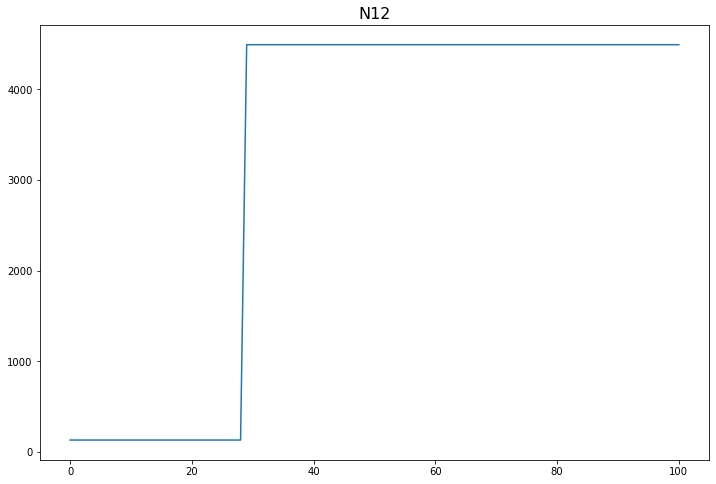

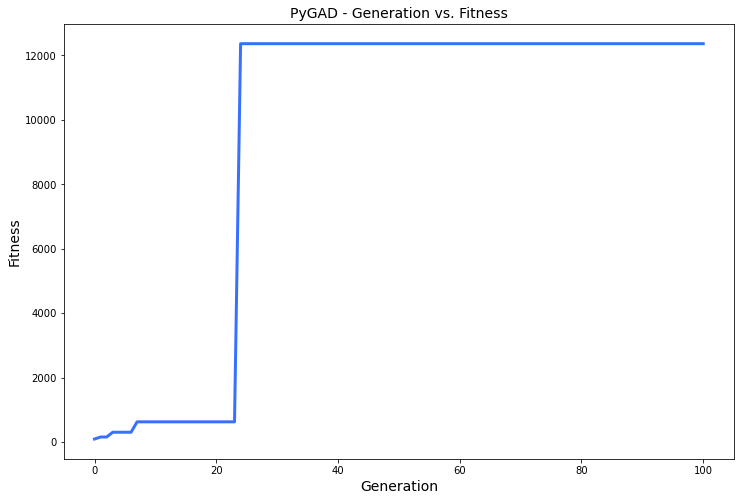

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.652 |==================| 5.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.836 |==================| 77.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.834 |==================| 89.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.59 |==================| 4.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 28.963 |==================| 7.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.876 |==================| 18.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.961 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.89 |==================| 9.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.036 |==================| 26.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.798 |==================| 4.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 26.778 |==================| 4.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.73 |==================| 3.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.969 |==================| 34.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.18 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 26.778 |==================| 4.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.73 |==================| 3.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.969 |==================| 34.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.18 |==================| 5.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.57 |==================| 2.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.048 |==================| 20.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.829 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.18 |==================| 5.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.57 |==================| 2.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.048 |==================| 20.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.829 |==================| 5.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.105 |==================| 9.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.11 |==================| 8.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.472 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.074 |==================| 13.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.19 |==================| 5.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.541 |==================| 2.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.142 |==================| 6.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.029 |==================| 32.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.788 |==================| 4.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.855 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.19 |==================| 5.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.541 |==================| 2.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.142 |==================| 6.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.029 |==================| 32.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.788 |==================| 4.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.855 |==================| 7.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.148 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.562 |==================| 2.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.598 |==================| 2.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.723 |==================| 3.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.006 |==================| 119.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 26.684 |==================| 3.183 |==========
Generation = 3
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.201 |==================| 4.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.056 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.723 |==================| 3.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.006 |==================| 119.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 26.684 |==================| 3.183 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.201 |==================| 4.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.056 |==================| 17.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.623 |==================| 2.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 26.885 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.006 |==================| 119.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 26.684 |==================| 3.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.181 |==================| 5.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.609 |==================| 2.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.145 |==================| 6.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.029 |==================| 31.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.105 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.206 |==================| 4.805 |==========
Fitness = 626.3022041605248
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.181 |==================| 5.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.609 |==================| 2.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.145 |==================| 6.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.029 |==================| 31.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.105 |==================| 9.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.181 |==================| 5.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.609 |==================| 2.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.145 |==================| 6.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.029 |==================| 31.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.105 |==================| 9.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.145 |==================| 6.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.51 |===========| 26.433 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.201 |==================| 4.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.069 |==================| 14.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.143 |==================| 6.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.095 |==================| 10.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.017 |==================| 50.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 26.694 |==================| 3.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.95 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.143 |==================| 6.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.095 |==================| 10.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.017 |==================| 50.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 26.694 |==================| 3.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.95 |==================| 20.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.051 |==================| 18.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.093 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 26.946 |==================| 19.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 26.878 |==================| 8.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |==================| 10.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.756 |==================| 4.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.143 |==================| 6.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.014 |==================| 63.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.068 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 26.878 |==================| 8.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |==================| 10.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.756 |==================| 4.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.143 |==================| 6.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.014 |==================| 63.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.068 |==================| 14.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.206 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |==================| 10.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.756 |==================| 4.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.143 |==================| 6.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.014 |==================| 63.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.068 |==================| 14.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.206 |==================| 4.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.802 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.251 |==================| 3.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.792 |==================| 4.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.195 |==================| 5.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.058 |==================| 16.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.172 |==================| 5.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.516 |==================| 2.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.088 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.792 |==================| 4.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.195 |==================| 5.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.058 |==================| 16.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.172 |==================| 5.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.516 |==================| 2.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.088 |==================| 11.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.029 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 26.44 |==================| 1.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.08 |==================| 12.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.562 |==================| 2.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 26.941 |==================| 17.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.157 |==================| 6.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.157 |==================| 6.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.214 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.08 |==================| 12.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.562 |==================| 2.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 26.941 |==================| 17.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.157 |==================| 6.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.157 |==================| 6.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.214 |==================| 4.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.077 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.562 |==================| 2.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 26.941 |==================| 17.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.157 |==================| 6.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.157 |==================| 6.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.214 |==================| 4.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.077 |==================| 12.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.203 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.464 |==================| 1.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.151 |==================| 6.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 26.44 |==================| 1.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.019 |==================| 46.831 |==========
Fitness = 626.3022041591312
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.203 |==================| 4.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.197 |==================| 5.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.019 |==================| 46.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.203 |==================| 4.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.197 |==================| 5.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.708 |==================| 3.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.098 |==================| 9.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.212 |==================| 4.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 26.607 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.585 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.121 |==================| 8.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.164 |==================| 6.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.037 |==================| 25.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 26.991 |==================| 155.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 26.982 |==================| 64.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.854 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.164 |==================| 6.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.037 |==================| 25.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 26.991 |==================| 155.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 26.982 |==================| 64.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.854 |==================| 6.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.001 |==================| 373.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.042 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 27.169 |==================| 5.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 26.997 |==================| 1914.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.453 |==================| 1.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.934 |==================| 15.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.03 |==================| 31.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.174 |==================| 5.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 26.997 |==================| 1914.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.453 |==================| 1.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.934 |==================| 15.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.03 |==================| 31.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.174 |==================| 5.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.751 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.453 |==================| 1.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.934 |==================| 15.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.03 |==================| 31.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.174 |==================| 5.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.751 |==================| 4.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.219 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.224 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.094 |==================| 10.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.029 |==================| 31.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 26.867 |==================| 7.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.526 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.079 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.029 |==================| 31.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 26.867 |==================| 7.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.526 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.079 |==================| 12.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.034 |==================| 27.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.072 |==================| 13.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.452 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.729 |==================| 3.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.662 |==================| 2.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.17 |==================| 5.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.005 |==================| 136.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.193 |==================| 5.12 |==========
Generation = 13
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.135 |==================| 7.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.014 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.005 |==================| 136.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.193 |==================| 5.12 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.135 |==================| 7.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.014 |==================| 60.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.739 |==================| 3.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 26.711 |==================| 3.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.459 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.193 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.79 |==================| 4.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.155 |==================| 6.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.202 |==================| 4.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.722 |==================| 3.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.145 |==================| 6.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.248 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.79 |==================| 4.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.155 |==================| 6.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.202 |==================| 4.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.722 |==================| 3.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.145 |==================| 6.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.248 |==================| 4.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.808 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.155 |==================| 6.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.202 |==================| 4.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.722 |==================| 3.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.145 |==================| 6.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.248 |==================| 4.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.808 |==================| 5.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.966 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.16 |==================| 6.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.9 |==================| 10.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 26.594 |==================| 2.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.214 |==================| 4.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.174 |==================| 5.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.899 |==================| 10.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 27.229 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.9 |==================| 10.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 26.594 |==================| 2.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.214 |==================| 4.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.174 |==================| 5.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.899 |==================| 10.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 27.229 |==================| 4.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.061 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.119 |==================| 8.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.053 |==================| 18.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.542 |==================| 2.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.756 |==================| 4.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.542 |==================| 2.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.901 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.053 |==================| 18.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.542 |==================| 2.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.756 |==================| 4.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.542 |==================| 2.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.901 |==================| 10.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.652 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.542 |==================| 2.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.756 |==================| 4.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.542 |==================| 2.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.901 |==================| 10.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.652 |==================| 2.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.211 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.097 |==================| 10.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.24 |==================| 4.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.084 |==================| 11.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.192 |==================| 5.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.221 |==================| 4.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.726 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.24 |==================| 4.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.084 |==================| 11.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.192 |==================| 5.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.221 |==================| 4.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.726 |==================| 3.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.999 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.715 |==================| 3.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.127 |==================| 7.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 26.454 |==================| 1.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==================| 7.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.621 |==================| 2.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 26.834 |==================| 6.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.006 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.127 |==================| 7.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 26.454 |==================| 1.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==================| 7.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.621 |==================| 2.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 26.834 |==================| 6.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.006 |==================| 125.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 26.751 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 26.454 |==================| 1.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==================| 7.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.621 |==================| 2.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 26.834 |==================| 6.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.006 |==================| 125.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 26.751 |==================| 4.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.058 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.91 |==================| 11.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.214 |==================| 4.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.998 |==================| 2599.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 26.862 |==================| 7.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 26.872 |==================| 7.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 26.744 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.214 |==================| 4.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.998 |==================| 2599.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 26.862 |==================| 7.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 26.872 |==================| 7.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 26.744 |==================| 3.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.152 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.533 |==================| 2.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 26.692 |==================| 3.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.244 |==================| 4.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.034 |==================| 27.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.87 |==================| 7.816 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.23 |==================| 4.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.785 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 26.692 |==================| 3.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.244 |==================| 4.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.034 |==================| 27.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.87 |==================| 7.816 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.23 |==================| 4.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.785 |==================| 4.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.025 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.244 |==================| 4.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.034 |==================| 27.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.87 |==================| 7.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.092 |==================| 10.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.163 |==================| 6.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.921 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.082 |==================| 11.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.794 |==================| 4.903 |==========
Fitness = 2599.091792098408
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.092 |==================| 10.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.163 |==================| 6.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.921 |==================| 12.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.794 |==================| 4.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.092 |==================| 10.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.163 |==================| 6.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.921 |==================| 12.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.1 |==================| 9.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.051 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 26.967 |==================| 32.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.123 |==================| 7.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 26.544 |==================| 2.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.7 |==================| 3.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 26.473 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.444 |==================| 1.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.546 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.123 |==================| 7.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 26.544 |==================| 2.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.7 |==================| 3.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 26.473 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.444 |==================| 1.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.546 |==================| 2.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.094 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 27.099 |==================| 9.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 26.642 |==================| 2.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.76 |==================| 4.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 26.621 |==================| 2.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.189 |==================| 5.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.867 |==================| 7.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.131 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 26.642 |==================| 2.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.76 |==================| 4.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 26.621 |==================| 2.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.189 |==================| 5.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.867 |==================| 7.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.131 |==================| 7.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.247 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.76 |==================| 4.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 26.621 |==================| 2.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.189 |==================| 5.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.867 |==================| 7.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.131 |==================| 7.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.247 |==================| 4.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.214 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 26.808 |==================| 5.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.788 |==================| 4.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 27.141 |==================| 6.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.019 |==================| 47.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.227 |==================| 4.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.571 |==================| 2.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.784 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.788 |==================| 4.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 27.141 |==================| 6.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.019 |==================| 47.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.227 |==================| 4.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.571 |==================| 2.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.784 |==================| 4.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.216 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.958 |==================| 24.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.705 |==================| 3.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.462 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.019 |==================| 46.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.106 |==================| 9.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.066 |==================| 14.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.785 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.705 |==================| 3.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.462 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.019 |==================| 46.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.106 |==================| 9.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.066 |==================| 14.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.785 |==================| 4.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.699 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.462 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.019 |==================| 46.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.106 |==================| 9.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.066 |==================| 14.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.785 |==================| 4.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.699 |==================| 3.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 26.975 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 26.928 |==================| 14.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 26.615 |==================| 2.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 26.877 |==================| 8.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.842 |==================| 6.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 27.129 |==================| 7.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.513 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.536 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.842 |==================| 6.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 27.129 |==================| 7.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.513 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.536 |==================| 2.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 26.502 |==================| 2.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.936 |==================| 16.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.992 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.791 |==================| 4.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.096 |==================| 10.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.557 |==================| 2.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.997 |==================| 762.154 |==========
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.683 |==================| 3.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 26.774 |==================| 4.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.949

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.997 |==================| 762.154 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.683 |==================| 3.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 26.774 |==================| 4.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.949 |==================| 20.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.546 |==================| 2.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.8 |==================| 5.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.033 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.031 |==================| 30.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.15 |==================| 6.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.223 |==================| 4.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.895 |==================| 9.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.914 |==================| 11.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.699 |==================| 3.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.48 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.223 |==================| 4.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.895 |==================| 9.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.914 |==================| 11.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.699 |==================| 3.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.48 |==================| 1.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 26.486 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.68 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.699 |==================| 3.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.48 |==================| 1.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 26.486 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.68 |==================| 3.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 26.905 |==================| 10.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.132 |==================| 7.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 26.668 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.222 |==================| 4.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 26.705 |==================| 3.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.182 |==================| 5.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.217 |==================| 4.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.916 |==================| 12.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.152 |==================| 6.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.245 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 26.705 |==================| 3.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.182 |==================| 5.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.217 |==================| 4.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.916 |==================| 12.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.152 |==================| 6.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.245 |==================| 4.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.148 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.228 |==================| 4.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 26.522 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 26.787 |==================| 4.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.17 |==================| 5.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.863 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.036 |==================| 25.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.842 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.17 |==================| 5.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.863 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.036 |==================| 25.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.842 |==================| 6.41 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.69 |==================| 3.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.014 |==================| 60.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.863 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.842 |==================| 6.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.74 |==================| 3.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.18 |==================| 5.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.149 |==================| 6.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.038 |==================| 24.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.065 |==================| 14.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.814 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.149 |==================| 6.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.038 |==================| 24.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.065 |==================| 14.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.814 |==================| 5.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.214 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.153 |==================| 6.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.162 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.038 |==================| 24.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.065 |==================| 14.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.814 |==================| 5.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.214 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.153 |==================| 6.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.162 |==================| 6.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.096 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.14 |==================| 7.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.763 |==================| 4.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.566 |==================| 2.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.52 |==================| 2.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.145 |==================| 6.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.186 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.763 |==================| 4.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.566 |==================| 2.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.52 |==================| 2.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.145 |==================| 6.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.186 |==================| 5.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 26.583 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.808 |==================| 5.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 26.879 |==================| 8.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 26.659 |==================| 2.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.698 |==================| 3.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 27.169 |==================| 5.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 26.548 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 26.879 |==================| 8.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 26.659 |==================| 2.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.698 |==================| 3.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 27.169 |==================| 5.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 26.548 |==================| 2.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.018 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 26.879 |==================| 8.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 26.659 |==================| 2.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.698 |==================| 3.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 27.169 |==================| 5.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 26.548 |==================| 2.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.018 |==================| 48.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.924 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.199 |==================| 4.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 26.614 |==================| 2.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.11 |==================| 8.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.189 |==================| 5.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.043 |==================| 22.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 26.746 |==================| 3.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.158 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.11 |==================| 8.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.189 |==================| 5.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.043 |==================| 22.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 26.746 |==================| 3.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.158 |==================| 6.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.185 |==================| 5.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.084 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.195 |==================| 5.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.228 |==================| 4.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.867 |==================| 7.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 26.687 |==================| 3.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.812 |==================| 5.395 |==========
Generation = 35
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.979 |==================| 52.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 26.904 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.228 |==================| 4.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.867 |==================| 7.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 26.687 |==================| 3.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.812 |==================| 5.395 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.979 |==================| 52.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 26.904 |==================| 10.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 26.875 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.867 |==================| 7.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 26.687 |==================| 3.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.812 |==================| 5.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.206 |==================| 4.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.128 |==================| 7.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.64 |==================| 2.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.179 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.463 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 26.446 |==================| 1.811 |==========
Fitness = 2599.091792098408
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.206 |==================| 4.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.128 |==================| 7.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.64 |==================| 2.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.179 |==================| 5.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.206 |==================| 4.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.128 |==================| 7.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.64 |==================| 2.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.179 |==================| 5.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.167 |==================| 5.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.194 |==================| 5.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 26.989 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.6 |==================| 2.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.936 |==================| 16.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.791 |==================| 4.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 26.787 |==================| 4.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.78 |==================| 4.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.198 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.936 |==================| 16.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.791 |==================| 4.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 26.787 |==================| 4.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.78 |==================| 4.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.198 |==================| 4.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.109 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 26.639 |==================| 2.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.938 |==================| 16.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.555 |==================| 2.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.142 |==================| 6.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 27.187 |==================| 5.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.95 |==================| 20.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.157 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.142 |==================| 6.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 27.187 |==================| 5.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.95 |==================| 20.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.157 |==================| 6.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.694 |==================| 3.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.164 |==================| 6.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.09 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.157 |==================| 6.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.694 |==================| 3.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.164 |==================| 6.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.09 |==================| 10.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.047 |==================| 20.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.151 |==================| 6.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.197 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.0 |==================| 400.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.837 |==================| 6.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.566 |==================| 2.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.199 |==================| 4.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.717 |==================| 3.563 |==========
Fitness = 2599.091792098408
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 26.627 |==================| 2.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.837 |==================| 6.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.566 |==================| 2.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.199 |==================| 4.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.717 |==================| 3.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 26.627 |==================| 2.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.129 |==================| 7.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.04 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.132 |==================| 7.427 |==========
Generation = 40
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.989 |==================| 116.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 26.819 |==================| 5.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.611 |==================| 2.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.748 |==================| 3.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.175 |==================| 5.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.038

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.611 |==================| 2.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.748 |==================| 3.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.175 |==================| 5.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.038 |==================| 25.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.078 |==================| 12.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 26.879 |==================| 8.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.684 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.148 |==================| 6.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.741 |==================| 3.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.719 |==================| 3.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 26.918 |==================| 12.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 26.579 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.741 |==================| 3.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.719 |==================| 3.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 26.918 |==================| 12.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 26.579 |==================| 2.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.058 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.719 |==================| 3.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 26.918 |==================| 12.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 26.579 |==================| 2.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.058 |==================| 16.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.056 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 27.028 |==================| 33.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.457 |==================| 1.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.168 |==================| 5.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.083 |==================| 11.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.242 |==================| 4.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 26.905 |==================| 10.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 26.805 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.457 |==================| 1.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.168 |==================| 5.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.083 |==================| 11.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.242 |==================| 4.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 26.905 |==================| 10.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 26.805 |==================| 5.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.79 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.959 |==================| 25.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.23 |==================| 4.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.227 |==================| 4.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 26.539 |==================| 2.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.154 |==================| 6.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 26.882 |==================| 8.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.214 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.23 |==================| 4.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.227 |==================| 4.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 26.539 |==================| 2.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.154 |==================| 6.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 26.882 |==================| 8.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.214 |==================| 4.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.835 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.227 |==================| 4.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 26.539 |==================| 2.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.154 |==================| 6.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 26.882 |==================| 8.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.214 |==================| 4.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.835 |==================| 6.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.698 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 26.687 |==================| 3.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.079 |==================| 12.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.78 |==================| 4.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 26.735 |==================| 3.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.228 |==================| 4.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.471 |==================| 1.896 |==========
Fitness = 2599.091792098408
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.079 |==================| 12.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.78 |==================| 4.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 26.735 |==================| 3.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.228 |==================| 4.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.471 |==================| 1.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.498 |==================| 2.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 26.535 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.768 |==================| 4.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.738 |==================| 3.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.465 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.784 |==================| 4.666 |==========
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 27.028 |==================| 33.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==================| 7.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.721 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.738 |==================| 3.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.465 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.784 |==================| 4.666 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 27.028 |==================| 33.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==================| 7.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.721 |==================| 3.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 27.253 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.465 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.784 |==================| 4.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.152 |==================| 6.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.061 |==================| 15.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 26.896 |==================| 9.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.198 |==================| 4.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.06 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.227 |==================| 4.362 |==========
Fitness = 2599.091792098408
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.152 |==================| 6.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.061 |==================| 15.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 26.896 |==================| 9.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.198 |==================| 4.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.06 |==================| 16.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.152 |==================| 6.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.061 |==================| 15.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 26.896 |==================| 9.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.198 |==================| 4.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.06 |==================| 16.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.222 |==================| 4.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.235 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.079 |==================| 12.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.062 |==================| 15.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.938 |==================| 16.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.081 |==================| 11.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.164 |==================| 6.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.852 |==================| 6.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.05 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.062 |==================| 15.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.938 |==================| 16.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.081 |==================| 11.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.164 |==================| 6.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.852 |==================| 6.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.05 |==================| 19.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 26.701 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 26.882 |==================| 8.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.161 |==================| 6.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.221 |==================| 4.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.732 |==================| 3.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.016 |==================| 53.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.177 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.161 |==================| 6.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.221 |==================| 4.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.732 |==================| 3.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.016 |==================| 53.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.177 |==================| 5.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 26.601 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.161 |==================| 6.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.221 |==================| 4.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.732 |==================| 3.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.016 |==================| 53.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.177 |==================| 5.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 26.601 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.861 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 26.527 |==================| 2.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.04 |==================| 23.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.958 |==================| 25.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 26.443 |==================| 1.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.868 |==================| 7.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 27.049 |==================| 19.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.04 |==================| 23.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.958 |==================| 25.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 26.443 |==================| 1.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.868 |==================| 7.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 27.049 |==================| 19.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==================| 7.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.021 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.069 |==================| 14.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.916 |==================| 12.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.183 |==================| 5.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 26.471 |==================| 1.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.122 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.183 |==================| 5.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 26.471 |==================| 1.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.122 |==================| 8.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.215 |==================| 4.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.646 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 26.471 |==================| 1.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.122 |==================| 8.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.215 |==================| 4.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.646 |==================| 2.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.086 |==================| 11.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.477 |==================| 1.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.804 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.072 |==================| 13.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 26.6 |==================| 2.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.125 |==================| 7.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.653 |==================| 2.9 |==========
Fitness = 2599.091792098408
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.804 |==================| 5.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.072 |==================| 13.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 26.6 |==================| 2.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.125 |==================| 7.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.653 |==================| 2.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.804 |==================| 5.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.246 |==================| 4.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 26.982 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.089 |==================| 10.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.704 |==================| 3.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.186 |==================| 5.314 |==========
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.247 |==================| 4.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.893 |==================| 9.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.997 |==================| 1038.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.704 |==================| 3.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.186 |==================| 5.314 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.247 |==================| 4.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.893 |==================| 9.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.997 |==================| 1038.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.191 |==================| 5.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 27.131 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.186 |==================| 5.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.949 |==================| 20.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.07 |==================| 13.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.998 |==================| 1709.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.19 |==================| 5.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.869 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.949 |==================| 20.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.07 |==================| 13.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.998 |==================| 1709.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.19 |==================| 5.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.869 |==================| 7.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.853 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.07 |==================| 13.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.998 |==================| 1709.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.19 |==================| 5.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.869 |==================| 7.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.853 |==================| 6.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.837 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.03 |==================| 31.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 26.735 |==================| 3.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.733 |==================| 3.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.525 |==================| 2.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 26.628 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.012 |==================| 70.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 26.983 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.733 |==================| 3.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.525 |==================| 2.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 26.628 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.012 |==================| 70.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 26.983 |==================| 66.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.106 |==================| 9.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.135 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.086 |==================| 11.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.2 |==================| 4.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.538 |==================| 2.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.775 |==================| 4.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.204 |==================| 4.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 26.63 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.924 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.775 |==================| 4.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.204 |==================| 4.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 26.63 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.924 |==================| 13.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 26.596 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.122 |==================| 8.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.066 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.204 |==================| 4.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 26.63 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.924 |==================| 13.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 26.596 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.122 |==================| 8.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.066 |==================| 14.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.006 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.233 |==================| 4.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.239 |==================| 4.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.204 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.18 |==================| 5.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 26.748 |==================| 4.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.071 |==================| 13.628 |==========
Fitness = 2599.091792098408
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.239 |==================| 4.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.204 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.18 |==================| 5.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 26.748 |==================| 4.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.071 |==================| 13.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.197 |==================| 5.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 26.538 |==================| 2.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.741 |==================| 3.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.571 |==================| 2.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |==================| 10.456 |==========
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.241 |==================| 4.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.683 |==================| 3.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 26.987 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.741 |==================| 3.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.571 |==================| 2.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |==================| 10.456 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.241 |==================| 4.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.683 |==================| 3.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 26.987 |==================| 92.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 27.049 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.571 |==================| 2.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |==================| 10.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.234 |==================| 4.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.214 |==================| 4.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.135 |==================| 7.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.864 |==================| 7.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 26.925 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.234 |==================| 4.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.214 |==================| 4.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.135 |==================| 7.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.864 |==================| 7.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 26.925 |==================| 13.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.715 |==================| 3.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.612 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.864 |==================| 7.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 26.925 |==================| 13.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.715 |==================| 3.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.612 |==================| 2.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.064 |==================| 15.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.08 |==================| 12.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.77 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.556 |==================| 2.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.876 |==================| 8.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.182 |==================| 5.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 26.549 |==================| 2.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.171 |==================| 5.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.112 |==================| 8.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.095 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 26.549 |==================| 2.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.171 |==================| 5.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.112 |==================| 8.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.095 |==================| 10.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.238 |==================| 4.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.785 |==================| 4.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.847 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.957 |==================| 24.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.108 |==================| 9.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.993 |==================| 197.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.903 |==================| 10.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.06 |==================| 16.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.971 |==================| 36.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.844 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.108 |==================| 9.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.993 |==================| 197.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.903 |==================| 10.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.06 |==================| 16.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.971 |==================| 36.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.844 |==================| 6.504 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 26.819 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.903 |==================| 10.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.06 |==================| 16.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.971 |==================| 36.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.844 |==================| 6.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.507 |==================| 2.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.002 |==================| 223.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.084 |==================| 11.632 |==========
Fitness = 2599.091792098408
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.507 |==================| 2.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.002 |==================| 223.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==================| 4.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.833 |==================| 6.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.195 |==================| 5.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.507 |==================| 2.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.002 |==================| 223.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==================| 4.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.833 |==================| 6.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.195 |==================| 5.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 26.548 |==================| 2.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.876 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.789 |==================| 4.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.86 |==================| 7.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.088 |==================| 11.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 26.67 |==================| 3.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.998 |==================| 5574.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.074 |==================| 13.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.119 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.86 |==================| 7.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.088 |==================| 11.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 26.67 |==================| 3.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.998 |==================| 5574.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.074 |==================| 13.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.119 |==================| 8.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.871 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.518 |==================| 2.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.046 |==================| 20.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.225 |==================| 4.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.246 |==================| 4.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.758 |==================| 4.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.224 |==================| 4.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.179 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.046 |==================| 20.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.225 |==================| 4.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.246 |==================| 4.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.758 |==================| 4.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.224 |==================| 4.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.179 |==================| 5.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.916 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.225 |==================| 4.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.246 |==================| 4.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.758 |==================| 4.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.224 |==================| 4.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.179 |==================| 5.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.916 |==================| 12.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.7 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.598 |==================| 2.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.472 |==================| 1.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 26.93 |==================| 14.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.086 |==================| 11.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.829 |==================| 5.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.191 |==================| 5.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.007 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.472 |==================| 1.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 26.93 |==================| 14.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.086 |==================| 11.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.829 |==================| 5.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.191 |==================| 5.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.007 |==================| 104.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 27.049 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.198 |==================| 4.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 26.552 |==================| 2.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 26.535 |==================| 2.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.571 |==================| 2.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.015 |==================| 58.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.004 |==================| 150.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.922 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.571 |==================| 2.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.015 |==================| 58.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.004 |==================| 150.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.922 |==================| 13.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.197 |==================| 5.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.053 |==================| 18.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.251 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.015 |==================| 58.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.004 |==================| 150.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.922 |==================| 13.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.197 |==================| 5.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.053 |==================| 18.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.251 |==================| 3.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.133 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.215 |==================| 4.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 26.832 |==================| 6.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.121 |==================| 8.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.075 |==================| 12.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.957 |==================| 24.227 |==========
Fitness = 5574.052462744618
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.133 |==================| 7.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 26.832 |==================| 6.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.121 |==================| 8.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.075 |==================| 12.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.957 |==================| 24.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.133 |==================| 7.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.175 |==================| 5.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.983 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.56 |==================| 2.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 27.234 |==================| 4.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.999 |==================| 753.529 |==========
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.077 |==================| 12.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.503 |==================| 2.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.216 |==================| 4.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 26.774

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 27.234 |==================| 4.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.999 |==================| 753.529 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.077 |==================| 12.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.503 |==================| 2.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.216 |==================| 4.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 26.774 |==================| 4.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.045 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.999 |==================| 753.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 26.789 |==================| 4.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.226 |==================| 4.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.981 |==================| 59.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.156 |==================| 6.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.842 |==================| 6.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 26.789 |==================| 4.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.226 |==================| 4.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.981 |==================| 59.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.156 |==================| 6.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.842 |==================| 6.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================| 4.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.156 |==================| 6.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.842 |==================| 6.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================| 4.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.219 |==================| 4.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.809 |==================| 5.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.008 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.748 |==================| 3.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.066 |==================| 14.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.572 |==================| 2.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.824 |==================| 5.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.111 |==================| 8.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.801 |==================| 5.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.152 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.066 |==================| 14.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.572 |==================| 2.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.824 |==================| 5.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.111 |==================| 8.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.801 |==================| 5.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.152 |==================| 6.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.044 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.158 |==================| 6.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 27.049 |==================| 19.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.107 |==================| 9.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.708 |==================| 3.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.947 |==================| 19.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.143 |==================| 6.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.03 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 27.049 |==================| 19.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.107 |==================| 9.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.708 |==================| 3.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.947 |==================| 19.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.143 |==================| 6.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.03 |==================| 31.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.895 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.107 |==================| 9.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.708 |==================| 3.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.947 |==================| 19.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.143 |==================| 6.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.03 |==================| 31.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.895 |==================| 9.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.837 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.025 |==================| 37.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 26.48 |==================| 1.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.131 |==================| 7.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 26.621 |==================| 2.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.145 |==================| 6.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.122 |==================| 8.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.177 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 26.48 |==================| 1.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.131 |==================| 7.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 26.621 |==================| 2.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.145 |==================| 6.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.122 |==================| 8.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.177 |==================| 5.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 26.787 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.864 |==================| 7.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.042 |==================| 22.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.247 |==================| 4.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 26.55 |==================| 2.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.166 |==================| 5.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.057 |==================| 17.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.051 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.042 |==================| 22.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.247 |==================| 4.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 26.55 |==================| 2.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.166 |==================| 5.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.057 |==================| 17.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.051 |==================| 18.7 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.19 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.247 |==================| 4.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 26.55 |==================| 2.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.166 |==================| 5.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.057 |==================| 17.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.051 |==================| 18.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.647 |==================| 2.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.844 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 26.954 |==================| 23.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.074 |==================| 13.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.138 |==================| 7.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.154 |==================| 6.39 |==========
Fitness = 5574.052462744618
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.647 |==================| 2.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.844 |==================| 6.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.074 |==================| 13.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.138 |==================| 7.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.154 |==================| 6.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.647 |==================| 2.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.844 |==================| 6.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.195 |==================| 5.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.796 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.107 |==================| 9.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.99 |==================| 129.949 |==========
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.157 |==================| 6.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.104 |==================| 9.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.914 |==================| 11.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.083 |==================| 11.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 26.60

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.99 |==================| 129.949 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.157 |==================| 6.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.104 |==================| 9.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.914 |==================| 11.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.083 |==================| 11.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 26.606 |==================| 2.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.237 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.697 |==================| 3.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.148 |==================| 6.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 26.881 |==================| 8.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.023 |==================| 39.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 26.702 |==================| 3.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 26.505 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.023 |==================| 39.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 26.702 |==================| 3.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 26.505 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |==================| 10.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |==================| 5.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.103 |==================| 9.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.684 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 26.505 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.093 |==================| 10.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |==================| 5.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.103 |==================| 9.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.684 |==================| 3.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 26.971 |==================| 36.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 26.581 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 26.975 |==================| 43.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.885 |==================| 8.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.126 |==================| 7.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.185 |==================| 5.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.923 |==================| 13.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.812 |==================| 5.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.791 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.185 |==================| 5.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.923 |==================| 13.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.812 |==================| 5.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.791 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.884 |==================| 8.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.791 |==================| 4.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 26.937 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.116 |==================| 8.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.033 |==================| 28.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.076 |==================| 12.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.814 |==================| 5.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.193 |==================| 5.117 |==========
Generation = 77
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.15 |==================| 6.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.921 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.033 |==================| 28.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.076 |==================| 12.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.814 |==================| 5.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.193 |==================| 5.117 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.15 |==================| 6.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.921 |==================| 12.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 27.078 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.076 |==================| 12.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.814 |==================| 5.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.193 |==================| 5.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 26.607 |==================| 2.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.517 |==================| 2.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.756 |==================| 4.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.2 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.646 |==================| 2.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.114 |==================| 8.643 |==========
Fitness = 5574.052462744618
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 26.607 |==================| 2.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.517 |==================| 2.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.756 |==================| 4.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.2 |==================| 4.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.114 |==================| 8.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 26.607 |==================| 2.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.517 |==================| 2.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.756 |==================| 4.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.2 |==================| 4.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 26.924 |==================| 13.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.035 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.221 |==================| 4.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.513 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.033 |==================| 28.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.142 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.221 |==================| 4.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.513 |==================| 2.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.033 |==================| 28.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.142 |==================| 6.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 26.625 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.067 |==================| 14.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.014 |==================| 60.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.623 |==================| 2.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.99 |==================| 131.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.114 |==================| 8.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 26.572 |==================| 2.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.106 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.014 |==================| 60.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.623 |==================| 2.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.99 |==================| 131.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.114 |==================| 8.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 26.572 |==================| 2.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.106 |==================| 9.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.037 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.623 |==================| 2.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.99 |==================| 131.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.114 |==================| 8.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 26.572 |==================| 2.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.106 |==================| 9.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.037 |==================| 25.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 26.545 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.582 |==================| 2.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.149 |==================| 6.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.708 |==================| 3.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.121 |==================| 8.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.076 |==================| 12.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.901 |==================| 10.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 26.635 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.149 |==================| 6.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.708 |==================| 3.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.121 |==================| 8.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.076 |==================| 12.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.901 |==================| 10.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 26.635 |==================| 2.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.113 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.646 |==================| 2.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 26.896 |==================| 9.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.598 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.067 |==================| 14.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.886 |==================| 8.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.184 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 26.896 |==================| 9.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.598 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.067 |==================| 14.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.886 |==================| 8.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.184 |==================| 5.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.1 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 26.896 |==================| 9.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.598 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.067 |==================| 14.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.886 |==================| 8.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.184 |==================| 5.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.1 |==================| 9.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.074 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.802 |==================| 5.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 27.131 |==================| 7.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================| 4.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.556 |==================| 2.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.057 |==================| 16.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.954 |==================| 22.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.114 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 27.131 |==================| 7.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================| 4.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.556 |==================| 2.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.057 |==================| 16.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.954 |==================| 22.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.114 |==================| 8.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.168 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.211 |==================| 4.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.997 |==================| 910.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.939 |==================| 17.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.78 |==================| 4.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.544 |==================| 2.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.082 |==================| 11.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 26.545 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.997 |==================| 910.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.939 |==================| 17.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.78 |==================| 4.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.544 |==================| 2.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.082 |==================| 11.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 26.545 |==================| 2.208 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.626 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.939 |==================| 17.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.78 |==================| 4.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.544 |==================| 2.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.082 |==================| 11.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 26.545 |==================| 2.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 26.544 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.244 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.243 |==================| 4.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.723 |==================| 3.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.441 |==================| 1.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.873 |==================| 8.02 |==========
Fitness = 5574.052462744618
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 26.544 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.244 |==================| 4.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.441 |==================| 1.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.873 |==================| 8.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 26.544 |==================| 2.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.244 |==================| 4.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 26.931 |==================| 14.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.217 |==================| 4.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.102 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.149 |==================| 6.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 26.588 |==================| 2.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 26.847 |==================| 6.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.035 |==================| 27.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.085 |==================| 11.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.645 |==================| 2.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.157 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 26.588 |==================| 2.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 26.847 |==================| 6.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.035 |==================| 27.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.085 |==================| 11.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.645 |==================| 2.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.157 |==================| 6.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.042 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.084 |==================| 11.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.139 |==================| 7.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 26.616 |==================| 2.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.228 |==================| 4.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================| 4.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.101 |==================| 9.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.081 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.139 |==================| 7.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 26.616 |==================| 2.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.228 |==================| 4.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================| 4.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.101 |==================| 9.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.081 |==================| 12.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 27.185 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 26.616 |==================| 2.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.228 |==================| 4.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================| 4.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.101 |==================| 9.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.081 |==================| 12.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 27.185 |==================| 5.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 26.687 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.099 |==================| 9.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.775 |==================| 4.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.183 |==================| 5.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.194 |==================| 5.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.108 |==================| 9.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.11 |==================| 8.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.958 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.775 |==================| 4.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.183 |==================| 5.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.194 |==================| 5.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.108 |==================| 9.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.11 |==================| 8.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.958 |==================| 25.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.658 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.026 |==================| 35.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.95 |==================| 21.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.806 |==================| 5.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 26.694 |==================| 3.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.048 |==================| 20.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.215 |==================| 4.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.055 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.95 |==================| 21.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.806 |==================| 5.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 26.694 |==================| 3.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.048 |==================| 20.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.215 |==================| 4.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.055 |==================| 17.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 26.967 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 26.694 |==================| 3.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.048 |==================| 20.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.215 |==================| 4.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.055 |==================| 17.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 26.967 |==================| 32.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.031 |==================| 30.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.927 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.776 |==================| 4.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.067 |==================| 14.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.008 |==================| 98.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.12 |==================| 8.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 26.941 |==================| 17.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.916 |==================| 12.199 |==========
Fitness = 5574.052462744618
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.12 |==================| 8.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 26.941 |==================| 17.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.916 |==================| 12.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.562 |==================| 2.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 26.803 |==================| 5.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.09 |==================| 10.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 26.897 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 27.21 |==================| 4.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.116 |==================| 8.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.971 |==================| 37.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.658 |==================| 2.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.906 |==================| 10.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.211 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.116 |==================| 8.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.971 |==================| 37.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.658 |==================| 2.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.906 |==================| 10.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.211 |==================| 4.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 26.469 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.467 |==================| 1.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.11 |==================| 8.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.139 |==================| 7.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.216 |==================| 4.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.558 |==================| 2.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.033 |==================| 28.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.048 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.11 |==================| 8.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.139 |==================| 7.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.216 |==================| 4.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.558 |==================| 2.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.033 |==================| 28.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.048 |==================| 19.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.699 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 27.139 |==================| 7.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.216 |==================| 4.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.558 |==================| 2.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.033 |==================| 28.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.048 |==================| 19.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.699 |==================| 3.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.516 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.164 |==================| 6.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 26.936 |==================| 16.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.536 |==================| 2.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.027 |==================| 34.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.837 |==================| 6.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.924 |==================| 13.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 26.936 |==================| 16.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.536 |==================| 2.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.027 |==================| 34.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.837 |==================| 6.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.924 |==================| 13.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.223 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.008 |==================| 98.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 26.639 |==================| 2.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.758 |==================| 4.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.102 |==================| 9.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.084 |==================| 11.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.736 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 26.833 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 26.639 |==================| 2.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.758 |==================| 4.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.102 |==================| 9.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.084 |==================| 11.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.736 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 26.833 |==================| 6.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 26.494 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.758 |==================| 4.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.102 |==================| 9.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.084 |==================| 11.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.736 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 26.833 |==================| 6.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 26.494 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.234 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.123 |==================| 7.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.95 |==================| 20.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.216 |==================| 4.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.248 |==================| 4.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 26.982 |==================| 61.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 27.012 |==================| 68.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 26.872 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.95 |==================| 20.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.216 |==================| 4.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.248 |==================| 4.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 26.982 |==================| 61.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 27.012 |==================| 68.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 26.872 |==================| 7.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.122 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.066 |==================| 14.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.495 |==================| 1.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 26.553 |==================| 2.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.799 |==================| 5.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.635 |==================| 2.753 |==========
Generation = 96
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 26.461 |==================| 1.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.024 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 26.553 |==================| 2.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.799 |==================| 5.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.635 |==================| 2.753 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 26.461 |==================| 1.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.024 |==================| 38.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 27.04 |==================| 23.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.757 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.799 |==================| 5.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.635 |==================| 2.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.895 |==================| 9.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.795 |==================| 4.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.507 |==================| 2.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.002 |==================| 215.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.768 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.162 |==================| 6.085 |==========
Fitness = 5574.052462744618
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.895 |==================| 9.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.795 |==================| 4.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.507 |==================| 2.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.002 |==================| 215.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.768 |==================| 4.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.795 |==================| 4.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.507 |==================| 2.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.002 |==================| 215.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.768 |==================| 4.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.012 |==================| 69.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 26.991 |==================| 151.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 26.637 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.9 |==================| 10.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.154 |==================| 6.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.137 |==================| 7.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.546 |==================| 2.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 26.843 |==================| 6.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.119 |==================| 8.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 26.782 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.154 |==================| 6.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.137 |==================| 7.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.546 |==================| 2.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 26.843 |==================| 6.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.119 |==================| 8.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 26.782 |==================| 4.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.228 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.893 |==================| 9.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.024 |==================| 38.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.971 |==================| 37.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 27.171 |==================| 5.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.001 |==================| 337.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.709 |==================| 3.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.251 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.024 |==================| 38.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.971 |==================| 37.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 27.171 |==================| 5.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.001 |==================| 337.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.709 |==================| 3.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.251 |==================| 3.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.003 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.971 |==================| 37.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 27.171 |==================| 5.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.001 |==================| 337.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.709 |==================| 3.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.251 |==================| 3.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.003 |==================| 204.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.785 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.444 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.189 |==================| 5.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.95 |==================| 20.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.083 |==================| 11.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.501 |==================| 2.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.045 |==================| 21.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.244 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.189 |==================| 5.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.95 |==================| 20.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.083 |==================| 11.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.501 |==================| 2.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.045 |==================| 21.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.244 |==================| 4.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 26.615 |==================

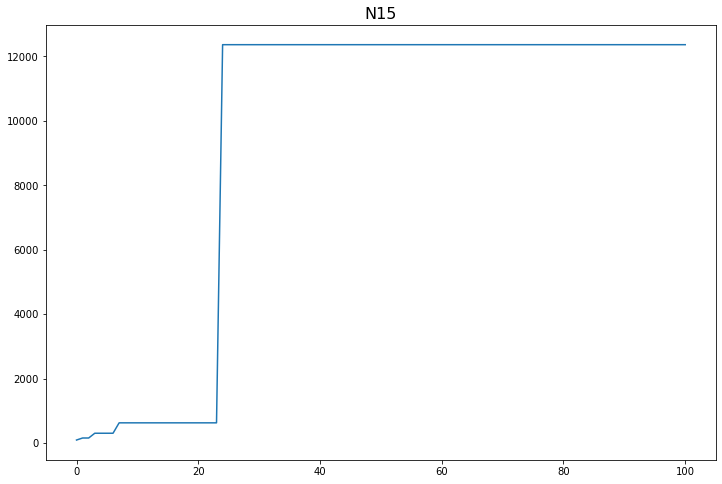

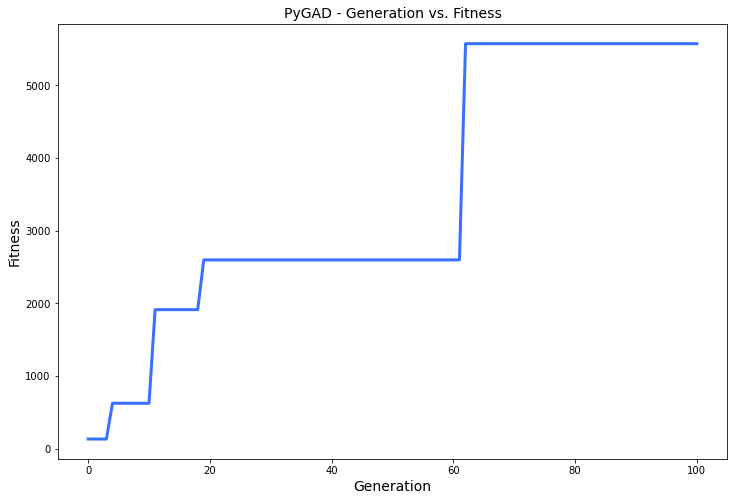

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 26.656 |==================| 2.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.735 |==================| 3.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.74 |==================| 3.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 26.447 |==================| 1.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 26.983 |==================| 65.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.193 |==================| 5.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 27.209 |================

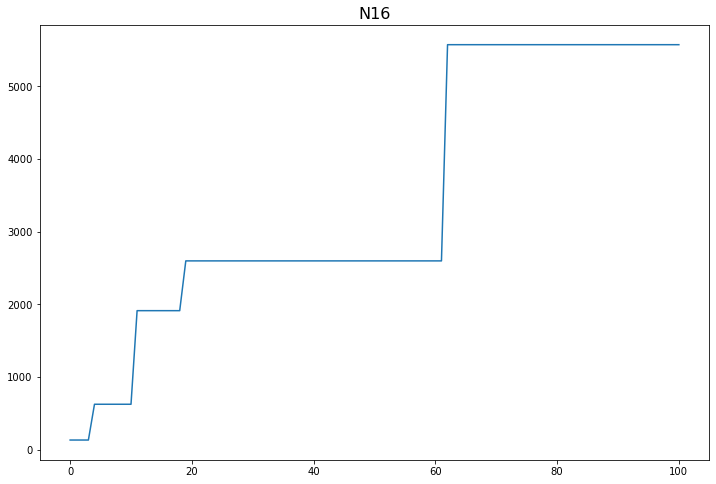

In [13]:
for index, val in enumerate(model_nodes):
    ga_instance = pygad.GA(num_generations=water_model.num_generations,
                       num_parents_mating=water_model.num_parents_mating, 
                       fitness_func=fitness_function, 
                       sol_per_pop=water_model.sol_per_pop,
                       num_genes=water_model.num_genes,
                       init_range_low=water_model.init_range_low,
                       init_range_high=water_model.init_range_high,
                       parent_selection_type=water_model.parent_selection_type,
                       keep_parents=water_model.keep_parents,
                       crossover_type=water_model.crossover_type,
                       mutation_type=water_model.mutation_type,
                       mutation_num_genes=water_model.mutation_num_genes,
                       callback_generation=callback_generation)
    
    water_model = WaterLeakModel(node=wn.junction_name_list[index])
    water_model.run(plot_graph=False)
    current_node = model_nodes[index]
    
    # Running the GA to optimize the parameters of the function.
    ga_instance.run()
    
    # After the generations complete, some plots are shown that summarize how the outputs/fitenss values evolve over generations.
    ga_instance.plot_result()
    
    # Returning the details of the best solution.
    solution, solution_fitness, solution_idx = ga_instance.best_solution()
    print("Parameters of the best solution :{solution}".format(solution=solution))
    print("Fitness value of the best solution ={solution_fitness}".format(solution_fitness=solution_fitness))
    print("Index of the best solution :{solution_idx}".format(solution_idx=solution_idx))
    
    prediction = numpy.sum(numpy.array(water_model.function_inputs)*solution)
    print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))
          
    if ga_instance.best_solution_generation != -1:
        print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))
    
    # Saving the GA instance.
    filename = 'genetic' # The filename to which the instance is saved. The  name is without extension.
    ga_instance.save(filename=filename)
    
    # Loading the saved GA instance.
    loaded_ga_instance = pygad.load(filename=filename)
    plt.plot(loaded_ga_instance.best_solutions_fitness)
    plt.title(model_nodes[index],fontsize=16)

    fitness_name = "Fitness_" + val
    plt.savefig(water_model.plots_dir+fitness_name)

In [14]:
# Check solution for confirmation
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
results = water_model.change_discharge_coefficient(wn, emitter_value=abs(solution[0]))

pressure = results.node['pressure']
presssure_at_N6 = pressure.loc[:,water_model.node]
print(presssure_at_N6)

0    26.998024
Name: N16, dtype: float64


In [15]:
# Merge all our solutions
fitness_solution_per_population = glob.glob(f"{water_model.temp_dir}/FITNESS_SOLUTION_*")

In [16]:
water_model.export_results(solutions = fitness_solution_per_population, path=None, name='optimization-result-per-fitness')

File Exported Successfully to path: merged_results/results_for_N16/optimization-result-per-fitness.csv


In [17]:
fitness_solution_per_population = pd.read_csv(water_model.merged_result+'/optimization-result-per-fitness.csv')

In [18]:
fitness_solution_per_population = fitness_solution_per_population.sort_values(by='FITNESS', ascending=True)
fitness_solution_per_population

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE
1100,0.510326,26.432761,1.1,1.769644,N16
1271,0.498077,26.439965,1.1,1.792496,N16
1459,0.497885,26.440078,1.1,1.792859,N16
1119,0.496515,26.440883,1.1,1.795450,N16
1699,0.494336,26.442164,1.1,1.799588,N16
...,...,...,...,...,...
225,0.501822,26.996883,1.1,1038.134402,N16
551,0.498894,26.998429,1.1,1709.499900,N16
716,0.500987,26.997324,1.1,1914.093087,N16
314,0.499273,26.998229,1.1,2599.091792,N16


In [19]:
# Merge all our solutions per generation
solution_per_generation = glob.glob(water_model.temp_dir+"/GENERATION_*")

In [20]:
water_model.export_results(solutions = solution_per_generation, path=None, name='optimization-result-per-generation',export_type='by_generation')
result_generation = pd.read_csv(water_model.merged_result+'/optimization-result-per-generation.csv')

File Exported Successfully to path: merged_results/results_for_N16/optimization-result-per-generation.csv


In [21]:
result_generation = result_generation.sort_values(by='NODE', ascending=True)
result_generation

,GENERATION,FITNESS,NODE
0,94.0,5574.052463,for
72,1.0,133.964798,for
71,62.0,5574.052463,for
70,76.0,5574.052463,for
69,89.0,5574.052463,for
...,...,...,...
28,78.0,5574.052463,for
27,44.0,2599.091792,for
26,50.0,2599.091792,for
36,53.0,2599.091792,for


In [22]:
# merge the solution per generation and solution
final_data = pd.merge(fitness_solution_per_population,result_generation, how='outer',left_on='FITNESS',right_on='FITNESS')
final_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE_x,GENERATION,NODE_y
0,0.510326,26.432761,1.1,1.769644,N16,NaN,NaN
1,0.498077,26.439965,1.1,1.792496,N16,NaN,NaN
2,0.497885,26.440078,1.1,1.792859,N16,NaN,NaN
3,0.496515,26.440883,1.1,1.795450,N16,NaN,NaN
4,0.494336,26.442164,1.1,1.799588,N16,NaN,NaN
...,...,...,...,...,...,...,...
2010,NaN,NaN,NaN,626.302204,NaN,5.0,for
2011,NaN,NaN,NaN,626.302204,NaN,6.0,for
2012,NaN,NaN,NaN,626.302204,NaN,7.0,for
2013,NaN,NaN,NaN,626.302204,NaN,9.0,for


In [23]:
# sort the node fitness to get the highest fitting node, from highest to lowest
grouped_data=final_data.groupby(['NODE_x'],sort=True)[['FITNESS', 'OUTPUT_DEMAND']].max()
grouped_data=grouped_data.sort_values('FITNESS',ascending=False)
grouped_data

,FITNESS,OUTPUT_DEMAND
NODE_x,,
N16,5574.052463,1.1


In [24]:
highest_fitted_node=grouped_data.index[grouped_data['FITNESS']==max(grouped_data['FITNESS'])].tolist()[0]
print(highest_fitted_node, 'has the highest fitness in the network')

N16 has the highest fitness in the network


In [25]:
generation_=result_generation[result_generation['NODE']==highest_fitted_node] 
generation_=generation_.sort_values(by='FITNESS',ascending=True)
generation_

,GENERATION,FITNESS,NODE


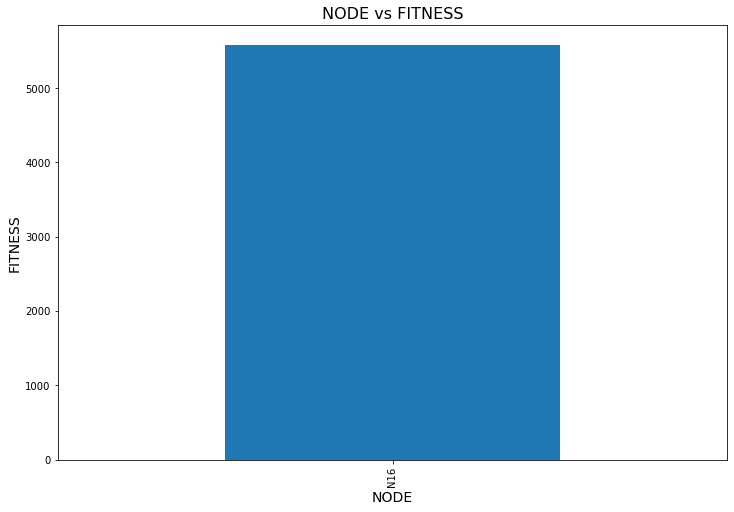

In [26]:
grouped_data['FITNESS'].plot(kind='bar')
plt.xlabel('NODE',fontsize=14) 
plt.ylabel('FITNESS',fontsize=14) 
plt.title('NODE vs FITNESS',fontsize=16) 
plt.show();
plt.savefig(water_model.plots_dir+"/node_with_best_fitness.png") 
plt.close()

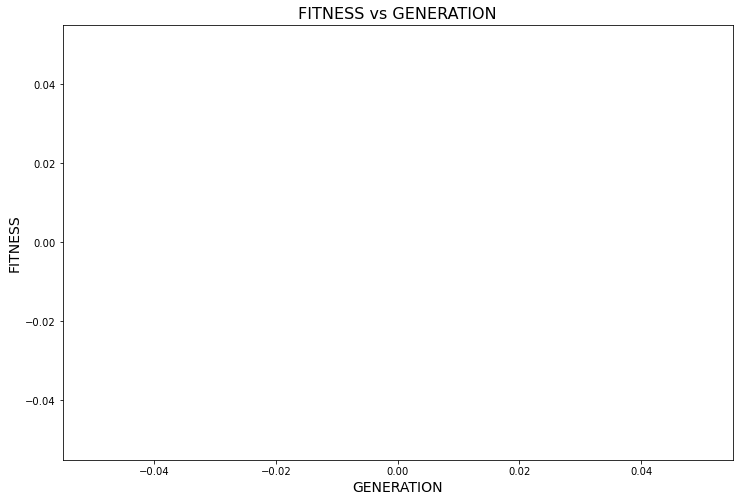

In [27]:
plt.plot(list(range(len(generation_))),generation_['FITNESS']) 
plt.xlabel('GENERATION',fontsize=14) ### population 
plt.ylabel('FITNESS',fontsize=14)
plt.title('FITNESS vs GENERATION',fontsize=16) 
plt.savefig(water_model.plots_dir+"/FITNESS_vs_GENERATION.png") 
plt.show();

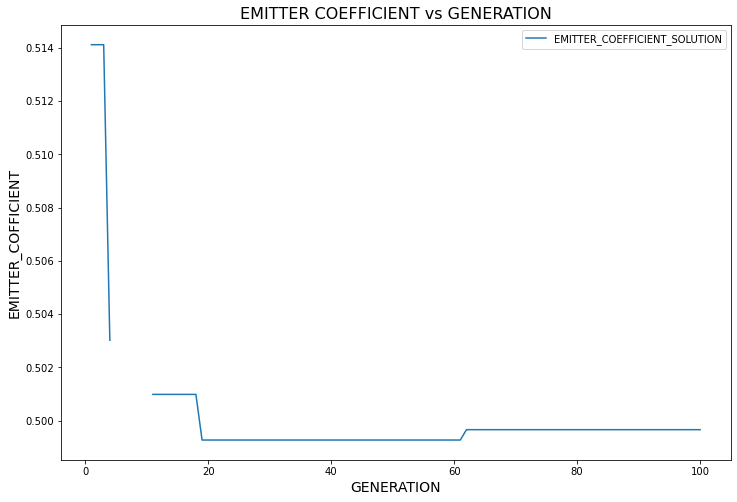

In [29]:
final_data.groupby(['GENERATION'])['EMITTER_COEFFICIENT_SOLUTION'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
plt.title('EMITTER COEFFICIENT vs GENERATION',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT.png");
plt.close()

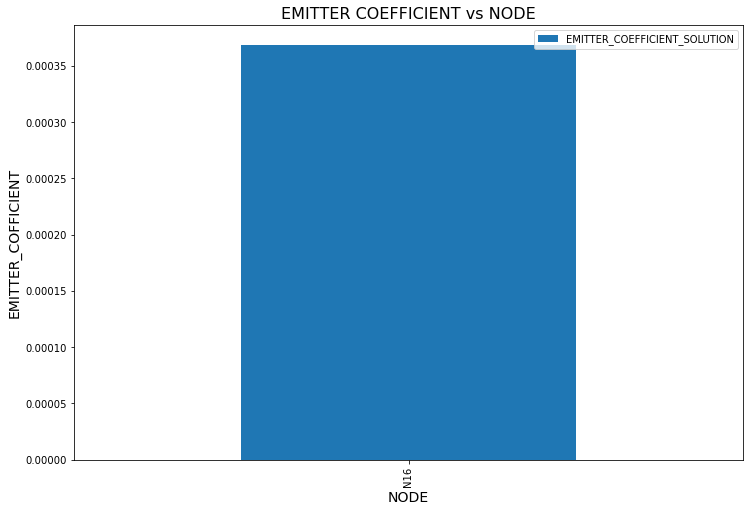

In [35]:
final_data.groupby(['NODE_x'])['EMITTER_COEFFICIENT_SOLUTION'].min().to_frame().plot(kind='bar')
plt.xlabel('NODE',fontsize=14)
plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
plt.title('EMITTER COEFFICIENT vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT_vs_NODE.png");
plt.close()

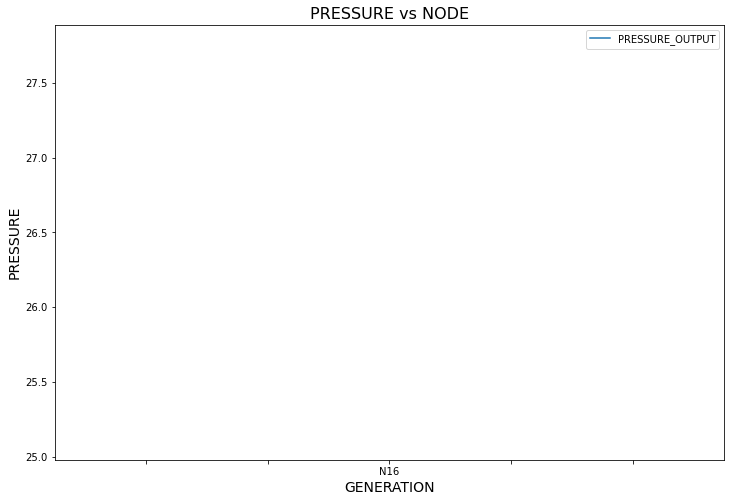

In [31]:
final_data.groupby(['NODE_x'])['PRESSURE_OUTPUT'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

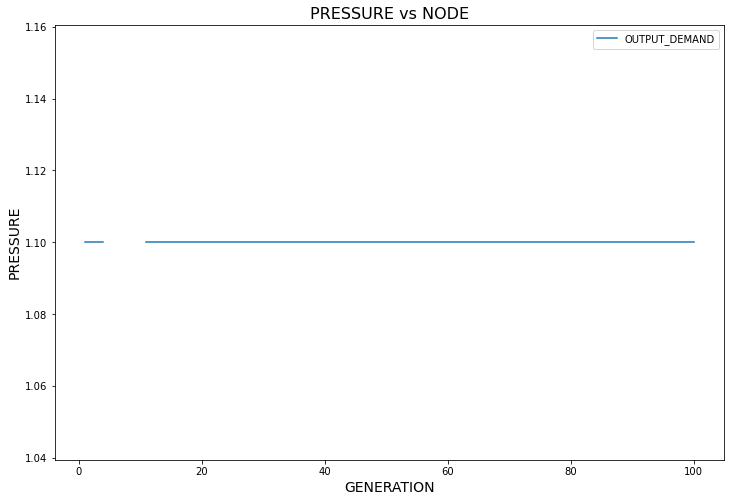

In [33]:
final_data.groupby(['GENERATION'])['OUTPUT_DEMAND'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

In [ ]:
# sort the node fitness to get the highest fitting node, from highest to lowest
grouped_pressure_data=final_data.groupby(['NODE_x'],sort=True)['PRESSURE_OUTPUT'].min()
grouped_pressure_data=grouped_pressure_data.to_frame().sort_values('PRESSURE_OUTPUT',ascending=True)
grouped_pressure_data.plot(title='PRESSURE ACROSS NODES', xlabel='NODE', ylabel='PRESSURE')

In [ ]:
# demand_across_gen = final_data.groupby('GENERATION', sort=True)['OUTPUT_DEMAND'].max()
# demand_across_gen = demand_across_gen.to_frame().sort_values('OUTPUT_DEMAND', ascending=True)
# demand_across_gen.plot(title='DEMAND ACROSS GENERATION', xlabel='GENERATION', ylabel='OUTPUT_DEMAND')

## Visualize the Rest of the Fitness for other nodes as well

In [ ]:
water_model.PLOTS_DIR = 'each-node-optimization-plots'

In [ ]:
# Fitness across all nodes
fitness_plots = [os.path.join(water_model.plots_dir,file) \
                 for file in os.listdir(water_model.plots_dir) \
                 if file.endswith('.png') or file.endswith('.jpg')]
fitness_plots

In [ ]:
plt.rcParams['figure.figsize'] = (10,7)

In [ ]:
# subplot 16 images
i = 4
j = 0

for _ in range(len(fitness_plots)//4):
    fig, axs = plt.subplots(2, 2, figsize=(20,20), constrained_layout = True)
    axs = axs.ravel()

    for index, val in enumerate(fitness_plots[j:i]):
        img = plt.imread(val)
        axs[index].imshow(img)
        axs[index].axis('off')
    fig.suptitle('Solution Across Nodes - Post Optimization', fontsize=16)
    plt.savefig(water_model.plots_dir+str(f'/fitness/Fitness_group_{j}.png'))
    plt.subplots_adjust(left=0, bottom=0, right=None, top=None, wspace=None, hspace=None)
    j=i
    i+=4
        
